In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms

from utils import mnist, plot_graphs, plot_mnist, to_onehot
import numpy as np
import os 

%matplotlib inline

In [2]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [3]:
root_folder = 'FC_CAAE_results'
fixed_folder = root_folder + '/Fixed_results/'
recon_folder = root_folder + '/Recon_results/'

if os.path.isdir(root_folder):
    !rm -r $root_folder
os.mkdir(root_folder)
os.mkdir(fixed_folder)
os.mkdir(recon_folder)

In [4]:
mnist_tanh = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize((0.5,), (0.5,)),
                lambda x: x.to(device)
           ])

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

lr = 0.0001
prior_size = 10
train_epoch = 1000
batch_size = 250
train_loader, valid_loader, test_loader = mnist(batch_size=batch_size, valid=10000, transform=mnist_tanh)
fixed_z = torch.randn((10, prior_size)).repeat((1,10)).view(-1, prior_size).to(device)
fixed_z_label = to_onehot(torch.tensor(list(range(10))).repeat((10)), 10).to(device)
fixed_data, fixed_label = next(iter(test_loader))
fixed_data = fixed_data[:100].to(device)
fixed_label = to_onehot(fixed_label[:100], 10).to(device)

cuda:0


9920512it [00:03, 3554340.10it/s]                                                                                      


Extracting ./MNIST_data\MNIST\raw\train-images-idx3-ubyte.gz


32768it [00:00, 90131.76it/s]                                                                                          


Extracting ./MNIST_data\MNIST\raw\train-labels-idx1-ubyte.gz


1654784it [00:01, 1158532.26it/s]                                                                                      


Extracting ./MNIST_data\MNIST\raw\t10k-images-idx3-ubyte.gz


8192it [00:00, 33715.01it/s]                                                                                           


Extracting ./MNIST_data\MNIST\raw\t10k-labels-idx1-ubyte.gz
Processing...
Done!


In [6]:
data, label = next(iter(train_loader))

In [7]:
class FullyConnected(nn.Module):
    def __init__(self, sizes, dropout=False, activation_fn=nn.Tanh(), flatten=False, 
                 last_fn=None, first_fn=None, device='cpu'):
        super(FullyConnected, self).__init__()
        layers = []
        self.flatten = flatten
        if first_fn is not None:
            layers.append(first_fn)
        for i in range(len(sizes) - 2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if dropout:
                layers.append(nn.Dropout(dropout))
            layers.append(activation_fn) # нам не нужен дропаут и фнкция активации в последнем слое
        else: 
            layers.append(nn.Linear(sizes[-2], sizes[-1]))
        if last_fn is not None:
            layers.append(last_fn)
        self.model = nn.Sequential(*layers)
        self.to(device)
        
    def forward(self, x, y=None):
        if self.flatten:
            x = x.view(x.shape[0], -1)
        if y is not None:
            x = torch.cat([x, y], dim=1)
        return self.model(x)

In [8]:
Enc = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
Dec = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
Disc = FullyConnected([prior_size+10, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(Enc.parameters(), lr=lr)
Dec_optimizer = optim.Adam(Dec.parameters(), lr=lr)
Disc_optimizer = optim.Adam(Disc.parameters(), lr=lr)

In [9]:
train_log = {'E': [],'AE': [], 'D': []}
test_log = {'E': [],'AE': [], 'D': []}

In [10]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

In [11]:
def train(epoch, Enc, Dec, Disc, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data), label)
        true_pred = Disc(z, z_label)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent, label)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if batch_idx % 100 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
            epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
        losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
        print(line + losses)
        log['E'].append(Enc_loss.item())
        log['AE'].append(AE_loss.item())
        log['D'].append(Disc_loss.item())

In [12]:
def test(Enc, Dec, Disc, loader, epoch, log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent, label)
            true_pred = Disc(z, z_label)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
        plot_mnist(fixed_gen, (10, 10), True, fixed_folder + '%03d.png' % epoch)
        fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
        plot_mnist(fixed_reconstruction, (10, 10), True, recon_folder + '%03d.png' % epoch)
        
    report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
    print(report)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6815, AE: 0.9285, D: 0.6938
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 0.2957, AE: 0.2795, D: 5.8030
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.9364, AE: 0.3173, D: 1.3736


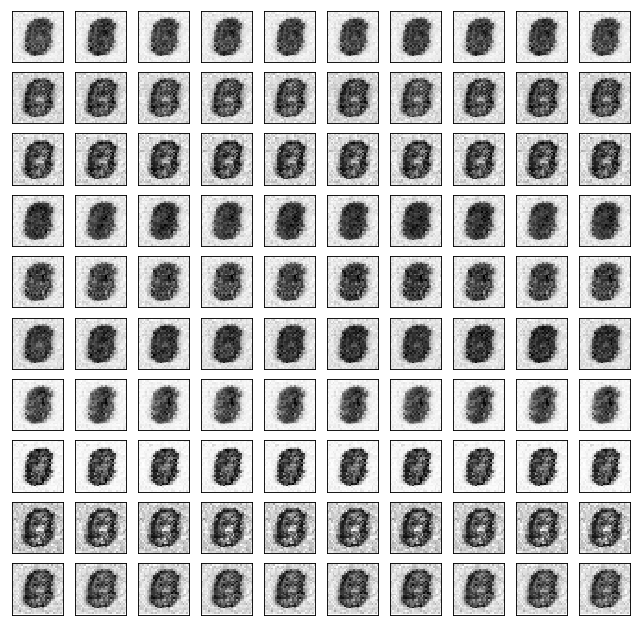

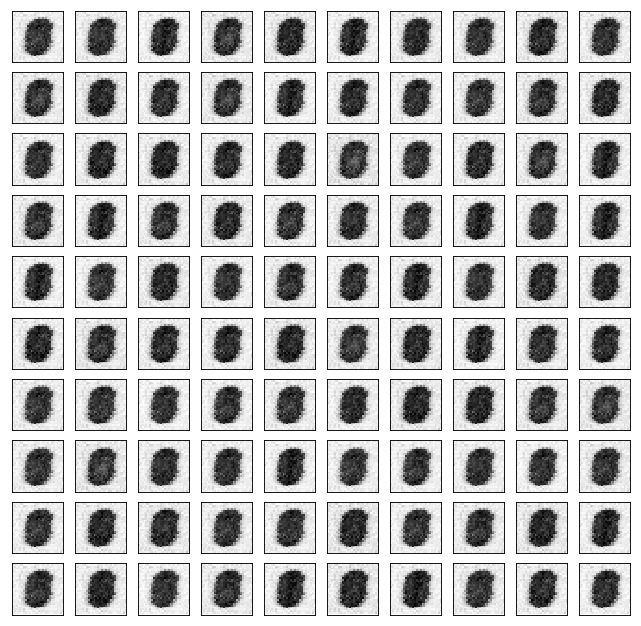

Test losses. E: 0.9174, AE: 0.3060, D: 1.3877
Train Epoch: 2 [0/50000 (0%)]	Losses E: 0.9194, AE: 0.3034, D: 1.3733
Train Epoch: 2 [25000/50000 (50%)]	Losses E: 0.6665, AE: 0.2624, D: 0.9799
Train Epoch: 2 [50000/50000 (100%)]	Losses E: 0.6050, AE: 0.2538, D: 0.7699


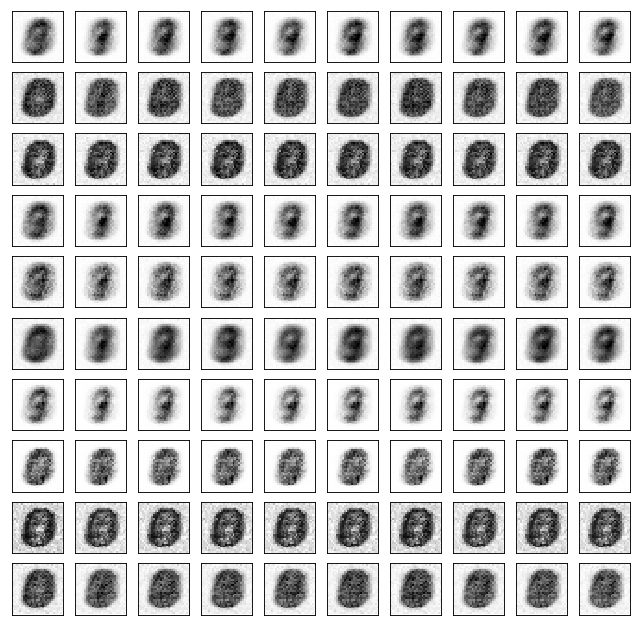

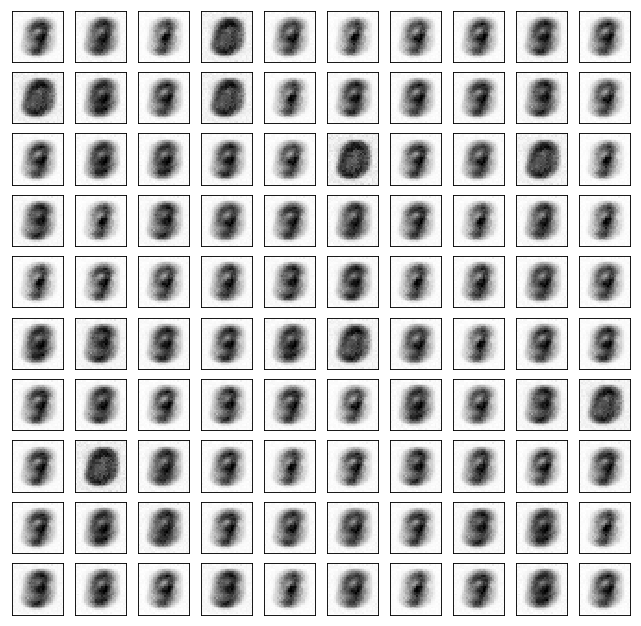

Test losses. E: 0.5737, AE: 0.2534, D: 0.7979
Train Epoch: 3 [0/50000 (0%)]	Losses E: 0.5789, AE: 0.2516, D: 0.8103
Train Epoch: 3 [25000/50000 (50%)]	Losses E: 0.8182, AE: 0.2440, D: 0.8098
Train Epoch: 3 [50000/50000 (100%)]	Losses E: 0.6000, AE: 0.2394, D: 0.7840


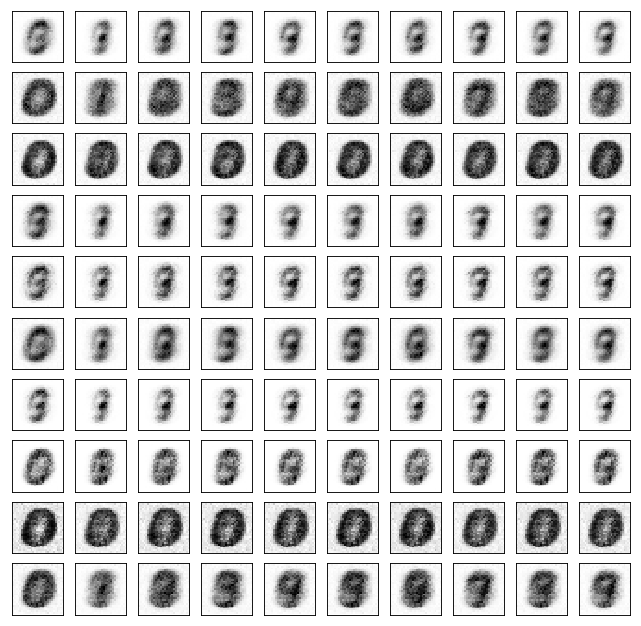

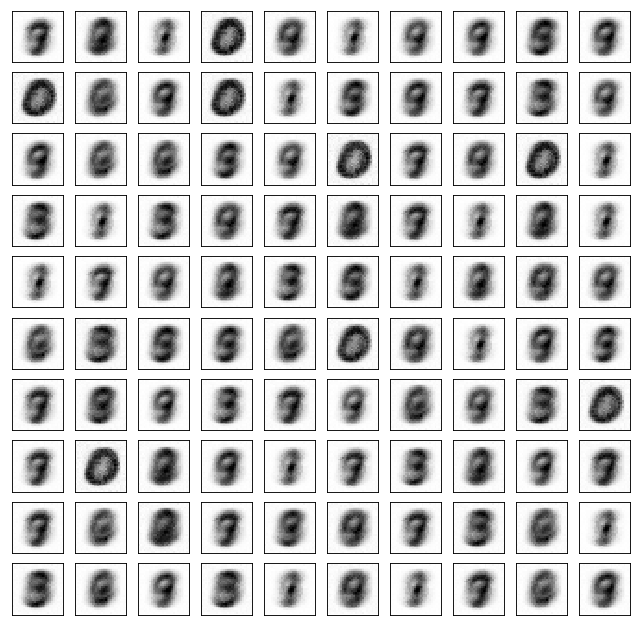

Test losses. E: 0.5886, AE: 0.2362, D: 0.7692
Train Epoch: 4 [0/50000 (0%)]	Losses E: 0.6007, AE: 0.2358, D: 0.7715
Train Epoch: 4 [25000/50000 (50%)]	Losses E: 0.5513, AE: 0.2325, D: 0.7605
Train Epoch: 4 [50000/50000 (100%)]	Losses E: 0.6789, AE: 0.2191, D: 0.7990


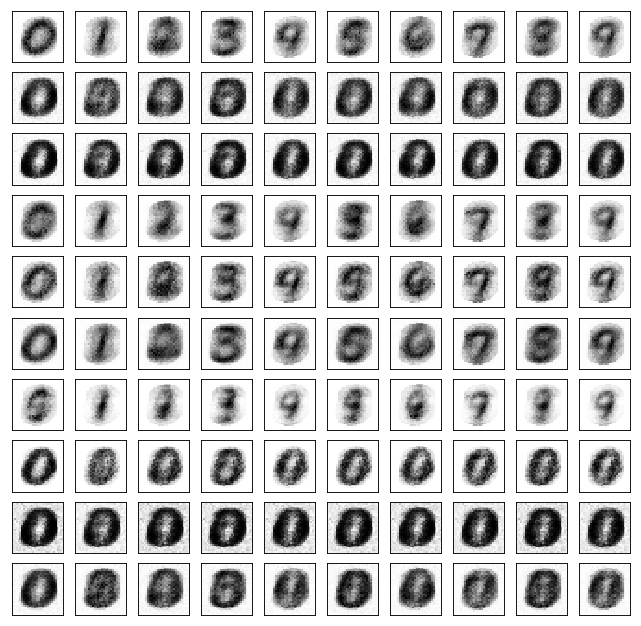

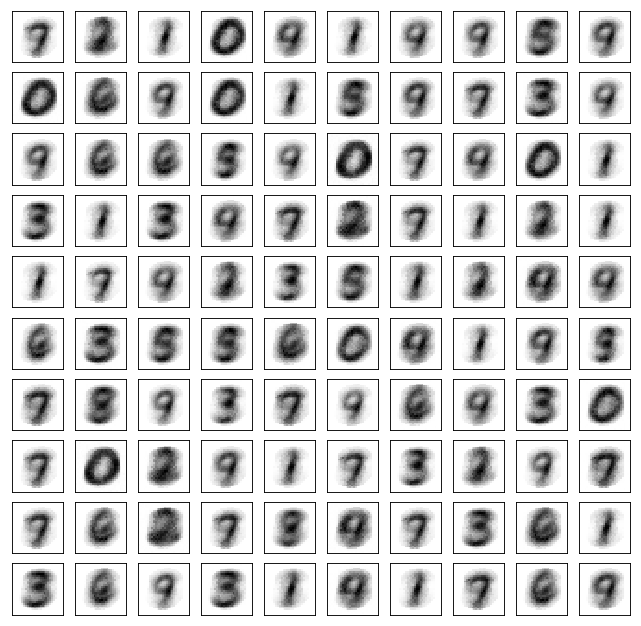

Test losses. E: 0.6586, AE: 0.2180, D: 0.7963
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.6779, AE: 0.2140, D: 0.7990
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.5918, AE: 0.2092, D: 0.7709
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.5206, AE: 0.2089, D: 0.7640


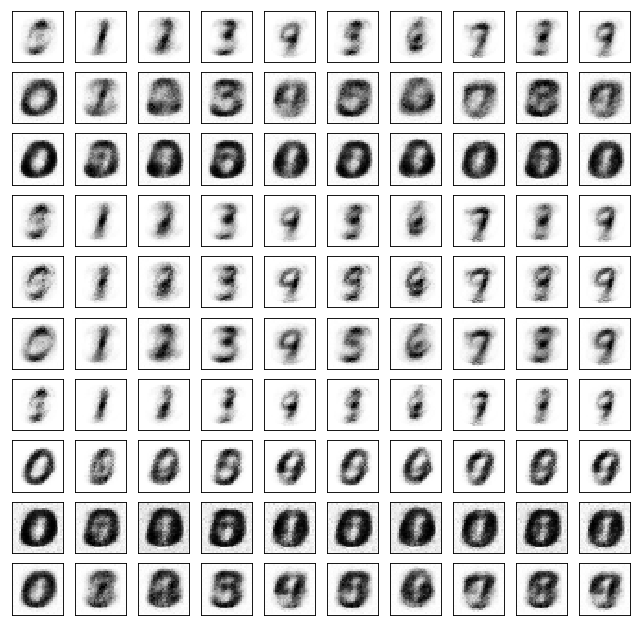

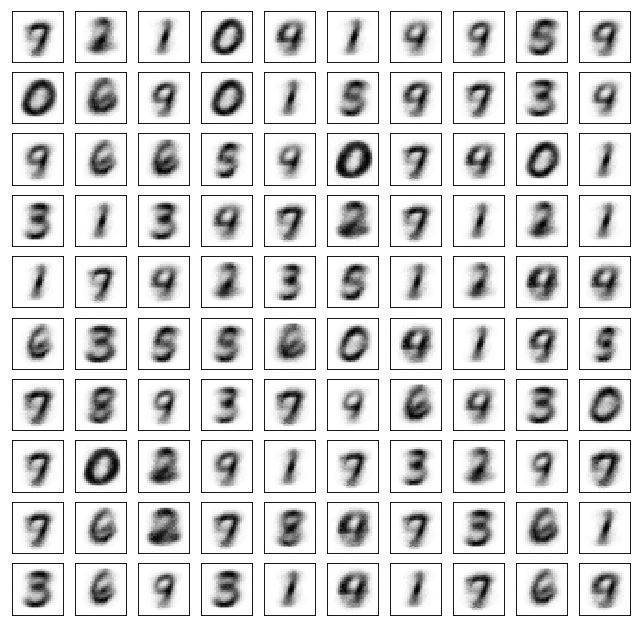

Test losses. E: 0.4990, AE: 0.2063, D: 0.7726
Train Epoch: 6 [0/50000 (0%)]	Losses E: 0.5240, AE: 0.2141, D: 0.7597
Train Epoch: 6 [25000/50000 (50%)]	Losses E: 0.7054, AE: 0.2037, D: 0.7361
Train Epoch: 6 [50000/50000 (100%)]	Losses E: 0.6098, AE: 0.1945, D: 0.7403


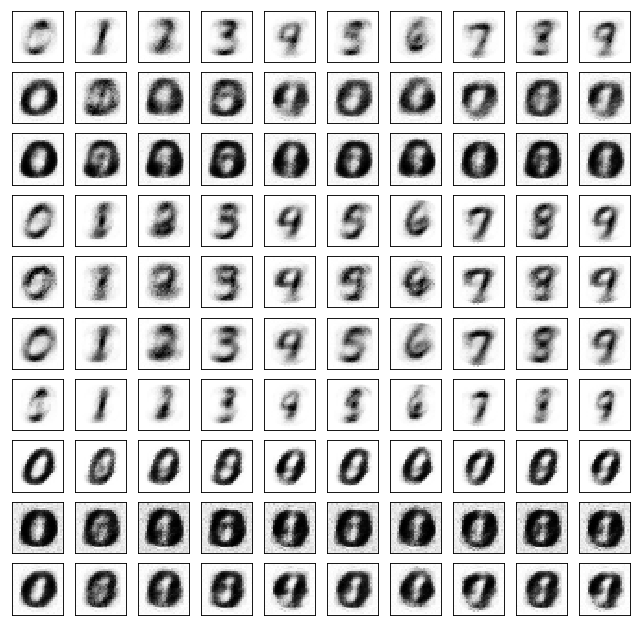

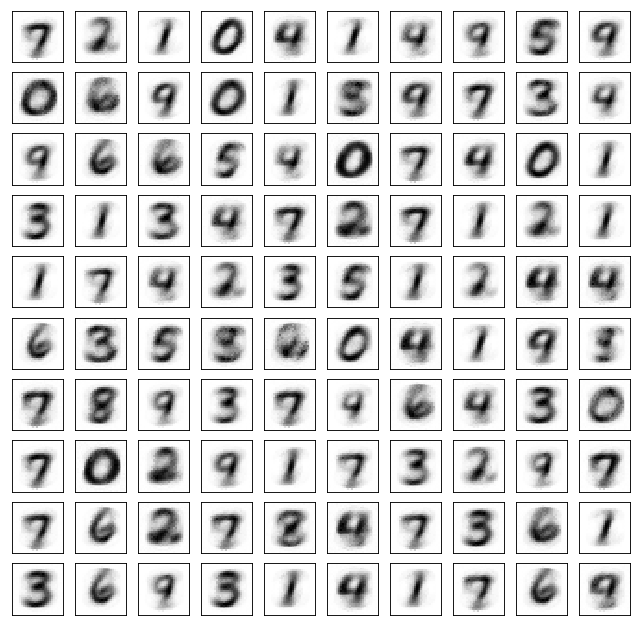

Test losses. E: 0.6042, AE: 0.1948, D: 0.7388
Train Epoch: 7 [0/50000 (0%)]	Losses E: 0.6060, AE: 0.2021, D: 0.7405
Train Epoch: 7 [25000/50000 (50%)]	Losses E: 0.5637, AE: 0.1990, D: 0.7178
Train Epoch: 7 [50000/50000 (100%)]	Losses E: 0.7207, AE: 0.1844, D: 0.7484


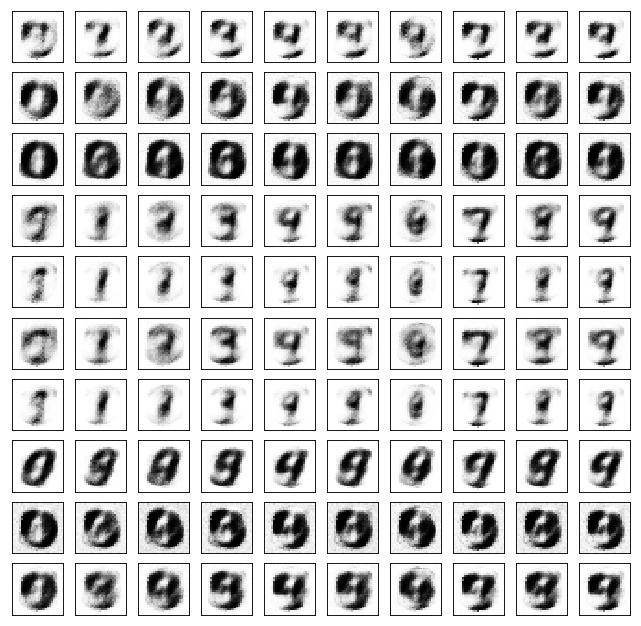

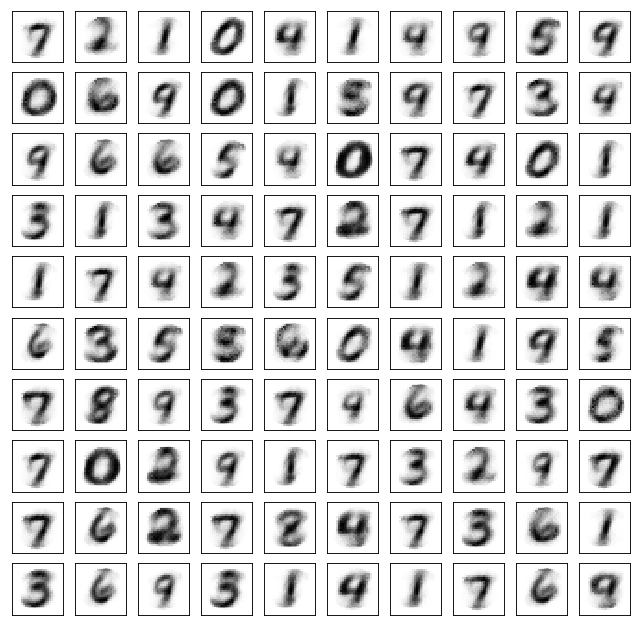

Test losses. E: 0.6824, AE: 0.1887, D: 0.7471
Train Epoch: 8 [0/50000 (0%)]	Losses E: 0.7223, AE: 0.1850, D: 0.7511
Train Epoch: 8 [25000/50000 (50%)]	Losses E: 0.6459, AE: 0.1800, D: 0.7195
Train Epoch: 8 [50000/50000 (100%)]	Losses E: 0.7520, AE: 0.1831, D: 0.6679


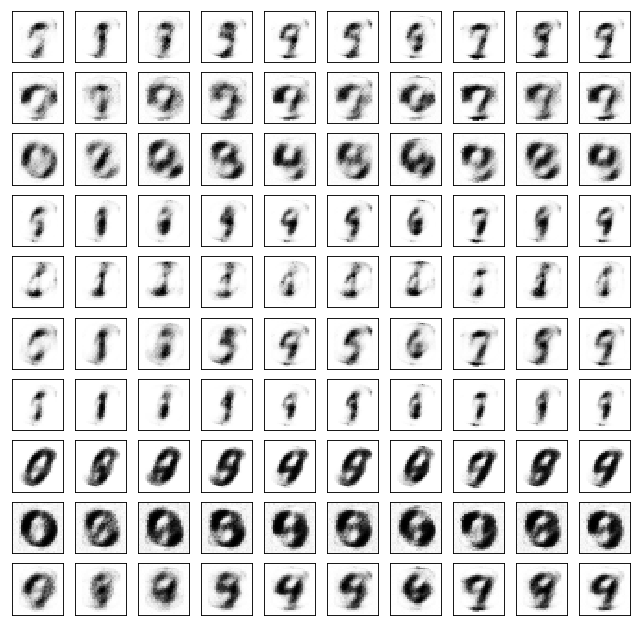

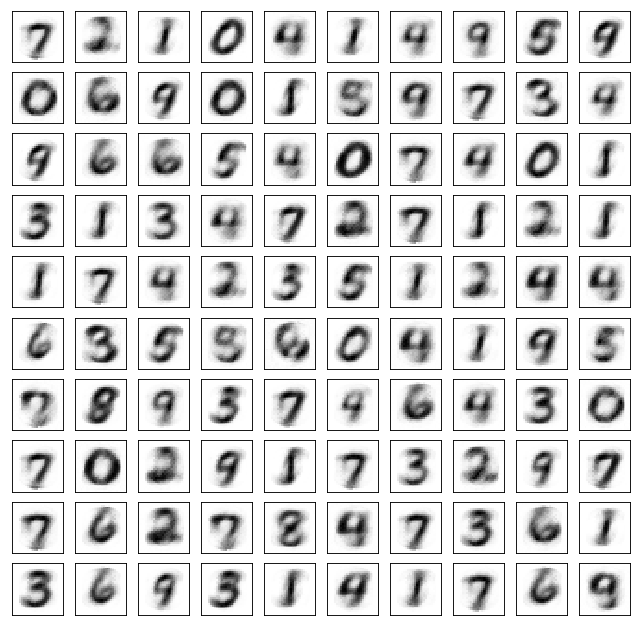

Test losses. E: 0.7222, AE: 0.1825, D: 0.6701
Train Epoch: 9 [0/50000 (0%)]	Losses E: 0.7356, AE: 0.1919, D: 0.6763
Train Epoch: 9 [25000/50000 (50%)]	Losses E: 0.6331, AE: 0.1758, D: 0.7740
Train Epoch: 9 [50000/50000 (100%)]	Losses E: 0.5947, AE: 0.1786, D: 0.7112


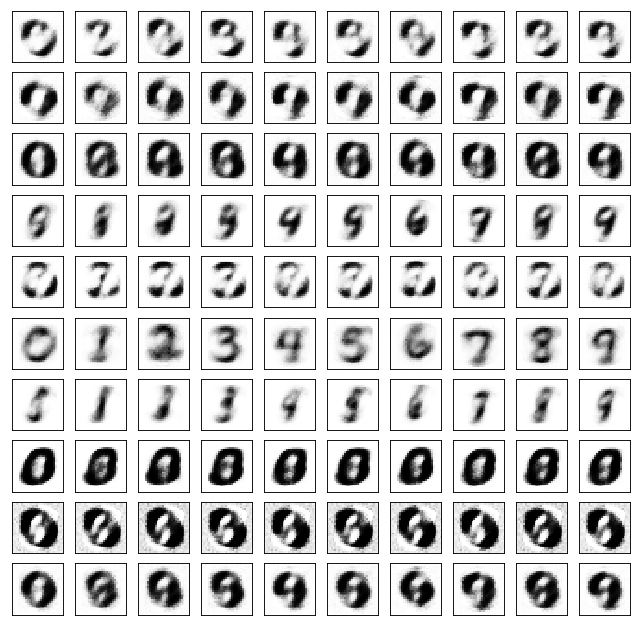

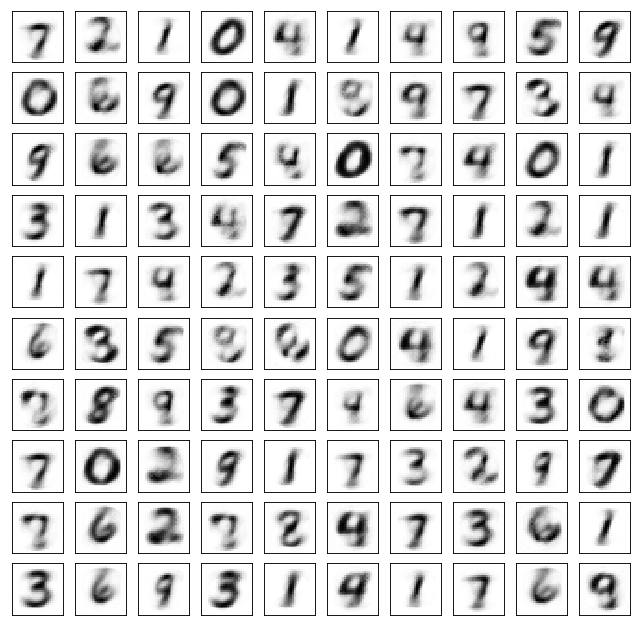

Test losses. E: 0.5921, AE: 0.1738, D: 0.7148
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.5926, AE: 0.1696, D: 0.7145
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.5937, AE: 0.1701, D: 0.6962
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.7593, AE: 0.1637, D: 0.7417


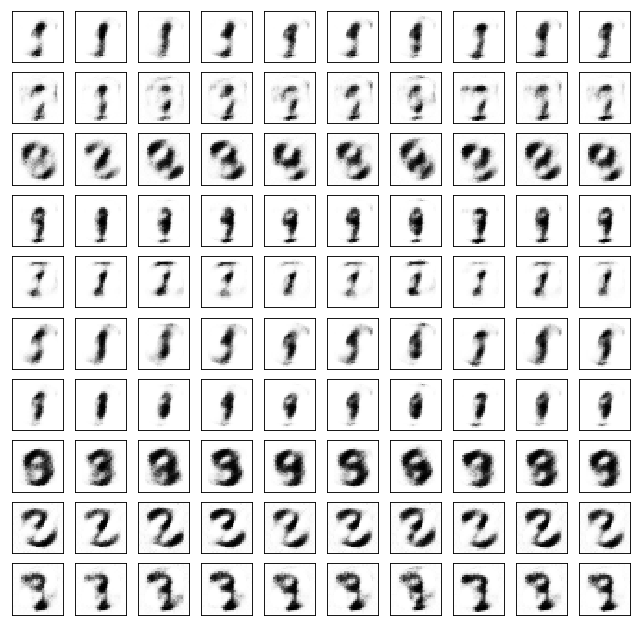

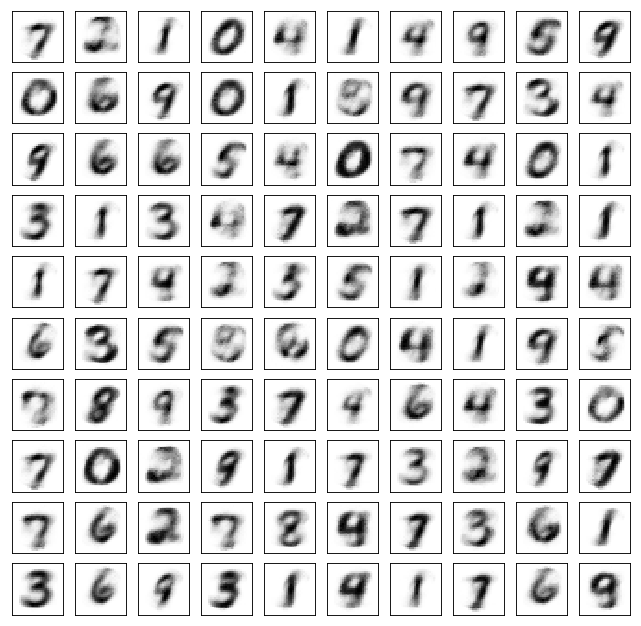

Test losses. E: 0.7450, AE: 0.1682, D: 0.7358
Train Epoch: 11 [0/50000 (0%)]	Losses E: 0.7581, AE: 0.1693, D: 0.7339
Train Epoch: 11 [25000/50000 (50%)]	Losses E: 0.6404, AE: 0.1620, D: 0.7192
Train Epoch: 11 [50000/50000 (100%)]	Losses E: 0.6748, AE: 0.1556, D: 0.6890


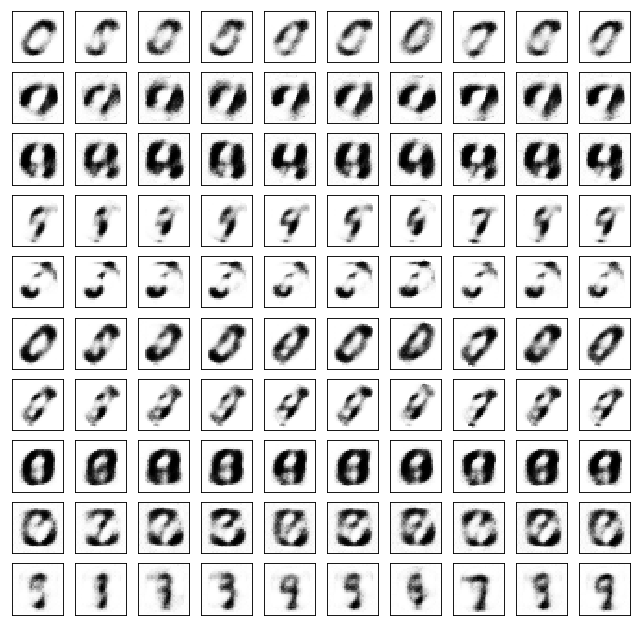

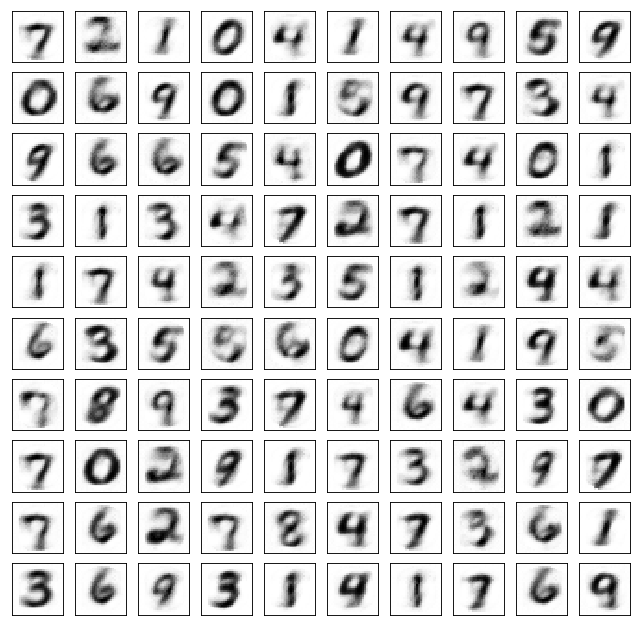

Test losses. E: 0.6685, AE: 0.1623, D: 0.6849
Train Epoch: 12 [0/50000 (0%)]	Losses E: 0.6728, AE: 0.1601, D: 0.6857
Train Epoch: 12 [25000/50000 (50%)]	Losses E: 0.6971, AE: 0.1601, D: 0.7691
Train Epoch: 12 [50000/50000 (100%)]	Losses E: 0.6519, AE: 0.1493, D: 0.7079


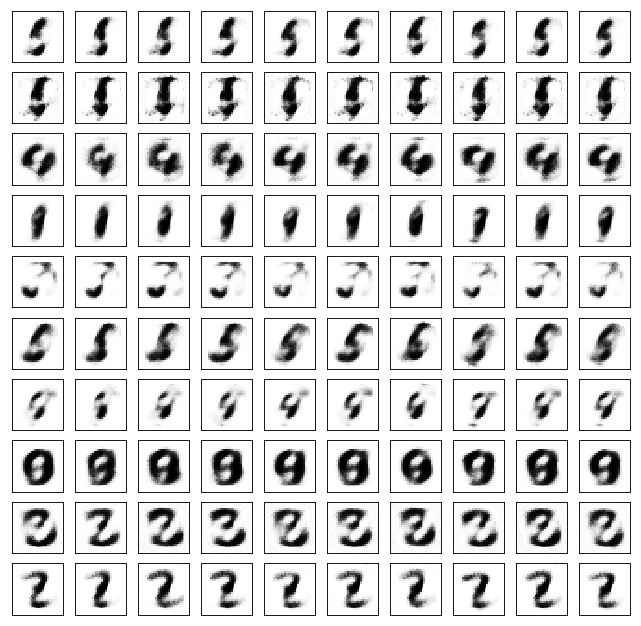

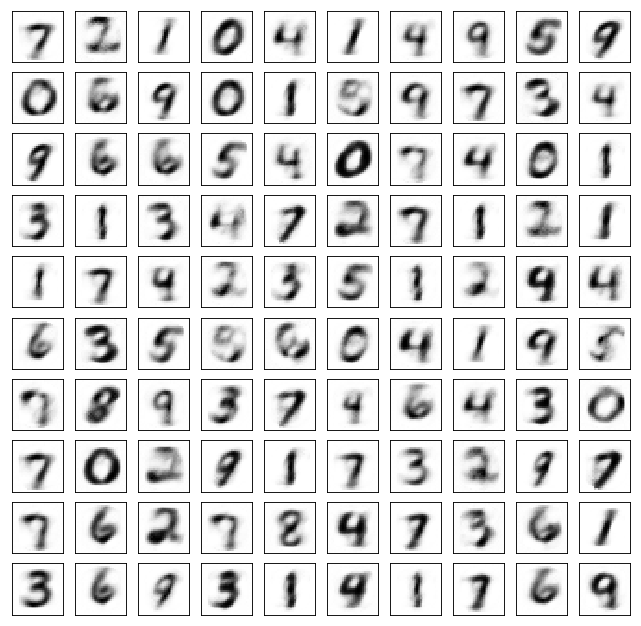

Test losses. E: 0.6510, AE: 0.1510, D: 0.7061
Train Epoch: 13 [0/50000 (0%)]	Losses E: 0.6498, AE: 0.1533, D: 0.7076
Train Epoch: 13 [25000/50000 (50%)]	Losses E: 0.5787, AE: 0.1536, D: 0.7059
Train Epoch: 13 [50000/50000 (100%)]	Losses E: 0.7033, AE: 0.1507, D: 0.7788


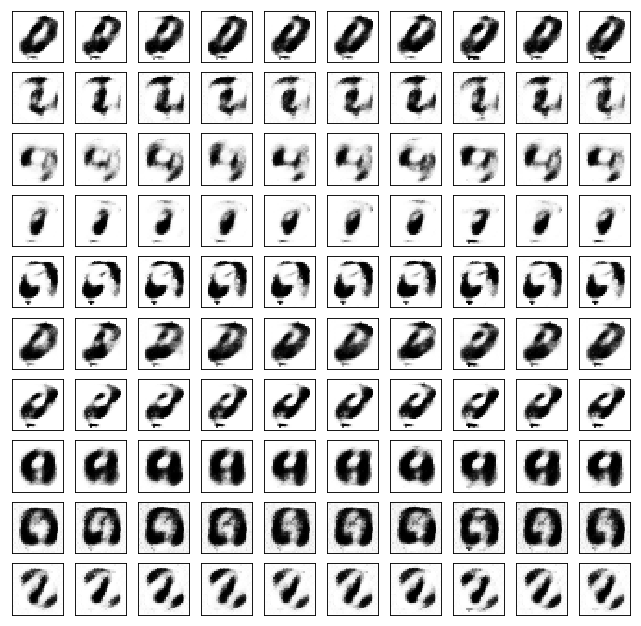

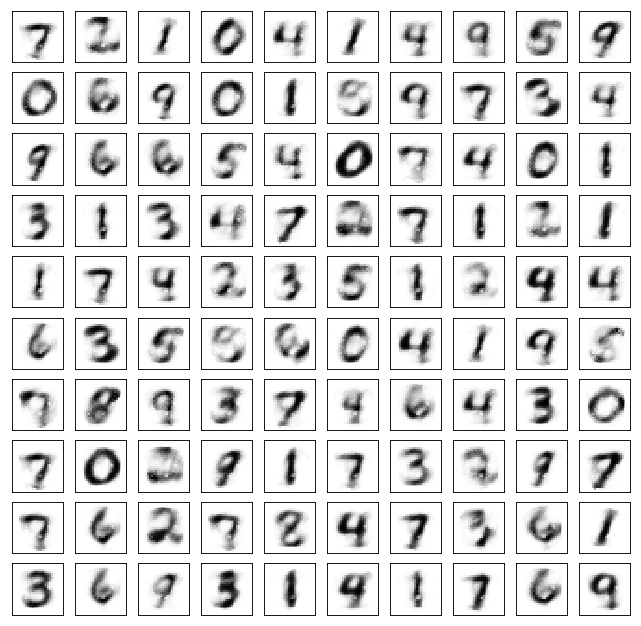

Test losses. E: 0.6993, AE: 0.1529, D: 0.7796
Train Epoch: 14 [0/50000 (0%)]	Losses E: 0.7043, AE: 0.1452, D: 0.7780
Train Epoch: 14 [25000/50000 (50%)]	Losses E: 0.6901, AE: 0.1427, D: 0.6983
Train Epoch: 14 [50000/50000 (100%)]	Losses E: 0.5859, AE: 0.1473, D: 0.7132


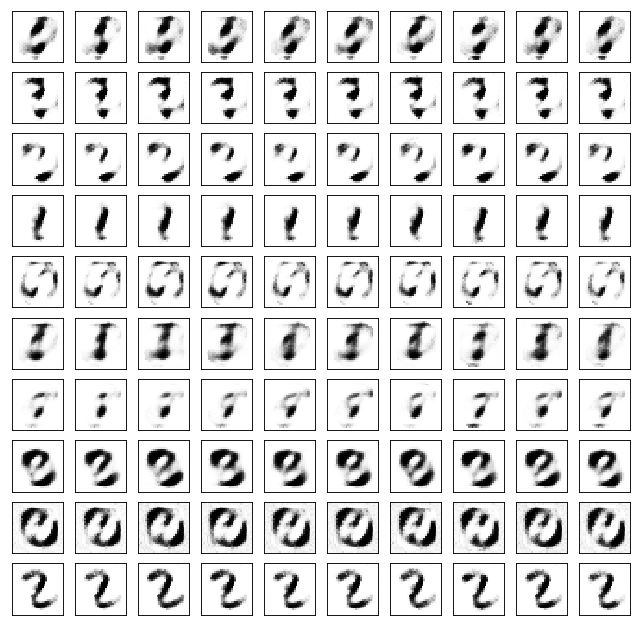

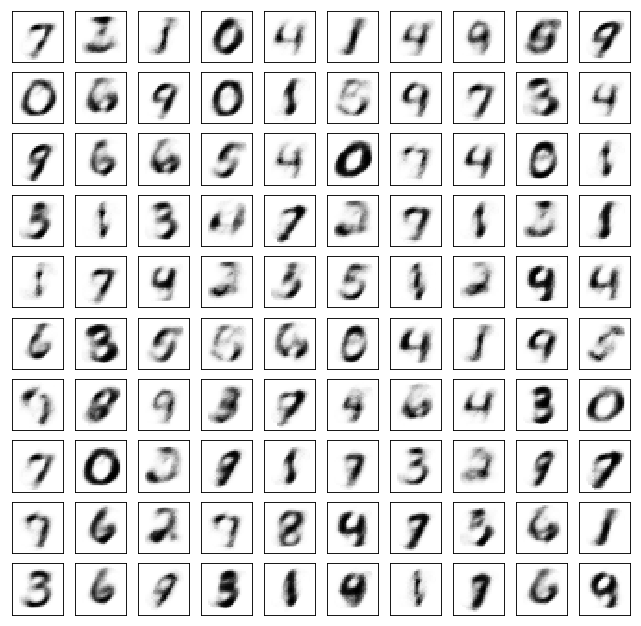

Test losses. E: 0.5770, AE: 0.1507, D: 0.7119
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.5883, AE: 0.1512, D: 0.7136
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.6730, AE: 0.1479, D: 0.7421
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.6586, AE: 0.1406, D: 0.7017


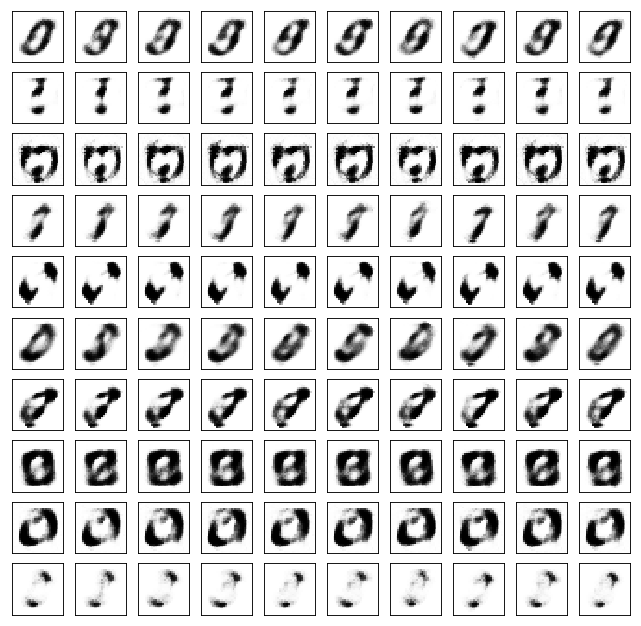

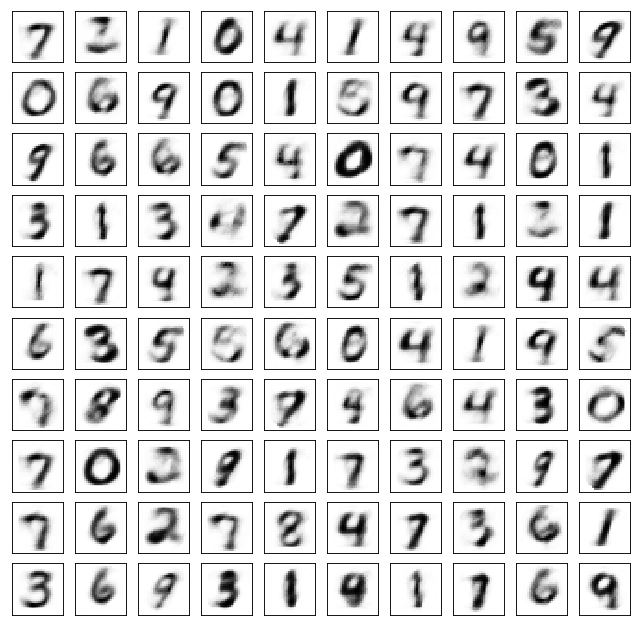

Test losses. E: 0.6601, AE: 0.1374, D: 0.7006
Train Epoch: 16 [0/50000 (0%)]	Losses E: 0.6594, AE: 0.1426, D: 0.7018
Train Epoch: 16 [25000/50000 (50%)]	Losses E: 0.6081, AE: 0.1543, D: 0.7423
Train Epoch: 16 [50000/50000 (100%)]	Losses E: 0.7453, AE: 0.1354, D: 0.6956


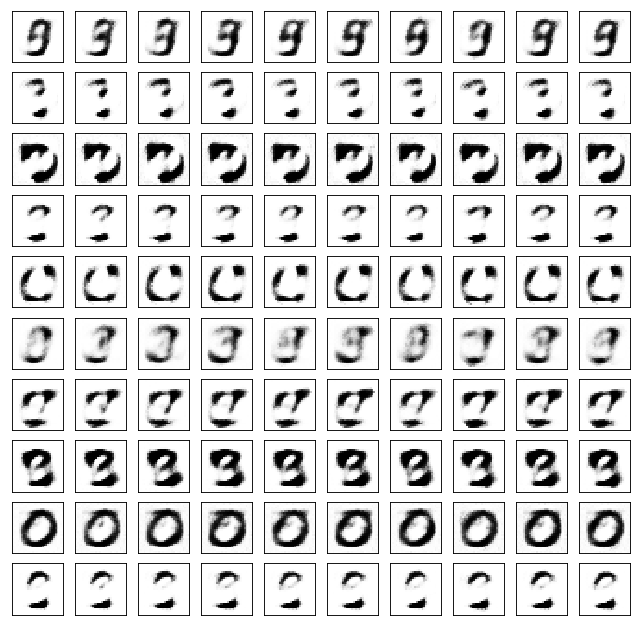

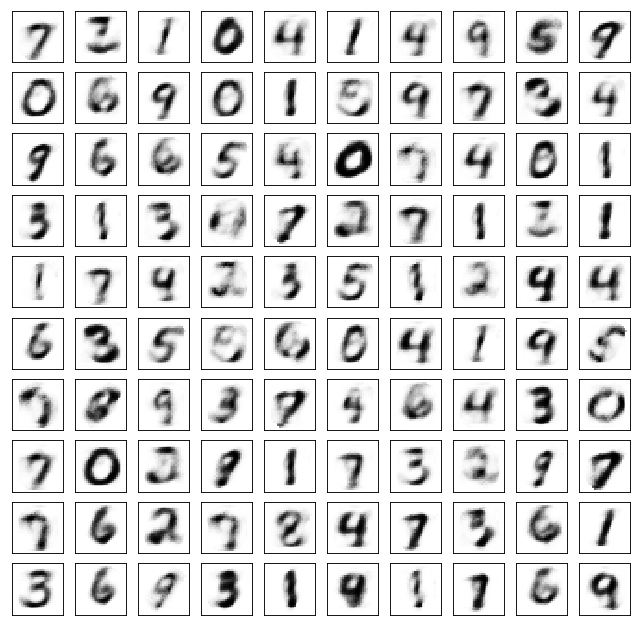

Test losses. E: 0.7387, AE: 0.1371, D: 0.6952
Train Epoch: 17 [0/50000 (0%)]	Losses E: 0.7450, AE: 0.1402, D: 0.6967
Train Epoch: 17 [25000/50000 (50%)]	Losses E: 0.6428, AE: 0.1309, D: 0.6871
Train Epoch: 17 [50000/50000 (100%)]	Losses E: 1.2431, AE: 0.2020, D: 0.6093


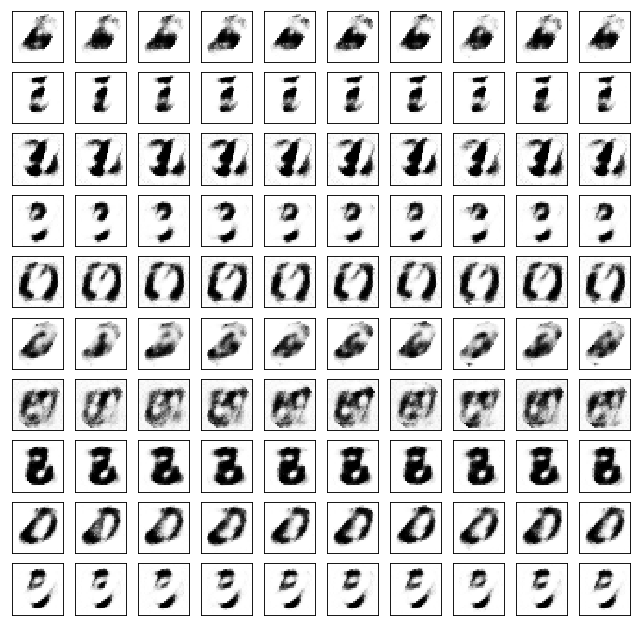

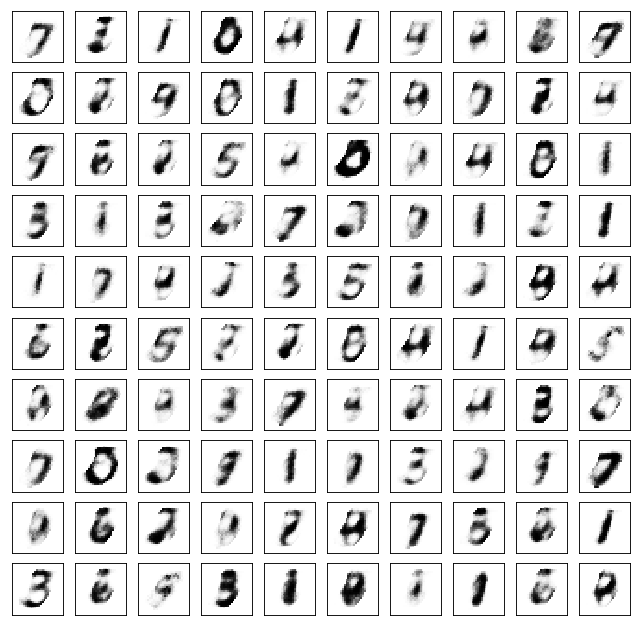

Test losses. E: 1.0997, AE: 0.2081, D: 0.6116
Train Epoch: 18 [0/50000 (0%)]	Losses E: 1.2324, AE: 0.2012, D: 0.6064
Train Epoch: 18 [25000/50000 (50%)]	Losses E: 0.6869, AE: 0.1335, D: 0.7261
Train Epoch: 18 [50000/50000 (100%)]	Losses E: 0.6799, AE: 0.1232, D: 0.6863


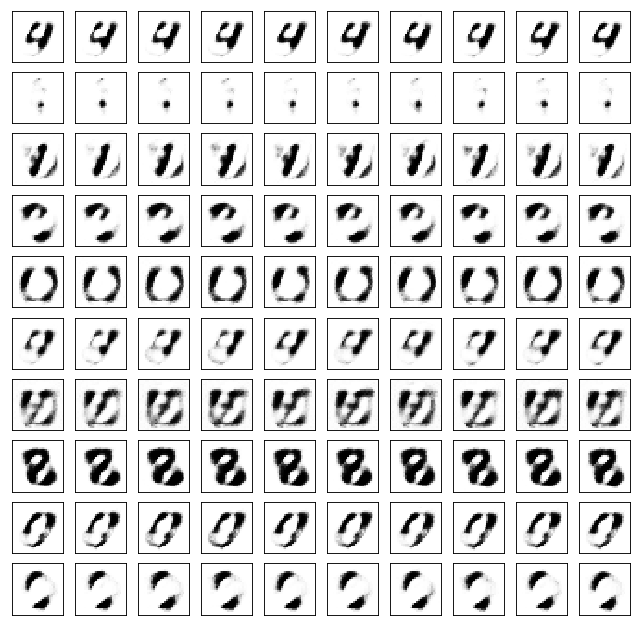

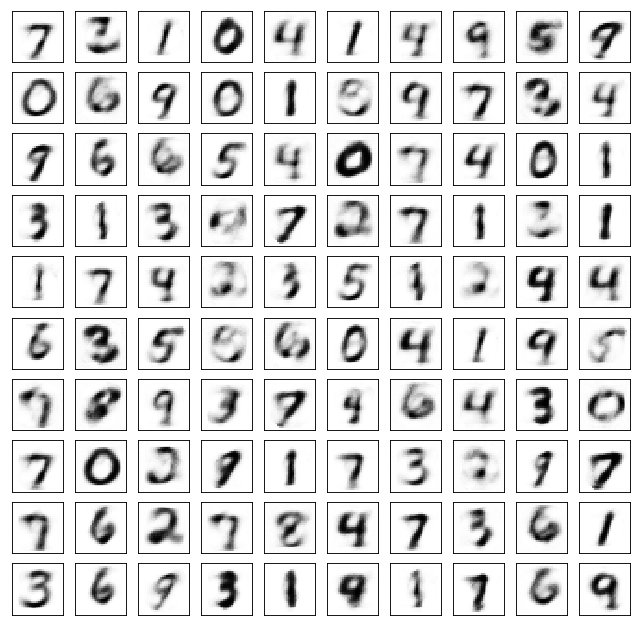

Test losses. E: 0.6781, AE: 0.1272, D: 0.6875
Train Epoch: 19 [0/50000 (0%)]	Losses E: 0.6777, AE: 0.1274, D: 0.6872
Train Epoch: 19 [25000/50000 (50%)]	Losses E: 0.5821, AE: 0.1467, D: 0.7314
Train Epoch: 19 [50000/50000 (100%)]	Losses E: 0.6676, AE: 0.1287, D: 0.7424


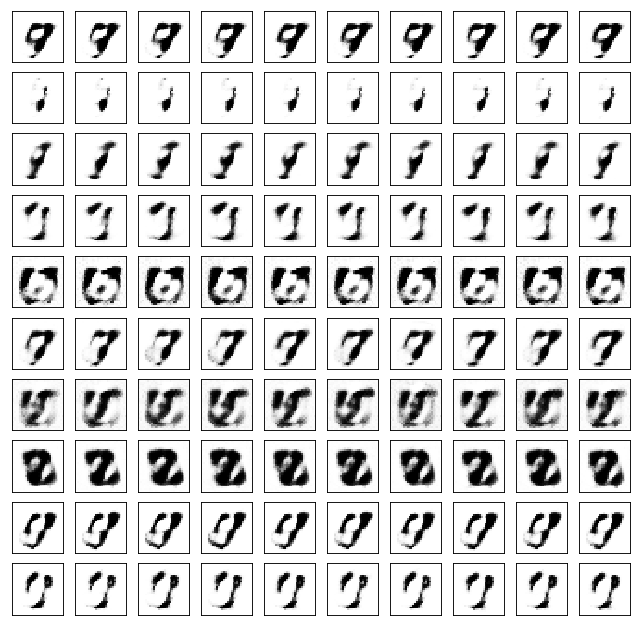

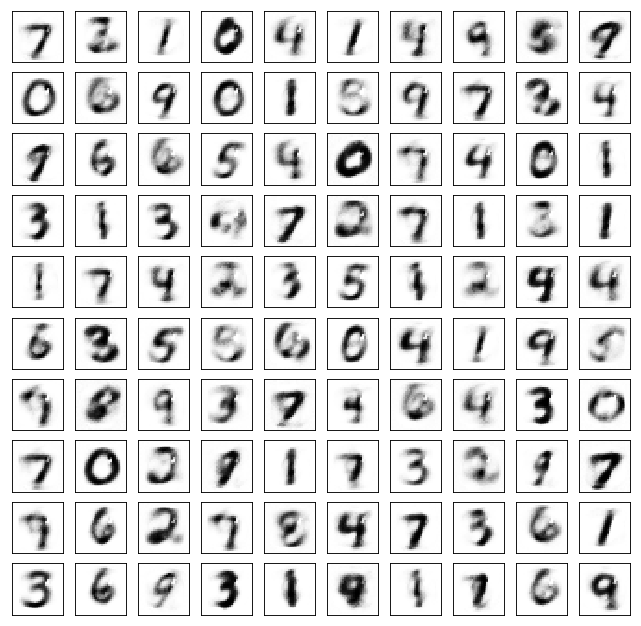

Test losses. E: 0.6669, AE: 0.1295, D: 0.7400
Train Epoch: 20 [0/50000 (0%)]	Losses E: 0.6683, AE: 0.1287, D: 0.7410
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.6845, AE: 0.1208, D: 0.6895
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 0.7069, AE: 0.1491, D: 0.6776


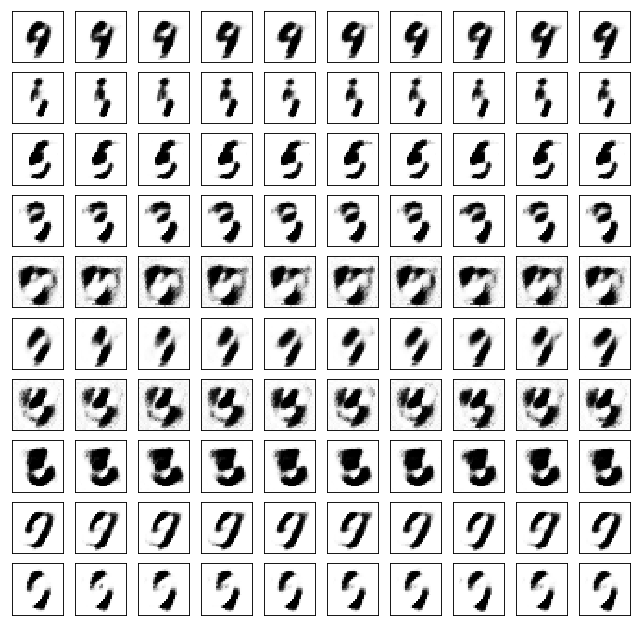

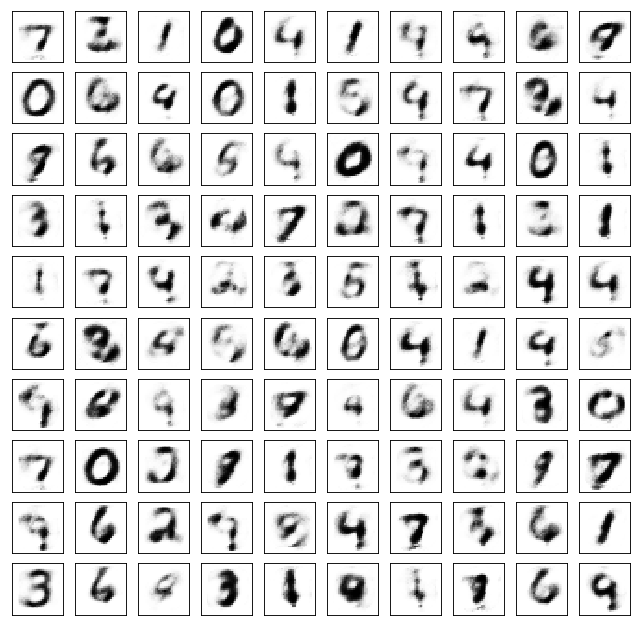

Test losses. E: 0.6801, AE: 0.1480, D: 0.6768
Train Epoch: 21 [0/50000 (0%)]	Losses E: 0.7035, AE: 0.1440, D: 0.6768
Train Epoch: 21 [25000/50000 (50%)]	Losses E: 0.6912, AE: 0.1224, D: 0.7241
Train Epoch: 21 [50000/50000 (100%)]	Losses E: 0.6950, AE: 0.1151, D: 0.6866


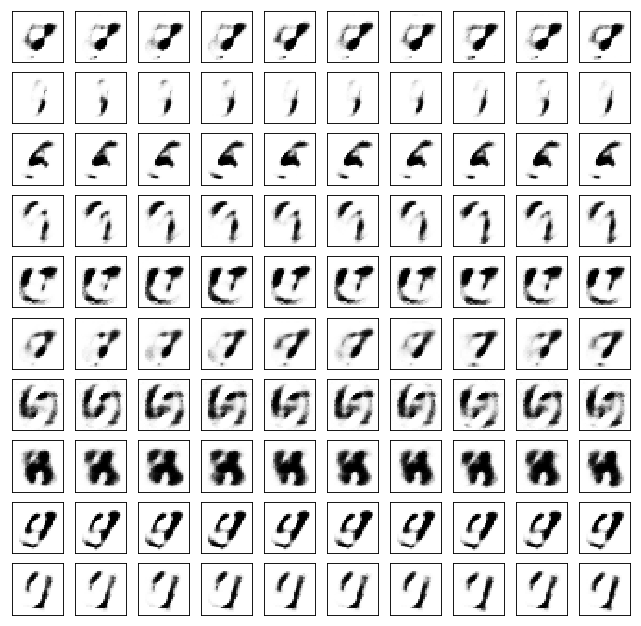

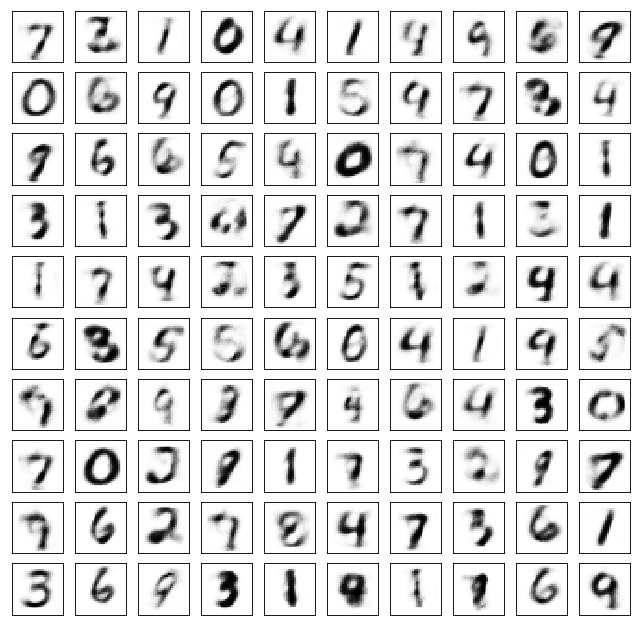

Test losses. E: 0.6913, AE: 0.1238, D: 0.6862
Train Epoch: 22 [0/50000 (0%)]	Losses E: 0.6952, AE: 0.1205, D: 0.6876
Train Epoch: 22 [25000/50000 (50%)]	Losses E: 0.6651, AE: 0.1490, D: 0.7204
Train Epoch: 22 [50000/50000 (100%)]	Losses E: 0.7182, AE: 0.1303, D: 0.7044


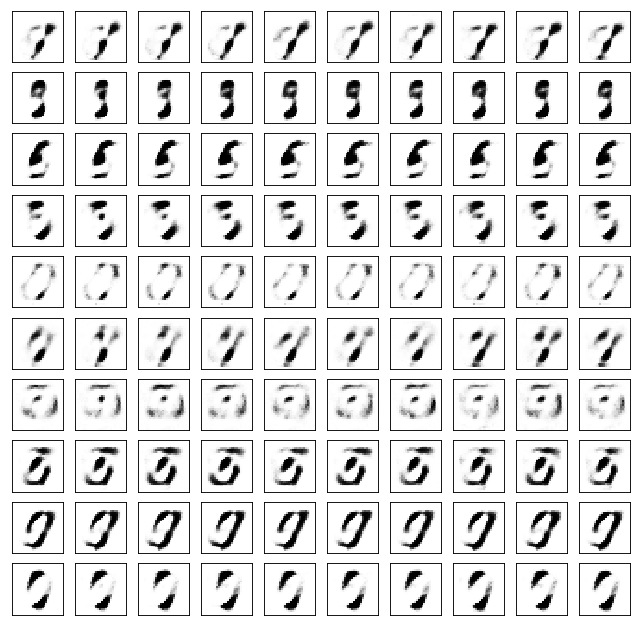

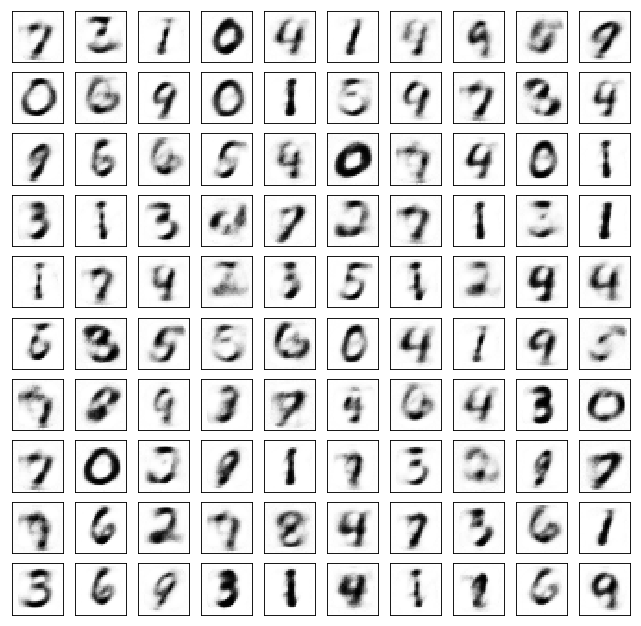

Test losses. E: 0.7152, AE: 0.1280, D: 0.7069
Train Epoch: 23 [0/50000 (0%)]	Losses E: 0.7147, AE: 0.1236, D: 0.7111
Train Epoch: 23 [25000/50000 (50%)]	Losses E: 0.6838, AE: 0.1228, D: 0.6930
Train Epoch: 23 [50000/50000 (100%)]	Losses E: 0.6336, AE: 0.1251, D: 0.7277


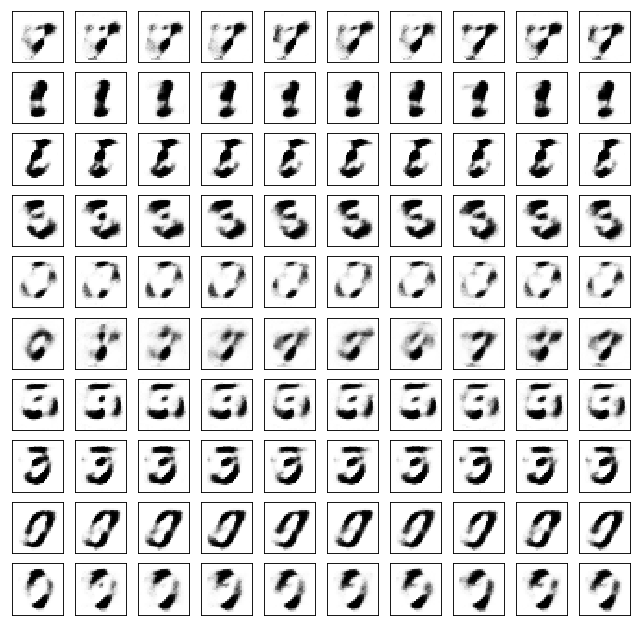

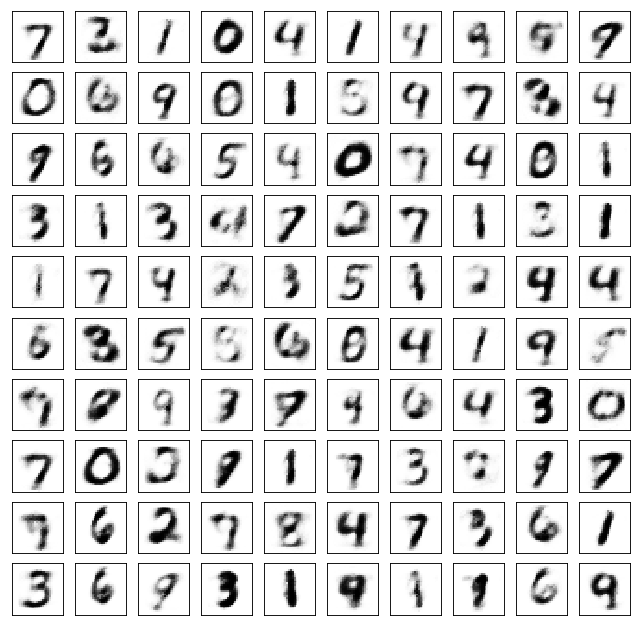

Test losses. E: 0.6315, AE: 0.1255, D: 0.7245
Train Epoch: 24 [0/50000 (0%)]	Losses E: 0.6463, AE: 0.1264, D: 0.7233
Train Epoch: 24 [25000/50000 (50%)]	Losses E: 0.7110, AE: 0.1328, D: 0.7093
Train Epoch: 24 [50000/50000 (100%)]	Losses E: 0.6606, AE: 0.1351, D: 0.7075


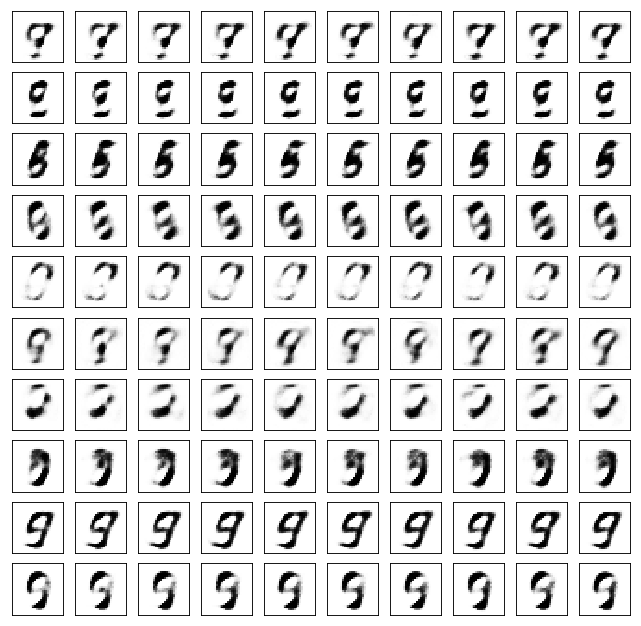

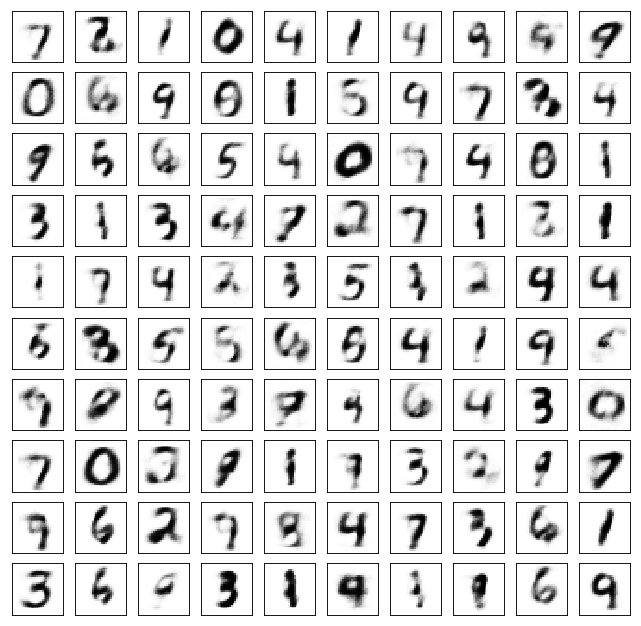

Test losses. E: 0.6525, AE: 0.1314, D: 0.7084
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.6579, AE: 0.1272, D: 0.7092
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.6859, AE: 0.1106, D: 0.6976
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.6187, AE: 0.1213, D: 0.7068


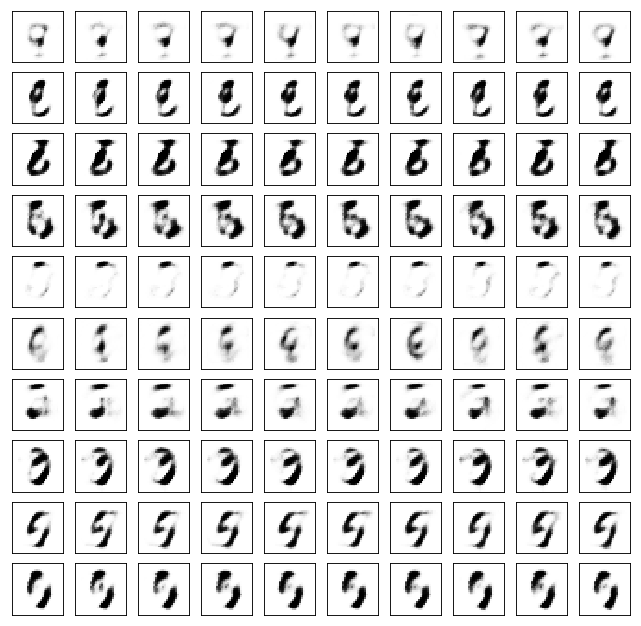

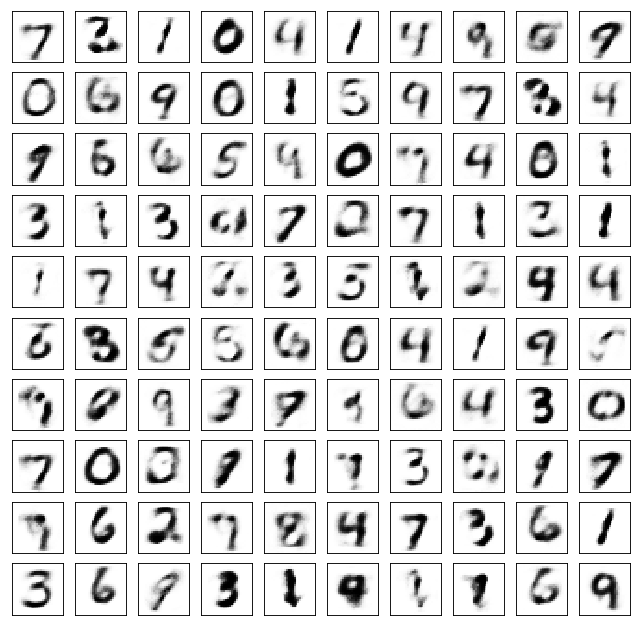

Test losses. E: 0.6190, AE: 0.1222, D: 0.7086
Train Epoch: 26 [0/50000 (0%)]	Losses E: 0.6183, AE: 0.1179, D: 0.7058
Train Epoch: 26 [25000/50000 (50%)]	Losses E: 0.7457, AE: 0.1228, D: 0.7121
Train Epoch: 26 [50000/50000 (100%)]	Losses E: 0.7011, AE: 0.1030, D: 0.6812


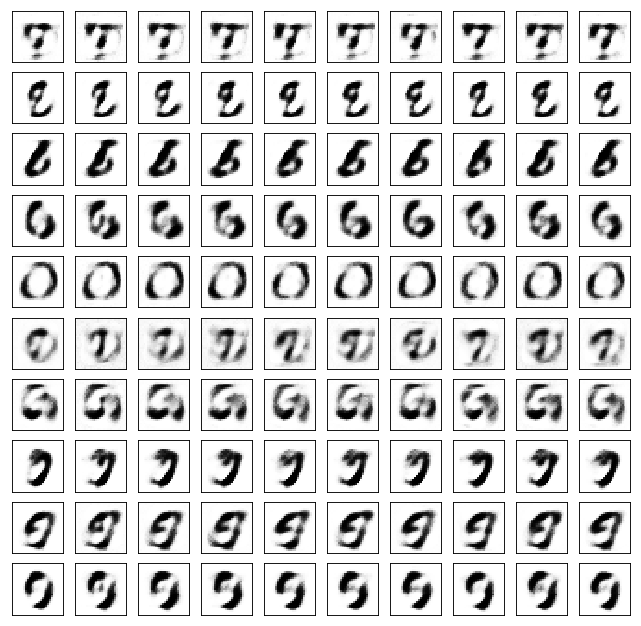

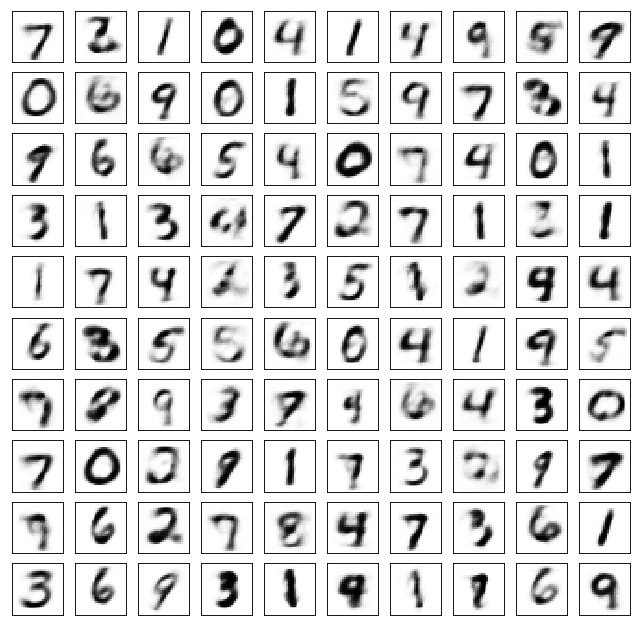

Test losses. E: 0.6990, AE: 0.1073, D: 0.6831
Train Epoch: 27 [0/50000 (0%)]	Losses E: 0.6995, AE: 0.1030, D: 0.6829
Train Epoch: 27 [25000/50000 (50%)]	Losses E: 0.6785, AE: 0.1291, D: 0.6964
Train Epoch: 27 [50000/50000 (100%)]	Losses E: 0.7449, AE: 0.1106, D: 0.7002


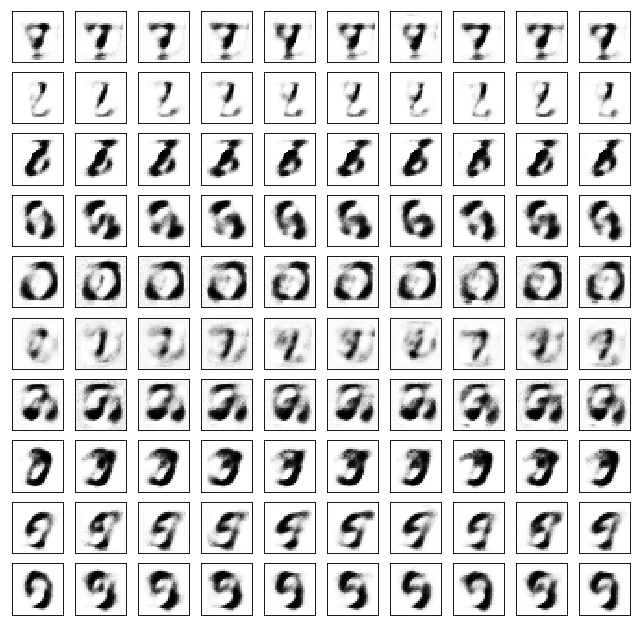

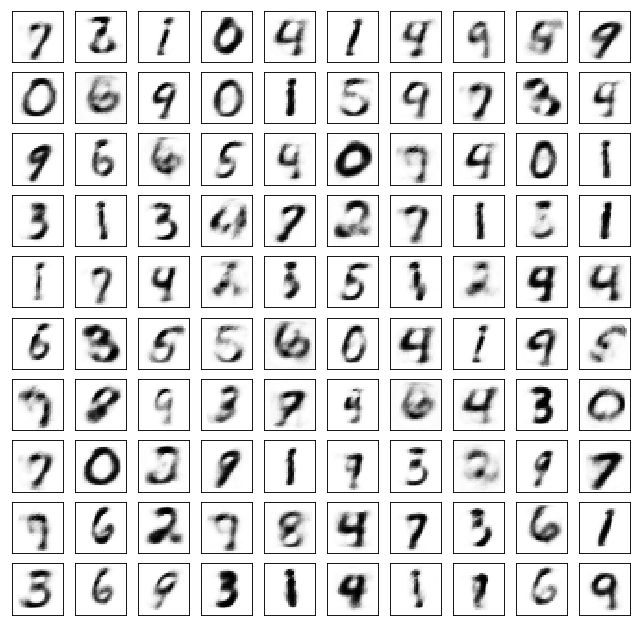

Test losses. E: 0.7429, AE: 0.1145, D: 0.7010
Train Epoch: 28 [0/50000 (0%)]	Losses E: 0.7424, AE: 0.1097, D: 0.7024
Train Epoch: 28 [25000/50000 (50%)]	Losses E: 0.6627, AE: 0.1087, D: 0.6979
Train Epoch: 28 [50000/50000 (100%)]	Losses E: 0.7218, AE: 0.1196, D: 0.6972


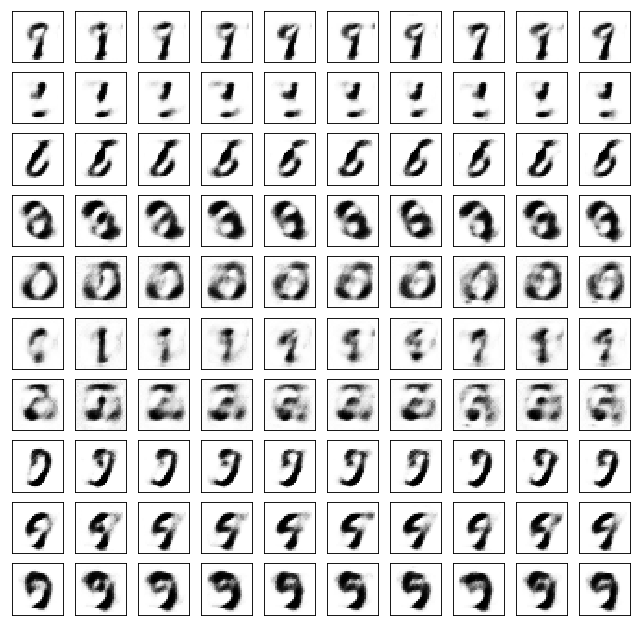

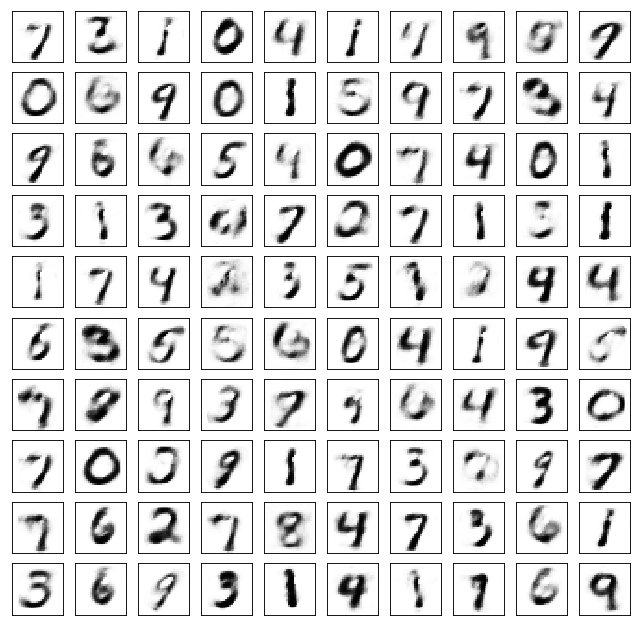

Test losses. E: 0.7203, AE: 0.1242, D: 0.6980
Train Epoch: 29 [0/50000 (0%)]	Losses E: 0.7231, AE: 0.1189, D: 0.6989
Train Epoch: 29 [25000/50000 (50%)]	Losses E: 0.6775, AE: 0.1134, D: 0.7035
Train Epoch: 29 [50000/50000 (100%)]	Losses E: 0.6812, AE: 0.1037, D: 0.6921


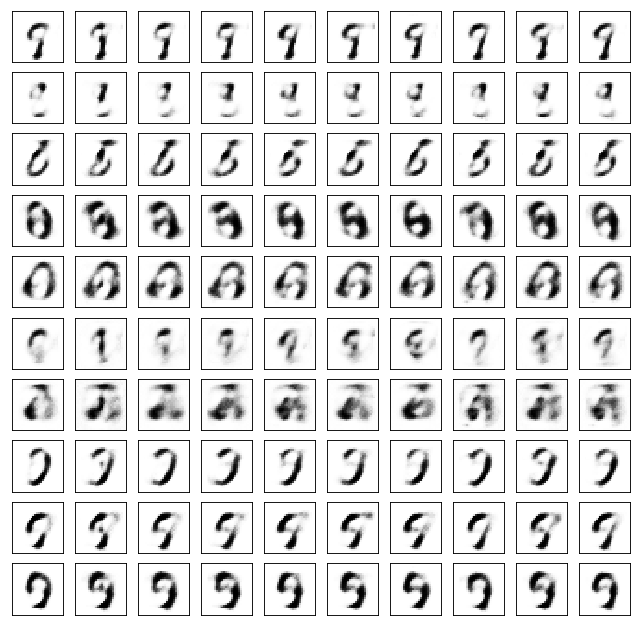

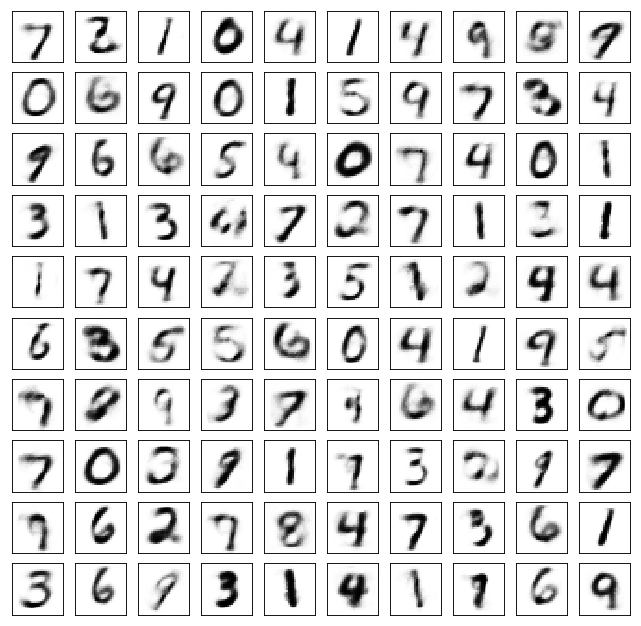

Test losses. E: 0.6775, AE: 0.1000, D: 0.6933
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.6778, AE: 0.1038, D: 0.6936
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.7022, AE: 0.0964, D: 0.6912
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.6979, AE: 0.0963, D: 0.6966


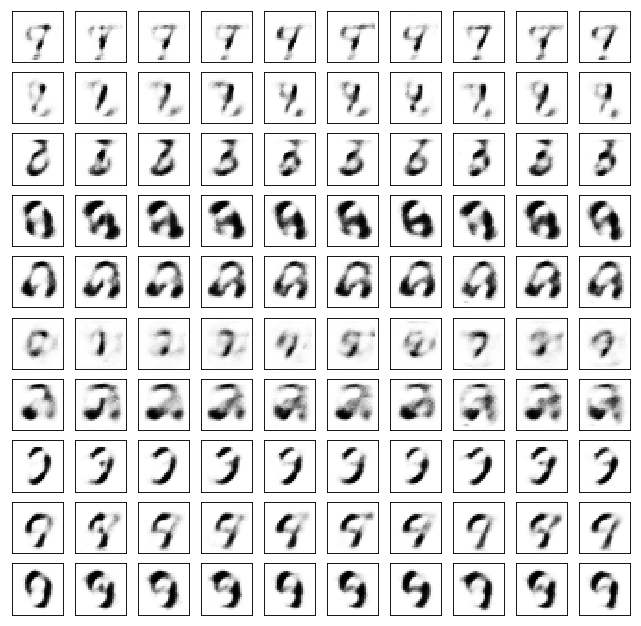

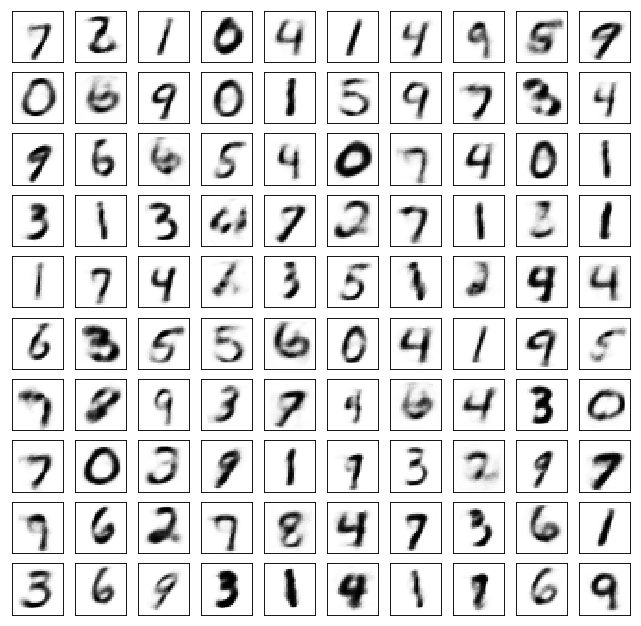

Test losses. E: 0.6961, AE: 0.0972, D: 0.6957
Train Epoch: 31 [0/50000 (0%)]	Losses E: 0.6986, AE: 0.0964, D: 0.6935
Train Epoch: 31 [25000/50000 (50%)]	Losses E: 0.7017, AE: 0.0969, D: 0.6941
Train Epoch: 31 [50000/50000 (100%)]	Losses E: 0.6954, AE: 0.0943, D: 0.6921


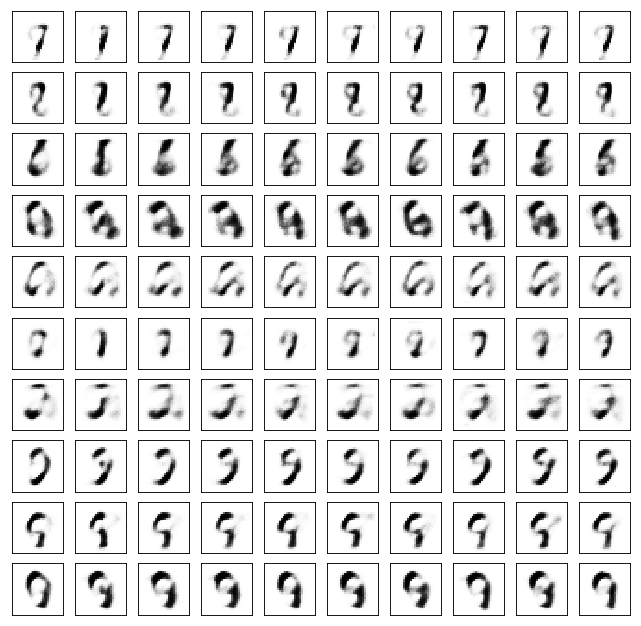

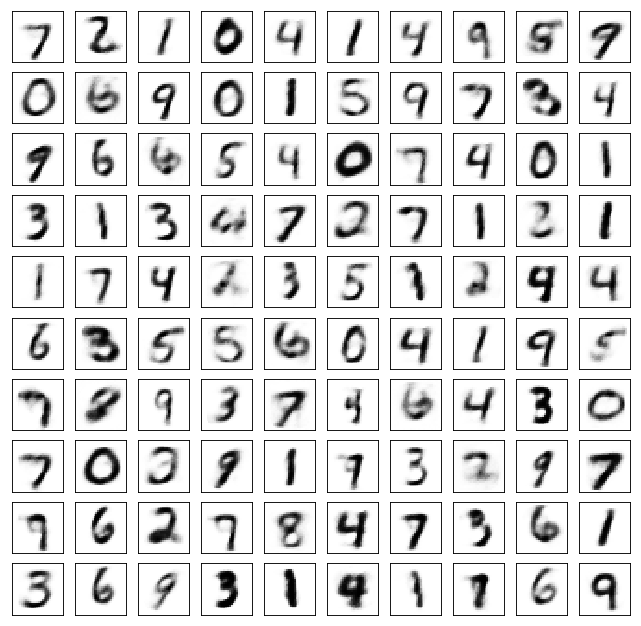

Test losses. E: 0.6925, AE: 0.0973, D: 0.6930
Train Epoch: 32 [0/50000 (0%)]	Losses E: 0.6934, AE: 0.0982, D: 0.6964
Train Epoch: 32 [25000/50000 (50%)]	Losses E: 0.6714, AE: 0.0988, D: 0.7087
Train Epoch: 32 [50000/50000 (100%)]	Losses E: 0.6703, AE: 0.0916, D: 0.6944


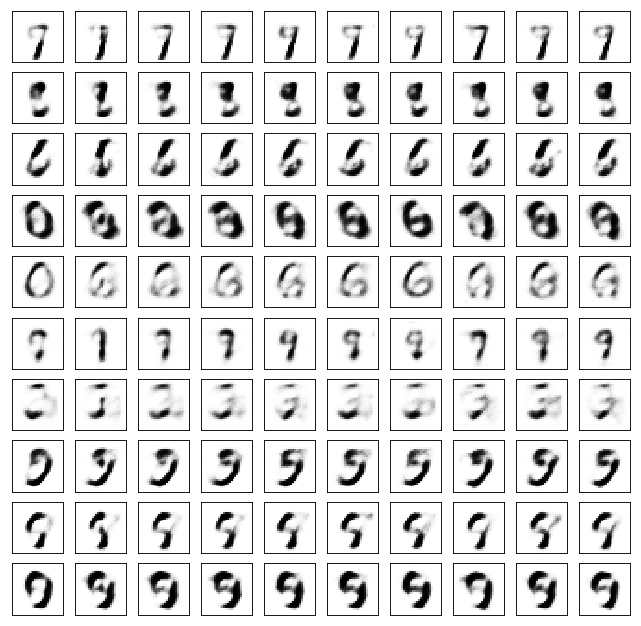

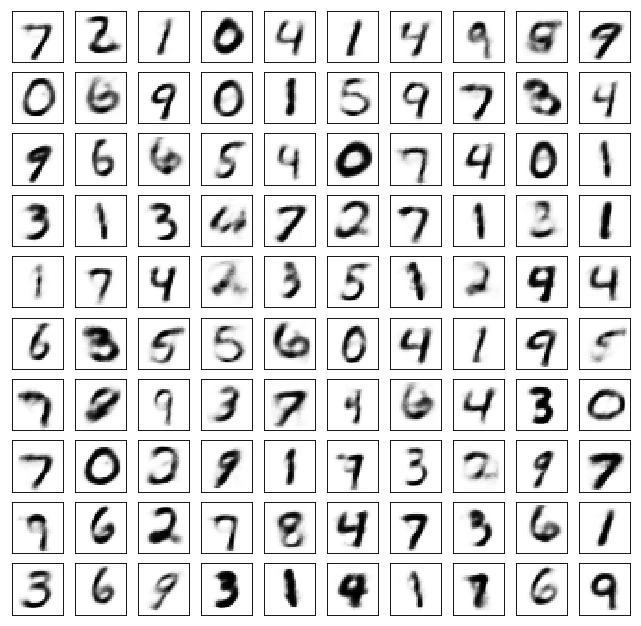

Test losses. E: 0.6694, AE: 0.0932, D: 0.6932
Train Epoch: 33 [0/50000 (0%)]	Losses E: 0.6714, AE: 0.0845, D: 0.6914
Train Epoch: 33 [25000/50000 (50%)]	Losses E: 0.7181, AE: 0.1006, D: 0.6961
Train Epoch: 33 [50000/50000 (100%)]	Losses E: 0.6909, AE: 0.0914, D: 0.6867


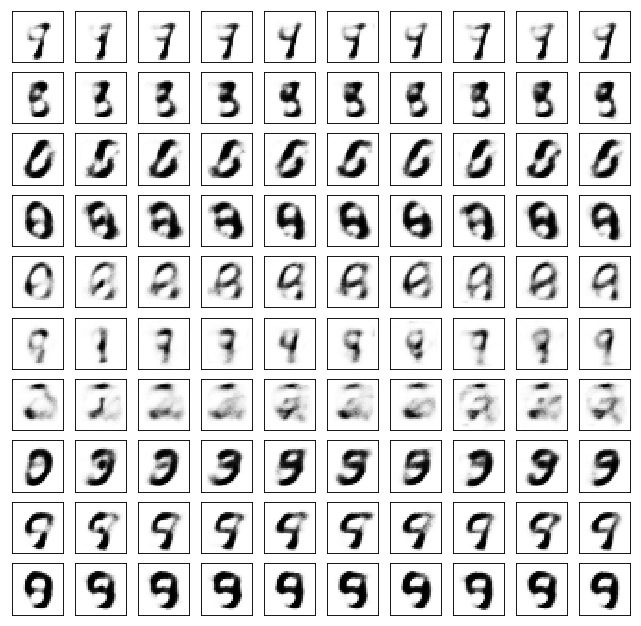

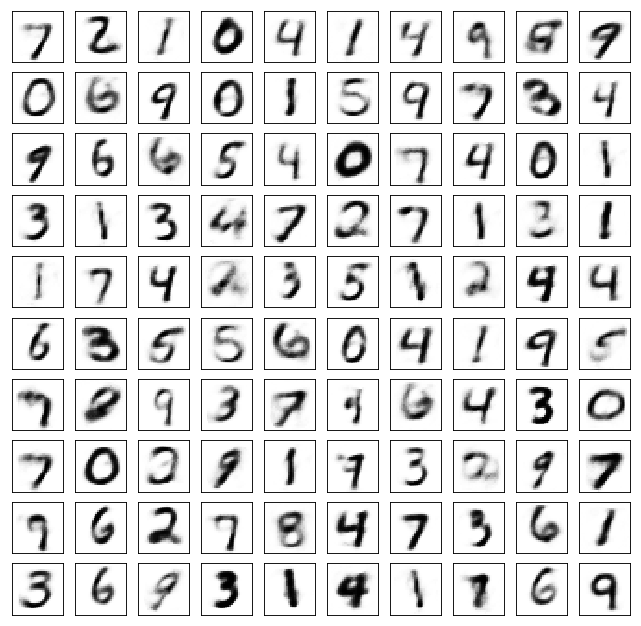

Test losses. E: 0.6900, AE: 0.0938, D: 0.6871
Train Epoch: 34 [0/50000 (0%)]	Losses E: 0.6905, AE: 0.0944, D: 0.6862
Train Epoch: 34 [25000/50000 (50%)]	Losses E: 0.7112, AE: 0.0962, D: 0.6923
Train Epoch: 34 [50000/50000 (100%)]	Losses E: 0.7061, AE: 0.1041, D: 0.6869


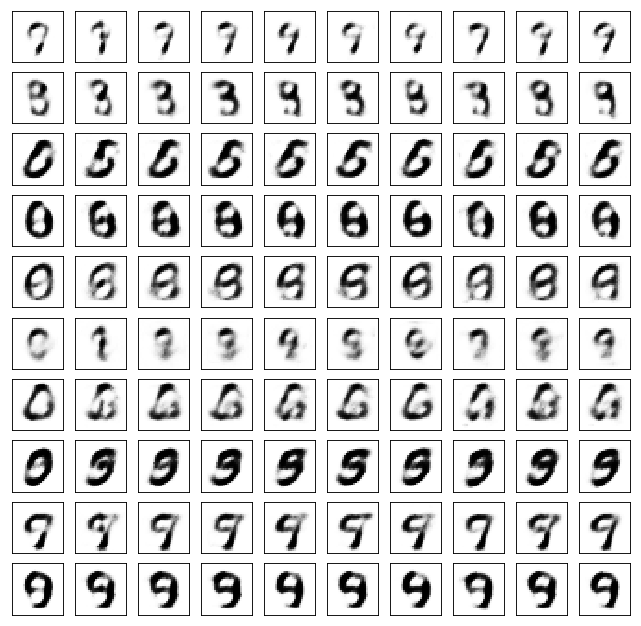

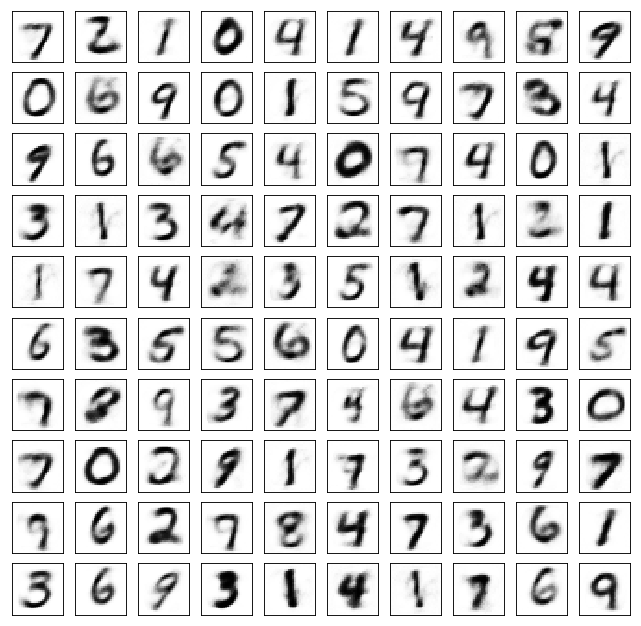

Test losses. E: 0.7021, AE: 0.1004, D: 0.6881
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.7025, AE: 0.0973, D: 0.6899
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.7446, AE: 0.1001, D: 0.6812
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.6771, AE: 0.0995, D: 0.7024


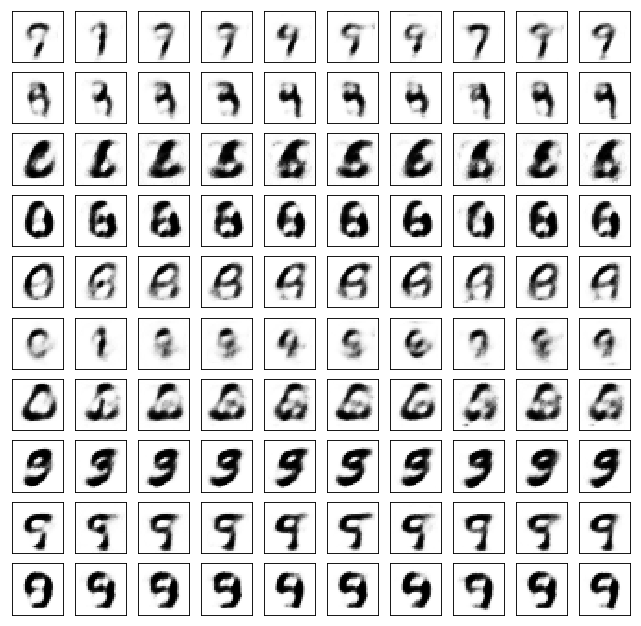

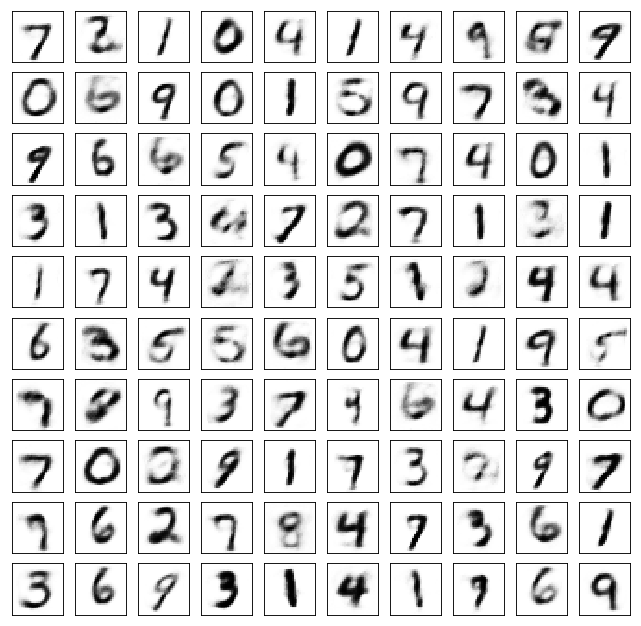

Test losses. E: 0.6733, AE: 0.1010, D: 0.7020
Train Epoch: 36 [0/50000 (0%)]	Losses E: 0.6748, AE: 0.0947, D: 0.7019
Train Epoch: 36 [25000/50000 (50%)]	Losses E: 0.7184, AE: 0.1068, D: 0.6959
Train Epoch: 36 [50000/50000 (100%)]	Losses E: 0.6846, AE: 0.1031, D: 0.7019


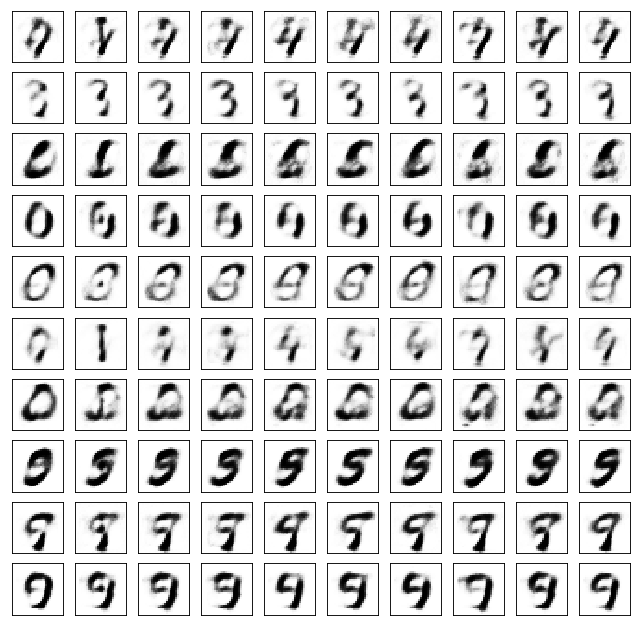

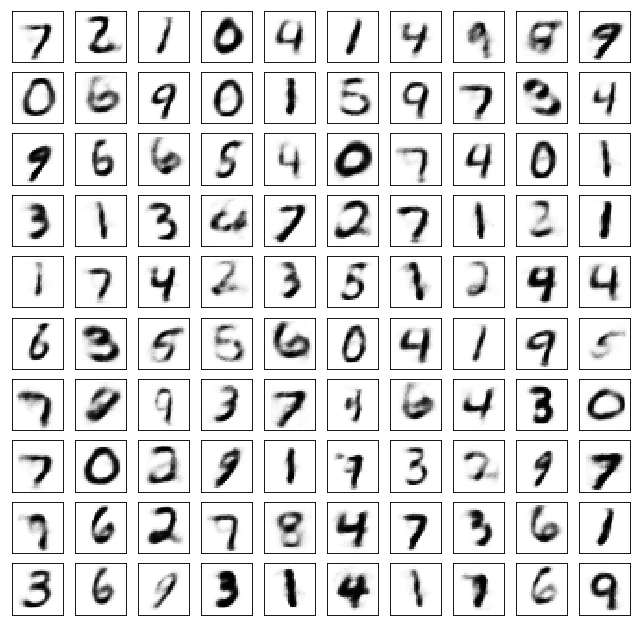

Test losses. E: 0.6830, AE: 0.0999, D: 0.6988
Train Epoch: 37 [0/50000 (0%)]	Losses E: 0.6847, AE: 0.0982, D: 0.7007
Train Epoch: 37 [25000/50000 (50%)]	Losses E: 0.6588, AE: 0.1105, D: 0.6999
Train Epoch: 37 [50000/50000 (100%)]	Losses E: 0.6857, AE: 0.0902, D: 0.6898


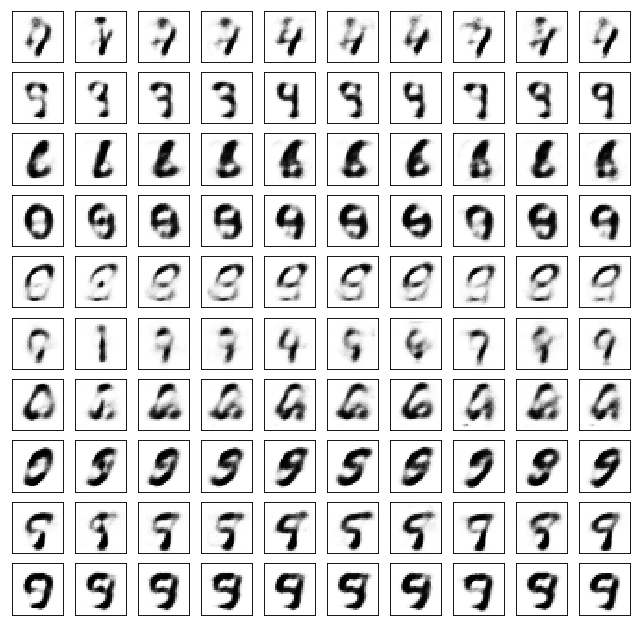

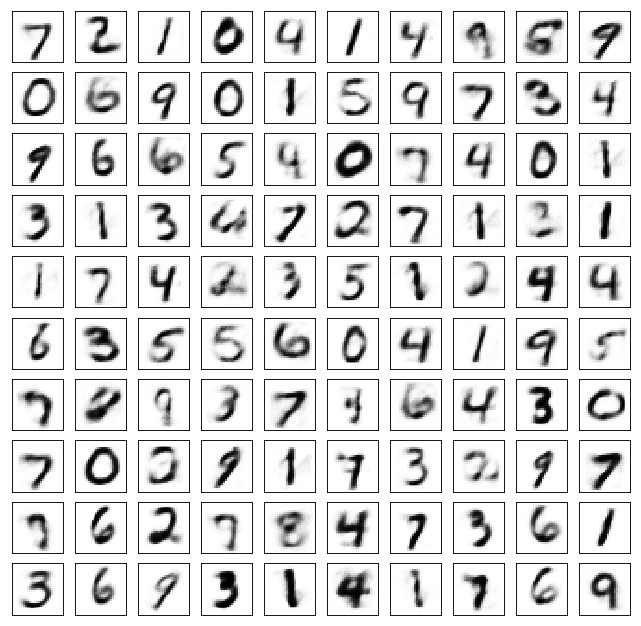

Test losses. E: 0.6844, AE: 0.0933, D: 0.6901
Train Epoch: 38 [0/50000 (0%)]	Losses E: 0.6869, AE: 0.0900, D: 0.6860
Train Epoch: 38 [25000/50000 (50%)]	Losses E: 0.7444, AE: 0.1058, D: 0.6809
Train Epoch: 38 [50000/50000 (100%)]	Losses E: 0.6562, AE: 0.1109, D: 0.7068


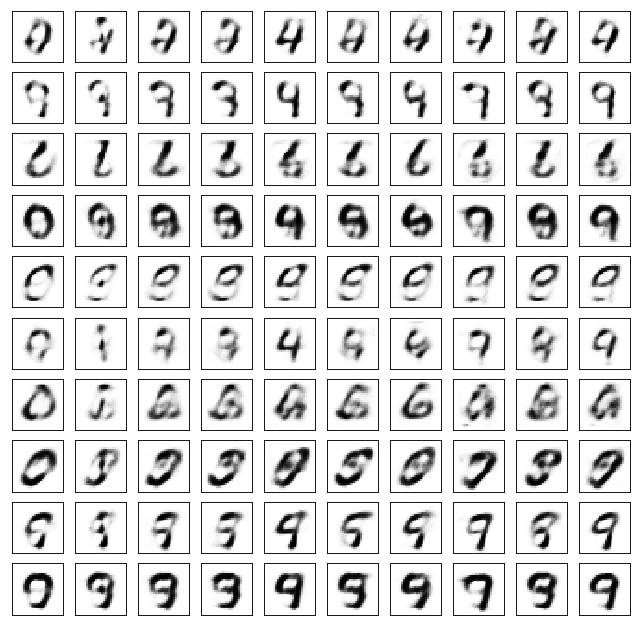

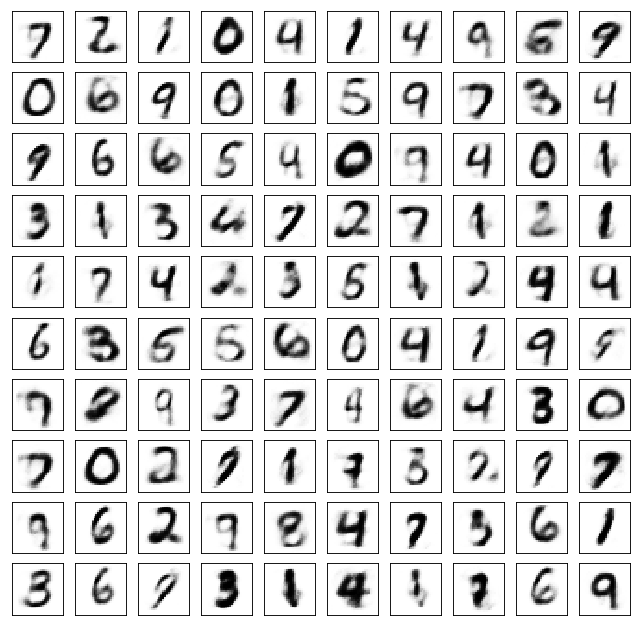

Test losses. E: 0.6552, AE: 0.1112, D: 0.7078
Train Epoch: 39 [0/50000 (0%)]	Losses E: 0.6574, AE: 0.1145, D: 0.7093
Train Epoch: 39 [25000/50000 (50%)]	Losses E: 0.6922, AE: 0.1036, D: 0.7056
Train Epoch: 39 [50000/50000 (100%)]	Losses E: 0.6695, AE: 0.0906, D: 0.6929


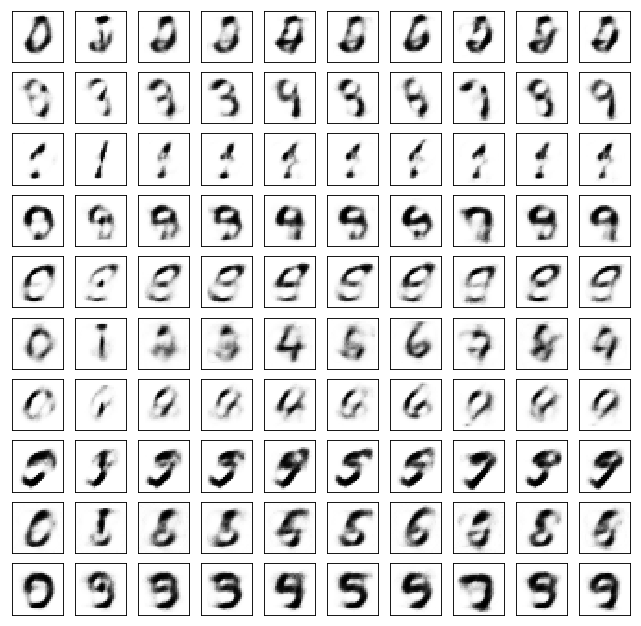

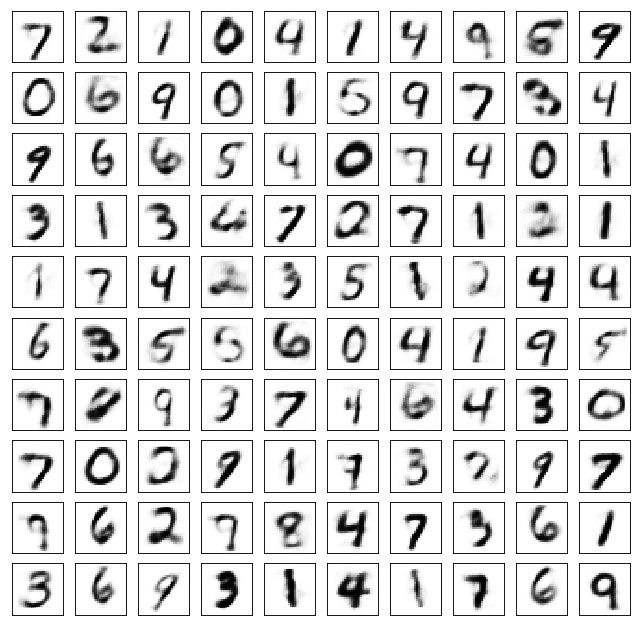

Test losses. E: 0.6702, AE: 0.0955, D: 0.6954
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.6728, AE: 0.0916, D: 0.6948
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.6941, AE: 0.0944, D: 0.6932
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.7135, AE: 0.0939, D: 0.6891


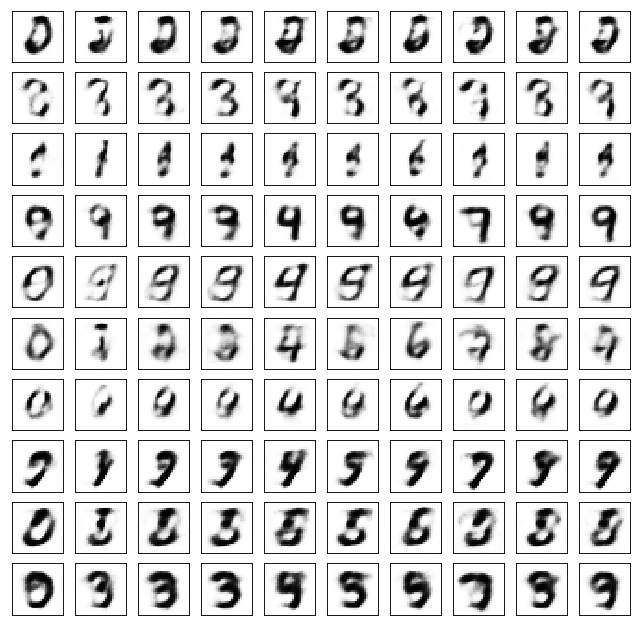

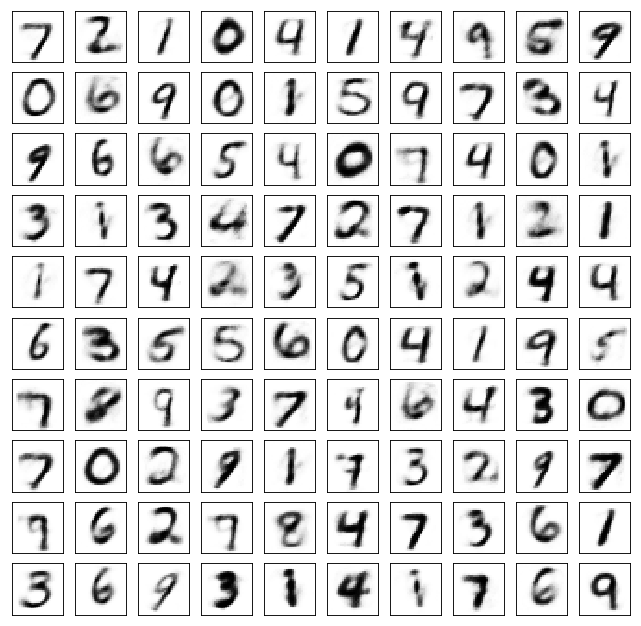

Test losses. E: 0.7141, AE: 0.0931, D: 0.6899
Train Epoch: 41 [0/50000 (0%)]	Losses E: 0.7156, AE: 0.0880, D: 0.6897
Train Epoch: 41 [25000/50000 (50%)]	Losses E: 0.7162, AE: 0.0951, D: 0.6982
Train Epoch: 41 [50000/50000 (100%)]	Losses E: 0.6499, AE: 0.1046, D: 0.7082


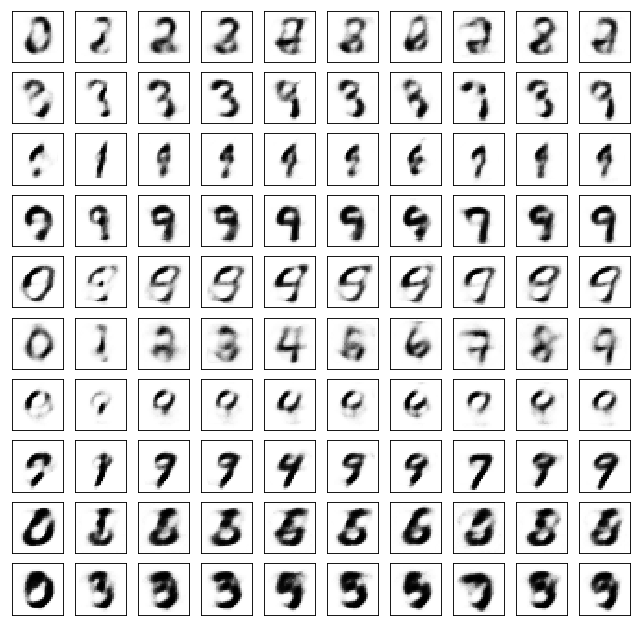

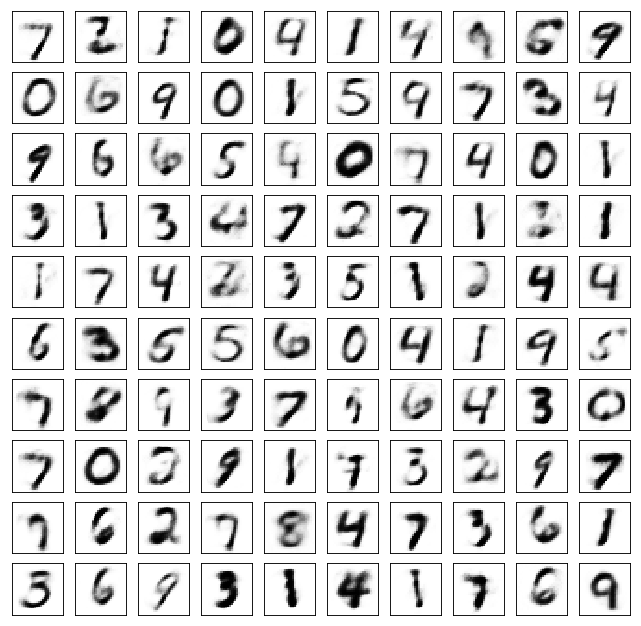

Test losses. E: 0.6458, AE: 0.1041, D: 0.7062
Train Epoch: 42 [0/50000 (0%)]	Losses E: 0.6484, AE: 0.1032, D: 0.7057
Train Epoch: 42 [25000/50000 (50%)]	Losses E: 0.6952, AE: 0.0848, D: 0.6891
Train Epoch: 42 [50000/50000 (100%)]	Losses E: 0.7260, AE: 0.1004, D: 0.7003


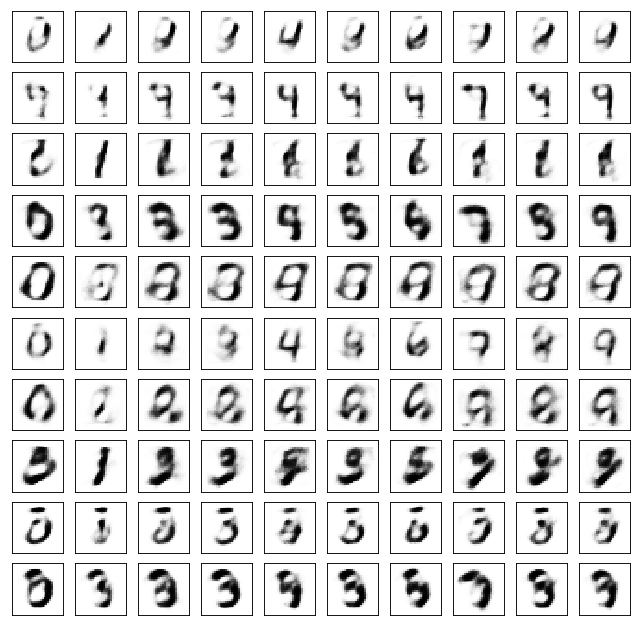

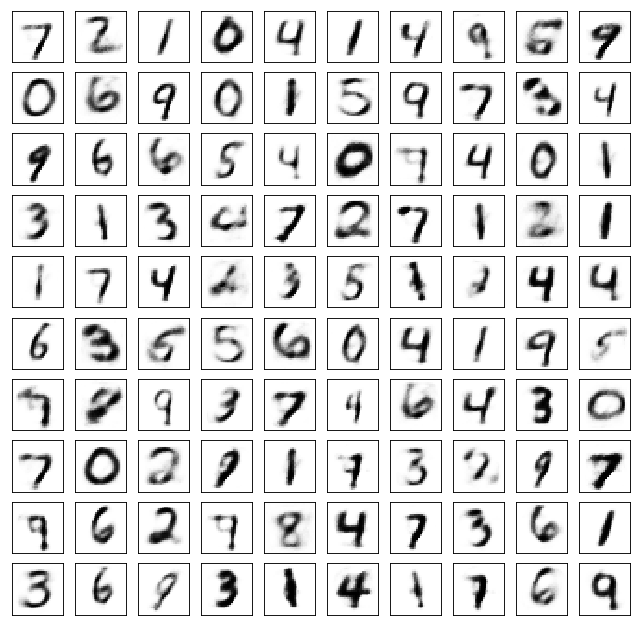

Test losses. E: 0.7253, AE: 0.1007, D: 0.6974
Train Epoch: 43 [0/50000 (0%)]	Losses E: 0.7266, AE: 0.0979, D: 0.6952
Train Epoch: 43 [25000/50000 (50%)]	Losses E: 0.6865, AE: 0.1033, D: 0.6990
Train Epoch: 43 [50000/50000 (100%)]	Losses E: 0.6849, AE: 0.0904, D: 0.6908


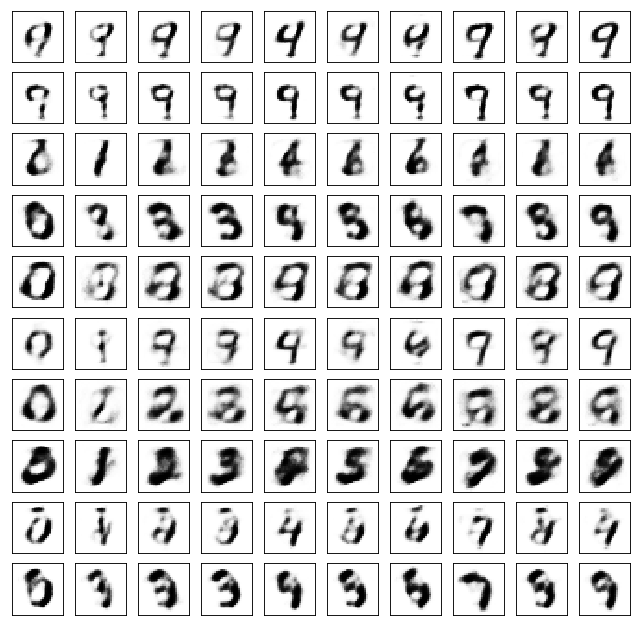

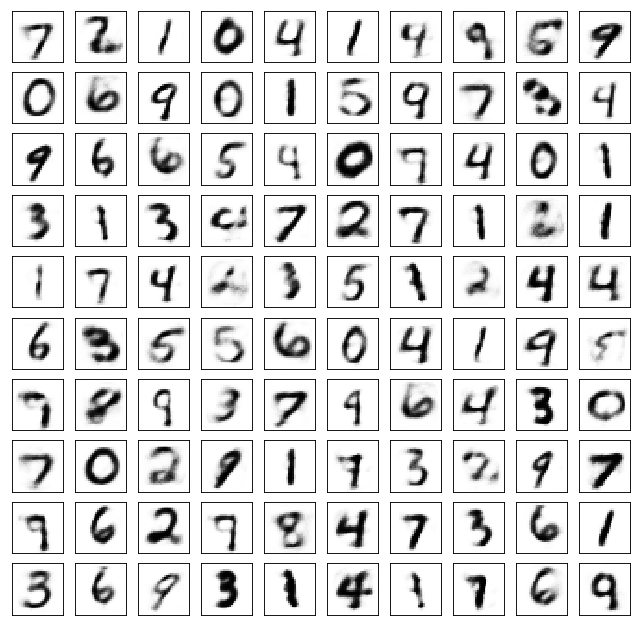

Test losses. E: 0.6833, AE: 0.0980, D: 0.6916
Train Epoch: 44 [0/50000 (0%)]	Losses E: 0.6843, AE: 0.0972, D: 0.6889
Train Epoch: 44 [25000/50000 (50%)]	Losses E: 0.6751, AE: 0.0955, D: 0.6923
Train Epoch: 44 [50000/50000 (100%)]	Losses E: 0.7148, AE: 0.0863, D: 0.6885


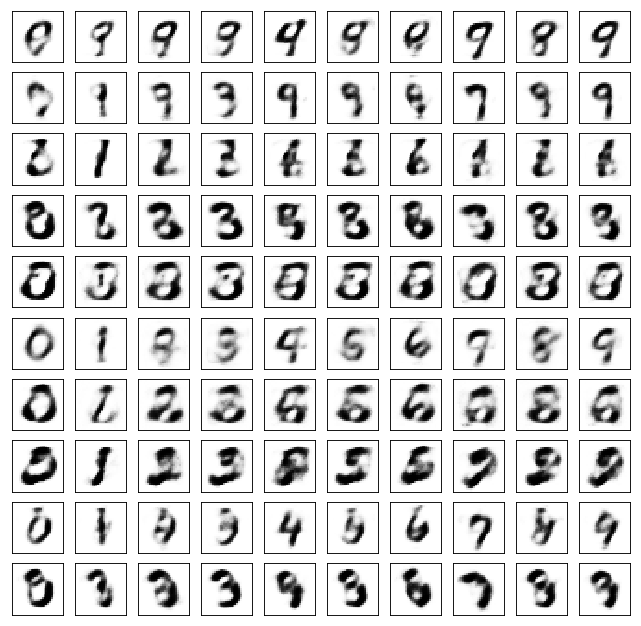

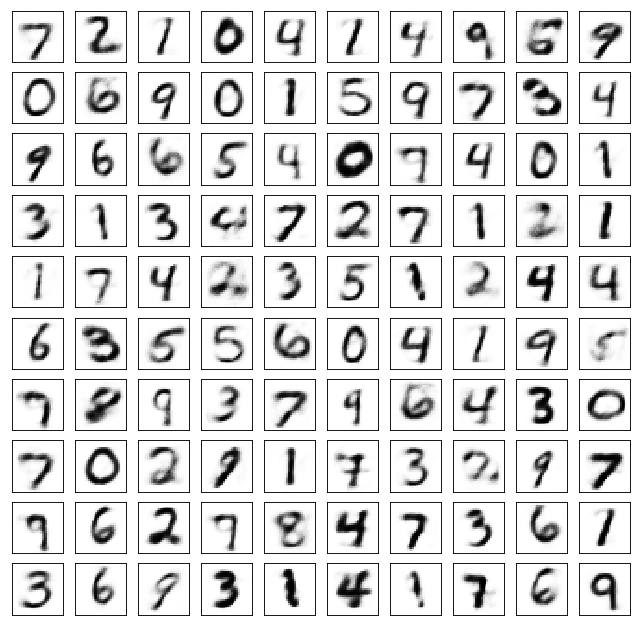

Test losses. E: 0.7133, AE: 0.0900, D: 0.6884
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.7134, AE: 0.0939, D: 0.6882
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.6817, AE: 0.0980, D: 0.6943
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.6971, AE: 0.0890, D: 0.7002


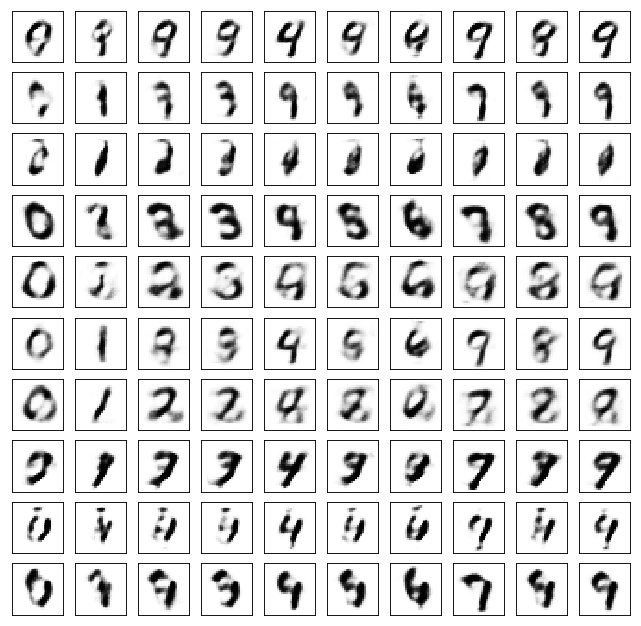

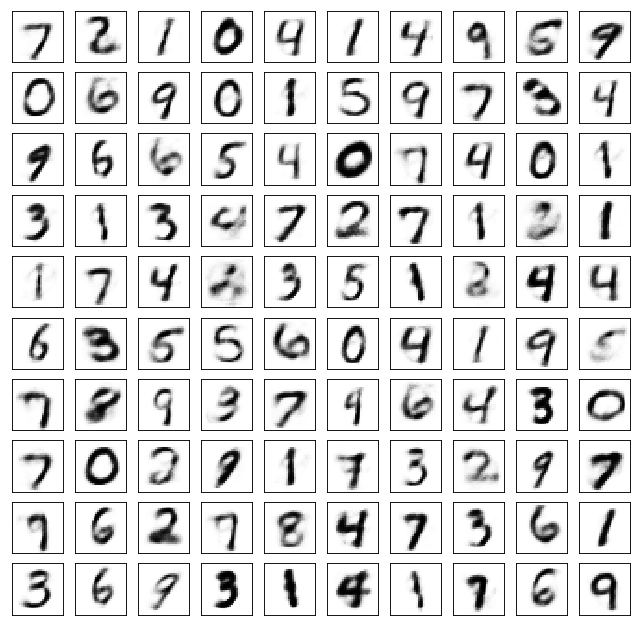

Test losses. E: 0.6938, AE: 0.0923, D: 0.6996
Train Epoch: 46 [0/50000 (0%)]	Losses E: 0.6955, AE: 0.0916, D: 0.7008
Train Epoch: 46 [25000/50000 (50%)]	Losses E: 0.6606, AE: 0.0942, D: 0.6960
Train Epoch: 46 [50000/50000 (100%)]	Losses E: 0.6744, AE: 0.0886, D: 0.6982


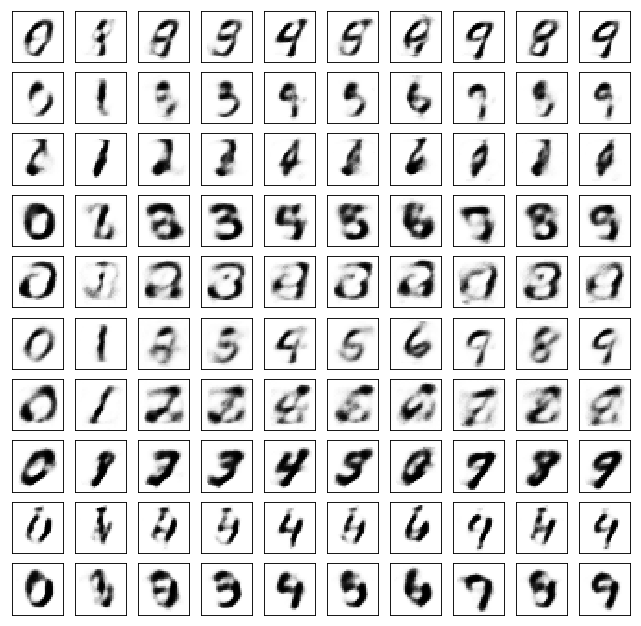

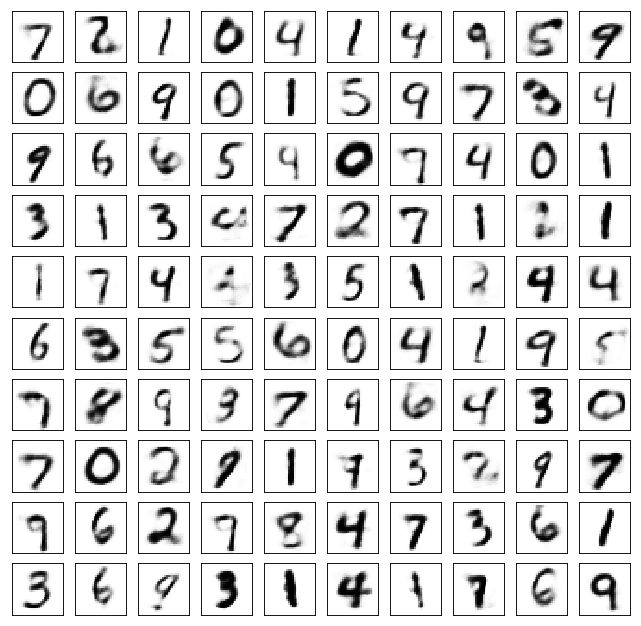

Test losses. E: 0.6725, AE: 0.0923, D: 0.6977
Train Epoch: 47 [0/50000 (0%)]	Losses E: 0.6760, AE: 0.0936, D: 0.6994
Train Epoch: 47 [25000/50000 (50%)]	Losses E: 0.6984, AE: 0.0882, D: 0.6948
Train Epoch: 47 [50000/50000 (100%)]	Losses E: 0.6798, AE: 0.0868, D: 0.6955


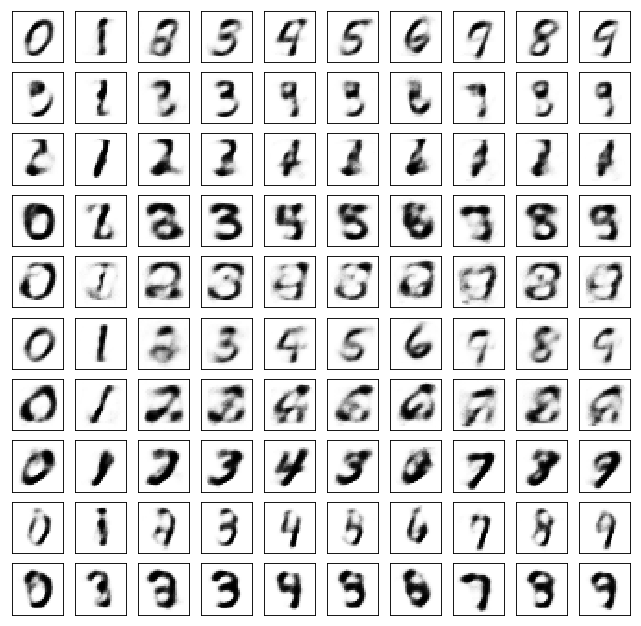

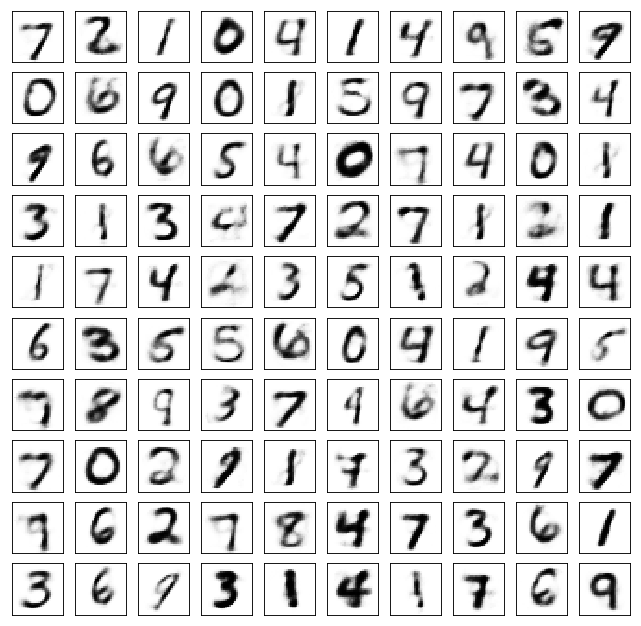

Test losses. E: 0.6759, AE: 0.0930, D: 0.6941
Train Epoch: 48 [0/50000 (0%)]	Losses E: 0.6786, AE: 0.0890, D: 0.6934
Train Epoch: 48 [25000/50000 (50%)]	Losses E: 0.6936, AE: 0.0927, D: 0.6992
Train Epoch: 48 [50000/50000 (100%)]	Losses E: 0.6729, AE: 0.0849, D: 0.6922


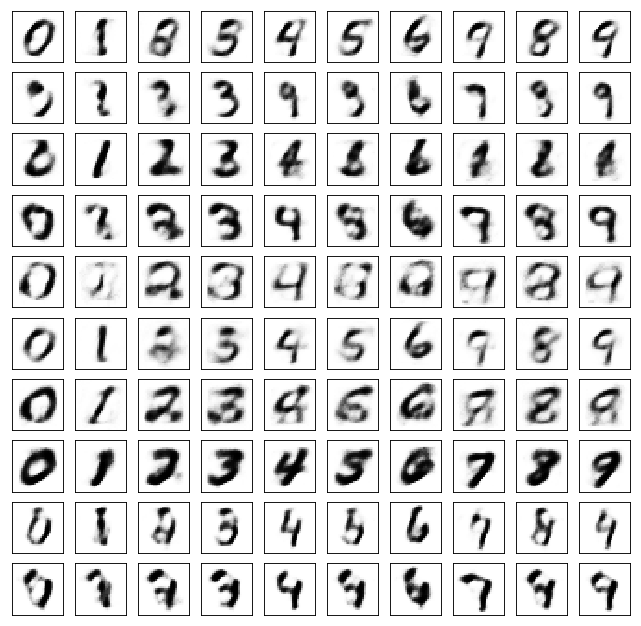

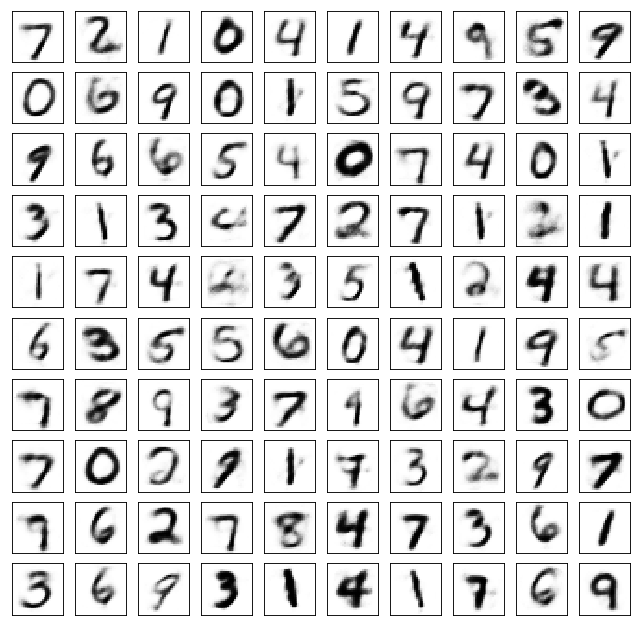

Test losses. E: 0.6695, AE: 0.0883, D: 0.6932
Train Epoch: 49 [0/50000 (0%)]	Losses E: 0.6682, AE: 0.0847, D: 0.6944
Train Epoch: 49 [25000/50000 (50%)]	Losses E: 0.6841, AE: 0.0799, D: 0.6897
Train Epoch: 49 [50000/50000 (100%)]	Losses E: 0.7042, AE: 0.0865, D: 0.6917


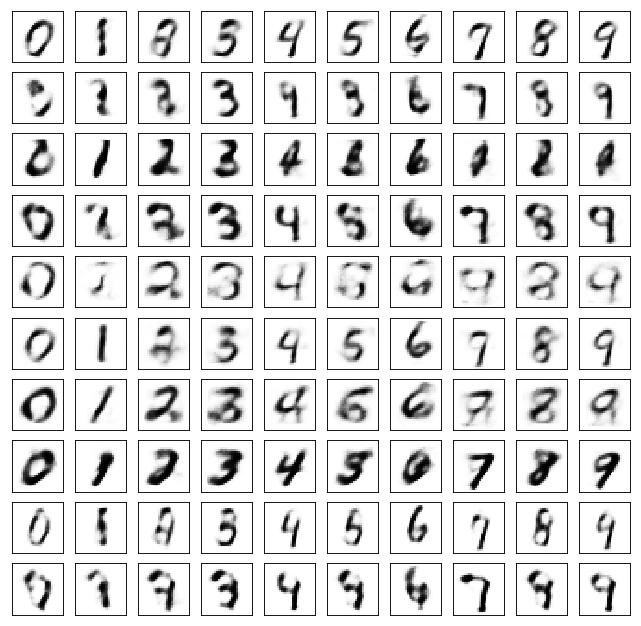

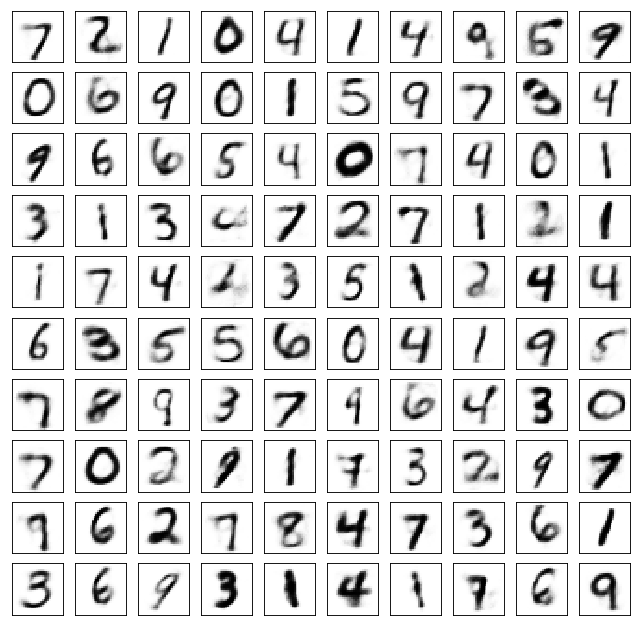

Test losses. E: 0.7006, AE: 0.0848, D: 0.6924
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.7044, AE: 0.0826, D: 0.6891
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.7016, AE: 0.0829, D: 0.6936
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.7011, AE: 0.0787, D: 0.6898


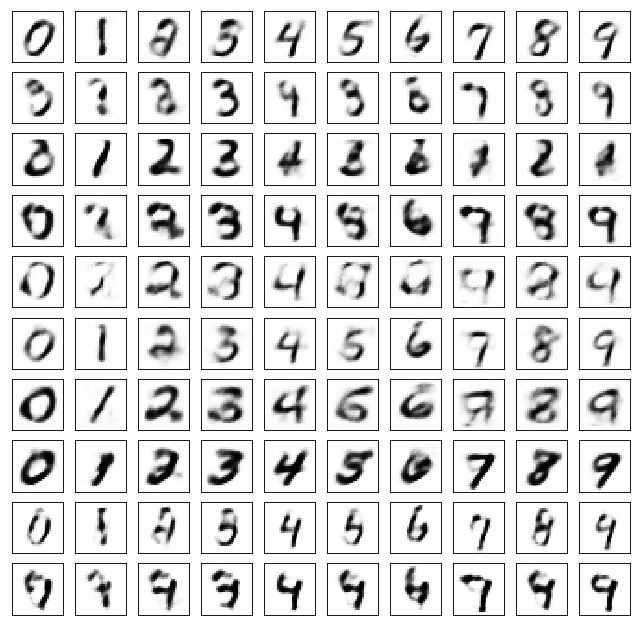

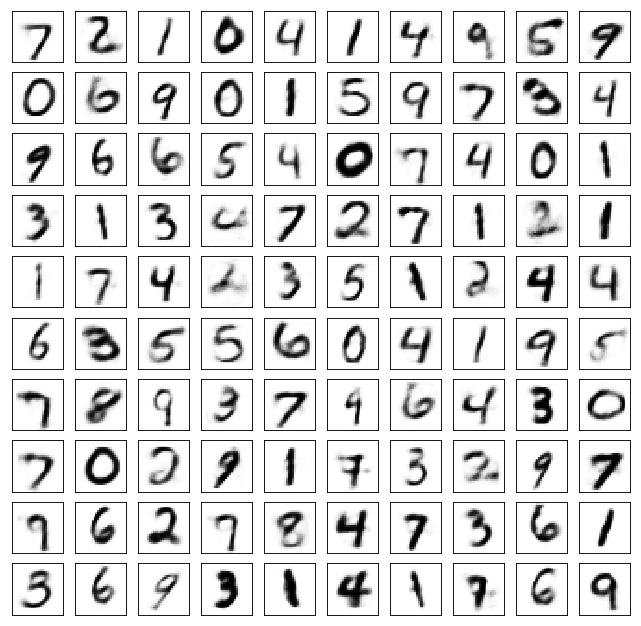

Test losses. E: 0.7000, AE: 0.0799, D: 0.6912
Train Epoch: 51 [0/50000 (0%)]	Losses E: 0.7034, AE: 0.0783, D: 0.6887
Train Epoch: 51 [25000/50000 (50%)]	Losses E: 0.7047, AE: 0.0811, D: 0.6934
Train Epoch: 51 [50000/50000 (100%)]	Losses E: 0.7159, AE: 0.0819, D: 0.6967


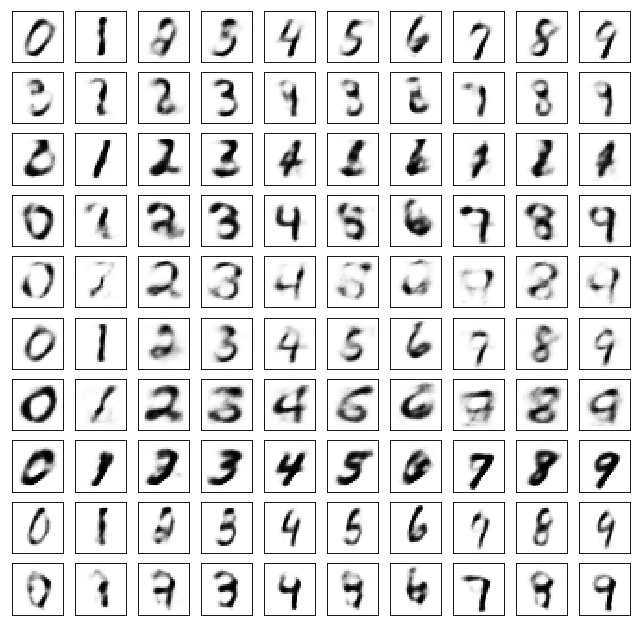

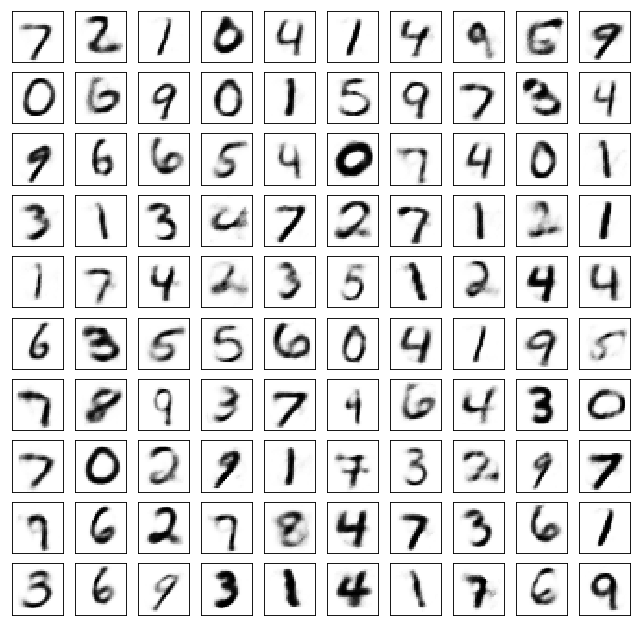

Test losses. E: 0.7140, AE: 0.0830, D: 0.6961
Train Epoch: 52 [0/50000 (0%)]	Losses E: 0.7185, AE: 0.0788, D: 0.6958
Train Epoch: 52 [25000/50000 (50%)]	Losses E: 0.6912, AE: 0.0811, D: 0.6934
Train Epoch: 52 [50000/50000 (100%)]	Losses E: 0.6828, AE: 0.0699, D: 0.6908


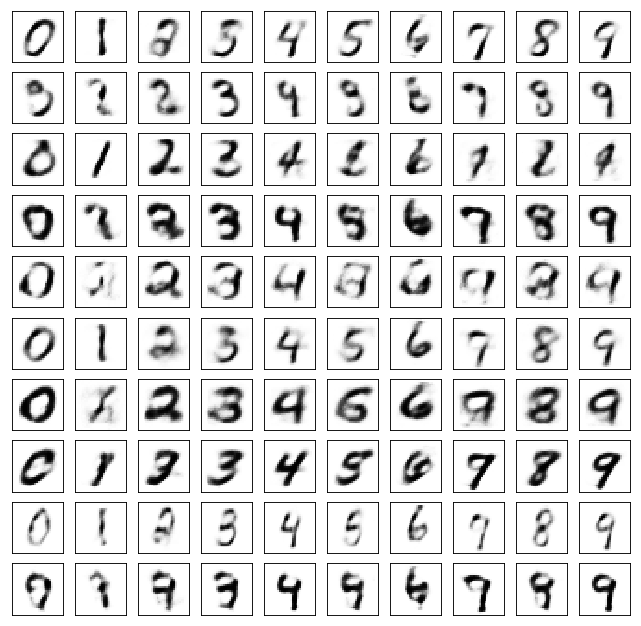

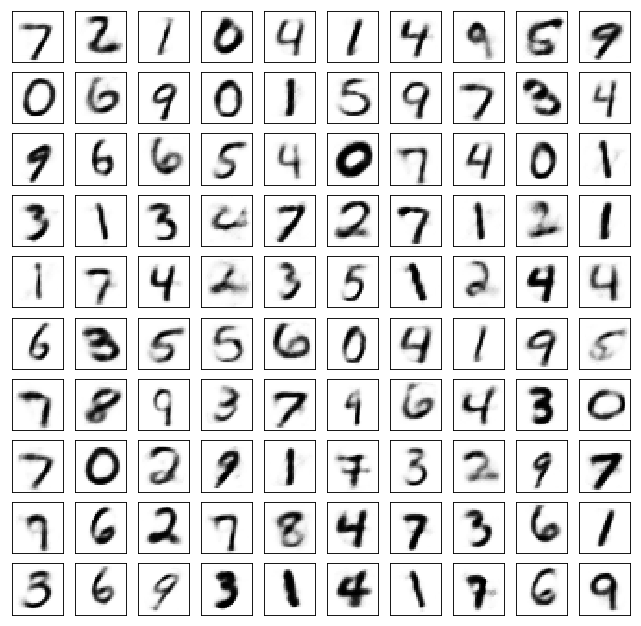

Test losses. E: 0.6812, AE: 0.0790, D: 0.6913
Train Epoch: 53 [0/50000 (0%)]	Losses E: 0.6826, AE: 0.0763, D: 0.6917
Train Epoch: 53 [25000/50000 (50%)]	Losses E: 0.6881, AE: 0.0780, D: 0.6969
Train Epoch: 53 [50000/50000 (100%)]	Losses E: 0.7016, AE: 0.0827, D: 0.6938


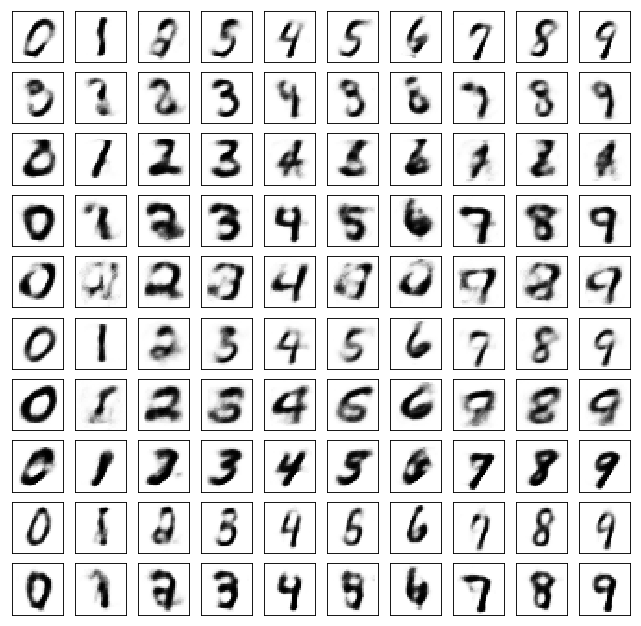

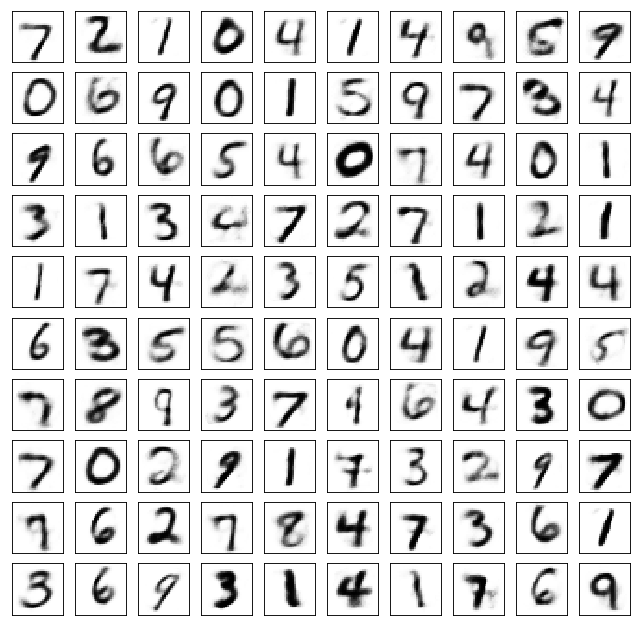

Test losses. E: 0.6983, AE: 0.0807, D: 0.6957
Train Epoch: 54 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0771, D: 0.6952
Train Epoch: 54 [25000/50000 (50%)]	Losses E: 0.6980, AE: 0.0863, D: 0.6961
Train Epoch: 54 [50000/50000 (100%)]	Losses E: 0.7092, AE: 0.0737, D: 0.6931


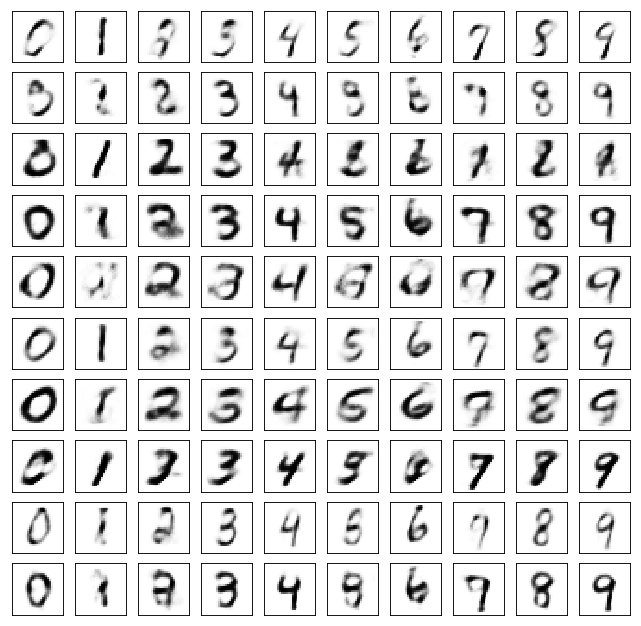

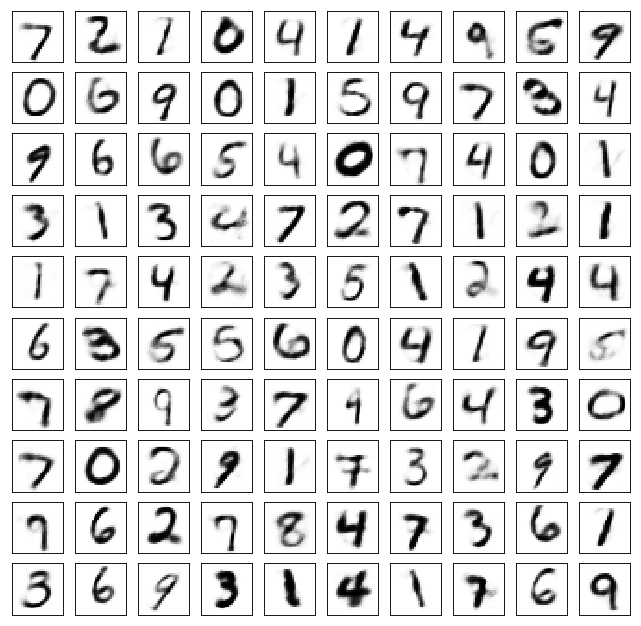

Test losses. E: 0.7108, AE: 0.0767, D: 0.6918
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.7129, AE: 0.0738, D: 0.6933
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.6798, AE: 0.0776, D: 0.6940
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.7016, AE: 0.0766, D: 0.6929


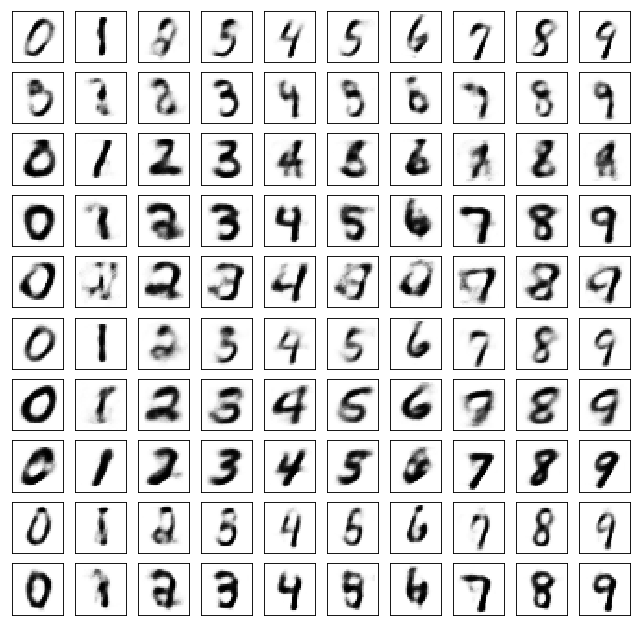

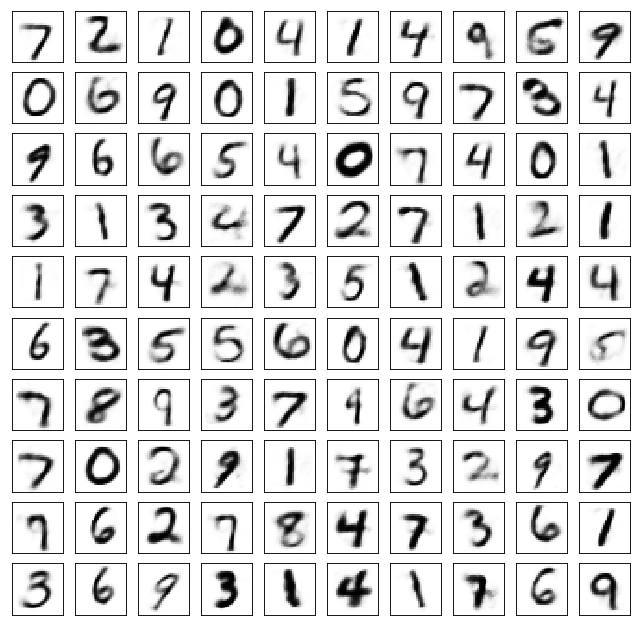

Test losses. E: 0.7020, AE: 0.0752, D: 0.6928
Train Epoch: 56 [0/50000 (0%)]	Losses E: 0.7044, AE: 0.0703, D: 0.6902
Train Epoch: 56 [25000/50000 (50%)]	Losses E: 0.6908, AE: 0.0787, D: 0.6954
Train Epoch: 56 [50000/50000 (100%)]	Losses E: 0.6900, AE: 0.0743, D: 0.6944


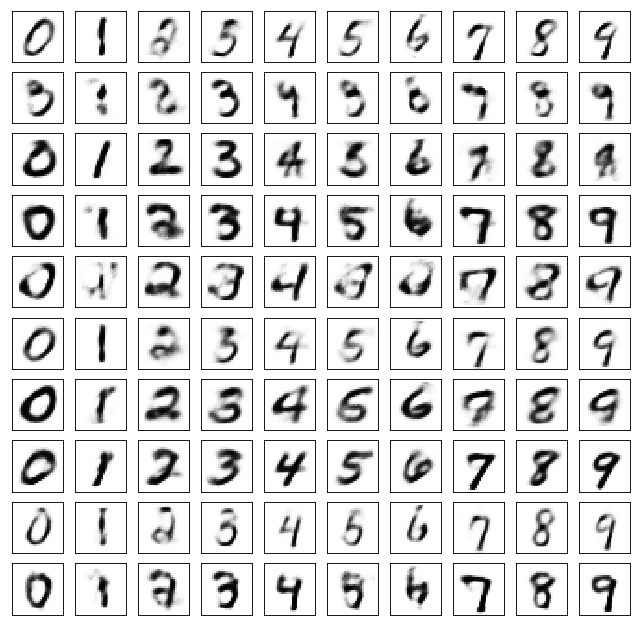

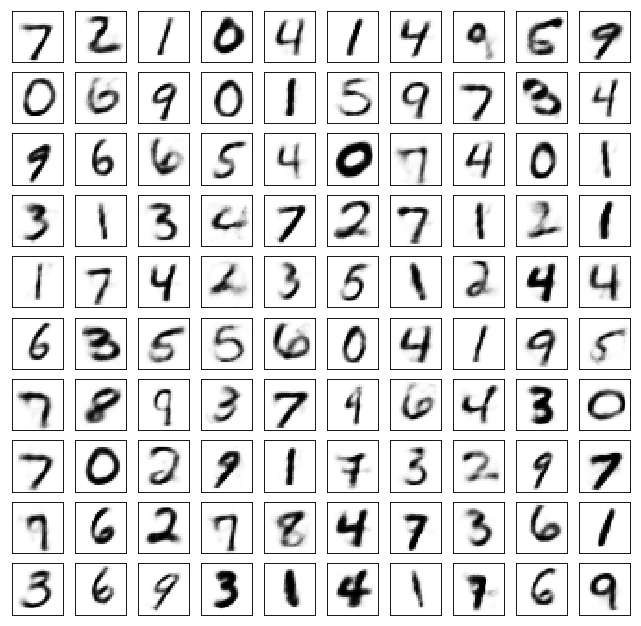

Test losses. E: 0.6922, AE: 0.0769, D: 0.6934
Train Epoch: 57 [0/50000 (0%)]	Losses E: 0.6968, AE: 0.0788, D: 0.6925
Train Epoch: 57 [25000/50000 (50%)]	Losses E: 0.6889, AE: 0.0776, D: 0.6924
Train Epoch: 57 [50000/50000 (100%)]	Losses E: 0.7263, AE: 0.0752, D: 0.6945


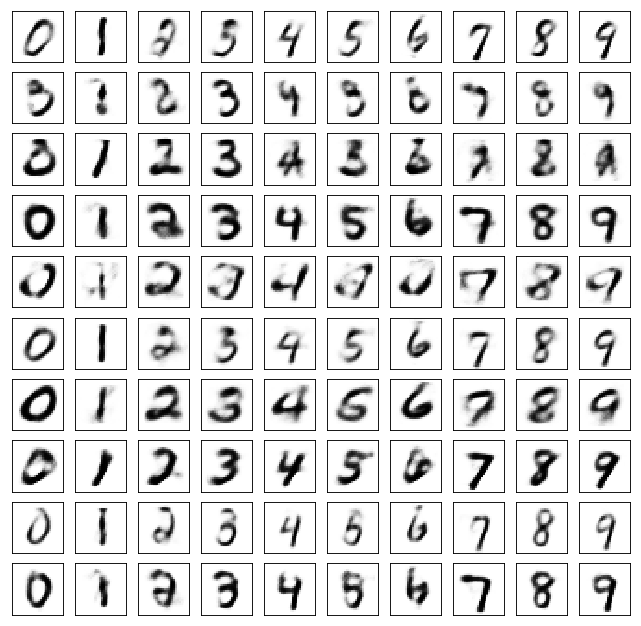

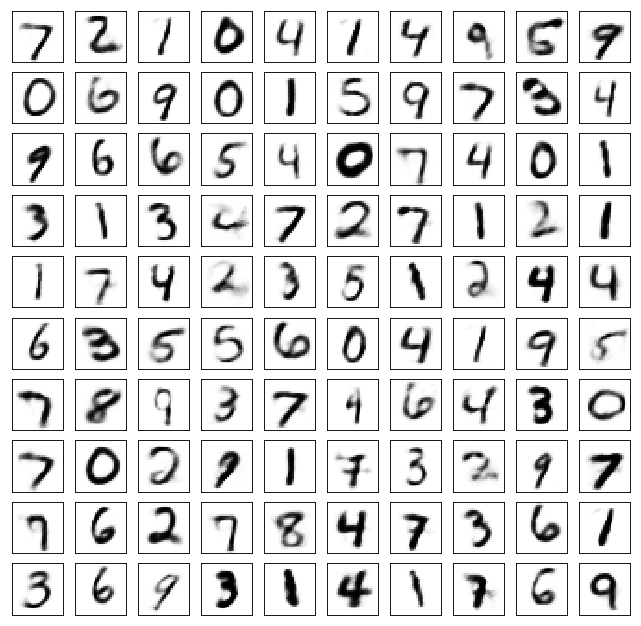

Test losses. E: 0.7259, AE: 0.0765, D: 0.6935
Train Epoch: 58 [0/50000 (0%)]	Losses E: 0.7259, AE: 0.0727, D: 0.6930
Train Epoch: 58 [25000/50000 (50%)]	Losses E: 0.6926, AE: 0.0685, D: 0.6917
Train Epoch: 58 [50000/50000 (100%)]	Losses E: 0.6970, AE: 0.0726, D: 0.6947


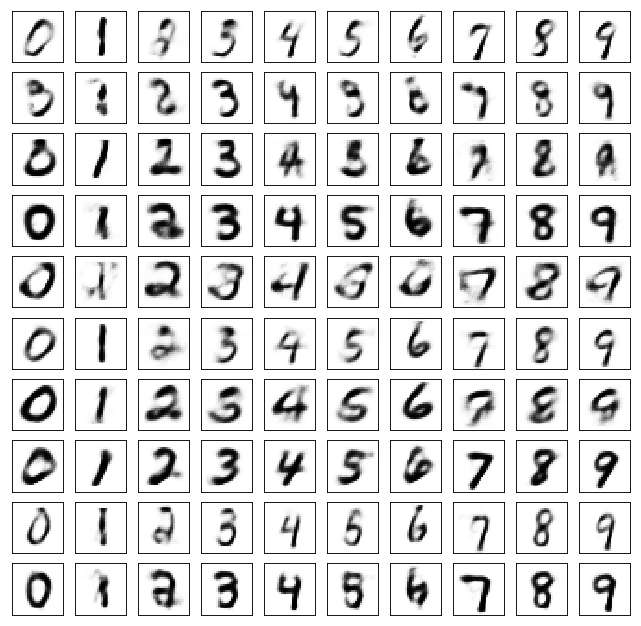

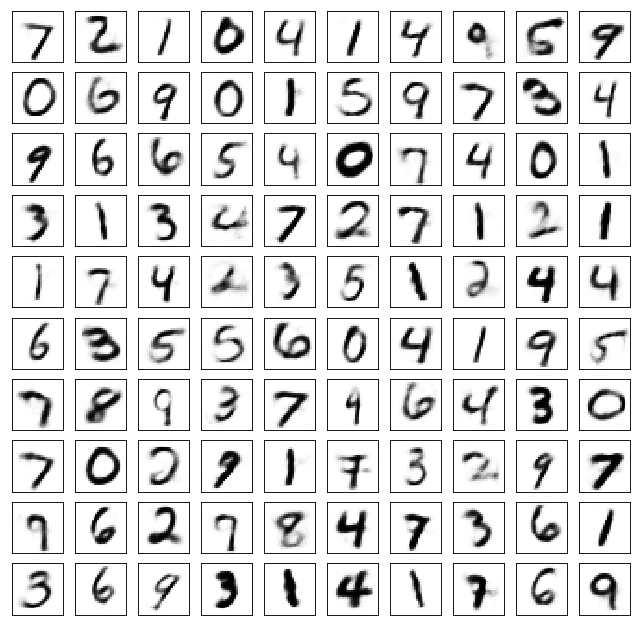

Test losses. E: 0.6956, AE: 0.0741, D: 0.6944
Train Epoch: 59 [0/50000 (0%)]	Losses E: 0.6962, AE: 0.0728, D: 0.6960
Train Epoch: 59 [25000/50000 (50%)]	Losses E: 0.7114, AE: 0.0696, D: 0.6935
Train Epoch: 59 [50000/50000 (100%)]	Losses E: 0.7036, AE: 0.0748, D: 0.6935


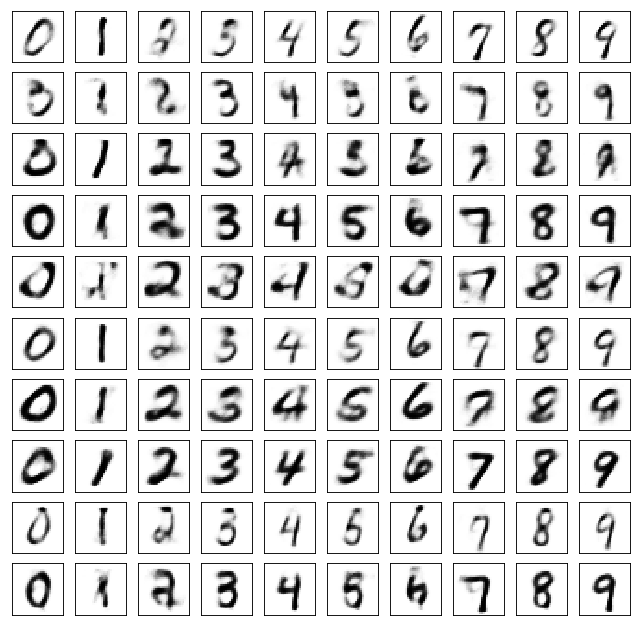

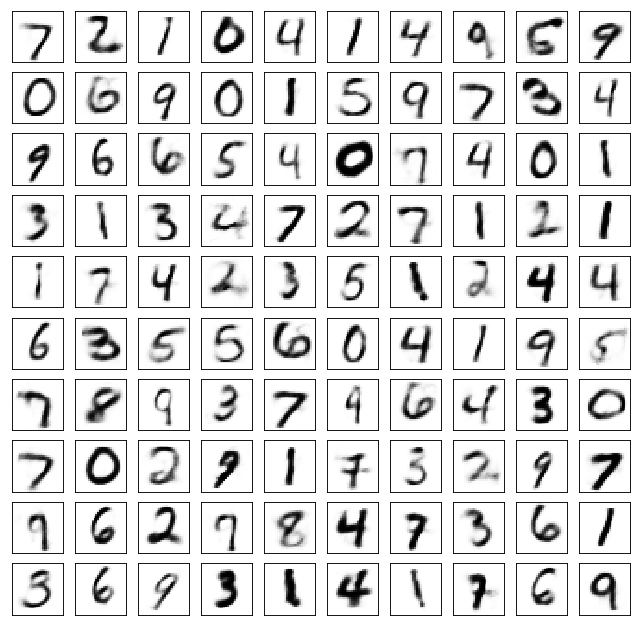

Test losses. E: 0.7045, AE: 0.0763, D: 0.6928
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.7078, AE: 0.0737, D: 0.6926
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.7126, AE: 0.0737, D: 0.6951
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.7206, AE: 0.0736, D: 0.6923


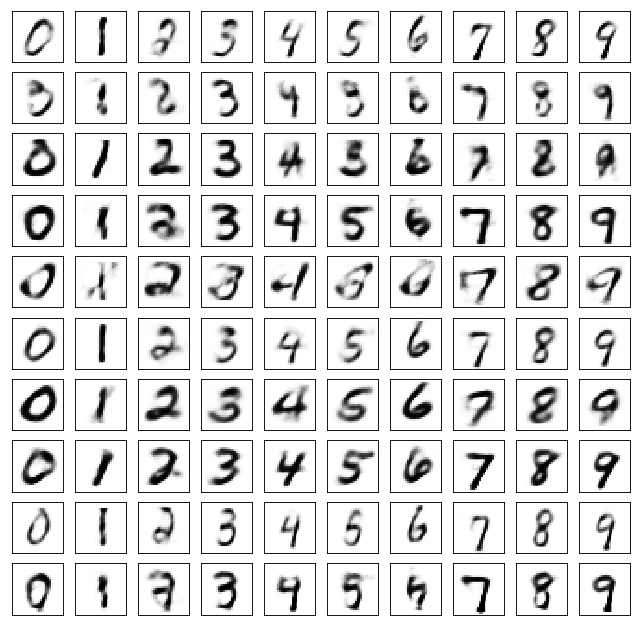

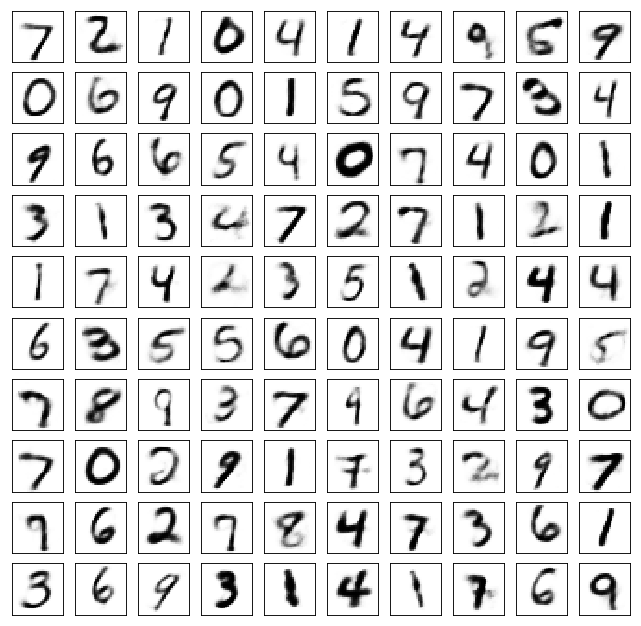

Test losses. E: 0.7203, AE: 0.0724, D: 0.6910
Train Epoch: 61 [0/50000 (0%)]	Losses E: 0.7249, AE: 0.0703, D: 0.6925
Train Epoch: 61 [25000/50000 (50%)]	Losses E: 0.7182, AE: 0.0707, D: 0.6944
Train Epoch: 61 [50000/50000 (100%)]	Losses E: 0.7056, AE: 0.0725, D: 0.6958


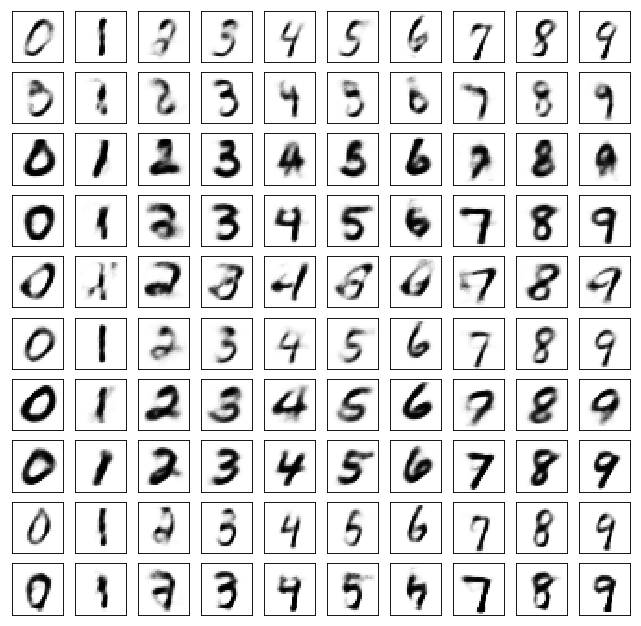

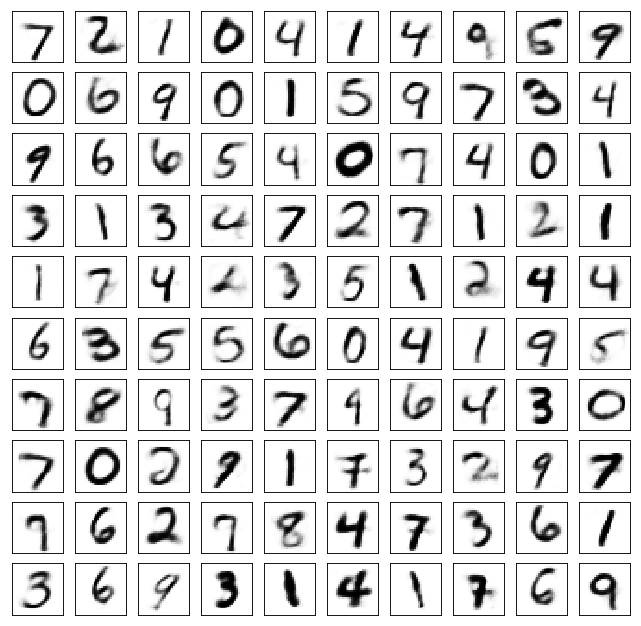

Test losses. E: 0.7033, AE: 0.0722, D: 0.6932
Train Epoch: 62 [0/50000 (0%)]	Losses E: 0.7092, AE: 0.0667, D: 0.6908
Train Epoch: 62 [25000/50000 (50%)]	Losses E: 0.7110, AE: 0.0706, D: 0.6946
Train Epoch: 62 [50000/50000 (100%)]	Losses E: 0.7138, AE: 0.0746, D: 0.6900


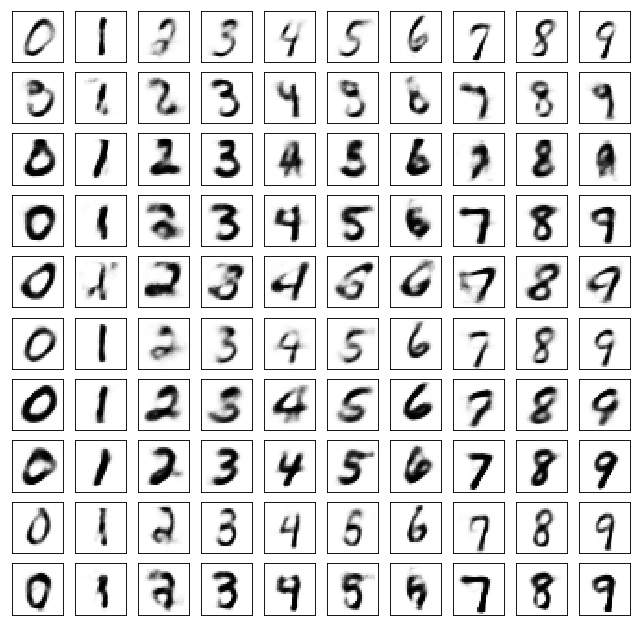

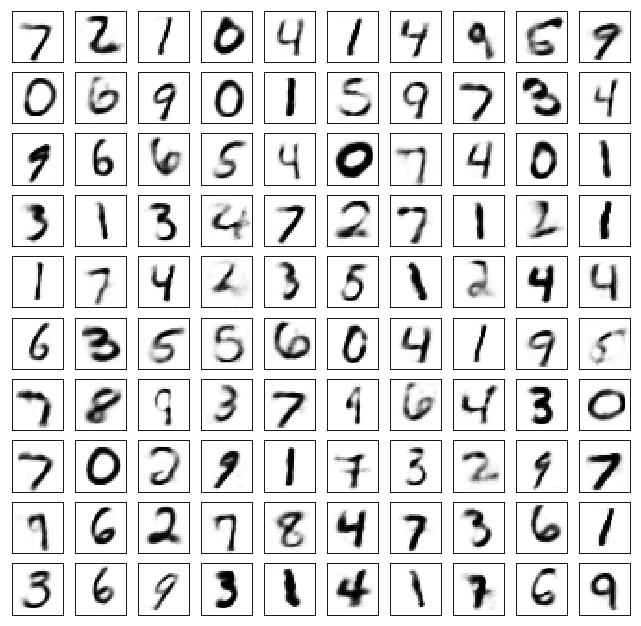

Test losses. E: 0.7076, AE: 0.0767, D: 0.6927
Train Epoch: 63 [0/50000 (0%)]	Losses E: 0.7082, AE: 0.0724, D: 0.6941
Train Epoch: 63 [25000/50000 (50%)]	Losses E: 0.7221, AE: 0.0694, D: 0.6913
Train Epoch: 63 [50000/50000 (100%)]	Losses E: 0.7021, AE: 0.0687, D: 0.6885


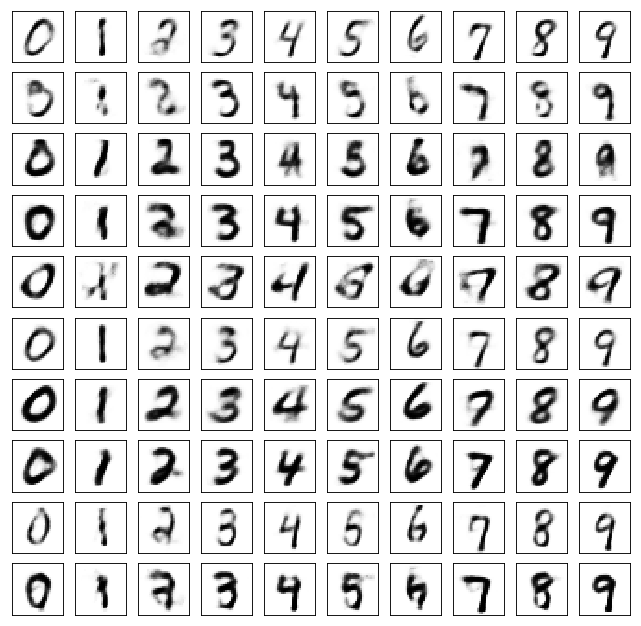

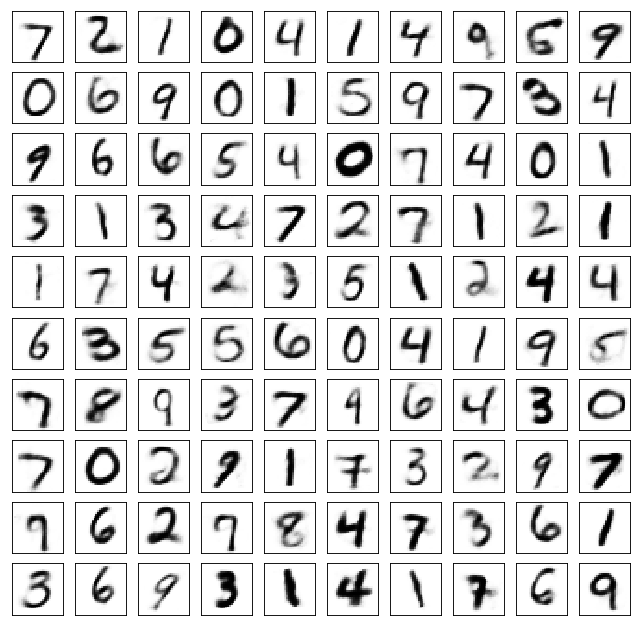

Test losses. E: 0.6996, AE: 0.0687, D: 0.6907
Train Epoch: 64 [0/50000 (0%)]	Losses E: 0.6975, AE: 0.0693, D: 0.6910
Train Epoch: 64 [25000/50000 (50%)]	Losses E: 0.6920, AE: 0.0692, D: 0.6947
Train Epoch: 64 [50000/50000 (100%)]	Losses E: 0.6724, AE: 0.0670, D: 0.6954


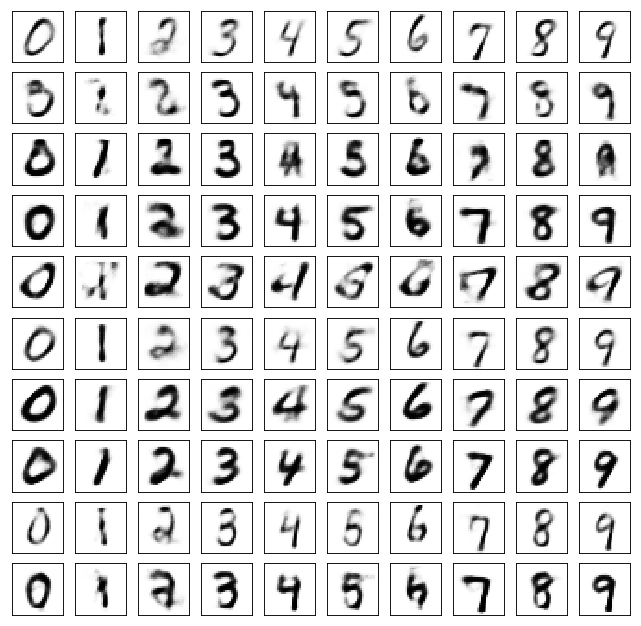

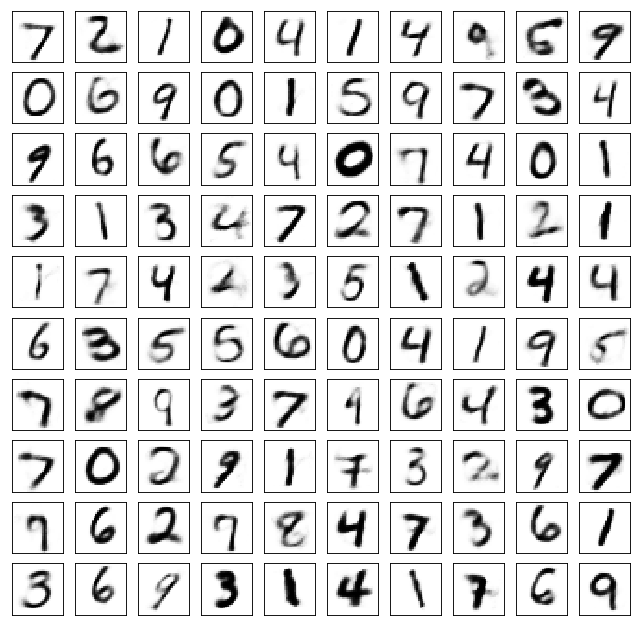

Test losses. E: 0.6748, AE: 0.0690, D: 0.6930
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.6786, AE: 0.0686, D: 0.6918
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.6832, AE: 0.0609, D: 0.6917
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.6903, AE: 0.0676, D: 0.6955


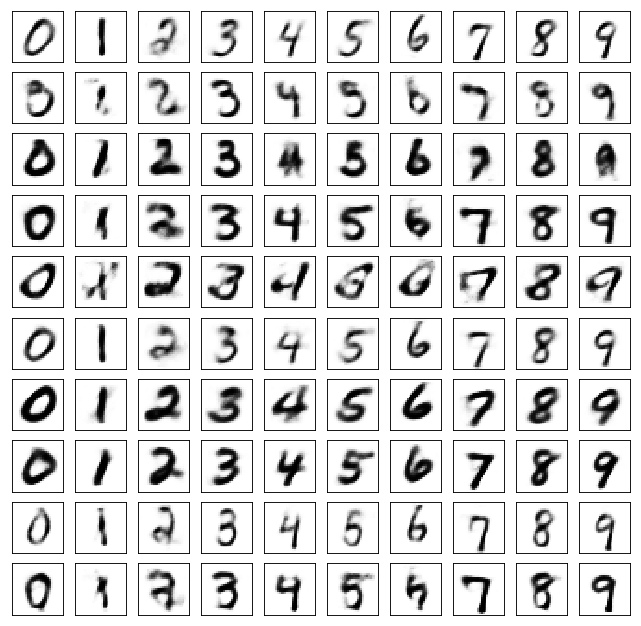

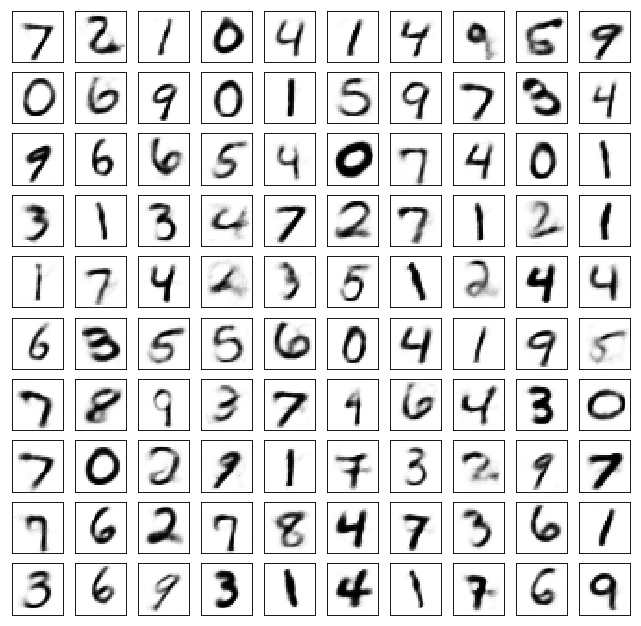

Test losses. E: 0.6899, AE: 0.0723, D: 0.6956
Train Epoch: 66 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.0656, D: 0.6944
Train Epoch: 66 [25000/50000 (50%)]	Losses E: 0.6930, AE: 0.0638, D: 0.6926
Train Epoch: 66 [50000/50000 (100%)]	Losses E: 0.7014, AE: 0.0673, D: 0.6898


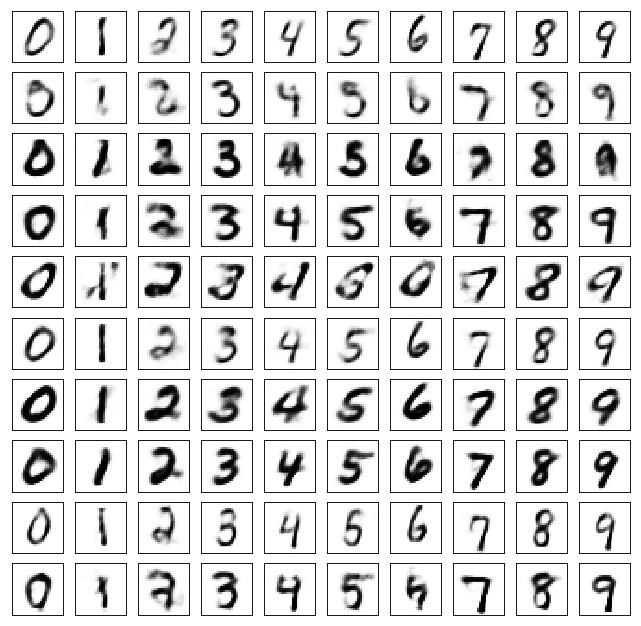

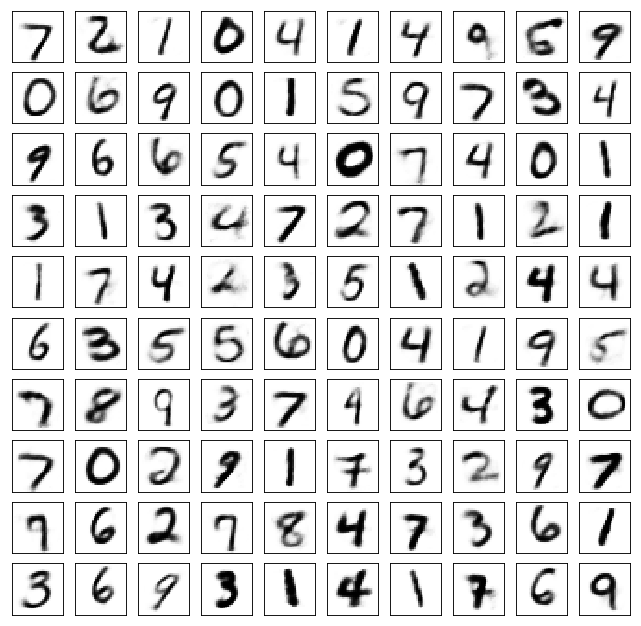

Test losses. E: 0.6968, AE: 0.0677, D: 0.6900
Train Epoch: 67 [0/50000 (0%)]	Losses E: 0.6963, AE: 0.0673, D: 0.6876
Train Epoch: 67 [25000/50000 (50%)]	Losses E: 0.6963, AE: 0.0658, D: 0.6916
Train Epoch: 67 [50000/50000 (100%)]	Losses E: 0.6853, AE: 0.0685, D: 0.6934


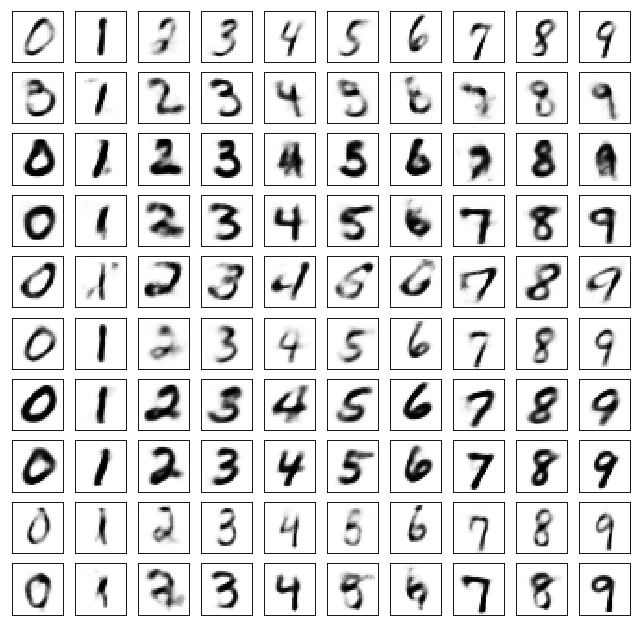

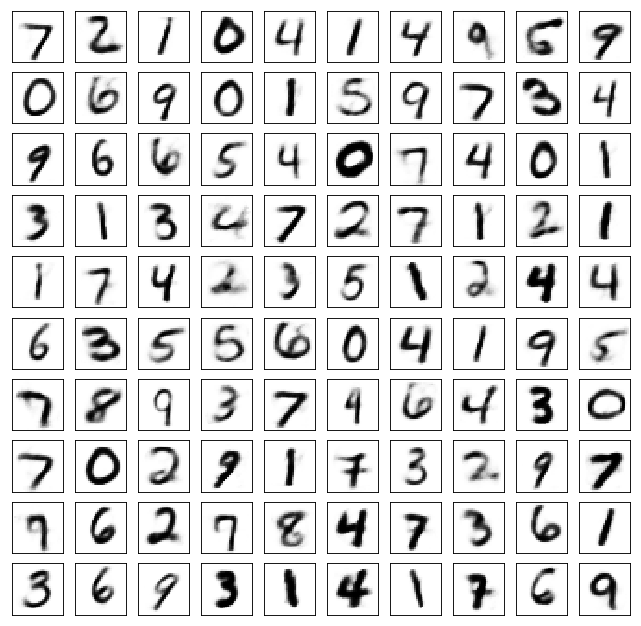

Test losses. E: 0.6840, AE: 0.0712, D: 0.6936
Train Epoch: 68 [0/50000 (0%)]	Losses E: 0.6859, AE: 0.0682, D: 0.6931
Train Epoch: 68 [25000/50000 (50%)]	Losses E: 0.6892, AE: 0.0717, D: 0.6929
Train Epoch: 68 [50000/50000 (100%)]	Losses E: 0.6923, AE: 0.0667, D: 0.6930


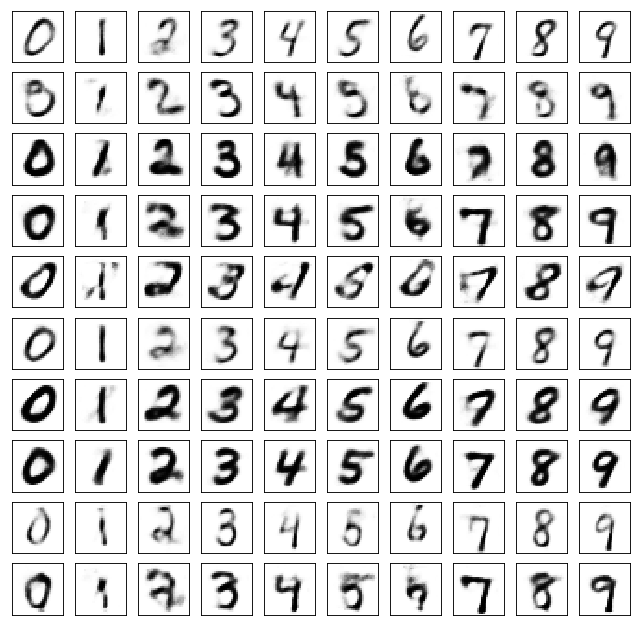

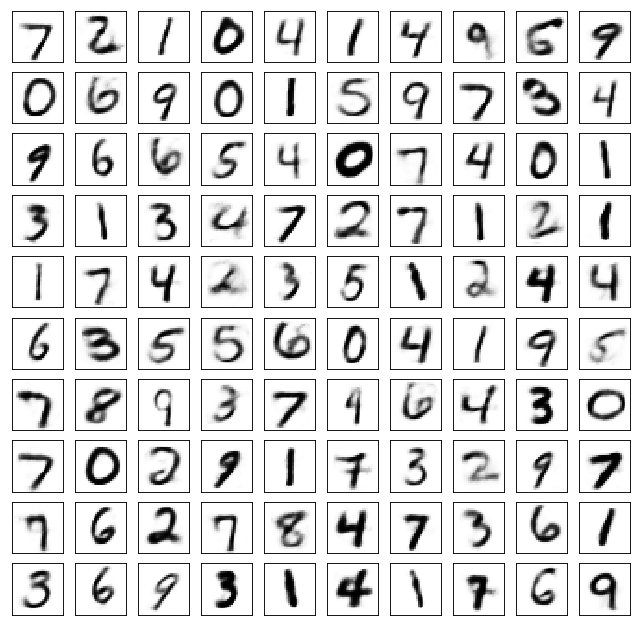

Test losses. E: 0.6900, AE: 0.0709, D: 0.6944
Train Epoch: 69 [0/50000 (0%)]	Losses E: 0.6893, AE: 0.0683, D: 0.6948
Train Epoch: 69 [25000/50000 (50%)]	Losses E: 0.7009, AE: 0.0658, D: 0.6914
Train Epoch: 69 [50000/50000 (100%)]	Losses E: 0.6757, AE: 0.0659, D: 0.6913


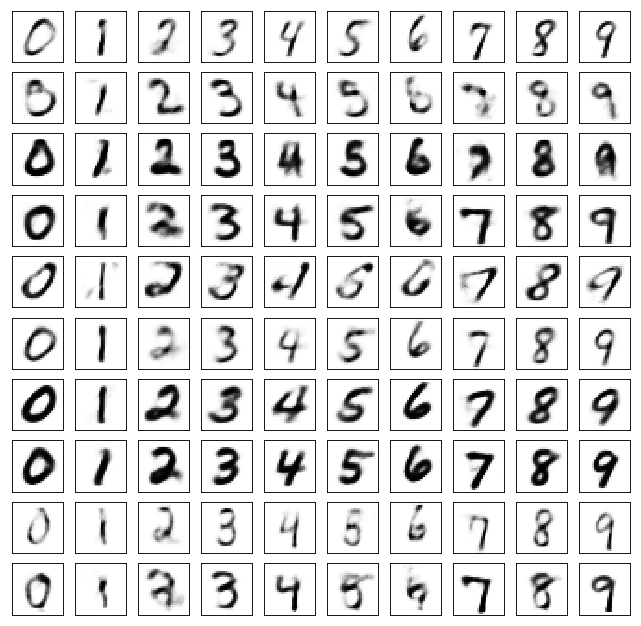

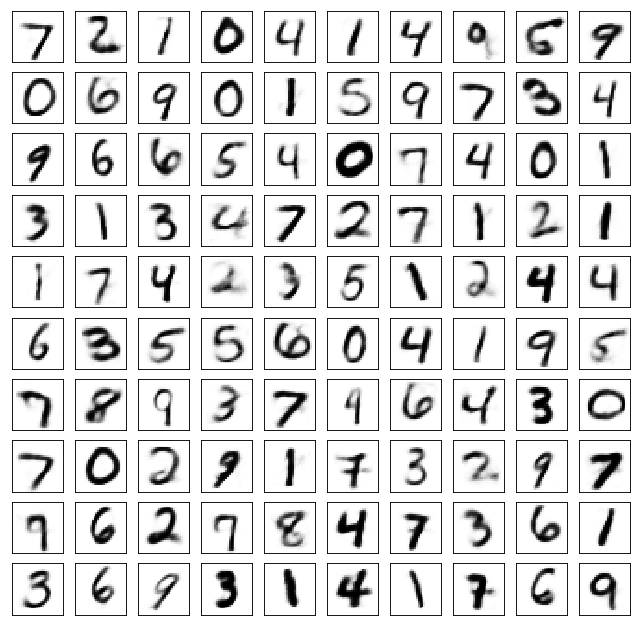

Test losses. E: 0.6755, AE: 0.0676, D: 0.6922
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.6738, AE: 0.0691, D: 0.6934
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.6807, AE: 0.0665, D: 0.6934
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6960, AE: 0.0704, D: 0.6930


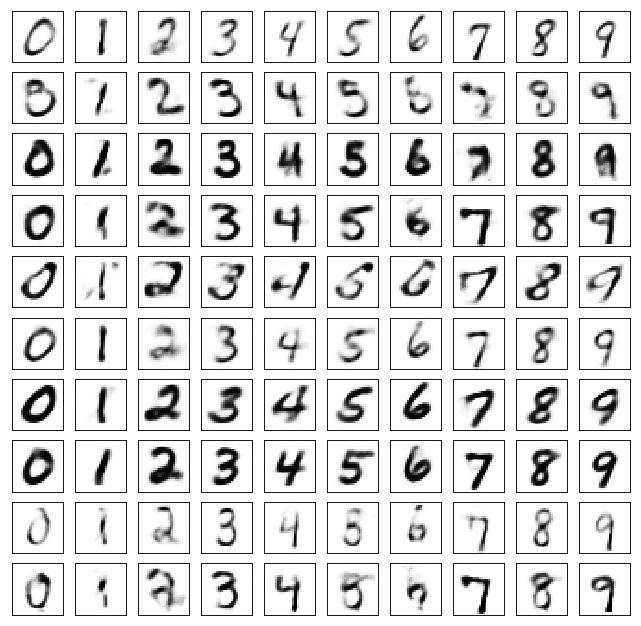

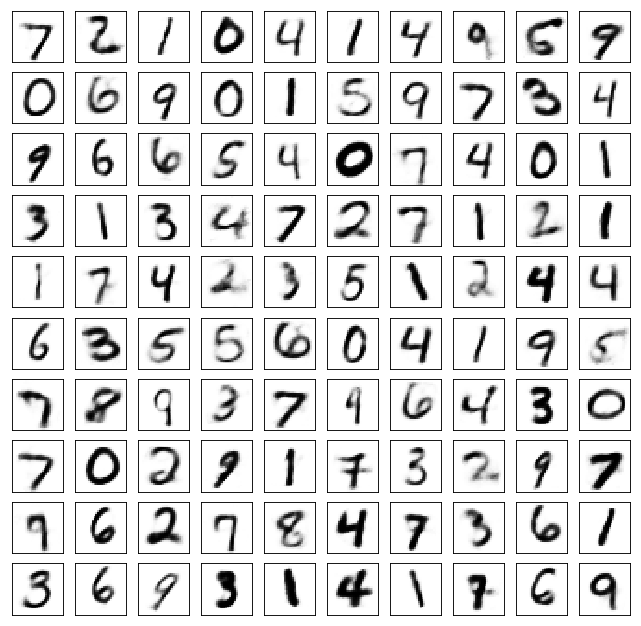

Test losses. E: 0.6956, AE: 0.0656, D: 0.6916
Train Epoch: 71 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0619, D: 0.6895
Train Epoch: 71 [25000/50000 (50%)]	Losses E: 0.6869, AE: 0.0683, D: 0.6953
Train Epoch: 71 [50000/50000 (100%)]	Losses E: 0.6921, AE: 0.0631, D: 0.6948


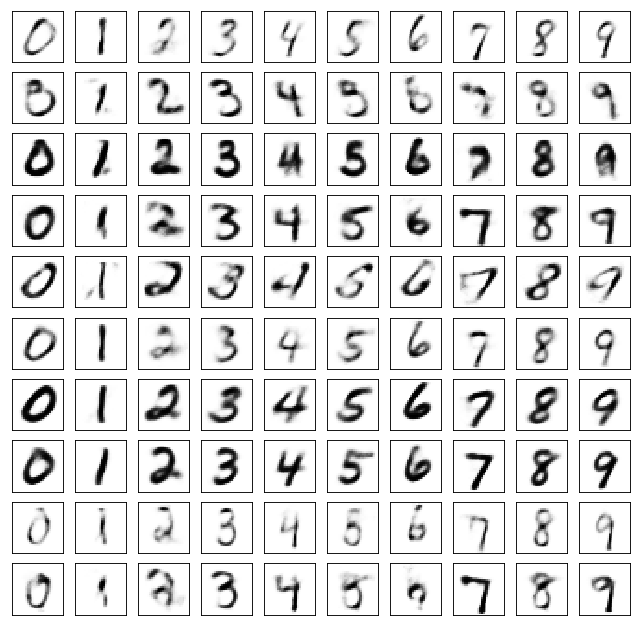

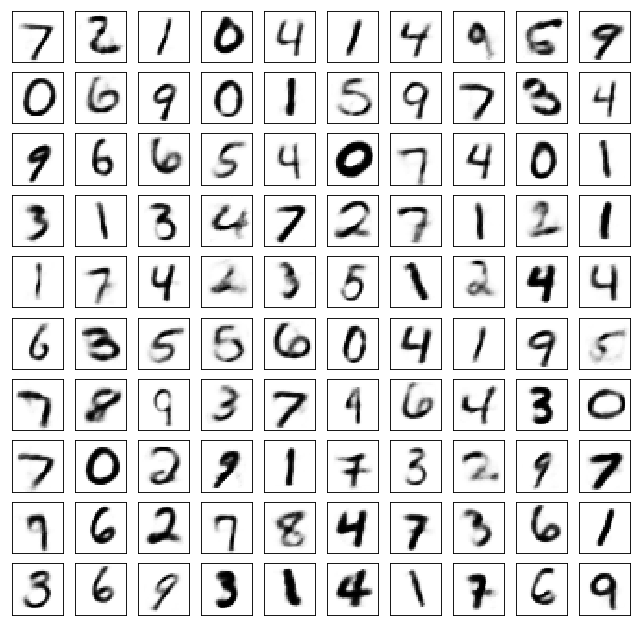

Test losses. E: 0.6911, AE: 0.0678, D: 0.6931
Train Epoch: 72 [0/50000 (0%)]	Losses E: 0.6893, AE: 0.0670, D: 0.6912
Train Epoch: 72 [25000/50000 (50%)]	Losses E: 0.6968, AE: 0.0625, D: 0.6903
Train Epoch: 72 [50000/50000 (100%)]	Losses E: 0.7100, AE: 0.0635, D: 0.6907


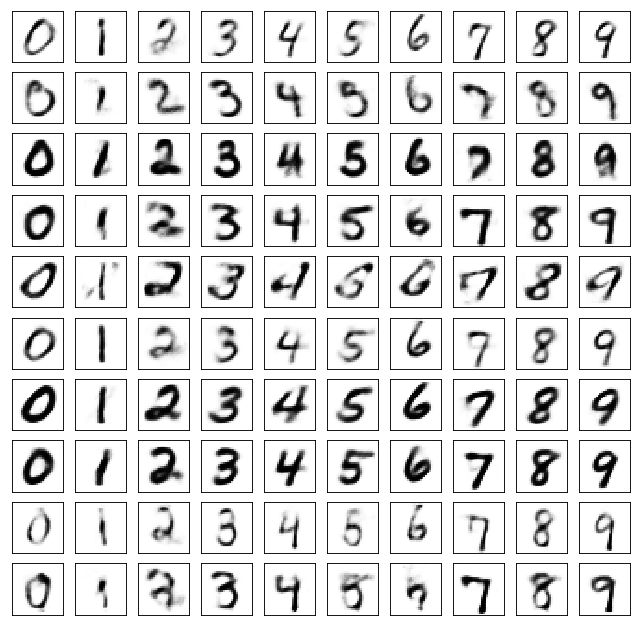

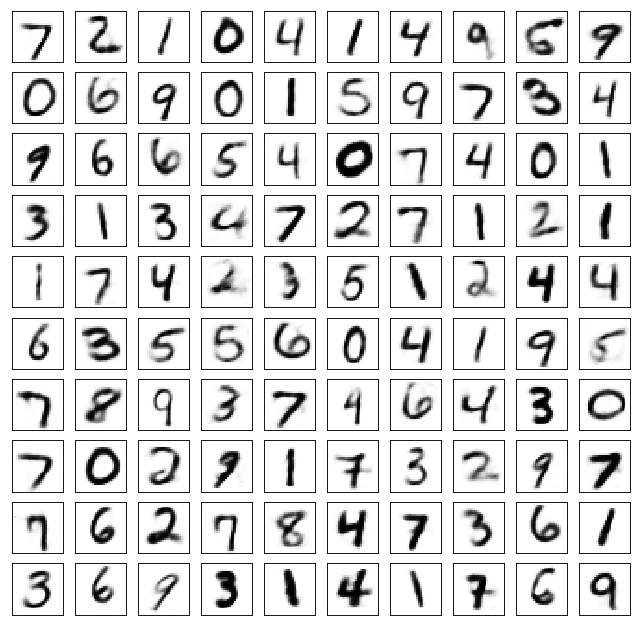

Test losses. E: 0.7067, AE: 0.0677, D: 0.6929
Train Epoch: 73 [0/50000 (0%)]	Losses E: 0.7107, AE: 0.0706, D: 0.6935
Train Epoch: 73 [25000/50000 (50%)]	Losses E: 0.6908, AE: 0.0668, D: 0.6966
Train Epoch: 73 [50000/50000 (100%)]	Losses E: 0.6883, AE: 0.0663, D: 0.6955


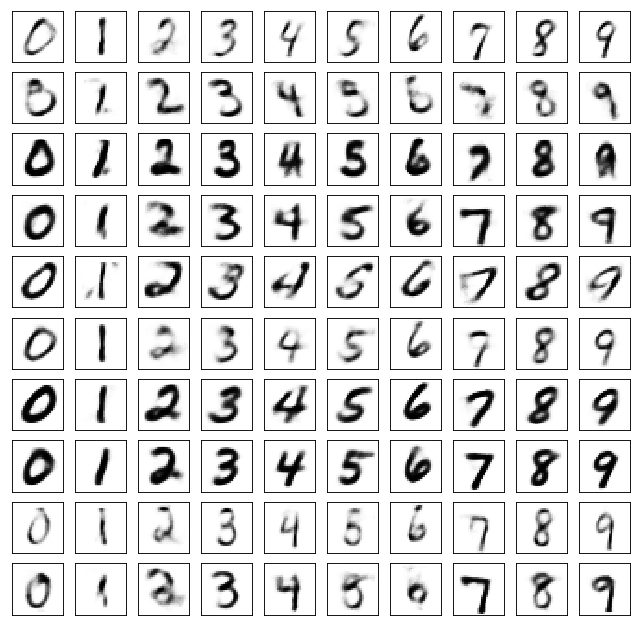

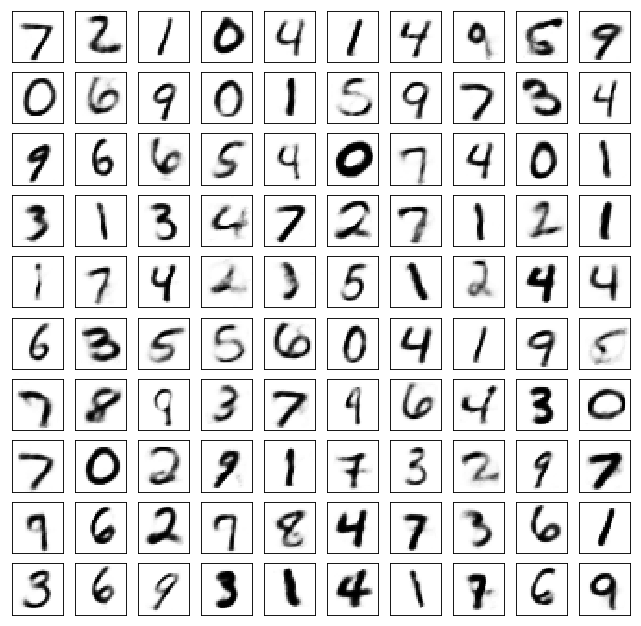

Test losses. E: 0.6900, AE: 0.0674, D: 0.6942
Train Epoch: 74 [0/50000 (0%)]	Losses E: 0.6957, AE: 0.0611, D: 0.6950
Train Epoch: 74 [25000/50000 (50%)]	Losses E: 0.6732, AE: 0.0672, D: 0.6934
Train Epoch: 74 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.0646, D: 0.6932


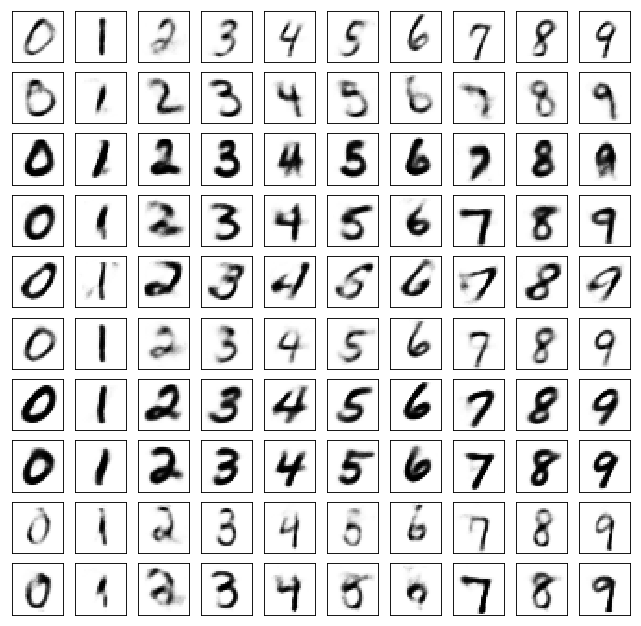

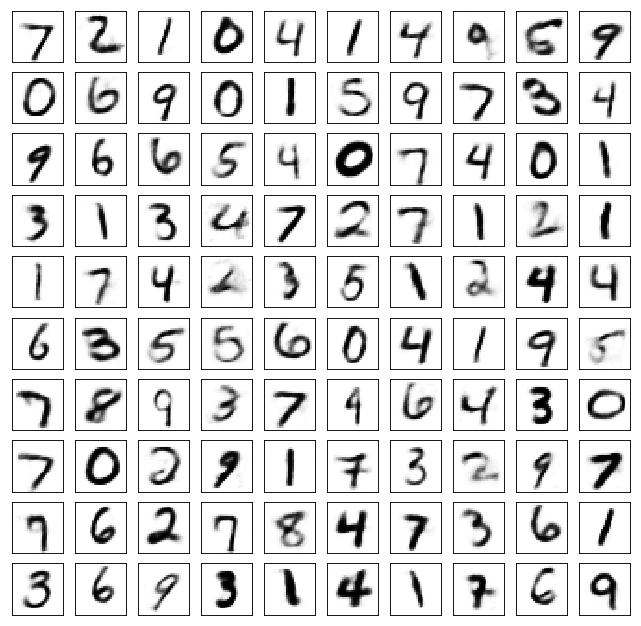

Test losses. E: 0.6904, AE: 0.0662, D: 0.6935
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.6895, AE: 0.0626, D: 0.6927
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.7033, AE: 0.0611, D: 0.6920
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.6886, AE: 0.0595, D: 0.6916


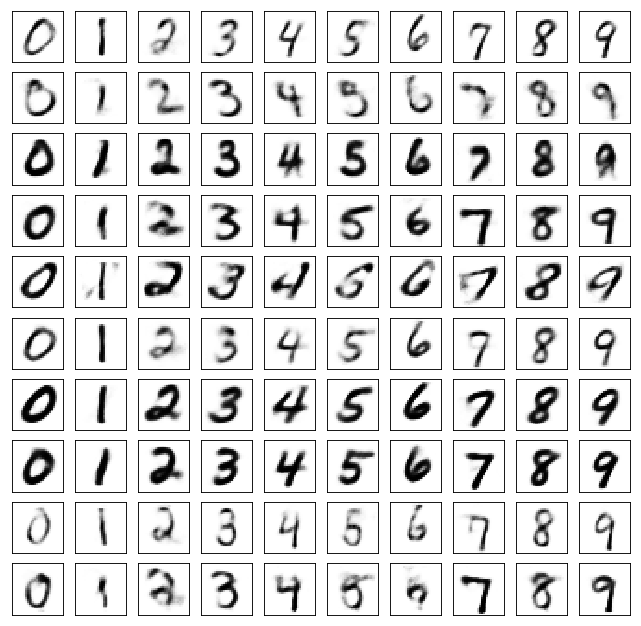

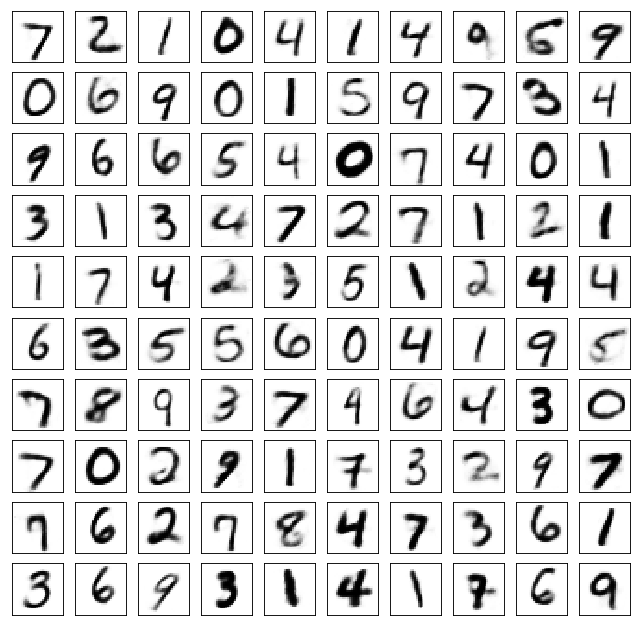

Test losses. E: 0.6864, AE: 0.0655, D: 0.6928
Train Epoch: 76 [0/50000 (0%)]	Losses E: 0.6893, AE: 0.0630, D: 0.6904
Train Epoch: 76 [25000/50000 (50%)]	Losses E: 0.7009, AE: 0.0601, D: 0.6912
Train Epoch: 76 [50000/50000 (100%)]	Losses E: 0.6791, AE: 0.0681, D: 0.6964


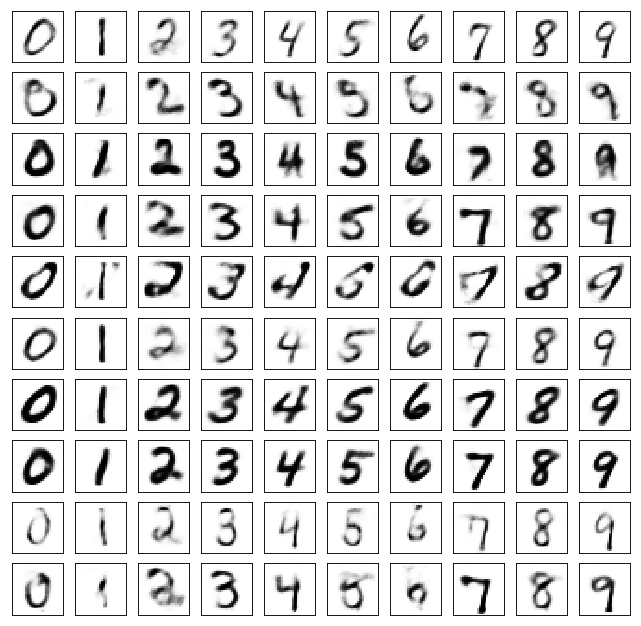

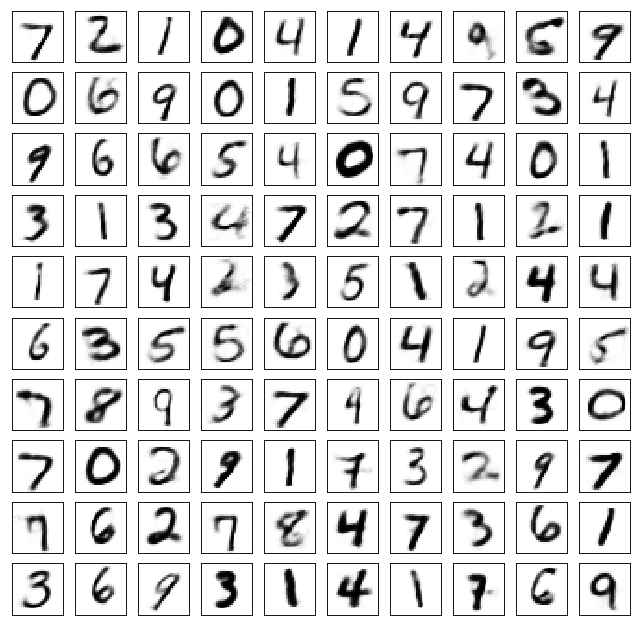

Test losses. E: 0.6805, AE: 0.0692, D: 0.6959
Train Epoch: 77 [0/50000 (0%)]	Losses E: 0.6768, AE: 0.0664, D: 0.6962
Train Epoch: 77 [25000/50000 (50%)]	Losses E: 0.6907, AE: 0.0588, D: 0.6926
Train Epoch: 77 [50000/50000 (100%)]	Losses E: 0.6854, AE: 0.0586, D: 0.6940


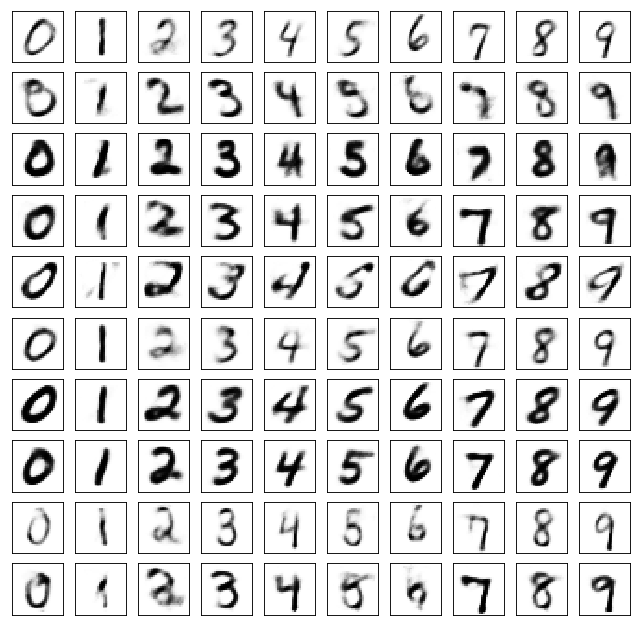

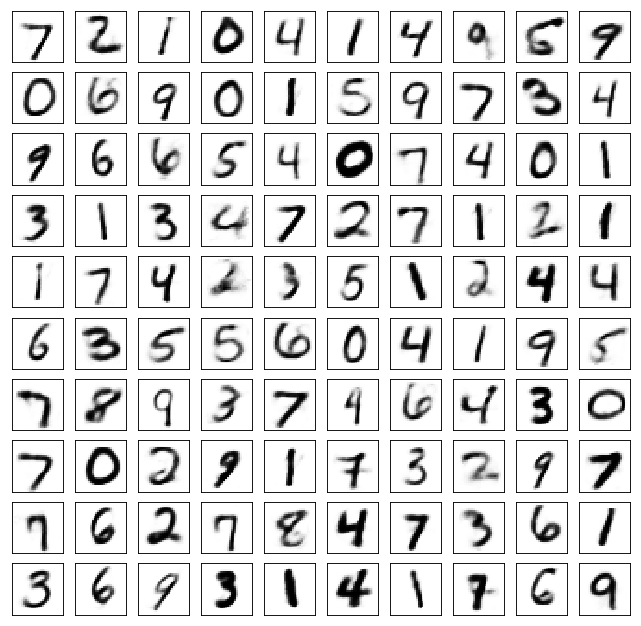

Test losses. E: 0.6831, AE: 0.0655, D: 0.6942
Train Epoch: 78 [0/50000 (0%)]	Losses E: 0.6874, AE: 0.0584, D: 0.6940
Train Epoch: 78 [25000/50000 (50%)]	Losses E: 0.6861, AE: 0.0651, D: 0.6936
Train Epoch: 78 [50000/50000 (100%)]	Losses E: 0.6753, AE: 0.0657, D: 0.6938


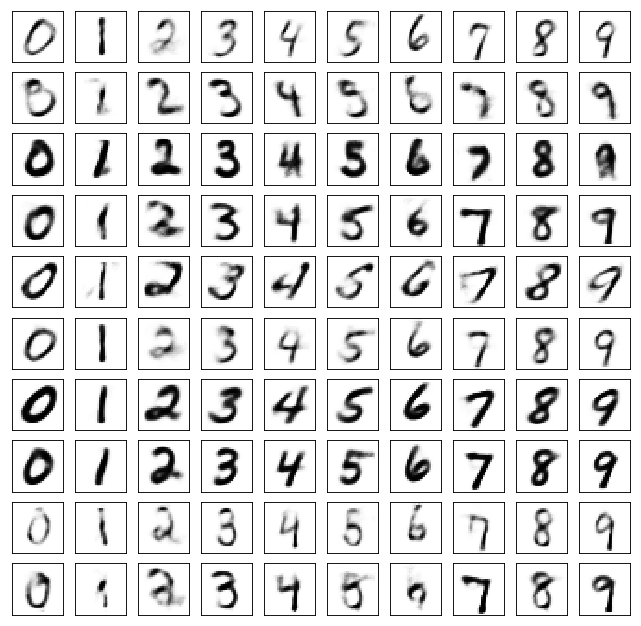

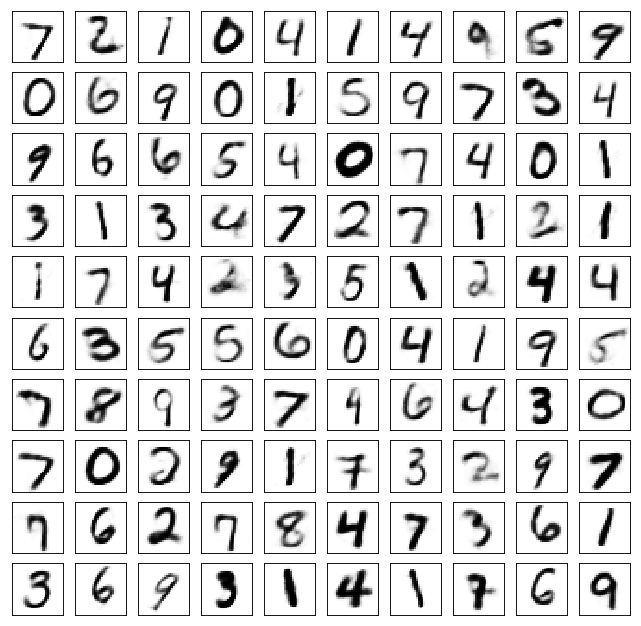

Test losses. E: 0.6722, AE: 0.0658, D: 0.6951
Train Epoch: 79 [0/50000 (0%)]	Losses E: 0.6719, AE: 0.0623, D: 0.6976
Train Epoch: 79 [25000/50000 (50%)]	Losses E: 0.7027, AE: 0.0608, D: 0.6912
Train Epoch: 79 [50000/50000 (100%)]	Losses E: 0.6945, AE: 0.0632, D: 0.6939


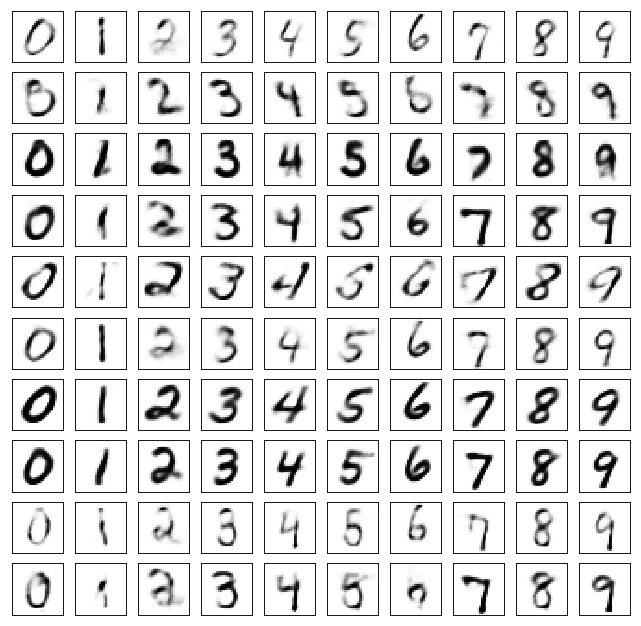

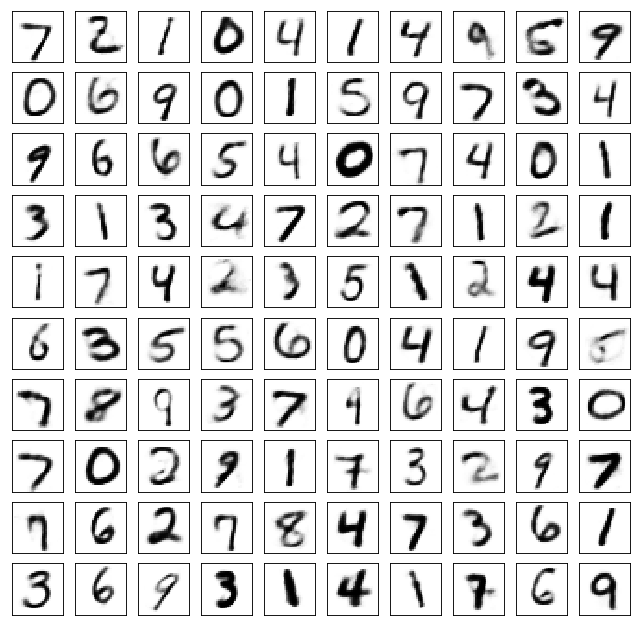

Test losses. E: 0.6943, AE: 0.0652, D: 0.6919
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.6975, AE: 0.0635, D: 0.6927
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.7250, AE: 0.0627, D: 0.6951
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.6848, AE: 0.0611, D: 0.6925


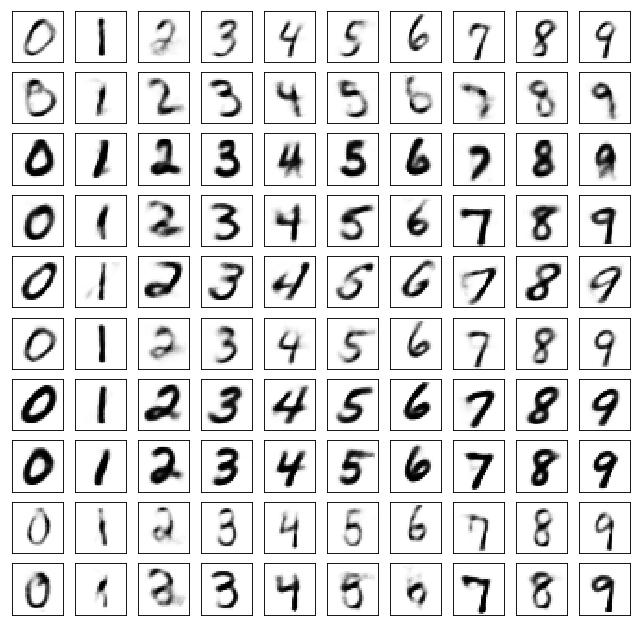

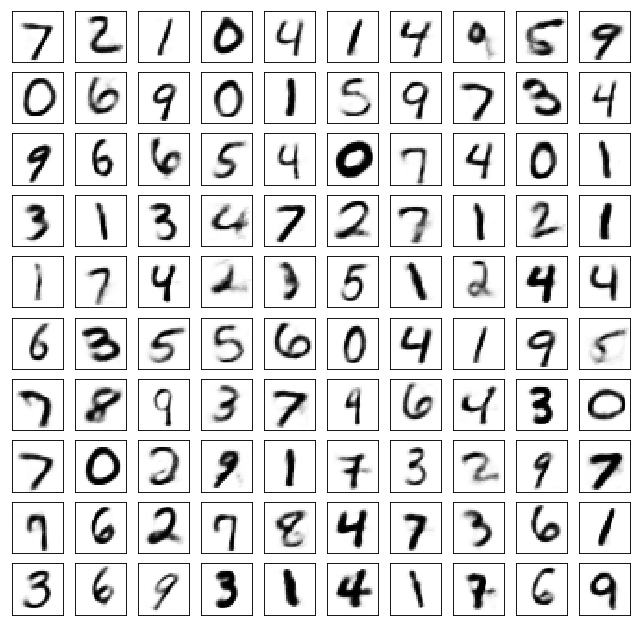

Test losses. E: 0.6841, AE: 0.0649, D: 0.6934
Train Epoch: 81 [0/50000 (0%)]	Losses E: 0.6833, AE: 0.0577, D: 0.6924
Train Epoch: 81 [25000/50000 (50%)]	Losses E: 0.6907, AE: 0.0593, D: 0.6965
Train Epoch: 81 [50000/50000 (100%)]	Losses E: 0.7051, AE: 0.0631, D: 0.6950


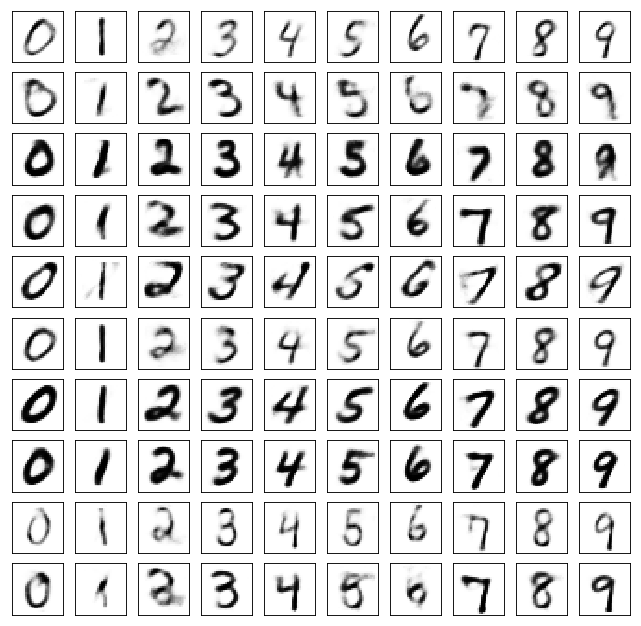

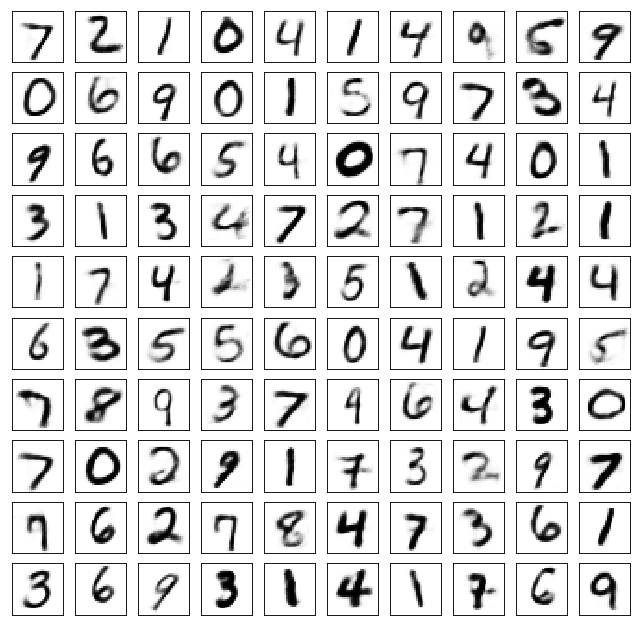

Test losses. E: 0.7088, AE: 0.0631, D: 0.6935
Train Epoch: 82 [0/50000 (0%)]	Losses E: 0.7119, AE: 0.0577, D: 0.6953
Train Epoch: 82 [25000/50000 (50%)]	Losses E: 0.7040, AE: 0.0591, D: 0.6968
Train Epoch: 82 [50000/50000 (100%)]	Losses E: 0.6889, AE: 0.0585, D: 0.6932


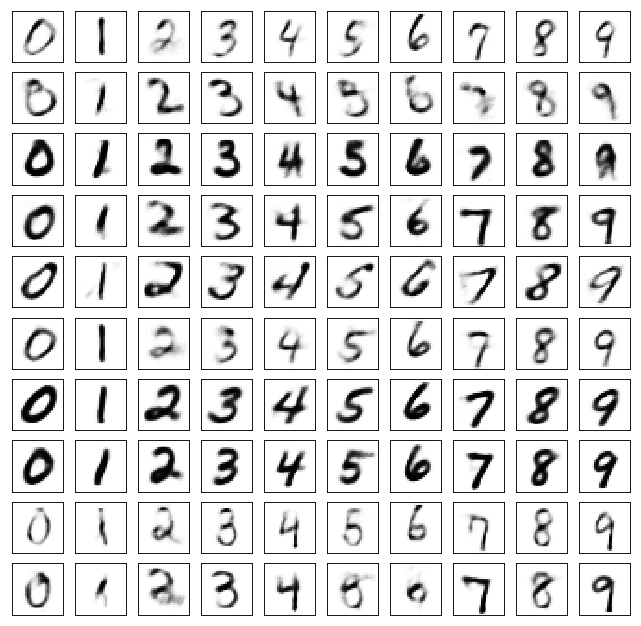

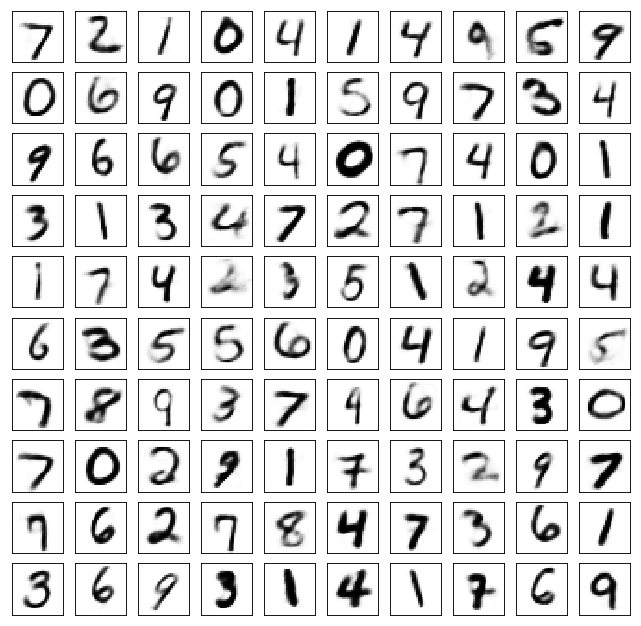

Test losses. E: 0.6898, AE: 0.0630, D: 0.6933
Train Epoch: 83 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.0553, D: 0.6924
Train Epoch: 83 [25000/50000 (50%)]	Losses E: 0.7037, AE: 0.0553, D: 0.6930
Train Epoch: 83 [50000/50000 (100%)]	Losses E: 0.6984, AE: 0.0563, D: 0.6930


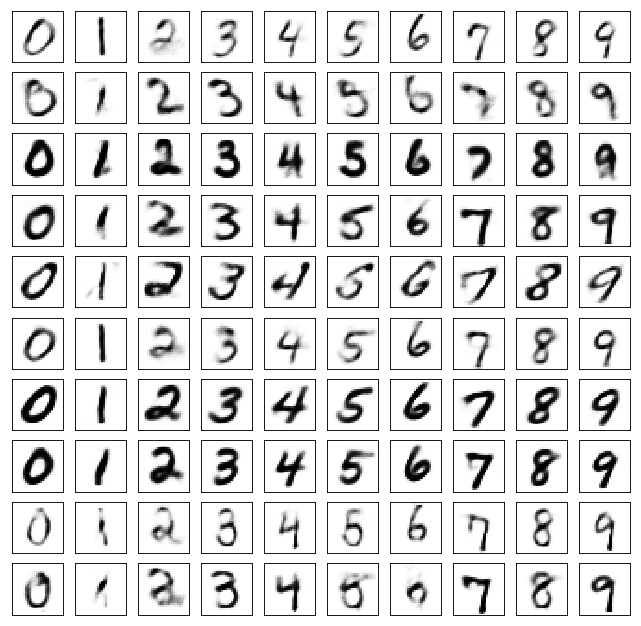

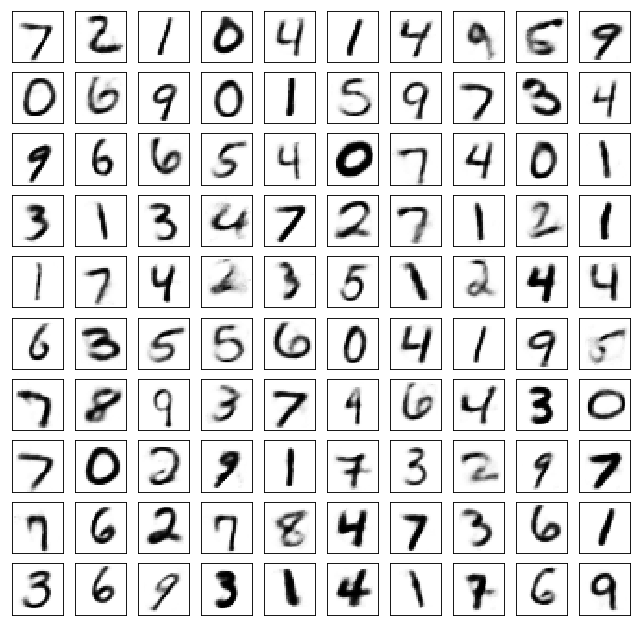

Test losses. E: 0.6993, AE: 0.0624, D: 0.6929
Train Epoch: 84 [0/50000 (0%)]	Losses E: 0.6979, AE: 0.0612, D: 0.6957
Train Epoch: 84 [25000/50000 (50%)]	Losses E: 0.6878, AE: 0.0616, D: 0.6967
Train Epoch: 84 [50000/50000 (100%)]	Losses E: 0.6752, AE: 0.0566, D: 0.6913


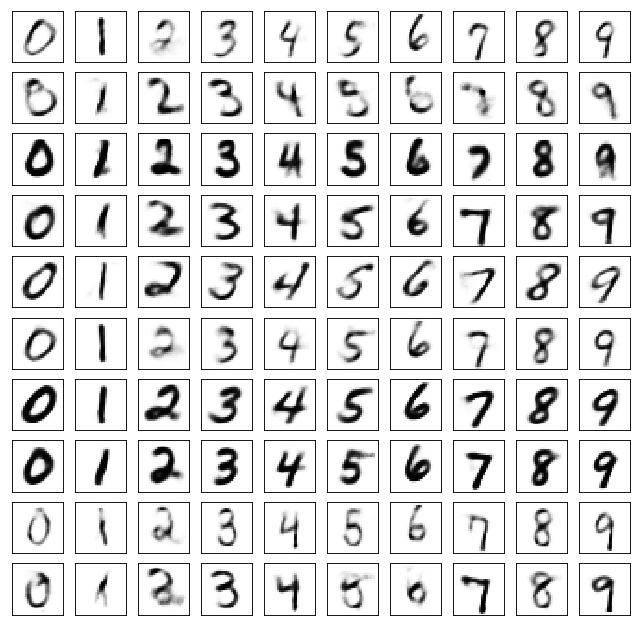

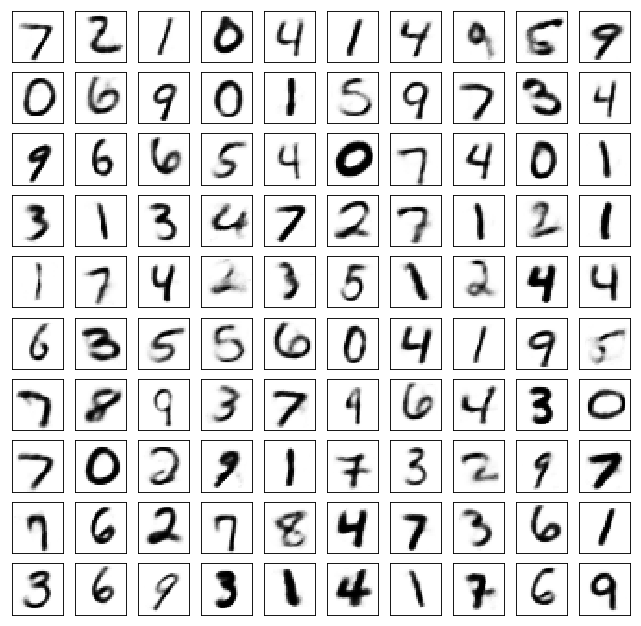

Test losses. E: 0.6757, AE: 0.0616, D: 0.6926
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.6768, AE: 0.0516, D: 0.6909
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.6952, AE: 0.0553, D: 0.6917
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.6724, AE: 0.0560, D: 0.6922


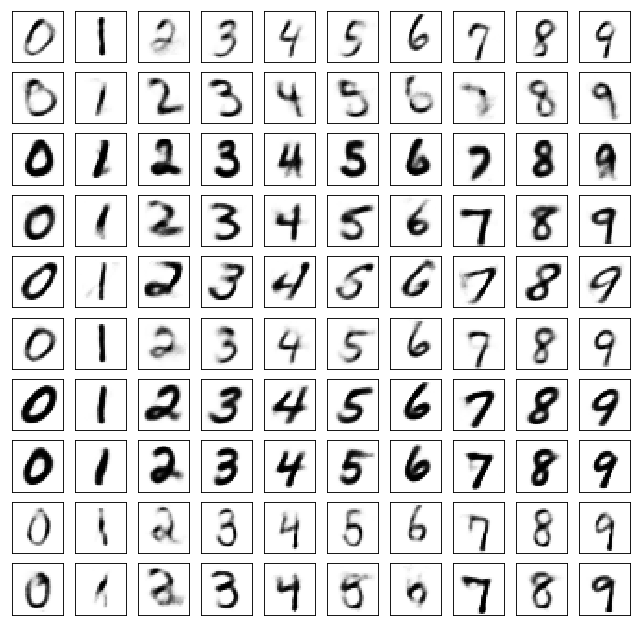

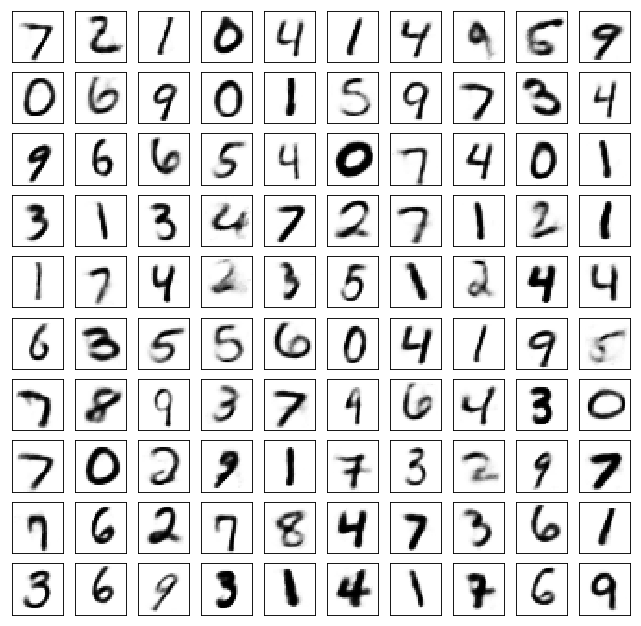

Test losses. E: 0.6726, AE: 0.0631, D: 0.6938
Train Epoch: 86 [0/50000 (0%)]	Losses E: 0.6723, AE: 0.0567, D: 0.6959
Train Epoch: 86 [25000/50000 (50%)]	Losses E: 0.6998, AE: 0.0579, D: 0.6942
Train Epoch: 86 [50000/50000 (100%)]	Losses E: 0.7078, AE: 0.0587, D: 0.6872


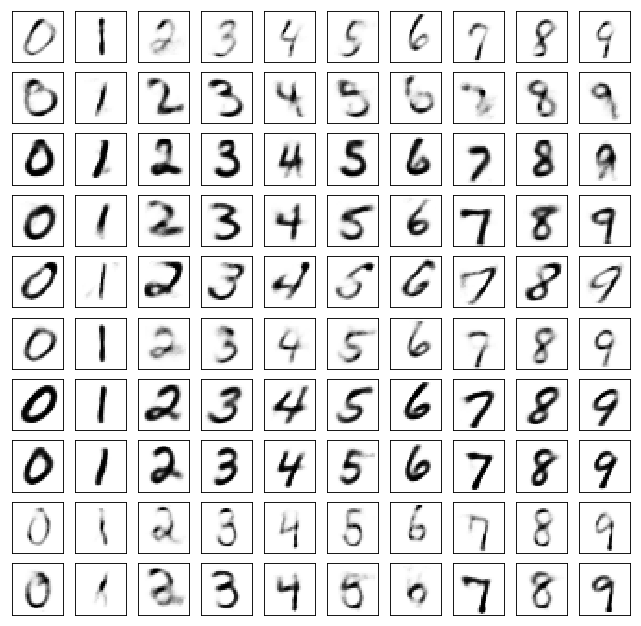

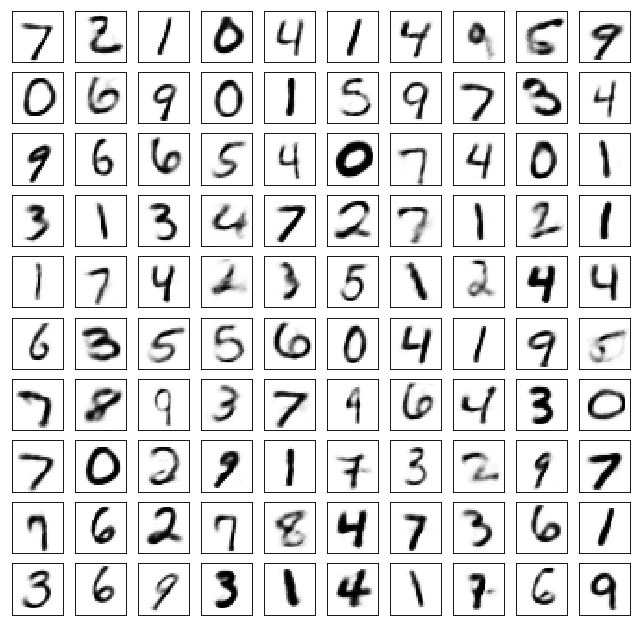

Test losses. E: 0.7060, AE: 0.0637, D: 0.6897
Train Epoch: 87 [0/50000 (0%)]	Losses E: 0.7026, AE: 0.0639, D: 0.6923
Train Epoch: 87 [25000/50000 (50%)]	Losses E: 0.6866, AE: 0.0619, D: 0.6919
Train Epoch: 87 [50000/50000 (100%)]	Losses E: 0.6802, AE: 0.0589, D: 0.6949


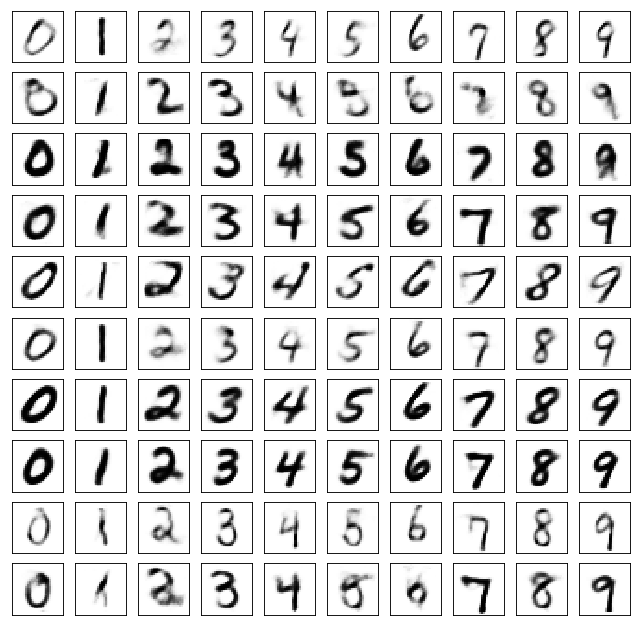

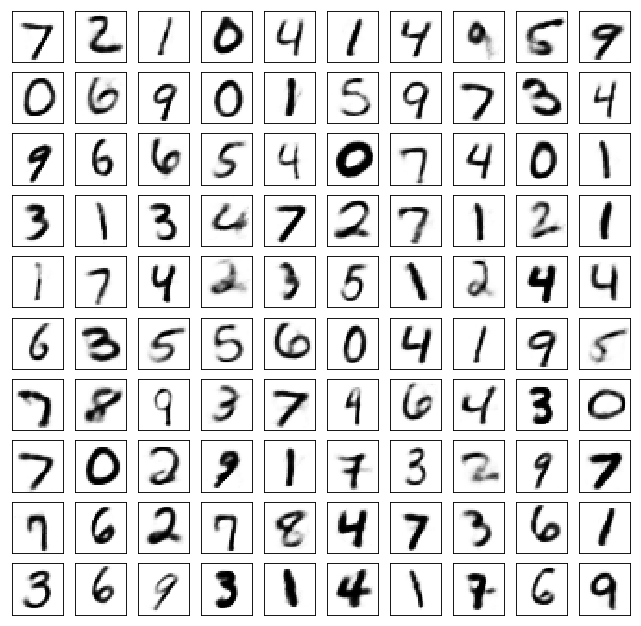

Test losses. E: 0.6836, AE: 0.0611, D: 0.6936
Train Epoch: 88 [0/50000 (0%)]	Losses E: 0.6877, AE: 0.0606, D: 0.6929
Train Epoch: 88 [25000/50000 (50%)]	Losses E: 0.6977, AE: 0.0585, D: 0.6964
Train Epoch: 88 [50000/50000 (100%)]	Losses E: 0.6853, AE: 0.0560, D: 0.6917


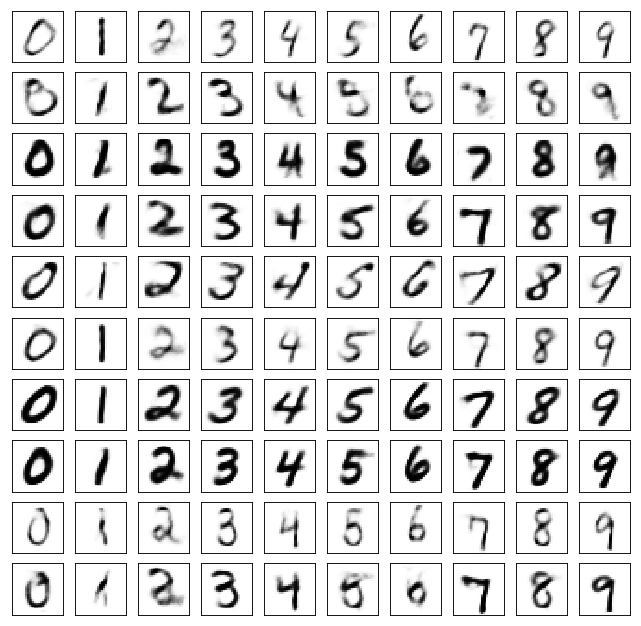

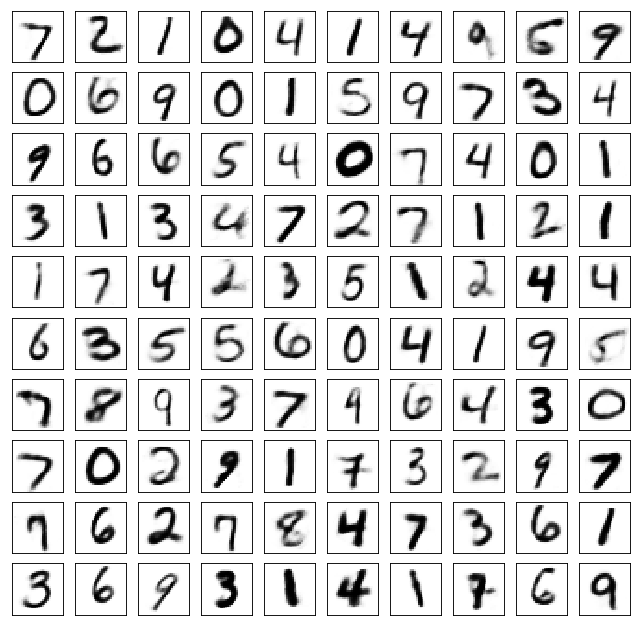

Test losses. E: 0.6838, AE: 0.0613, D: 0.6929
Train Epoch: 89 [0/50000 (0%)]	Losses E: 0.6832, AE: 0.0527, D: 0.6923
Train Epoch: 89 [25000/50000 (50%)]	Losses E: 0.7013, AE: 0.0579, D: 0.6949
Train Epoch: 89 [50000/50000 (100%)]	Losses E: 0.6865, AE: 0.0571, D: 0.6951


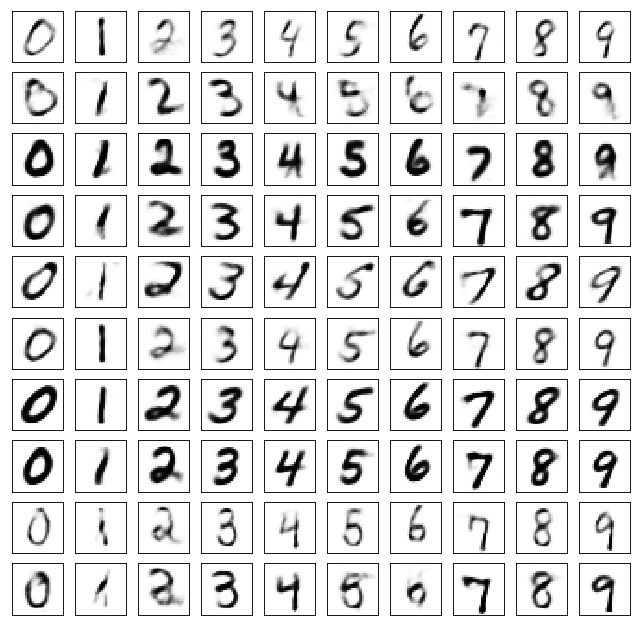

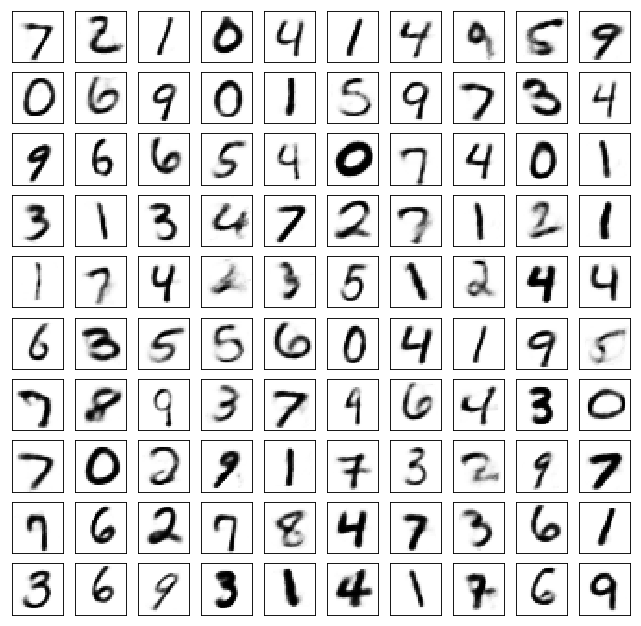

Test losses. E: 0.6849, AE: 0.0602, D: 0.6925
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.6828, AE: 0.0555, D: 0.6938
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.6916, AE: 0.0531, D: 0.6919
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6985, AE: 0.0559, D: 0.6940


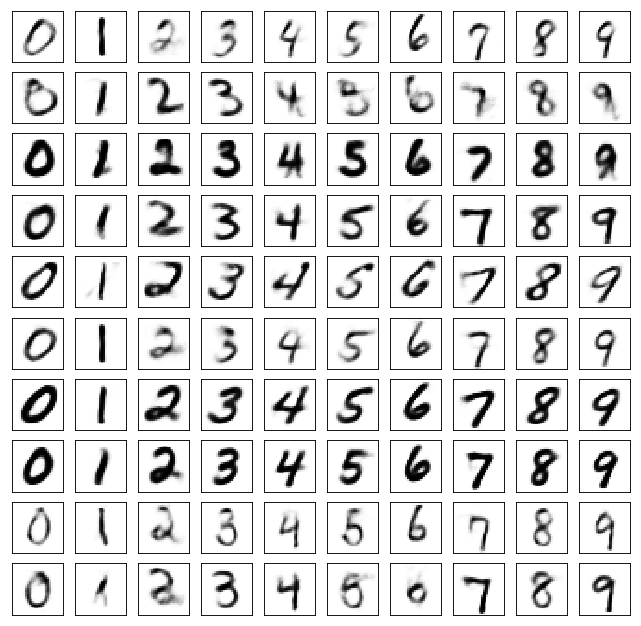

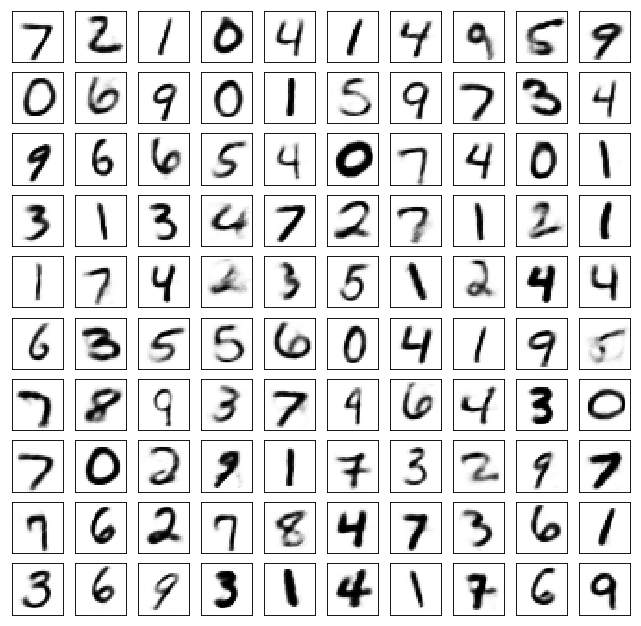

Test losses. E: 0.6994, AE: 0.0600, D: 0.6923
Train Epoch: 91 [0/50000 (0%)]	Losses E: 0.6985, AE: 0.0537, D: 0.6931
Train Epoch: 91 [25000/50000 (50%)]	Losses E: 0.6826, AE: 0.0544, D: 0.6928
Train Epoch: 91 [50000/50000 (100%)]	Losses E: 0.6984, AE: 0.0580, D: 0.6954


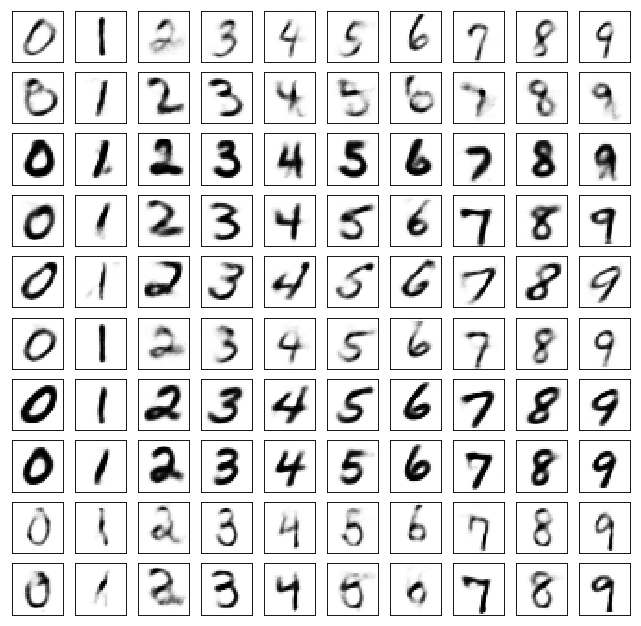

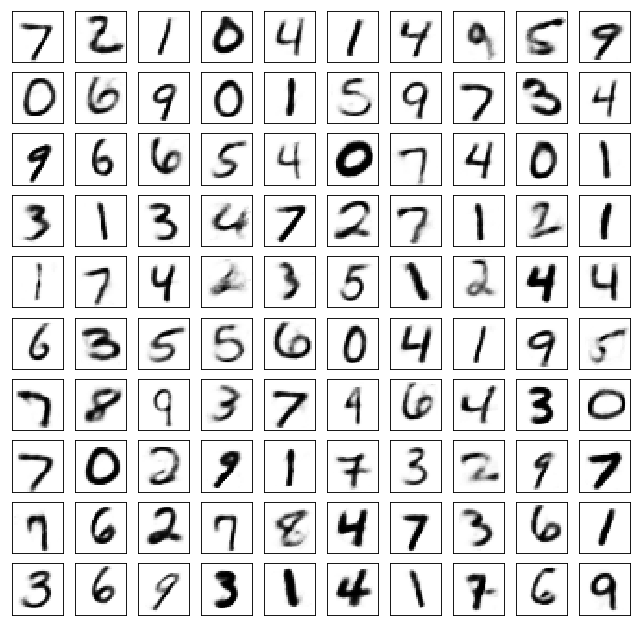

Test losses. E: 0.6980, AE: 0.0613, D: 0.6939
Train Epoch: 92 [0/50000 (0%)]	Losses E: 0.7016, AE: 0.0557, D: 0.6925
Train Epoch: 92 [25000/50000 (50%)]	Losses E: 0.6935, AE: 0.0547, D: 0.6947
Train Epoch: 92 [50000/50000 (100%)]	Losses E: 0.6983, AE: 0.0557, D: 0.6895


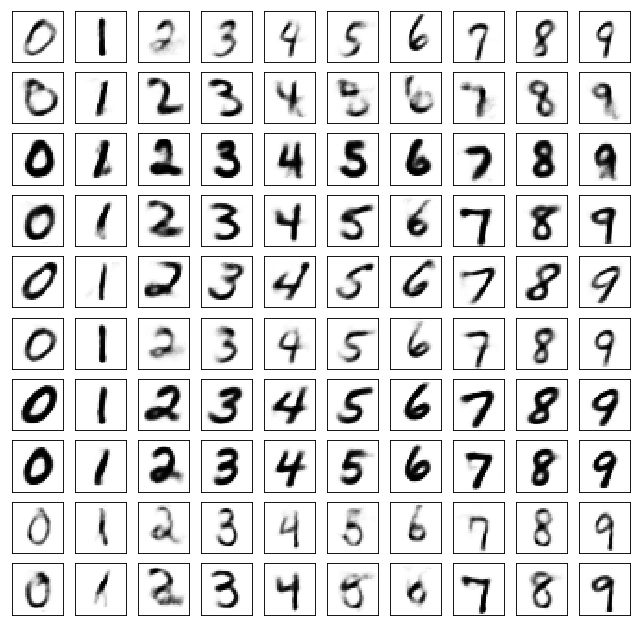

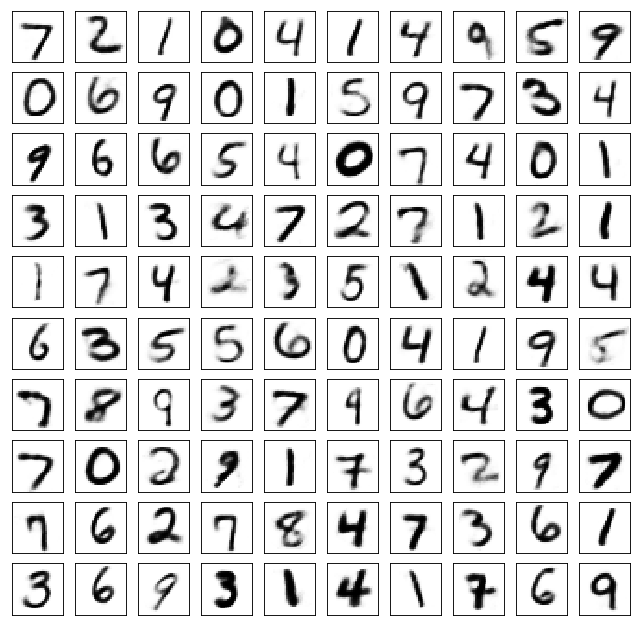

Test losses. E: 0.6941, AE: 0.0606, D: 0.6914
Train Epoch: 93 [0/50000 (0%)]	Losses E: 0.6923, AE: 0.0545, D: 0.6924
Train Epoch: 93 [25000/50000 (50%)]	Losses E: 0.6799, AE: 0.0554, D: 0.6920
Train Epoch: 93 [50000/50000 (100%)]	Losses E: 0.6956, AE: 0.0523, D: 0.6943


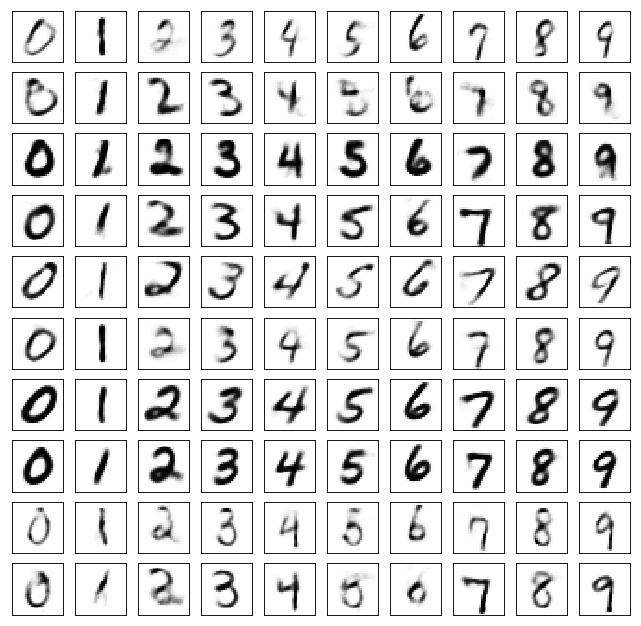

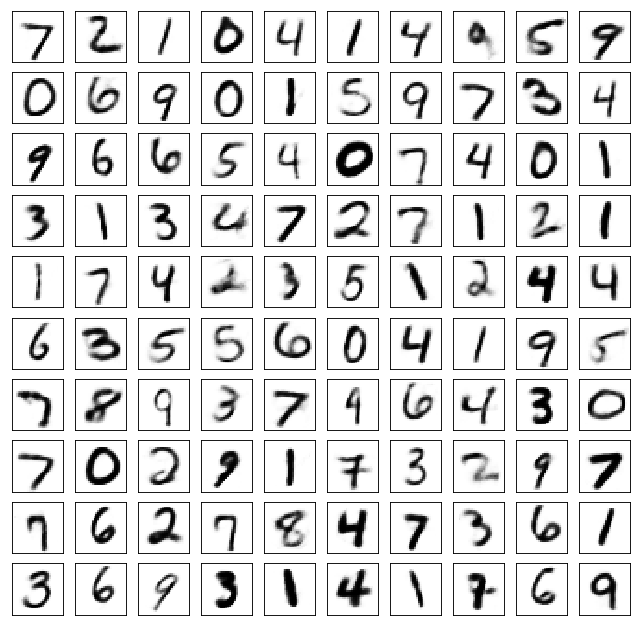

Test losses. E: 0.6960, AE: 0.0593, D: 0.6920
Train Epoch: 94 [0/50000 (0%)]	Losses E: 0.6981, AE: 0.0504, D: 0.6918
Train Epoch: 94 [25000/50000 (50%)]	Losses E: 0.6829, AE: 0.0556, D: 0.6950
Train Epoch: 94 [50000/50000 (100%)]	Losses E: 0.6878, AE: 0.0614, D: 0.6973


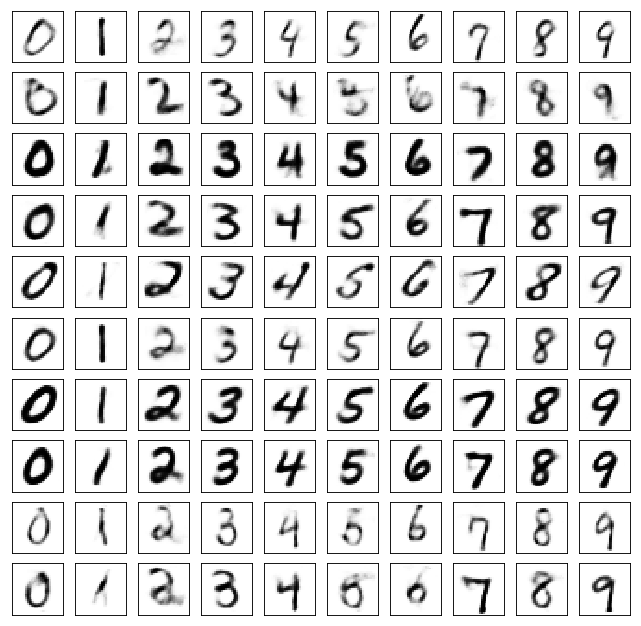

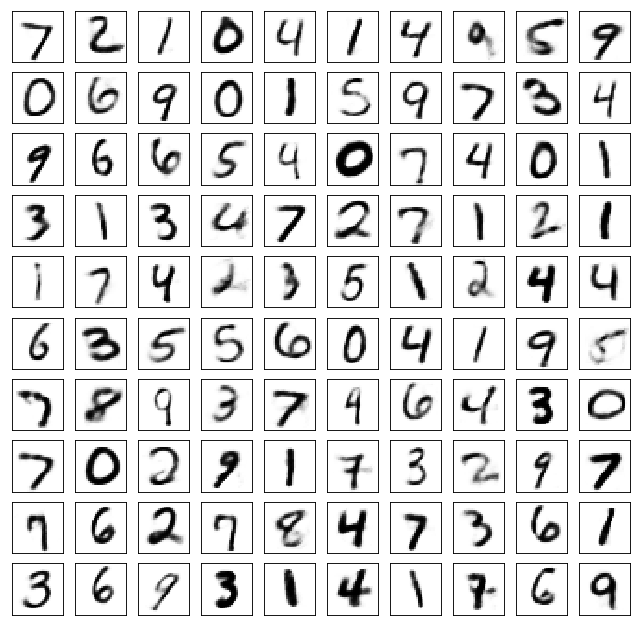

Test losses. E: 0.6878, AE: 0.0610, D: 0.6946
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.6882, AE: 0.0581, D: 0.6962
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.7139, AE: 0.0565, D: 0.6891
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.7045, AE: 0.0532, D: 0.6936


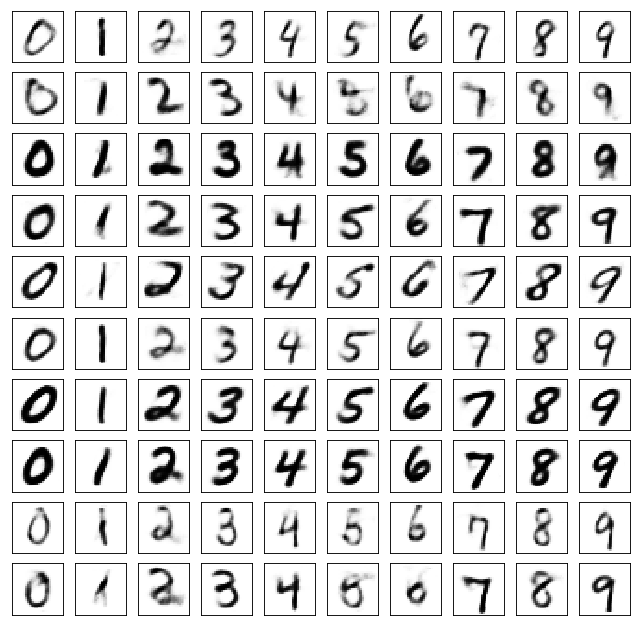

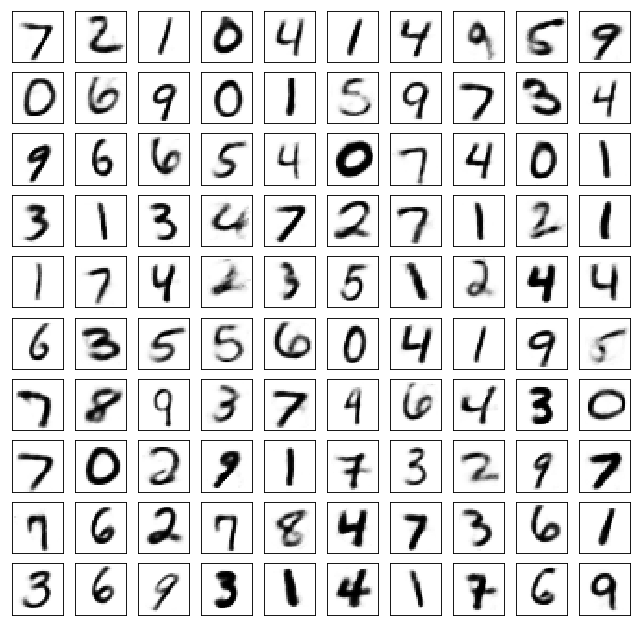

Test losses. E: 0.7042, AE: 0.0597, D: 0.6919
Train Epoch: 96 [0/50000 (0%)]	Losses E: 0.7030, AE: 0.0530, D: 0.6923
Train Epoch: 96 [25000/50000 (50%)]	Losses E: 0.6995, AE: 0.0556, D: 0.6917
Train Epoch: 96 [50000/50000 (100%)]	Losses E: 0.6878, AE: 0.0590, D: 0.6945


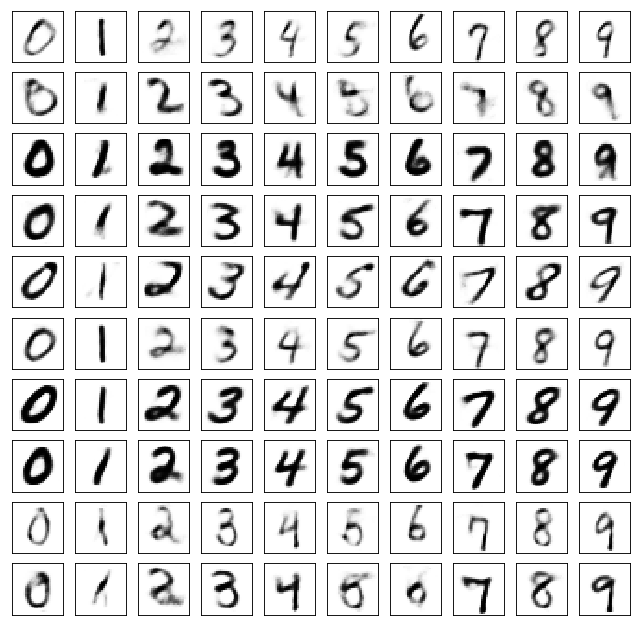

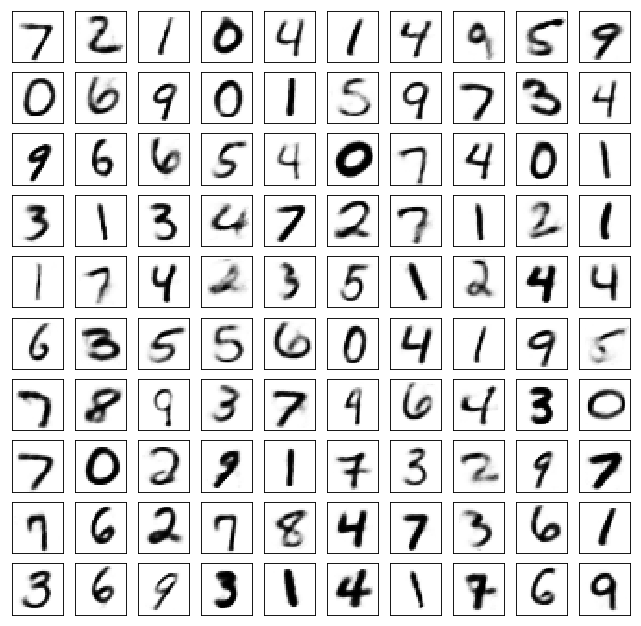

Test losses. E: 0.6892, AE: 0.0605, D: 0.6943
Train Epoch: 97 [0/50000 (0%)]	Losses E: 0.6868, AE: 0.0544, D: 0.6957
Train Epoch: 97 [25000/50000 (50%)]	Losses E: 0.6917, AE: 0.0529, D: 0.6960
Train Epoch: 97 [50000/50000 (100%)]	Losses E: 0.6907, AE: 0.0534, D: 0.6921


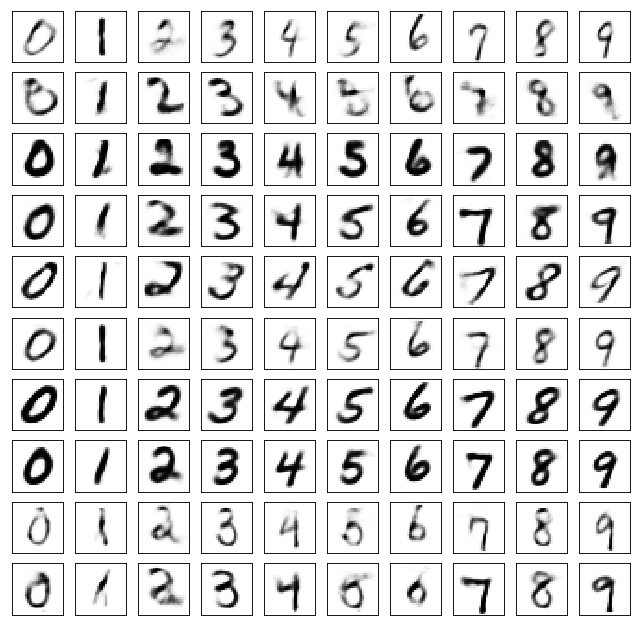

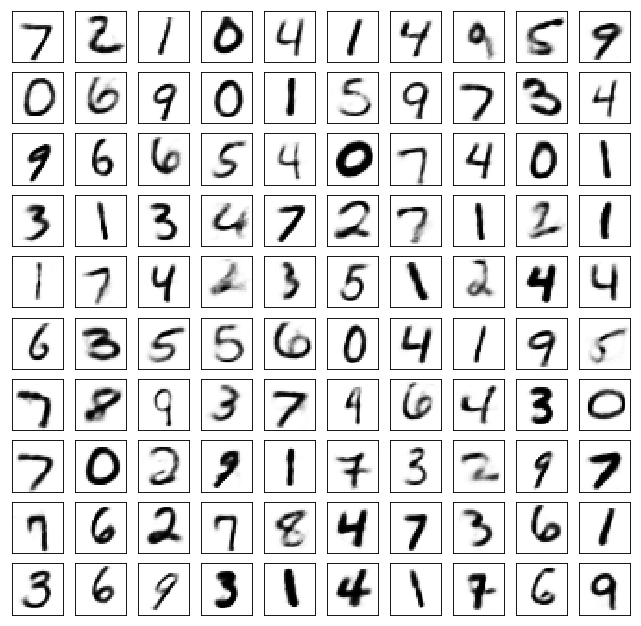

Test losses. E: 0.6921, AE: 0.0586, D: 0.6920
Train Epoch: 98 [0/50000 (0%)]	Losses E: 0.6929, AE: 0.0552, D: 0.6925
Train Epoch: 98 [25000/50000 (50%)]	Losses E: 0.6887, AE: 0.0531, D: 0.6918
Train Epoch: 98 [50000/50000 (100%)]	Losses E: 0.6992, AE: 0.0510, D: 0.6950


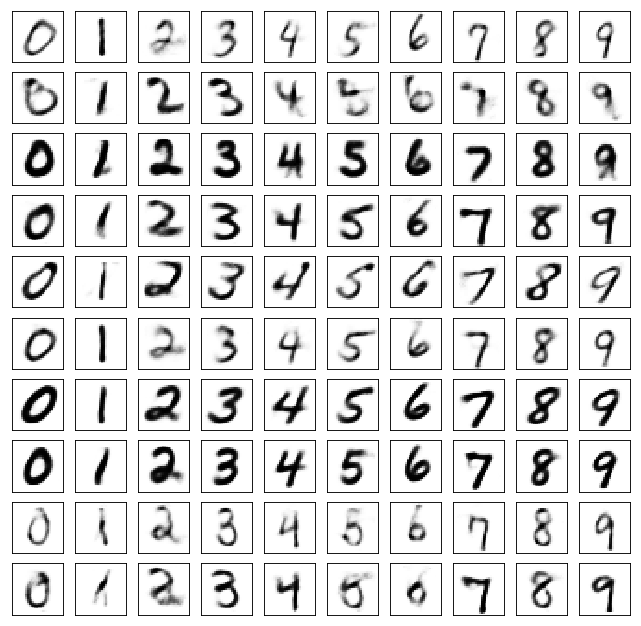

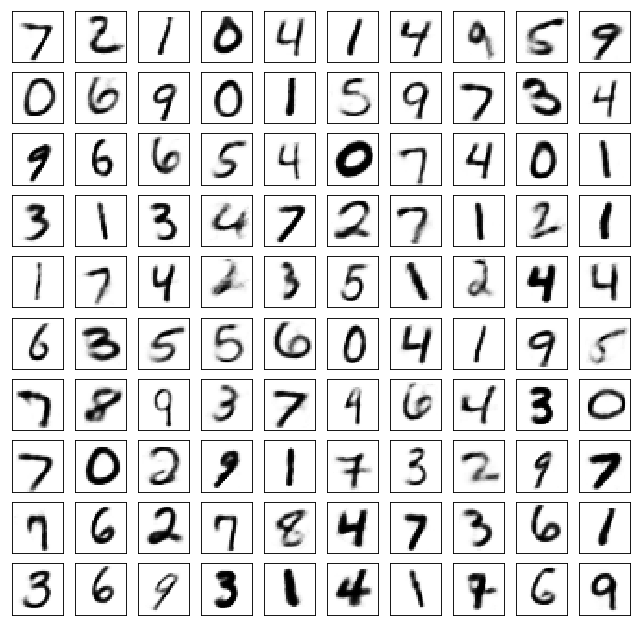

Test losses. E: 0.6987, AE: 0.0582, D: 0.6933
Train Epoch: 99 [0/50000 (0%)]	Losses E: 0.6981, AE: 0.0567, D: 0.6935
Train Epoch: 99 [25000/50000 (50%)]	Losses E: 0.6925, AE: 0.0518, D: 0.6913
Train Epoch: 99 [50000/50000 (100%)]	Losses E: 0.6988, AE: 0.0538, D: 0.6922


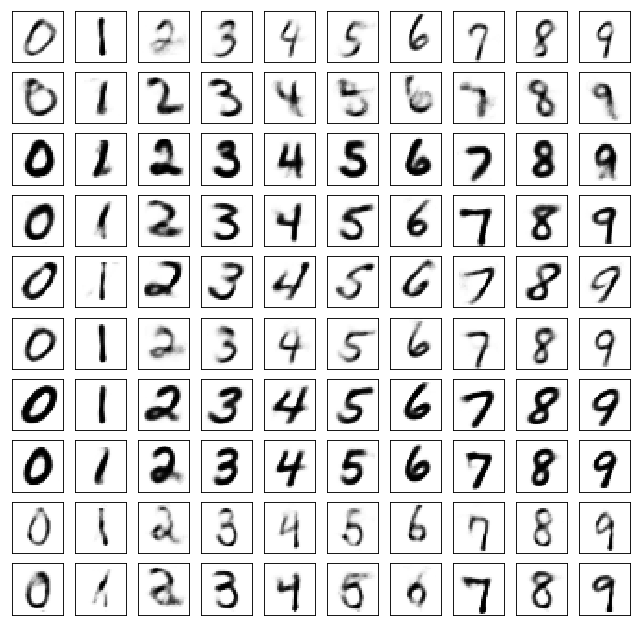

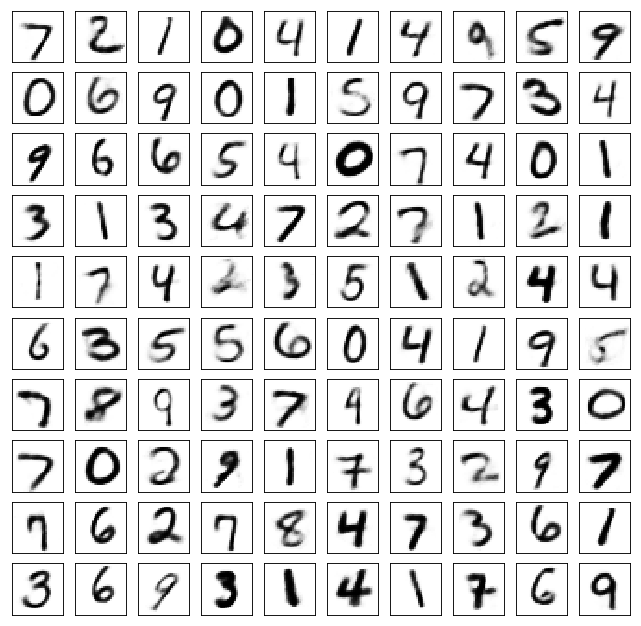

Test losses. E: 0.6963, AE: 0.0586, D: 0.6923
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.6951, AE: 0.0520, D: 0.6919
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.6898, AE: 0.0555, D: 0.6946
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.6876, AE: 0.0545, D: 0.6968


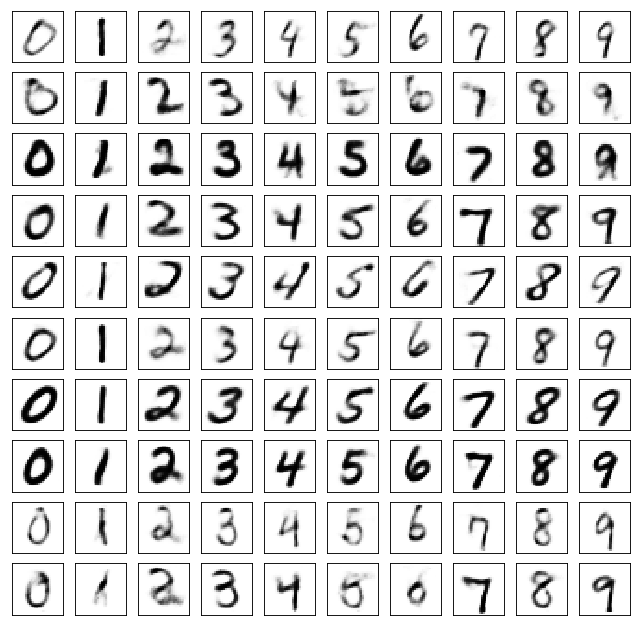

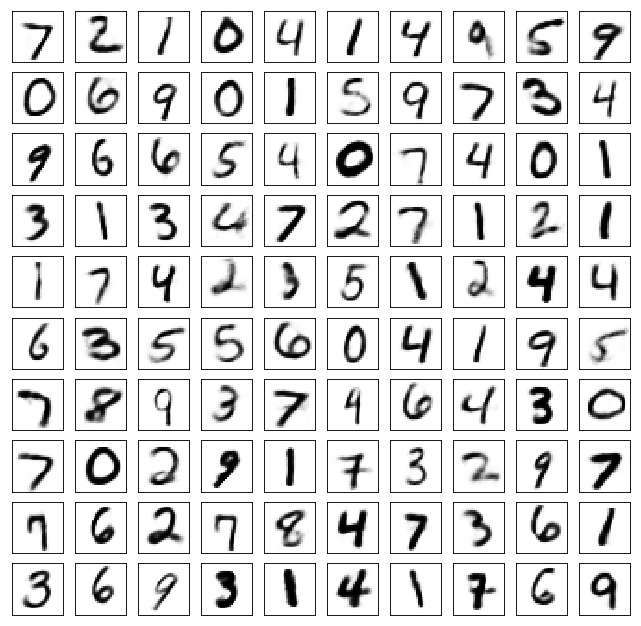

Test losses. E: 0.6899, AE: 0.0603, D: 0.6944
Train Epoch: 101 [0/50000 (0%)]	Losses E: 0.6905, AE: 0.0549, D: 0.6935
Train Epoch: 101 [25000/50000 (50%)]	Losses E: 0.7014, AE: 0.0537, D: 0.6940
Train Epoch: 101 [50000/50000 (100%)]	Losses E: 0.6870, AE: 0.0555, D: 0.6948


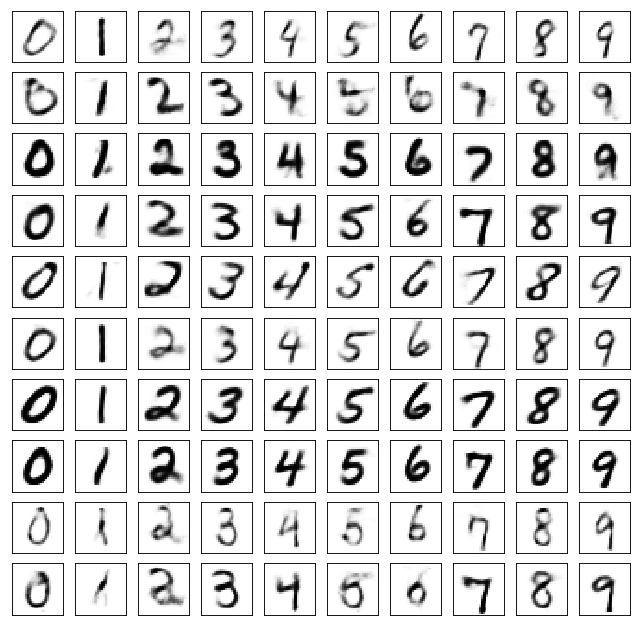

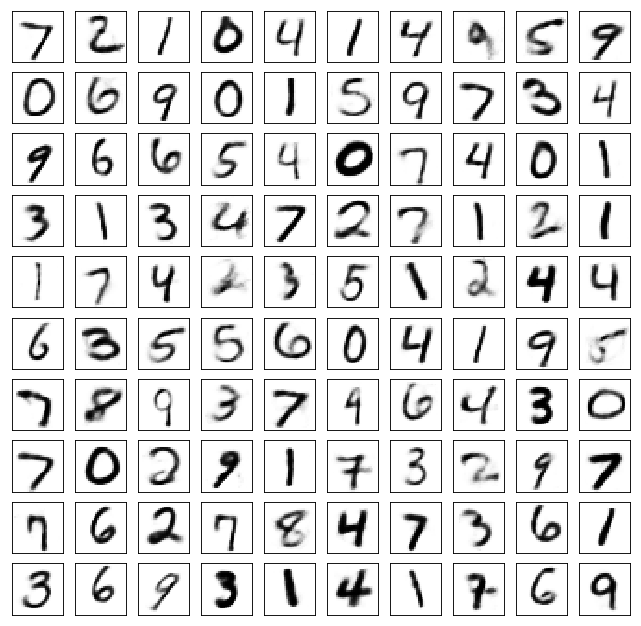

Test losses. E: 0.6882, AE: 0.0595, D: 0.6939
Train Epoch: 102 [0/50000 (0%)]	Losses E: 0.6824, AE: 0.0571, D: 0.6971
Train Epoch: 102 [25000/50000 (50%)]	Losses E: 0.7005, AE: 0.0515, D: 0.6947
Train Epoch: 102 [50000/50000 (100%)]	Losses E: 0.6902, AE: 0.0572, D: 0.6928


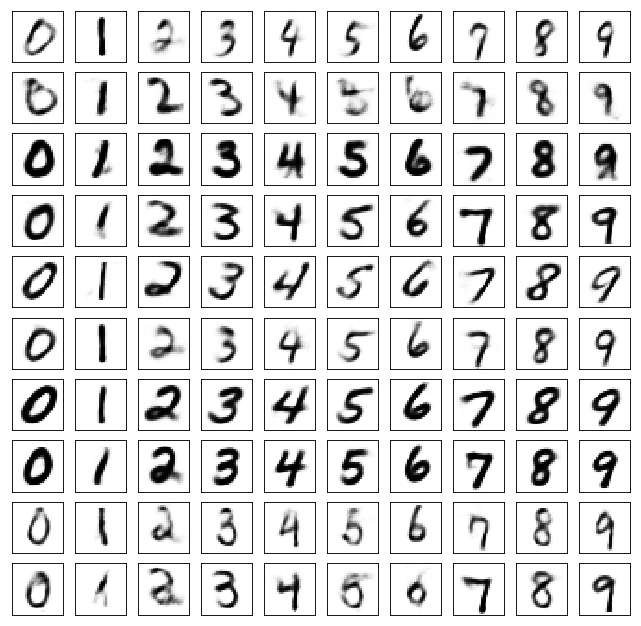

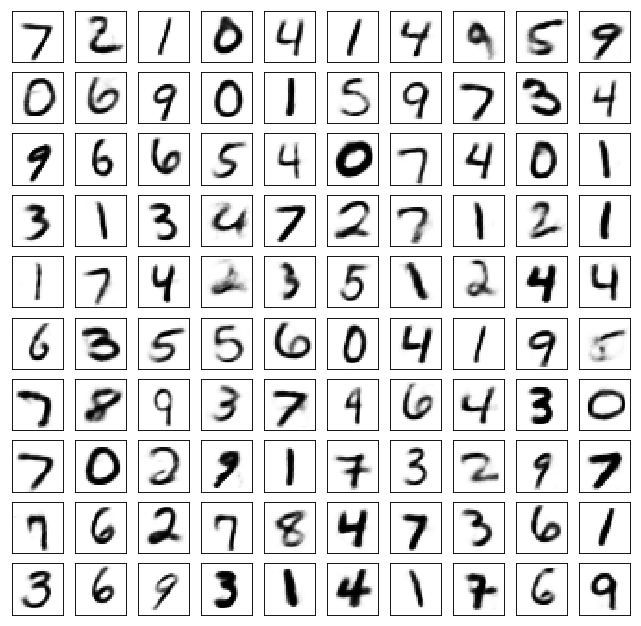

Test losses. E: 0.6881, AE: 0.0604, D: 0.6933
Train Epoch: 103 [0/50000 (0%)]	Losses E: 0.6868, AE: 0.0529, D: 0.6916
Train Epoch: 103 [25000/50000 (50%)]	Losses E: 0.6730, AE: 0.0581, D: 0.6950
Train Epoch: 103 [50000/50000 (100%)]	Losses E: 0.6921, AE: 0.0508, D: 0.6954


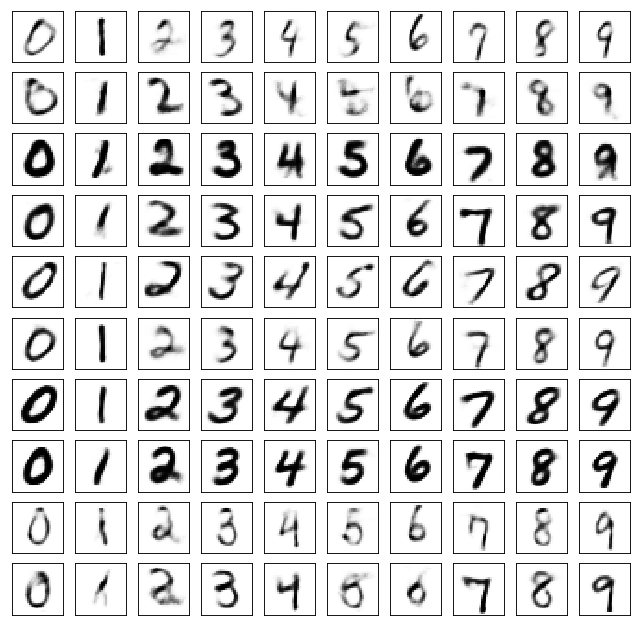

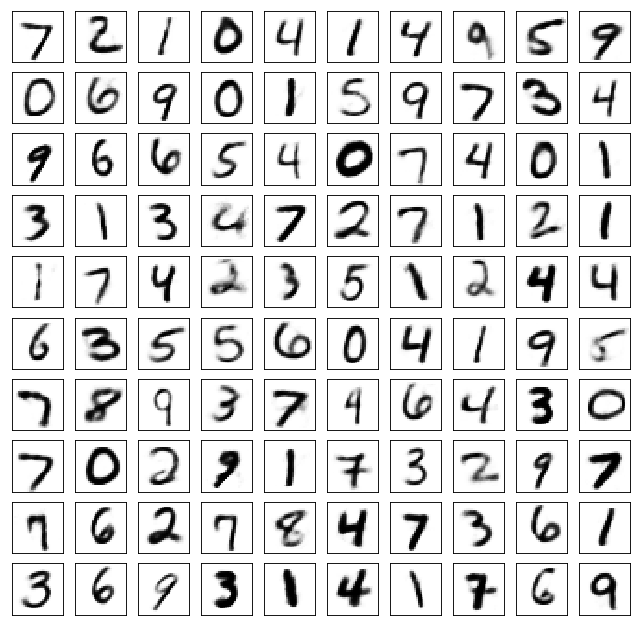

Test losses. E: 0.6906, AE: 0.0592, D: 0.6958
Train Epoch: 104 [0/50000 (0%)]	Losses E: 0.6903, AE: 0.0561, D: 0.6959
Train Epoch: 104 [25000/50000 (50%)]	Losses E: 0.6892, AE: 0.0504, D: 0.6914
Train Epoch: 104 [50000/50000 (100%)]	Losses E: 0.6855, AE: 0.0505, D: 0.6939


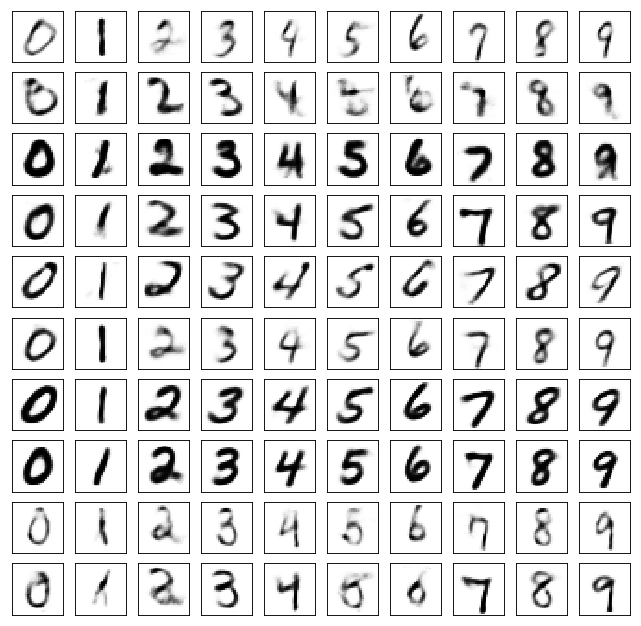

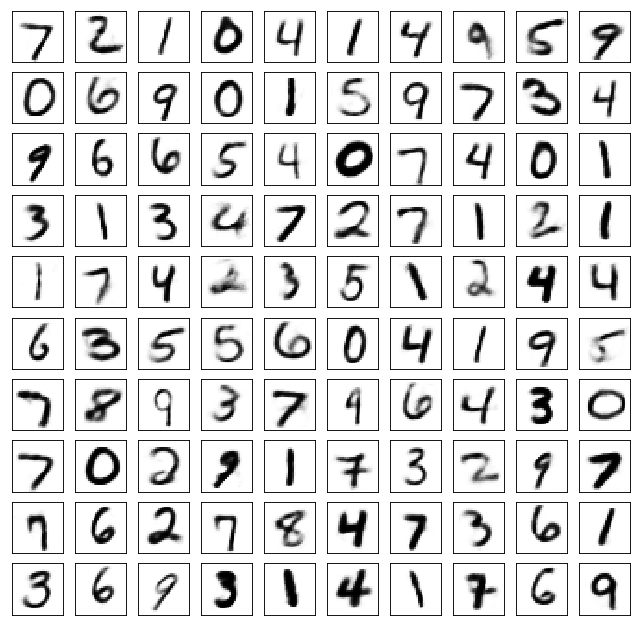

Test losses. E: 0.6855, AE: 0.0575, D: 0.6936
Train Epoch: 105 [0/50000 (0%)]	Losses E: 0.6853, AE: 0.0524, D: 0.6932
Train Epoch: 105 [25000/50000 (50%)]	Losses E: 0.6830, AE: 0.0505, D: 0.6928
Train Epoch: 105 [50000/50000 (100%)]	Losses E: 0.6814, AE: 0.0521, D: 0.6924


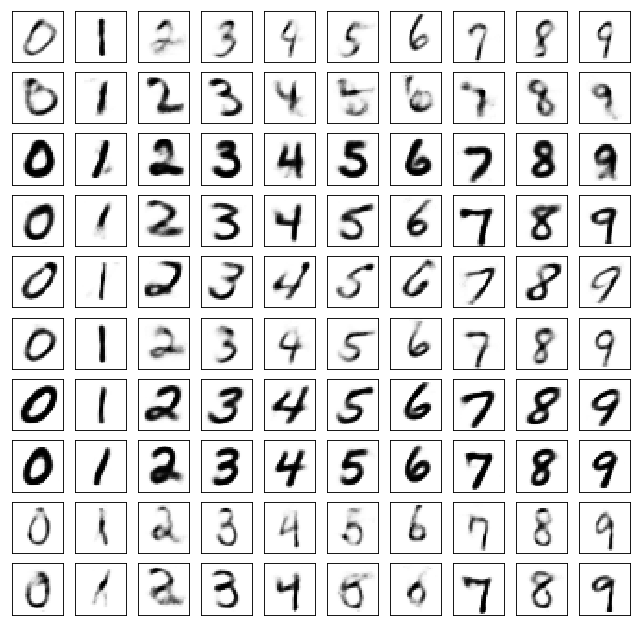

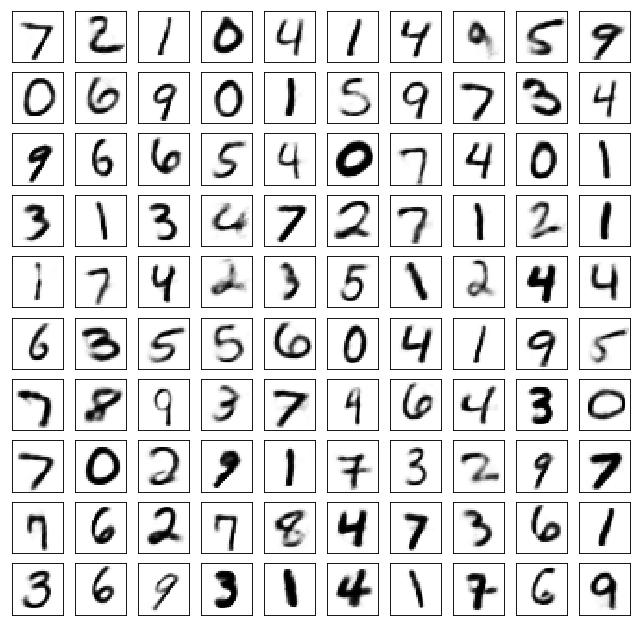

Test losses. E: 0.6809, AE: 0.0572, D: 0.6938
Train Epoch: 106 [0/50000 (0%)]	Losses E: 0.6800, AE: 0.0508, D: 0.6940
Train Epoch: 106 [25000/50000 (50%)]	Losses E: 0.6821, AE: 0.0522, D: 0.6912
Train Epoch: 106 [50000/50000 (100%)]	Losses E: 0.6947, AE: 0.0491, D: 0.6934


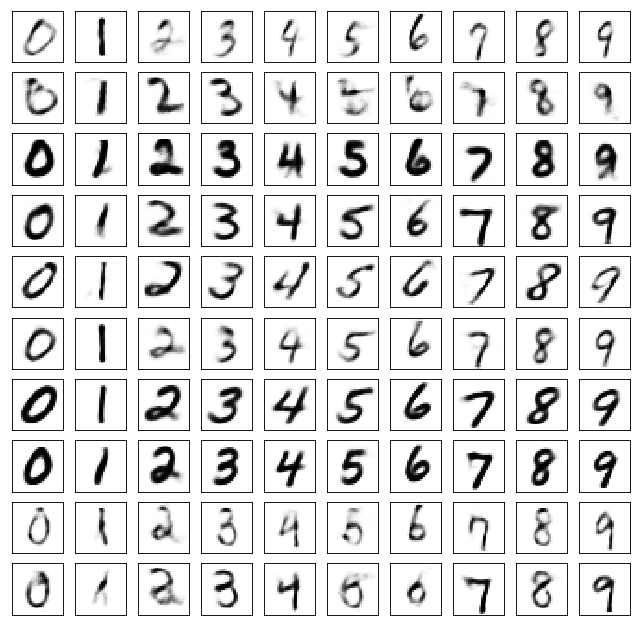

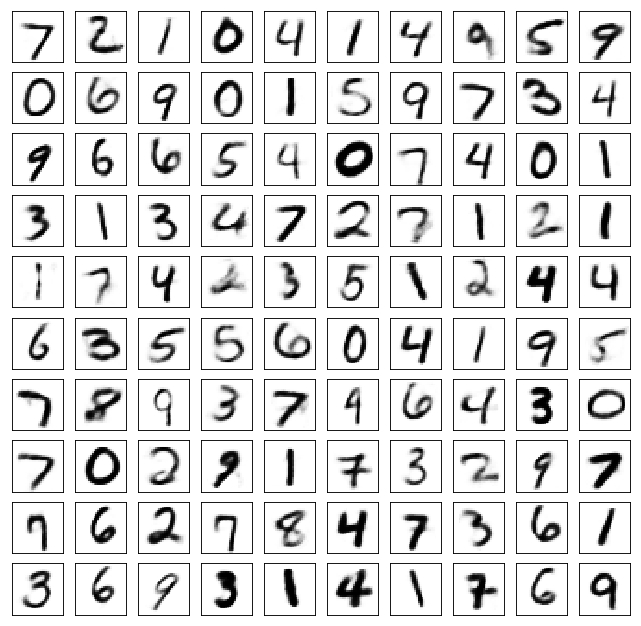

Test losses. E: 0.6921, AE: 0.0573, D: 0.6933
Train Epoch: 107 [0/50000 (0%)]	Losses E: 0.6876, AE: 0.0515, D: 0.6948
Train Epoch: 107 [25000/50000 (50%)]	Losses E: 0.6906, AE: 0.0476, D: 0.6930
Train Epoch: 107 [50000/50000 (100%)]	Losses E: 0.6753, AE: 0.0495, D: 0.6943


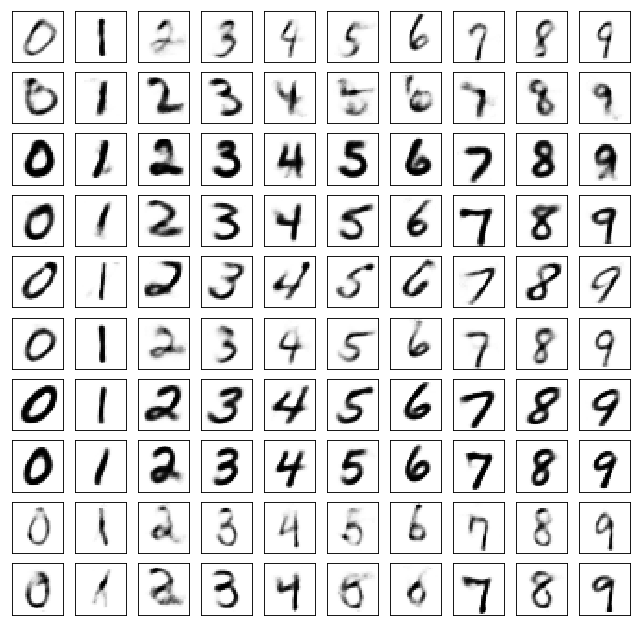

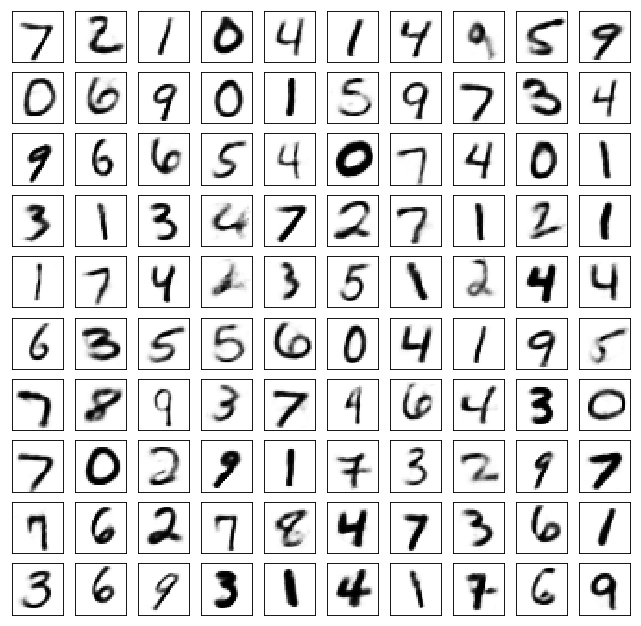

Test losses. E: 0.6725, AE: 0.0578, D: 0.6949
Train Epoch: 108 [0/50000 (0%)]	Losses E: 0.6729, AE: 0.0516, D: 0.6960
Train Epoch: 108 [25000/50000 (50%)]	Losses E: 0.6868, AE: 0.0509, D: 0.6949
Train Epoch: 108 [50000/50000 (100%)]	Losses E: 0.6779, AE: 0.0526, D: 0.6935


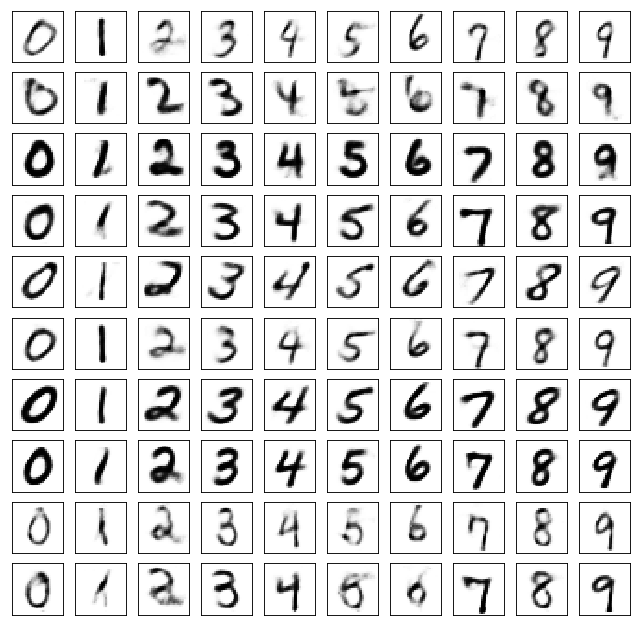

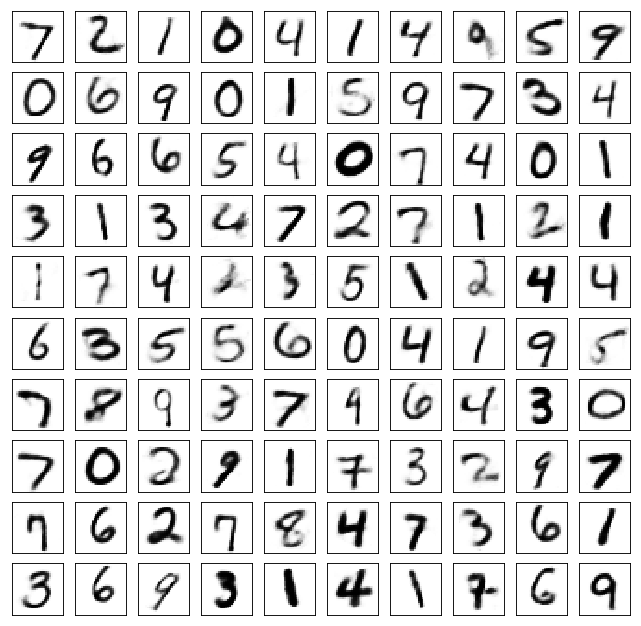

Test losses. E: 0.6776, AE: 0.0575, D: 0.6937
Train Epoch: 109 [0/50000 (0%)]	Losses E: 0.6824, AE: 0.0513, D: 0.6942
Train Epoch: 109 [25000/50000 (50%)]	Losses E: 0.7047, AE: 0.0480, D: 0.6938
Train Epoch: 109 [50000/50000 (100%)]	Losses E: 0.6959, AE: 0.0522, D: 0.6928


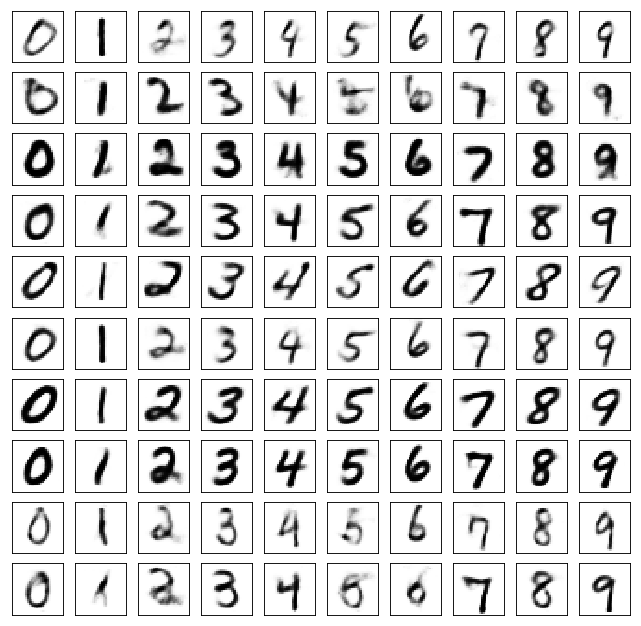

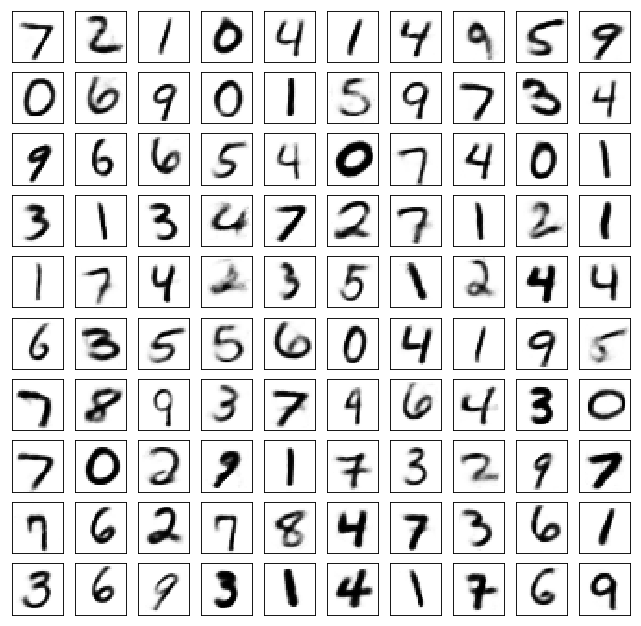

Test losses. E: 0.6949, AE: 0.0581, D: 0.6932
Train Epoch: 110 [0/50000 (0%)]	Losses E: 0.6970, AE: 0.0507, D: 0.6923
Train Epoch: 110 [25000/50000 (50%)]	Losses E: 0.6838, AE: 0.0462, D: 0.6932
Train Epoch: 110 [50000/50000 (100%)]	Losses E: 0.6802, AE: 0.0493, D: 0.6936


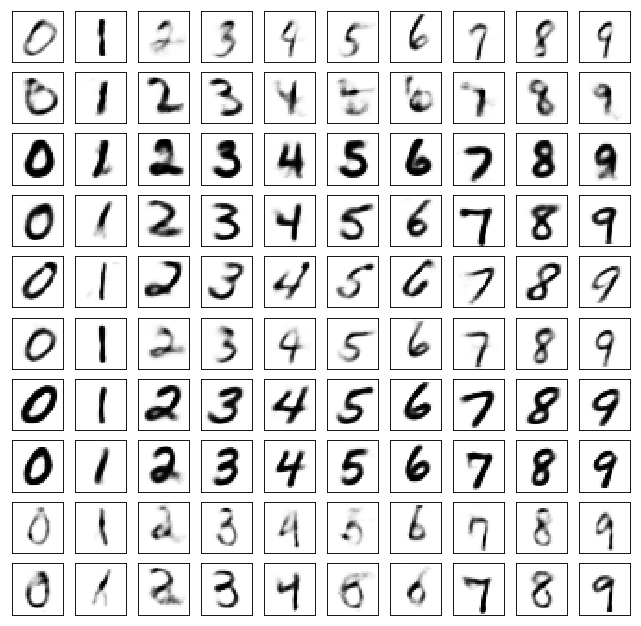

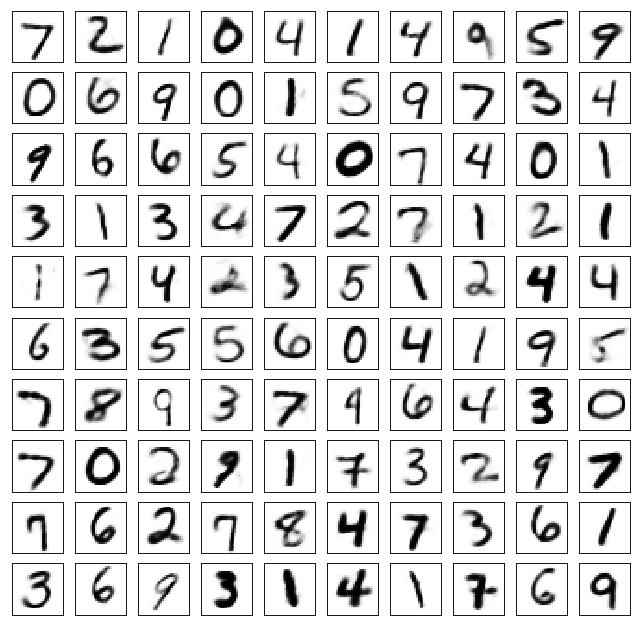

Test losses. E: 0.6818, AE: 0.0575, D: 0.6941
Train Epoch: 111 [0/50000 (0%)]	Losses E: 0.6810, AE: 0.0537, D: 0.6925
Train Epoch: 111 [25000/50000 (50%)]	Losses E: 0.6858, AE: 0.0492, D: 0.6913
Train Epoch: 111 [50000/50000 (100%)]	Losses E: 0.6901, AE: 0.0478, D: 0.6943


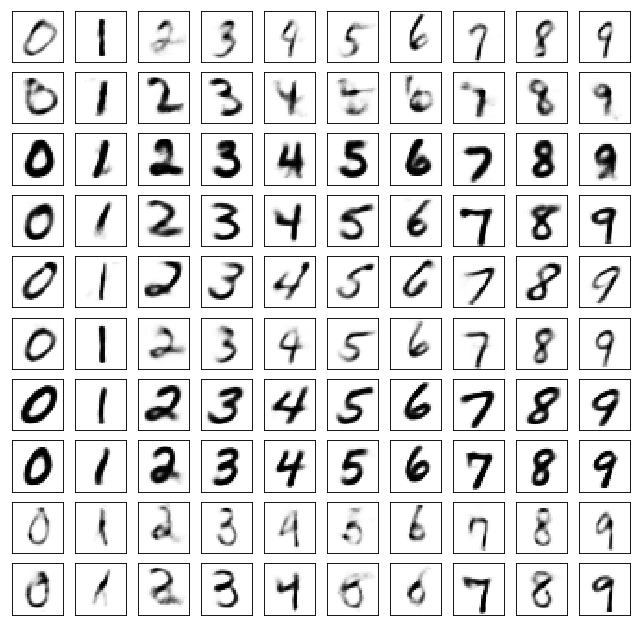

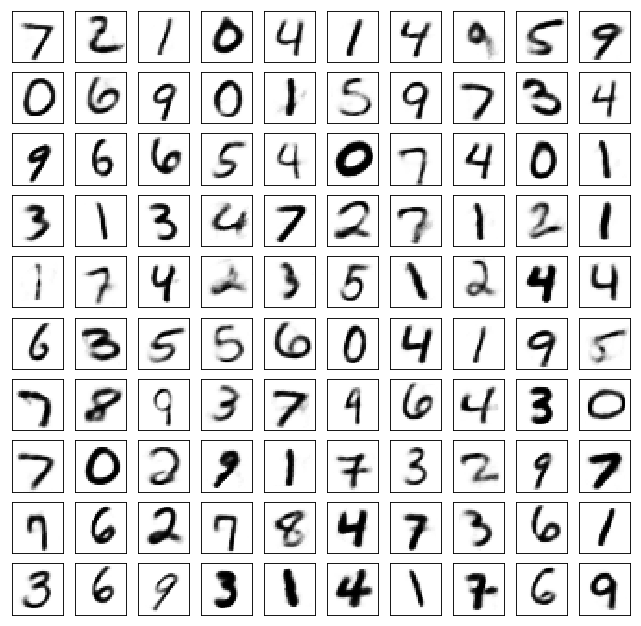

Test losses. E: 0.6919, AE: 0.0562, D: 0.6935
Train Epoch: 112 [0/50000 (0%)]	Losses E: 0.6900, AE: 0.0494, D: 0.6937
Train Epoch: 112 [25000/50000 (50%)]	Losses E: 0.6927, AE: 0.0458, D: 0.6897
Train Epoch: 112 [50000/50000 (100%)]	Losses E: 0.7044, AE: 0.0485, D: 0.6937


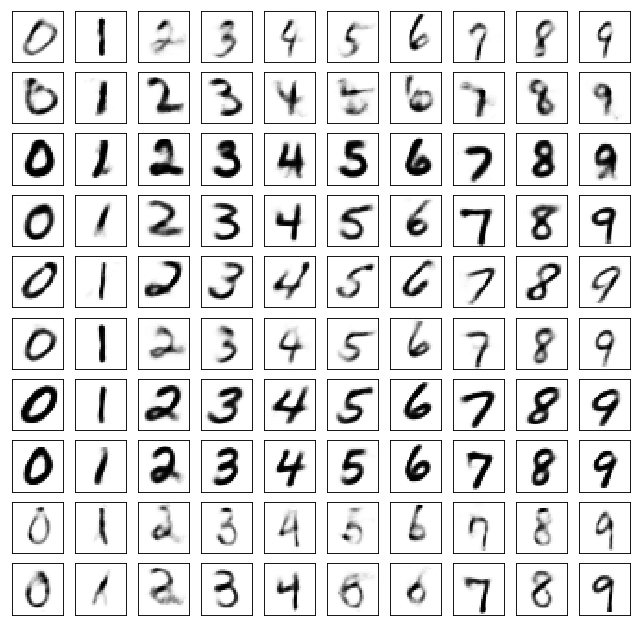

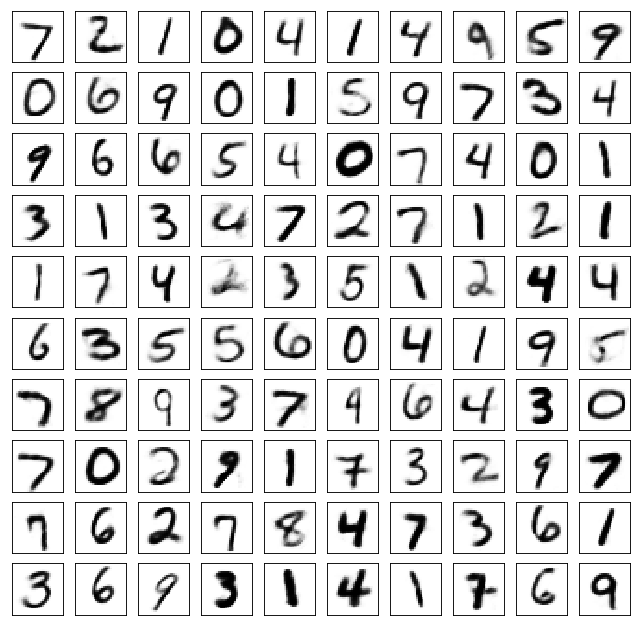

Test losses. E: 0.7062, AE: 0.0565, D: 0.6933
Train Epoch: 113 [0/50000 (0%)]	Losses E: 0.7064, AE: 0.0511, D: 0.6925
Train Epoch: 113 [25000/50000 (50%)]	Losses E: 0.6932, AE: 0.0486, D: 0.6946
Train Epoch: 113 [50000/50000 (100%)]	Losses E: 0.6949, AE: 0.0558, D: 0.6929


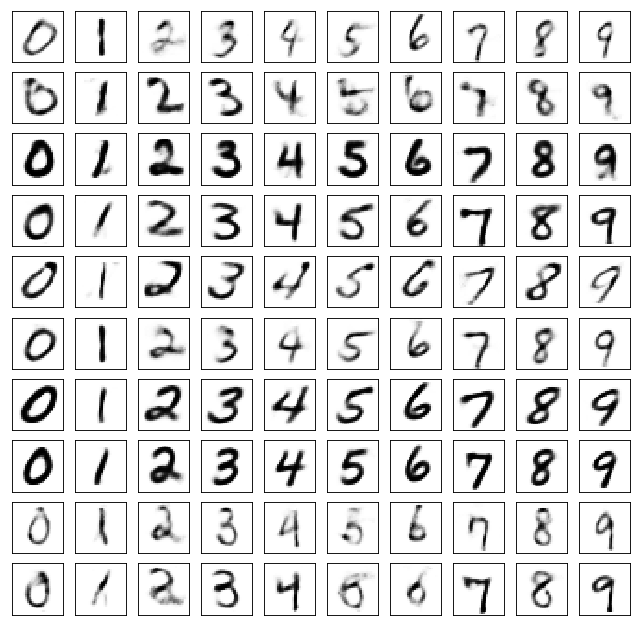

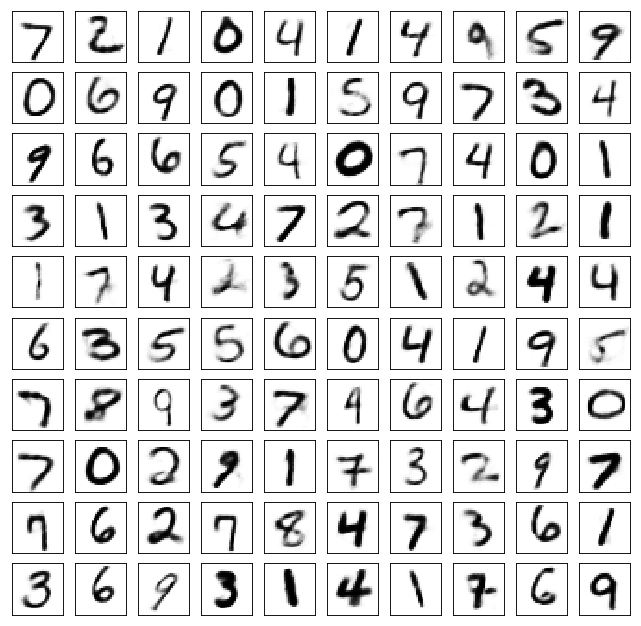

Test losses. E: 0.6952, AE: 0.0571, D: 0.6917
Train Epoch: 114 [0/50000 (0%)]	Losses E: 0.6950, AE: 0.0517, D: 0.6915
Train Epoch: 114 [25000/50000 (50%)]	Losses E: 0.6895, AE: 0.0487, D: 0.6933
Train Epoch: 114 [50000/50000 (100%)]	Losses E: 0.7057, AE: 0.0520, D: 0.6988


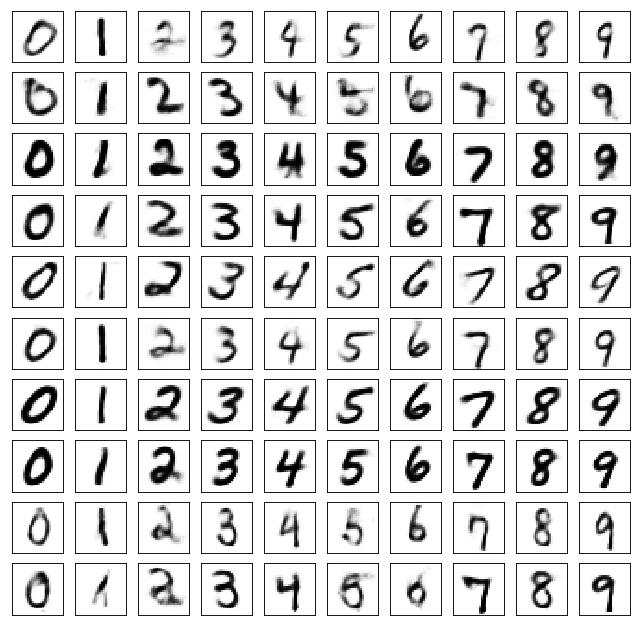

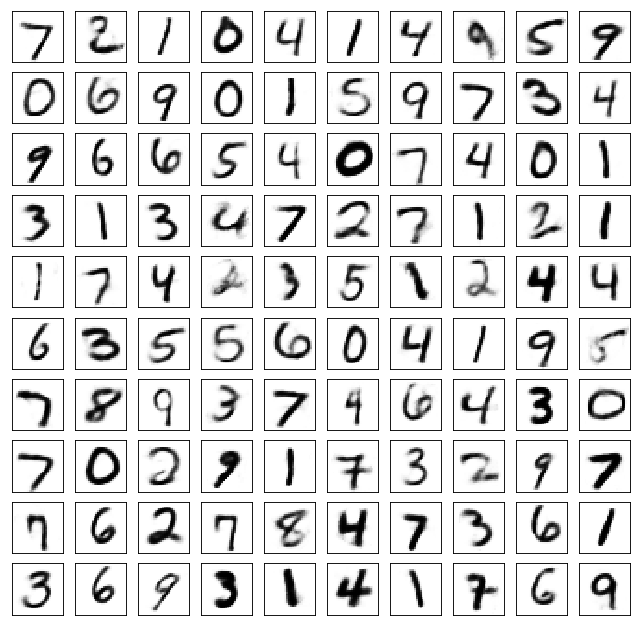

Test losses. E: 0.7048, AE: 0.0594, D: 0.6955
Train Epoch: 115 [0/50000 (0%)]	Losses E: 0.7059, AE: 0.0568, D: 0.6939
Train Epoch: 115 [25000/50000 (50%)]	Losses E: 0.6773, AE: 0.0517, D: 0.6925
Train Epoch: 115 [50000/50000 (100%)]	Losses E: 0.6835, AE: 0.0524, D: 0.6925


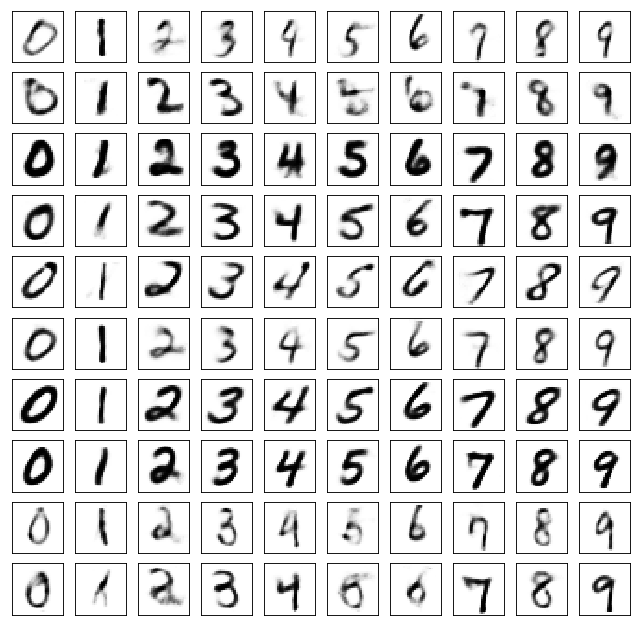

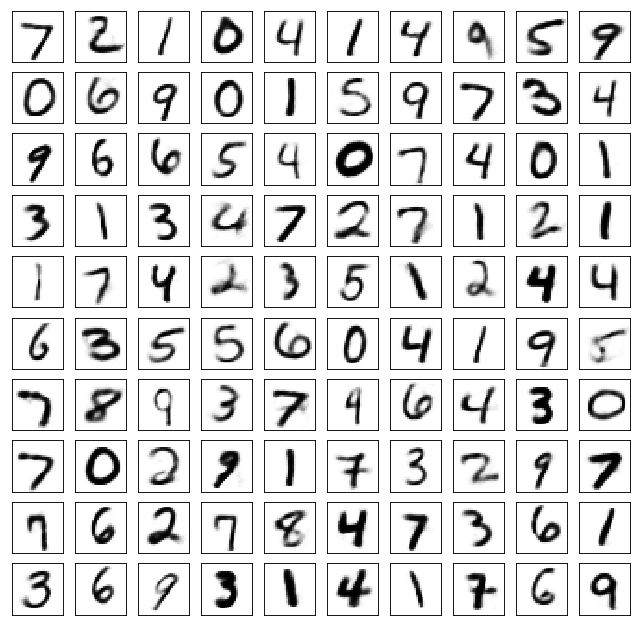

Test losses. E: 0.6850, AE: 0.0556, D: 0.6931
Train Epoch: 116 [0/50000 (0%)]	Losses E: 0.6876, AE: 0.0511, D: 0.6932
Train Epoch: 116 [25000/50000 (50%)]	Losses E: 0.6903, AE: 0.0487, D: 0.6915
Train Epoch: 116 [50000/50000 (100%)]	Losses E: 0.6968, AE: 0.0527, D: 0.6927


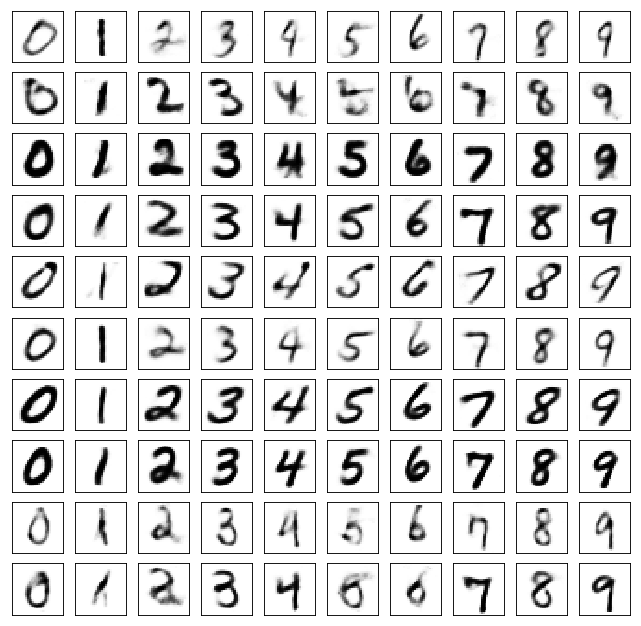

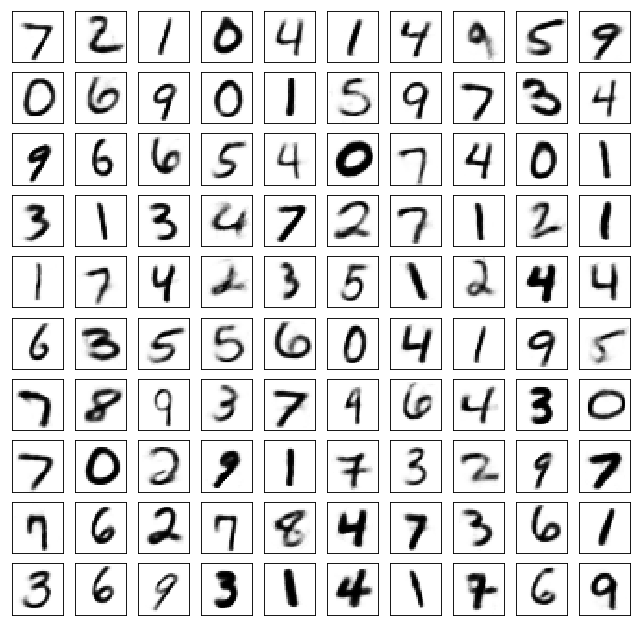

Test losses. E: 0.6982, AE: 0.0561, D: 0.6926
Train Epoch: 117 [0/50000 (0%)]	Losses E: 0.6939, AE: 0.0547, D: 0.6955
Train Epoch: 117 [25000/50000 (50%)]	Losses E: 0.6886, AE: 0.0485, D: 0.6934
Train Epoch: 117 [50000/50000 (100%)]	Losses E: 0.6867, AE: 0.0465, D: 0.6942


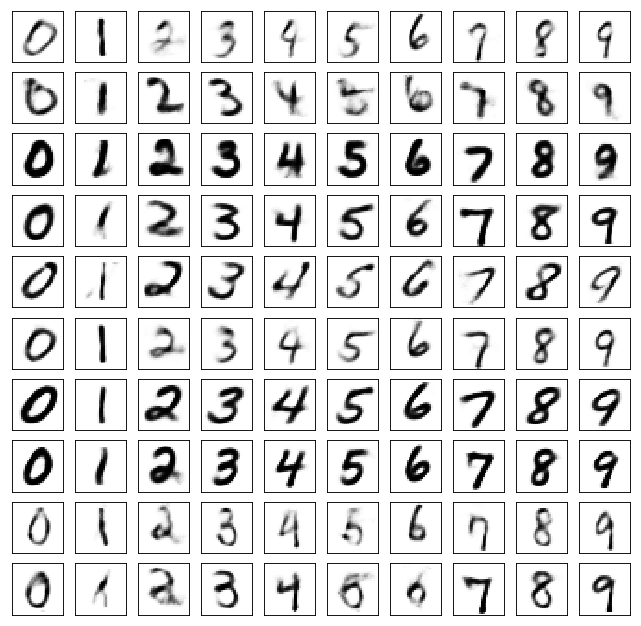

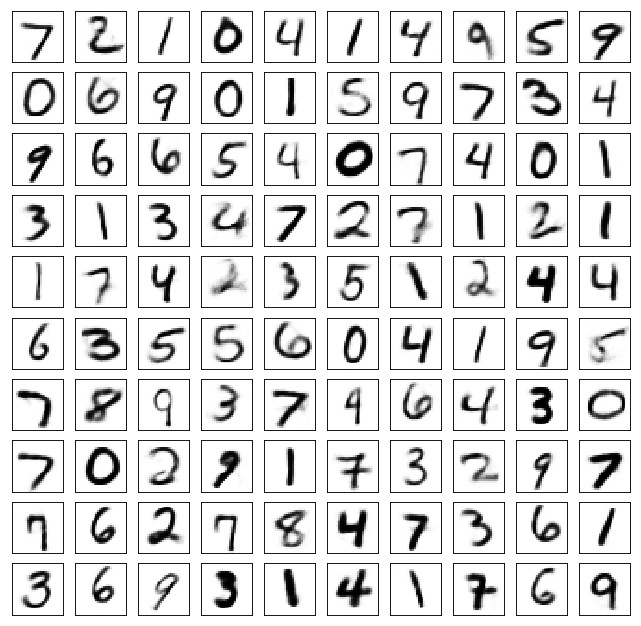

Test losses. E: 0.6897, AE: 0.0552, D: 0.6919
Train Epoch: 118 [0/50000 (0%)]	Losses E: 0.6941, AE: 0.0473, D: 0.6902
Train Epoch: 118 [25000/50000 (50%)]	Losses E: 0.7002, AE: 0.0533, D: 0.6946
Train Epoch: 118 [50000/50000 (100%)]	Losses E: 0.7149, AE: 0.0521, D: 0.6949


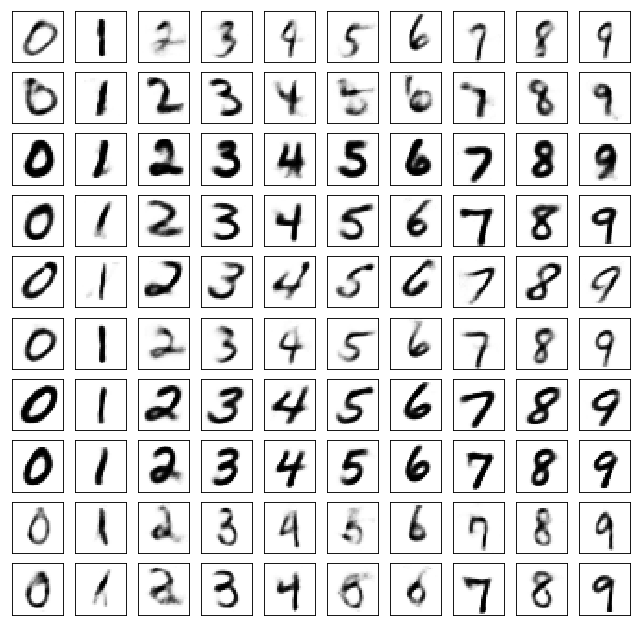

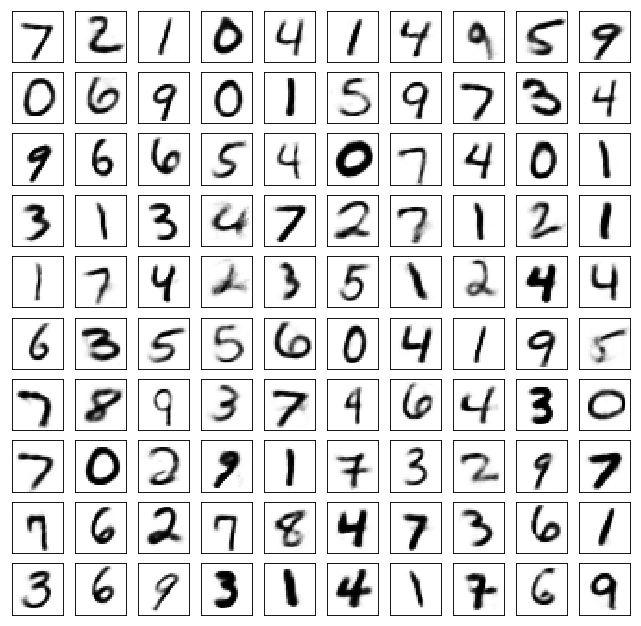

Test losses. E: 0.7127, AE: 0.0562, D: 0.6937
Train Epoch: 119 [0/50000 (0%)]	Losses E: 0.7115, AE: 0.0496, D: 0.6927
Train Epoch: 119 [25000/50000 (50%)]	Losses E: 0.6988, AE: 0.0489, D: 0.6926
Train Epoch: 119 [50000/50000 (100%)]	Losses E: 0.7055, AE: 0.0495, D: 0.6923


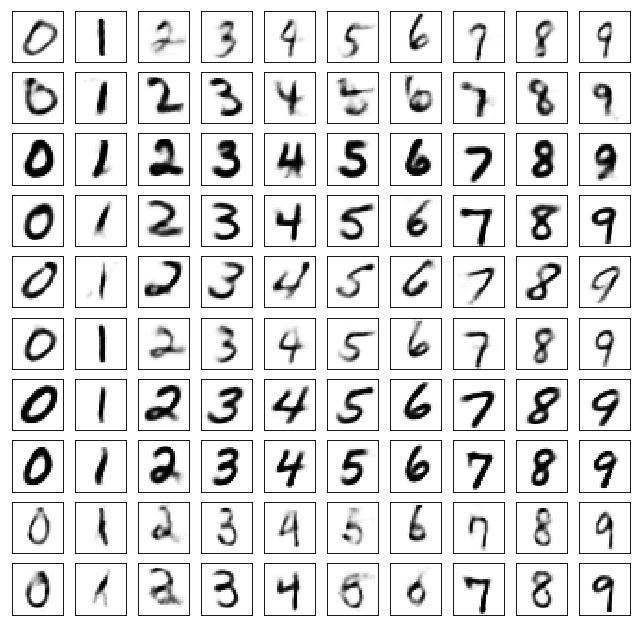

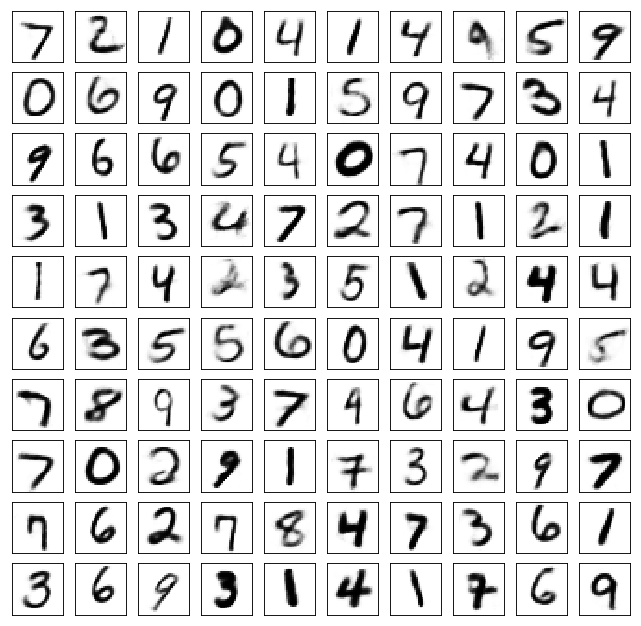

Test losses. E: 0.7050, AE: 0.0563, D: 0.6938
Train Epoch: 120 [0/50000 (0%)]	Losses E: 0.7034, AE: 0.0468, D: 0.6967
Train Epoch: 120 [25000/50000 (50%)]	Losses E: 0.6989, AE: 0.0447, D: 0.6921
Train Epoch: 120 [50000/50000 (100%)]	Losses E: 0.6906, AE: 0.0459, D: 0.6926


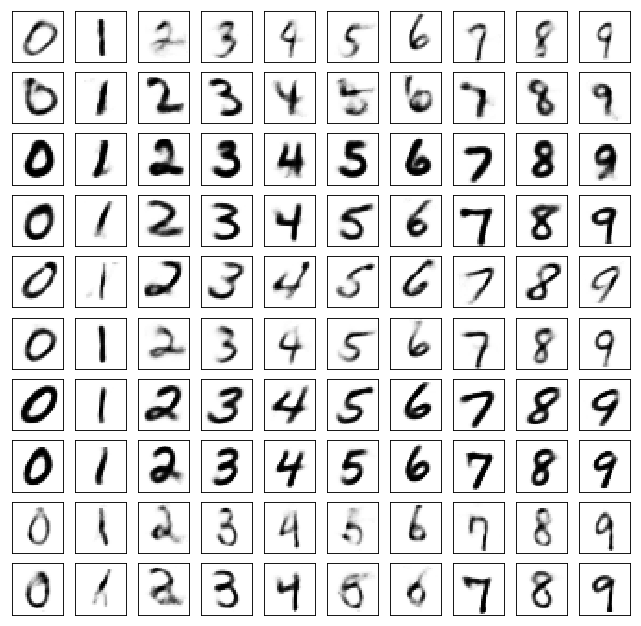

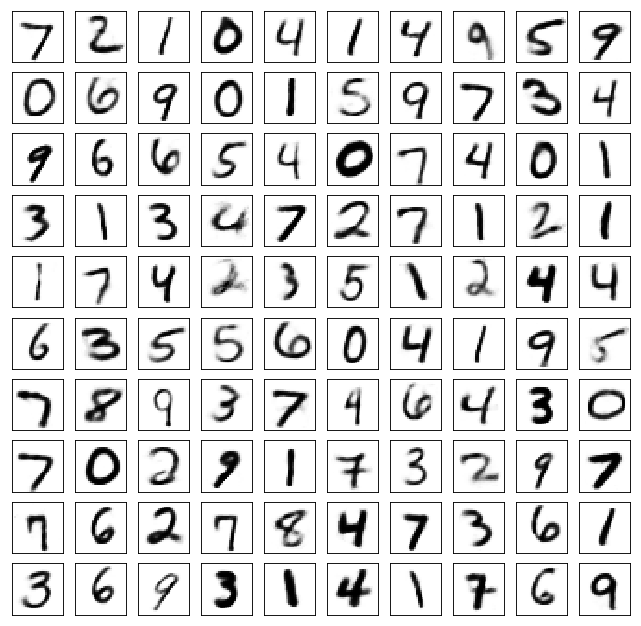

Test losses. E: 0.6908, AE: 0.0555, D: 0.6932
Train Epoch: 121 [0/50000 (0%)]	Losses E: 0.6909, AE: 0.0494, D: 0.6937
Train Epoch: 121 [25000/50000 (50%)]	Losses E: 0.6909, AE: 0.0479, D: 0.6921
Train Epoch: 121 [50000/50000 (100%)]	Losses E: 0.6887, AE: 0.0482, D: 0.6946


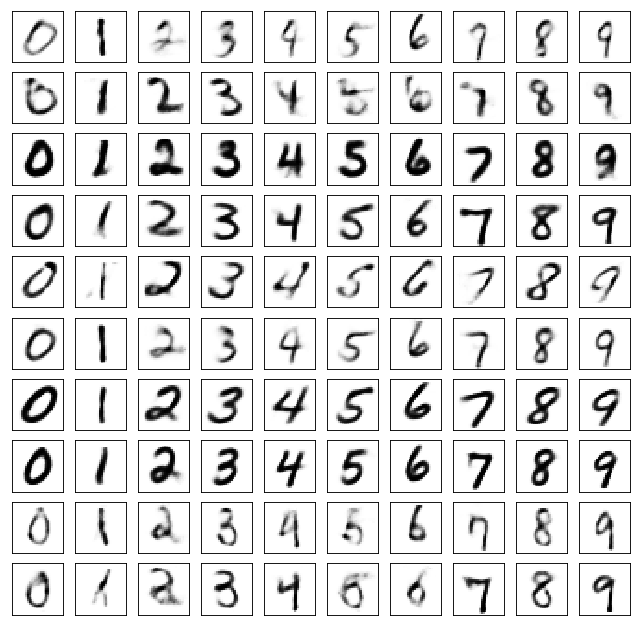

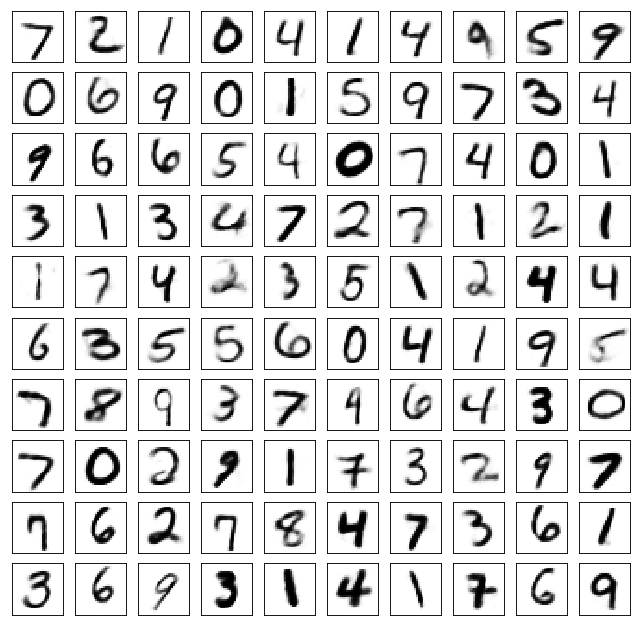

Test losses. E: 0.6867, AE: 0.0547, D: 0.6934
Train Epoch: 122 [0/50000 (0%)]	Losses E: 0.6845, AE: 0.0486, D: 0.6964
Train Epoch: 122 [25000/50000 (50%)]	Losses E: 0.7000, AE: 0.0457, D: 0.6907
Train Epoch: 122 [50000/50000 (100%)]	Losses E: 0.6840, AE: 0.0484, D: 0.6943


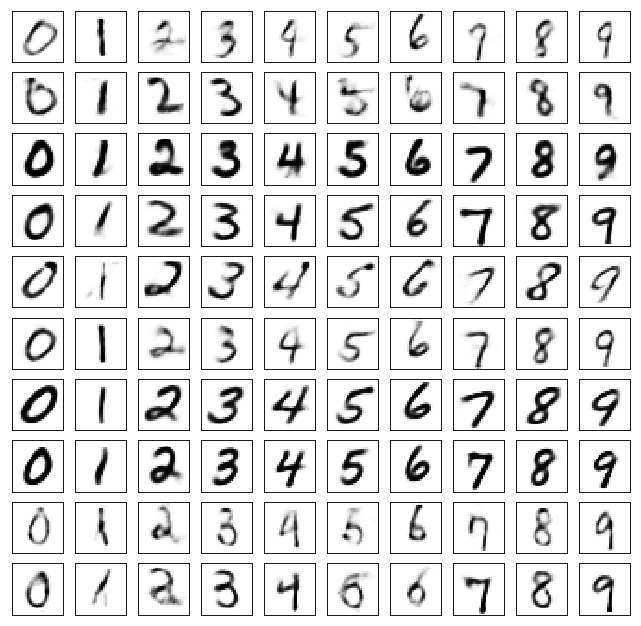

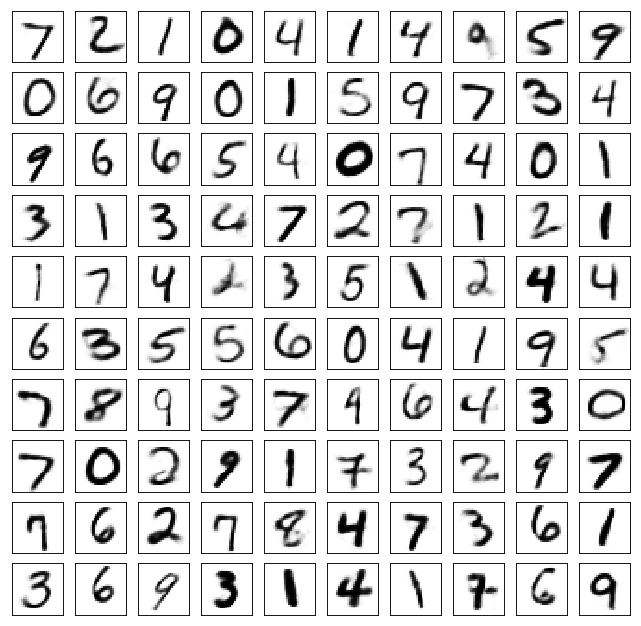

Test losses. E: 0.6813, AE: 0.0557, D: 0.6935
Train Epoch: 123 [0/50000 (0%)]	Losses E: 0.6803, AE: 0.0493, D: 0.6944
Train Epoch: 123 [25000/50000 (50%)]	Losses E: 0.6928, AE: 0.0496, D: 0.6910
Train Epoch: 123 [50000/50000 (100%)]	Losses E: 0.6979, AE: 0.0447, D: 0.6917


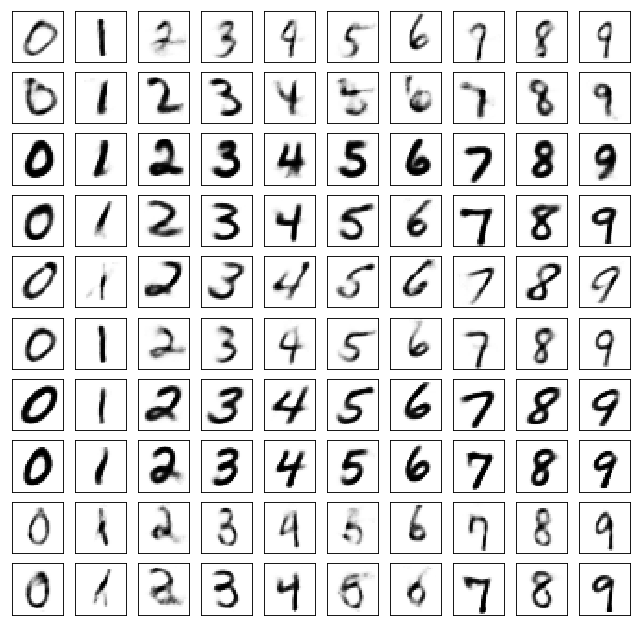

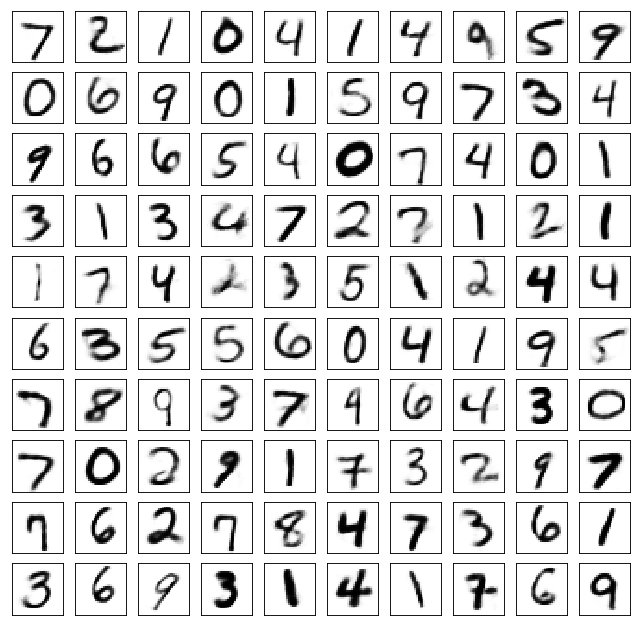

Test losses. E: 0.6948, AE: 0.0543, D: 0.6918
Train Epoch: 124 [0/50000 (0%)]	Losses E: 0.6960, AE: 0.0463, D: 0.6928
Train Epoch: 124 [25000/50000 (50%)]	Losses E: 0.7028, AE: 0.0464, D: 0.6914
Train Epoch: 124 [50000/50000 (100%)]	Losses E: 0.7022, AE: 0.0503, D: 0.6920


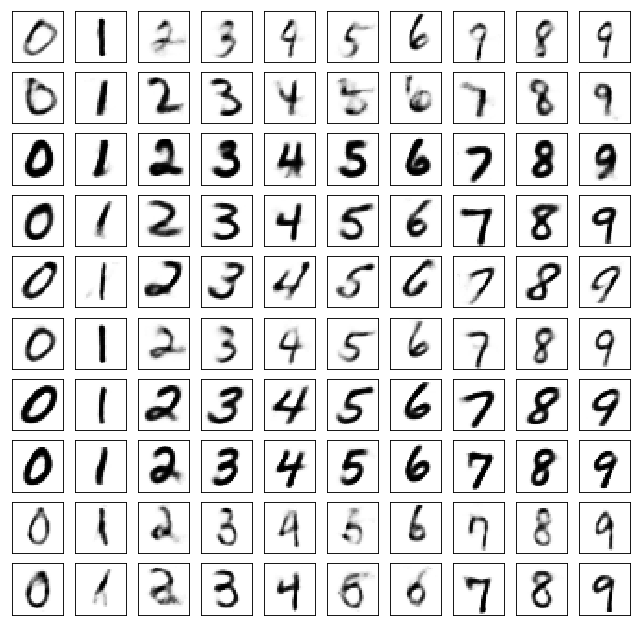

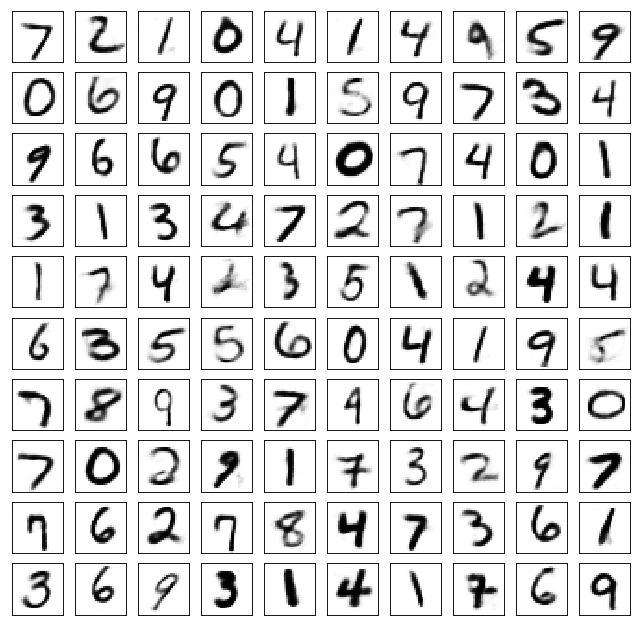

Test losses. E: 0.7032, AE: 0.0565, D: 0.6941
Train Epoch: 125 [0/50000 (0%)]	Losses E: 0.7052, AE: 0.0500, D: 0.6949
Train Epoch: 125 [25000/50000 (50%)]	Losses E: 0.7127, AE: 0.0439, D: 0.6900
Train Epoch: 125 [50000/50000 (100%)]	Losses E: 0.6978, AE: 0.0461, D: 0.6931


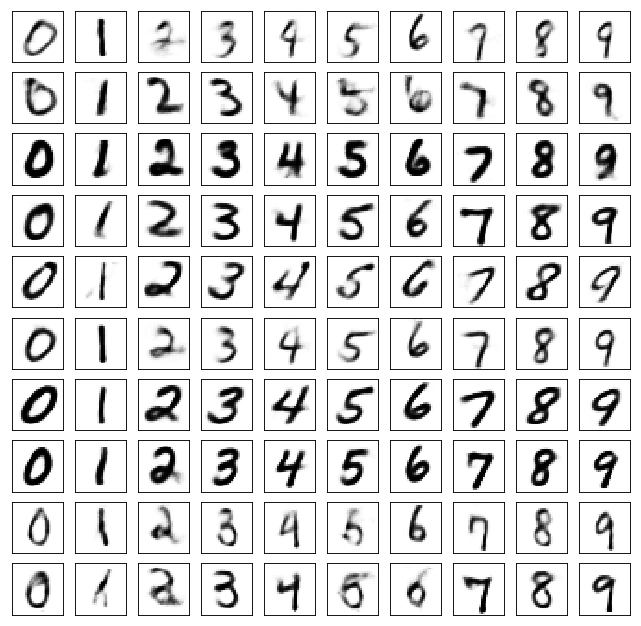

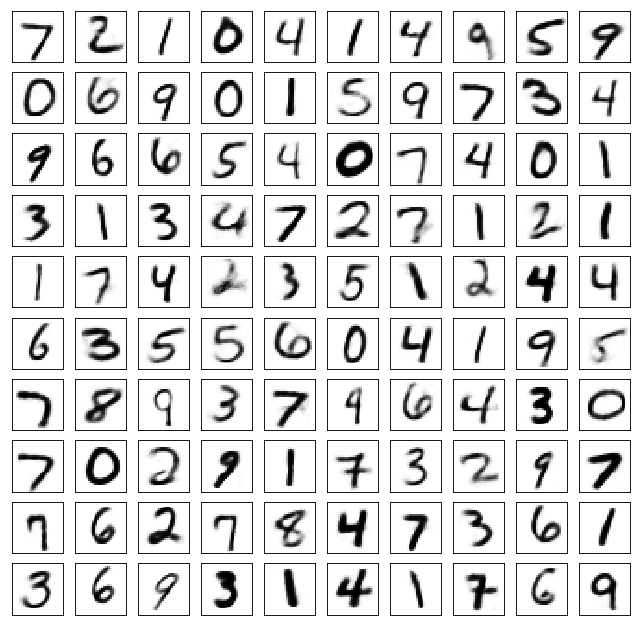

Test losses. E: 0.6950, AE: 0.0550, D: 0.6932
Train Epoch: 126 [0/50000 (0%)]	Losses E: 0.6903, AE: 0.0466, D: 0.6944
Train Epoch: 126 [25000/50000 (50%)]	Losses E: 0.6976, AE: 0.0483, D: 0.6935
Train Epoch: 126 [50000/50000 (100%)]	Losses E: 0.6928, AE: 0.0498, D: 0.6923


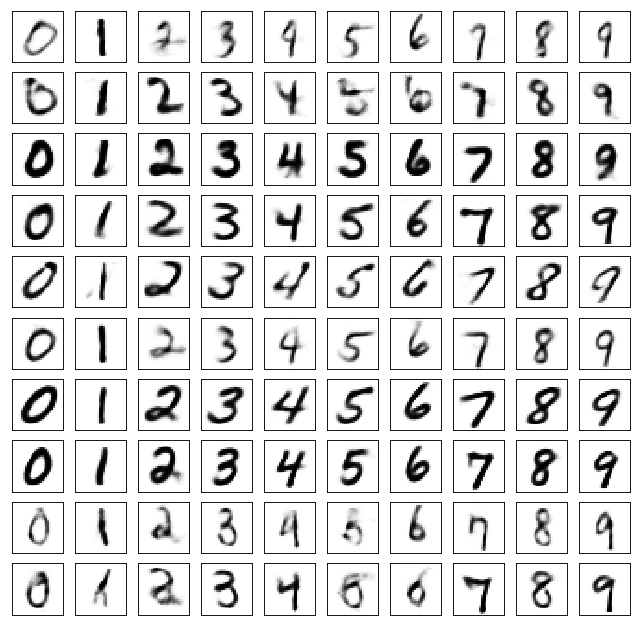

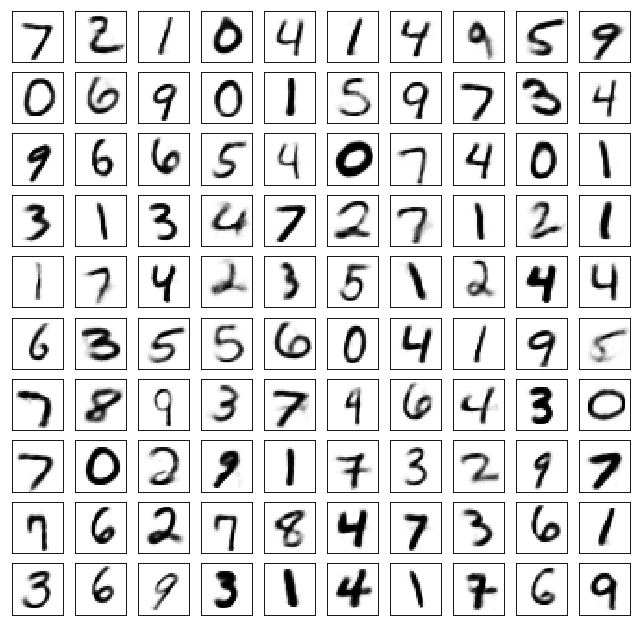

Test losses. E: 0.6929, AE: 0.0540, D: 0.6929
Train Epoch: 127 [0/50000 (0%)]	Losses E: 0.6955, AE: 0.0444, D: 0.6926
Train Epoch: 127 [25000/50000 (50%)]	Losses E: 0.6959, AE: 0.0453, D: 0.6926
Train Epoch: 127 [50000/50000 (100%)]	Losses E: 0.6892, AE: 0.0480, D: 0.6988


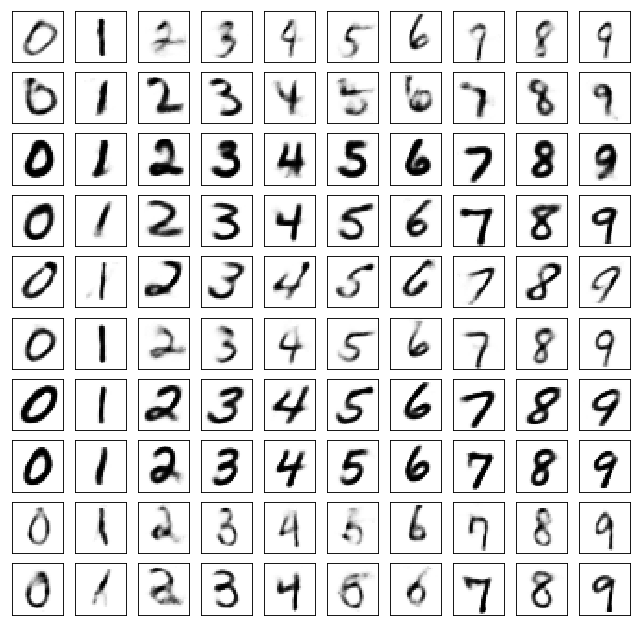

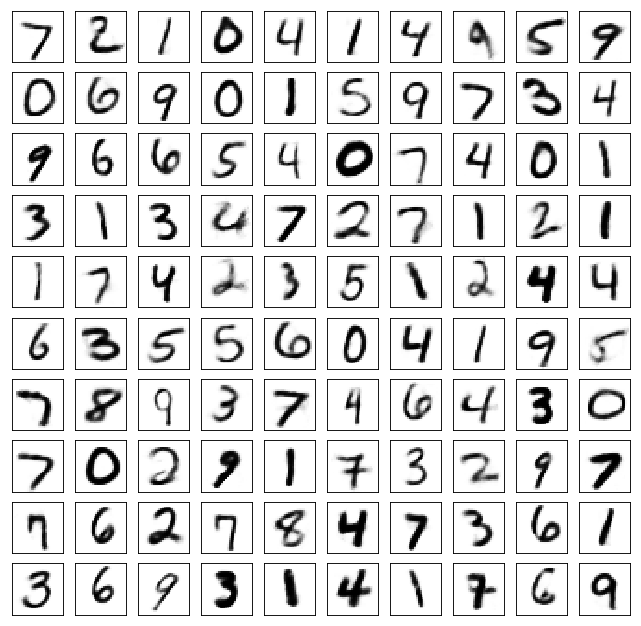

Test losses. E: 0.6922, AE: 0.0549, D: 0.6939
Train Epoch: 128 [0/50000 (0%)]	Losses E: 0.6898, AE: 0.0450, D: 0.6942
Train Epoch: 128 [25000/50000 (50%)]	Losses E: 0.6966, AE: 0.0437, D: 0.6922
Train Epoch: 128 [50000/50000 (100%)]	Losses E: 0.6962, AE: 0.0464, D: 0.6916


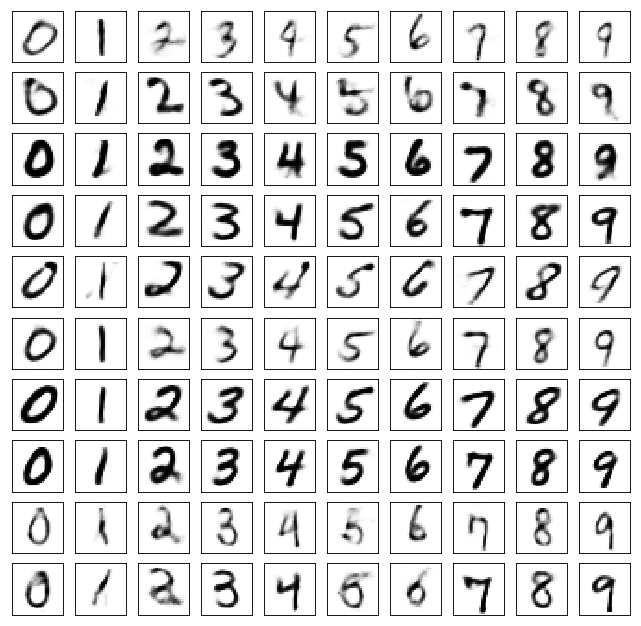

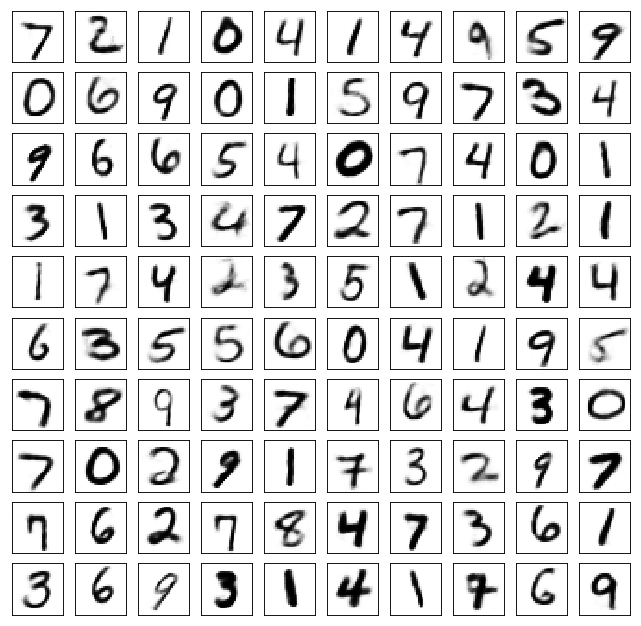

Test losses. E: 0.6910, AE: 0.0551, D: 0.6934
Train Epoch: 129 [0/50000 (0%)]	Losses E: 0.6917, AE: 0.0454, D: 0.6934
Train Epoch: 129 [25000/50000 (50%)]	Losses E: 0.6890, AE: 0.0494, D: 0.6927
Train Epoch: 129 [50000/50000 (100%)]	Losses E: 0.7031, AE: 0.0501, D: 0.6943


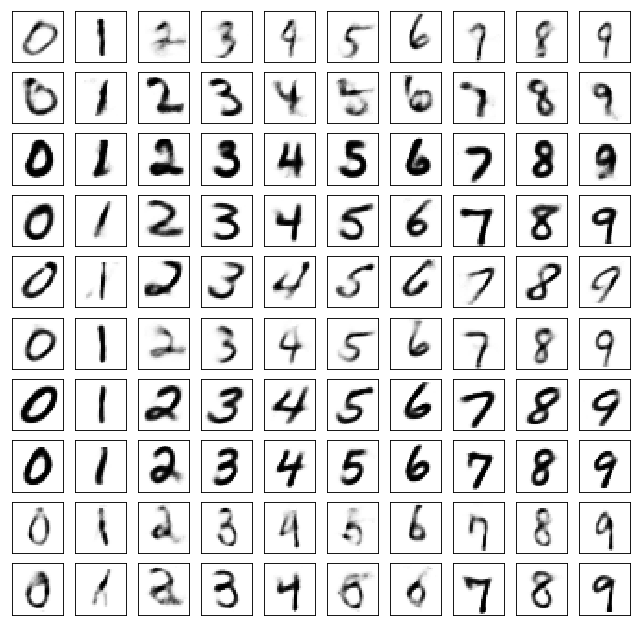

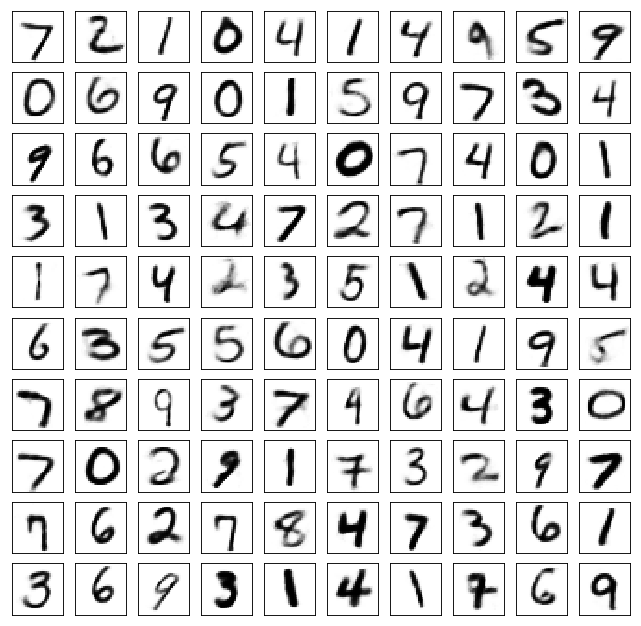

Test losses. E: 0.7059, AE: 0.0537, D: 0.6914
Train Epoch: 130 [0/50000 (0%)]	Losses E: 0.7071, AE: 0.0473, D: 0.6917
Train Epoch: 130 [25000/50000 (50%)]	Losses E: 0.6974, AE: 0.0477, D: 0.6941
Train Epoch: 130 [50000/50000 (100%)]	Losses E: 0.7005, AE: 0.0446, D: 0.6924


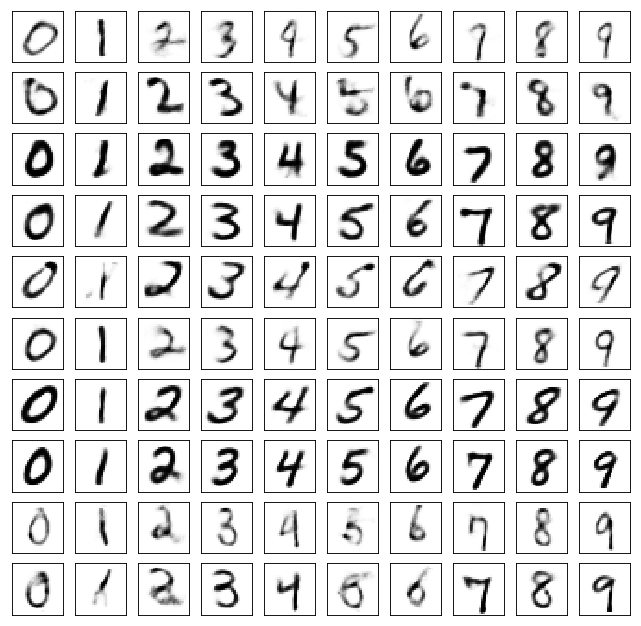

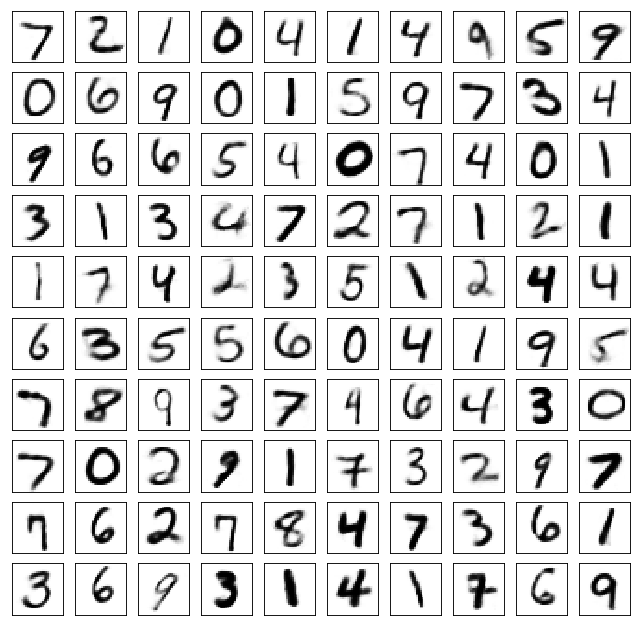

Test losses. E: 0.6968, AE: 0.0543, D: 0.6930
Train Epoch: 131 [0/50000 (0%)]	Losses E: 0.6982, AE: 0.0466, D: 0.6936
Train Epoch: 131 [25000/50000 (50%)]	Losses E: 0.6993, AE: 0.0495, D: 0.6939
Train Epoch: 131 [50000/50000 (100%)]	Losses E: 0.6933, AE: 0.0480, D: 0.6940


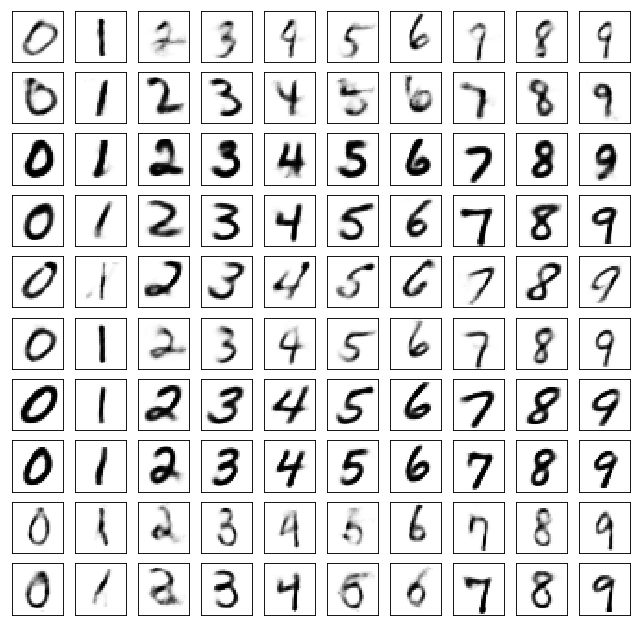

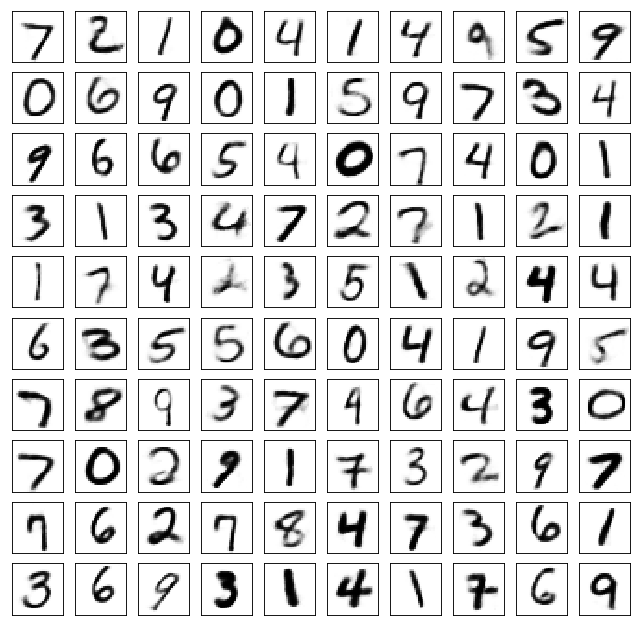

Test losses. E: 0.6941, AE: 0.0532, D: 0.6917
Train Epoch: 132 [0/50000 (0%)]	Losses E: 0.6938, AE: 0.0441, D: 0.6910
Train Epoch: 132 [25000/50000 (50%)]	Losses E: 0.6900, AE: 0.0472, D: 0.6936
Train Epoch: 132 [50000/50000 (100%)]	Losses E: 0.7051, AE: 0.0461, D: 0.6923


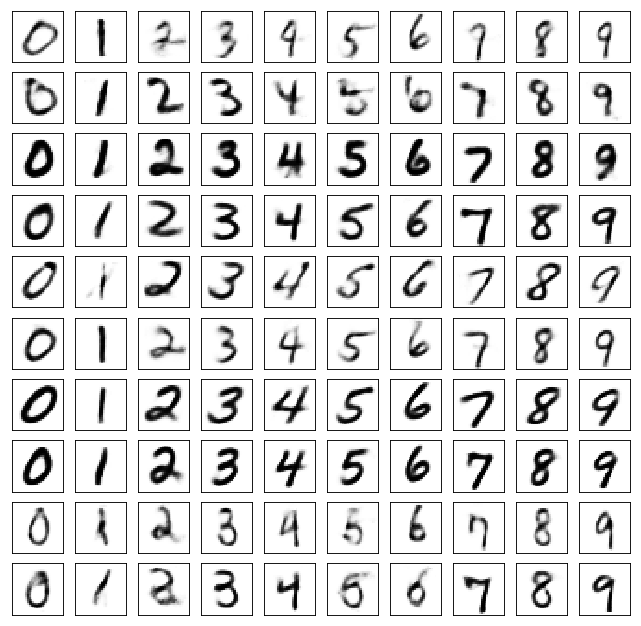

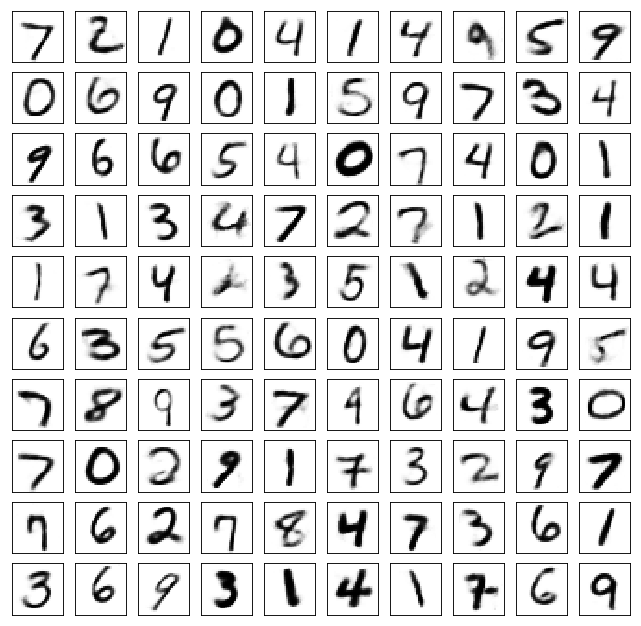

Test losses. E: 0.6998, AE: 0.0550, D: 0.6937
Train Epoch: 133 [0/50000 (0%)]	Losses E: 0.6985, AE: 0.0480, D: 0.6931
Train Epoch: 133 [25000/50000 (50%)]	Losses E: 0.6864, AE: 0.0511, D: 0.6982
Train Epoch: 133 [50000/50000 (100%)]	Losses E: 0.6816, AE: 0.0482, D: 0.6915


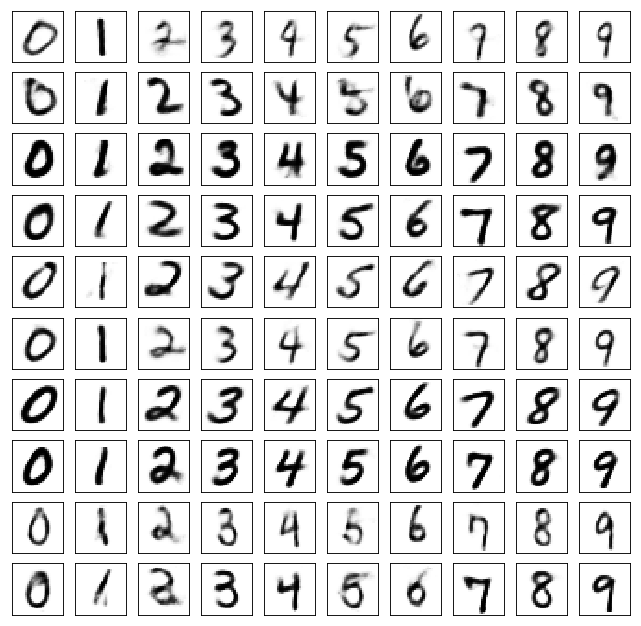

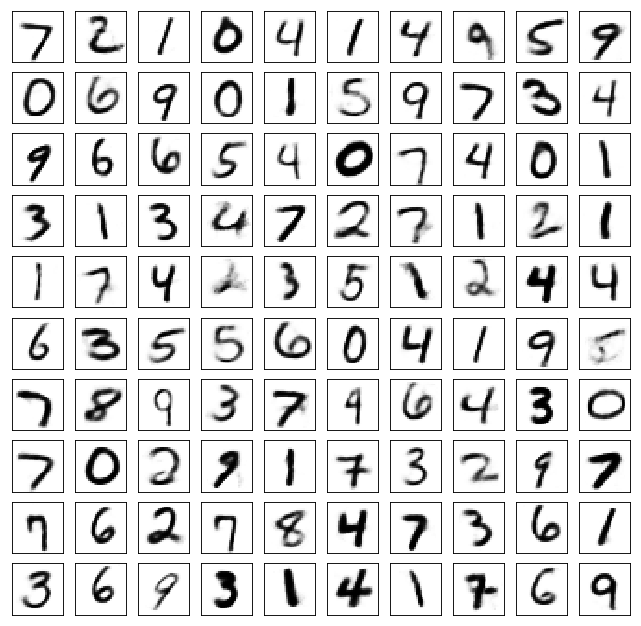

Test losses. E: 0.6807, AE: 0.0547, D: 0.6930
Train Epoch: 134 [0/50000 (0%)]	Losses E: 0.6780, AE: 0.0471, D: 0.6940
Train Epoch: 134 [25000/50000 (50%)]	Losses E: 0.6847, AE: 0.0473, D: 0.6957
Train Epoch: 134 [50000/50000 (100%)]	Losses E: 0.6845, AE: 0.0434, D: 0.6917


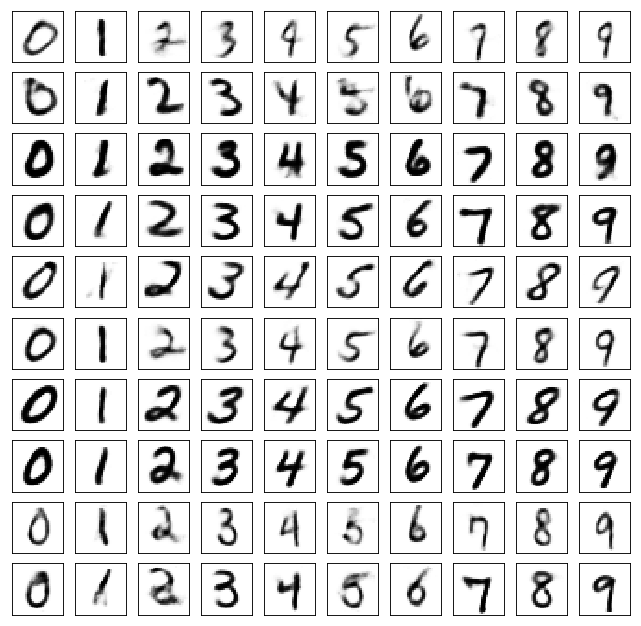

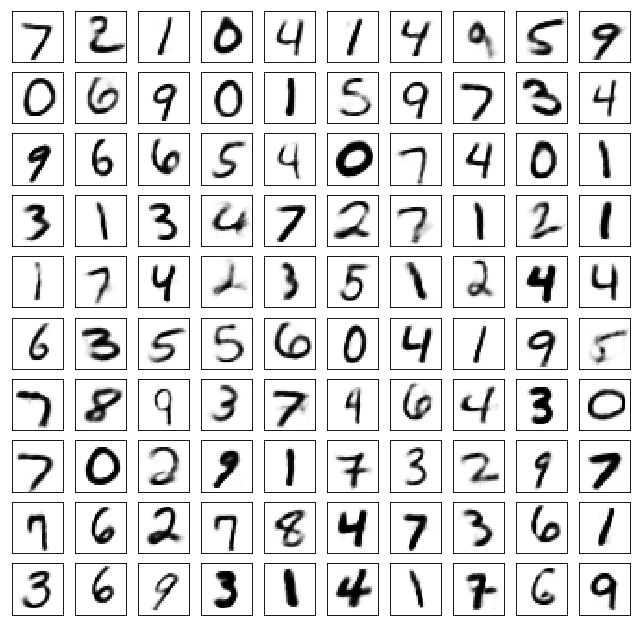

Test losses. E: 0.6836, AE: 0.0538, D: 0.6922
Train Epoch: 135 [0/50000 (0%)]	Losses E: 0.6824, AE: 0.0468, D: 0.6919
Train Epoch: 135 [25000/50000 (50%)]	Losses E: 0.6848, AE: 0.0466, D: 0.6917
Train Epoch: 135 [50000/50000 (100%)]	Losses E: 0.6840, AE: 0.0474, D: 0.6925


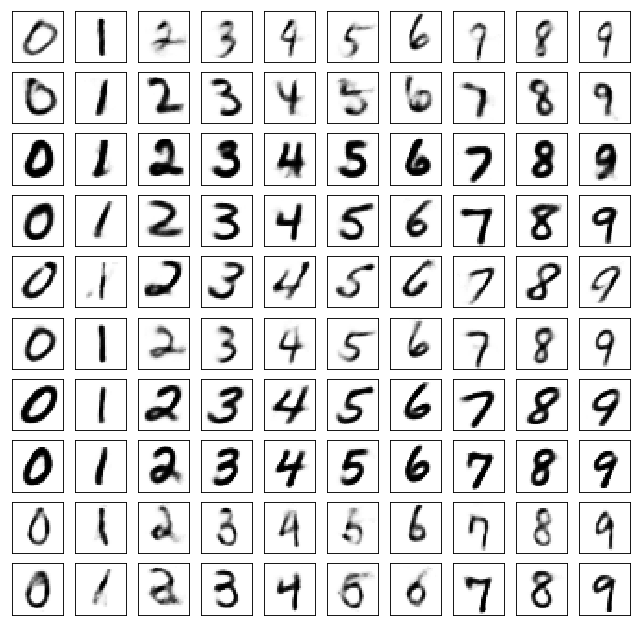

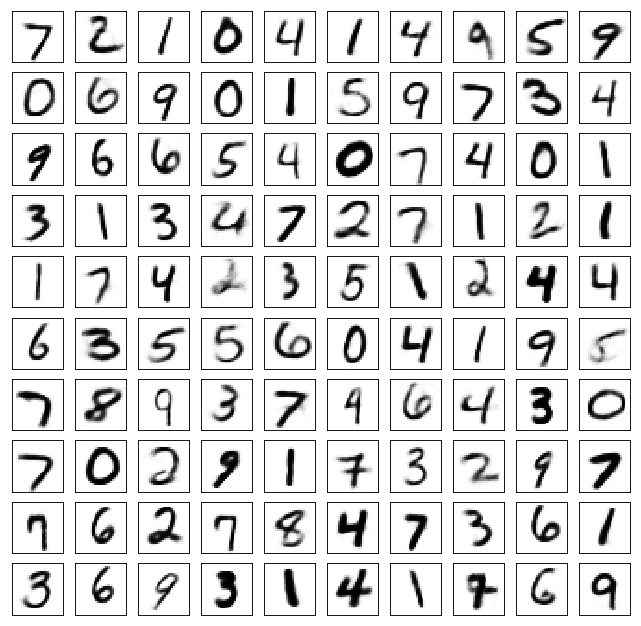

Test losses. E: 0.6810, AE: 0.0548, D: 0.6926
Train Epoch: 136 [0/50000 (0%)]	Losses E: 0.6818, AE: 0.0486, D: 0.6898
Train Epoch: 136 [25000/50000 (50%)]	Losses E: 0.6842, AE: 0.0478, D: 0.6924
Train Epoch: 136 [50000/50000 (100%)]	Losses E: 0.6799, AE: 0.0463, D: 0.6921


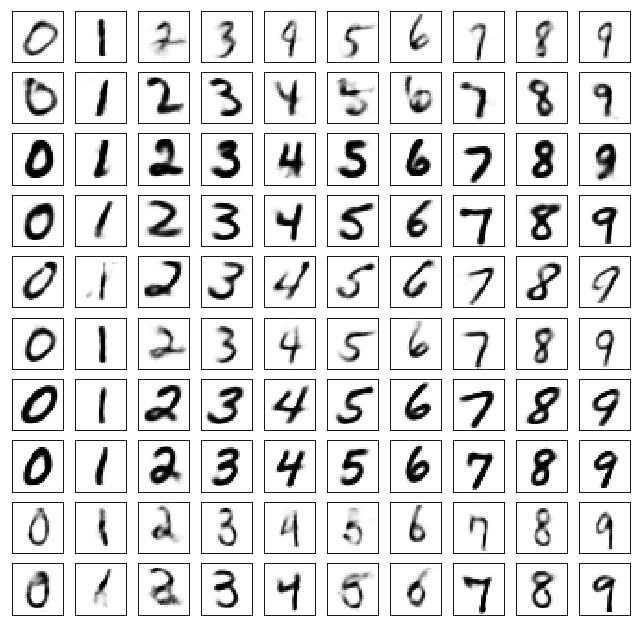

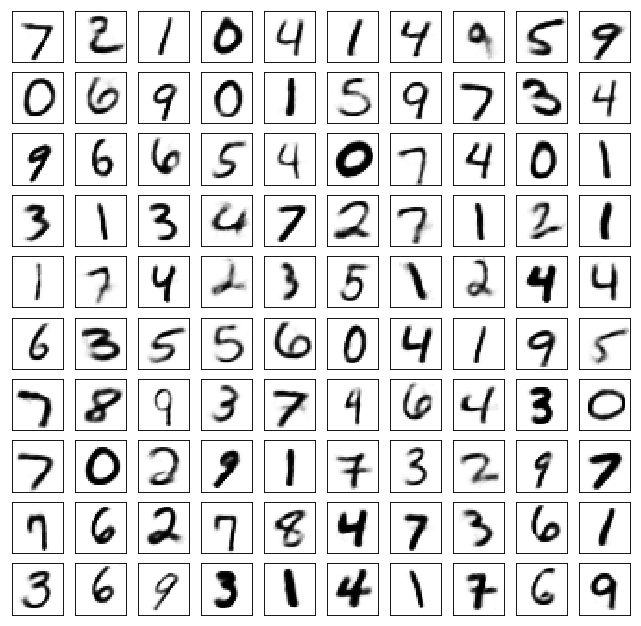

Test losses. E: 0.6792, AE: 0.0528, D: 0.6923
Train Epoch: 137 [0/50000 (0%)]	Losses E: 0.6786, AE: 0.0437, D: 0.6928
Train Epoch: 137 [25000/50000 (50%)]	Losses E: 0.7054, AE: 0.0432, D: 0.6927
Train Epoch: 137 [50000/50000 (100%)]	Losses E: 0.6942, AE: 0.0479, D: 0.6921


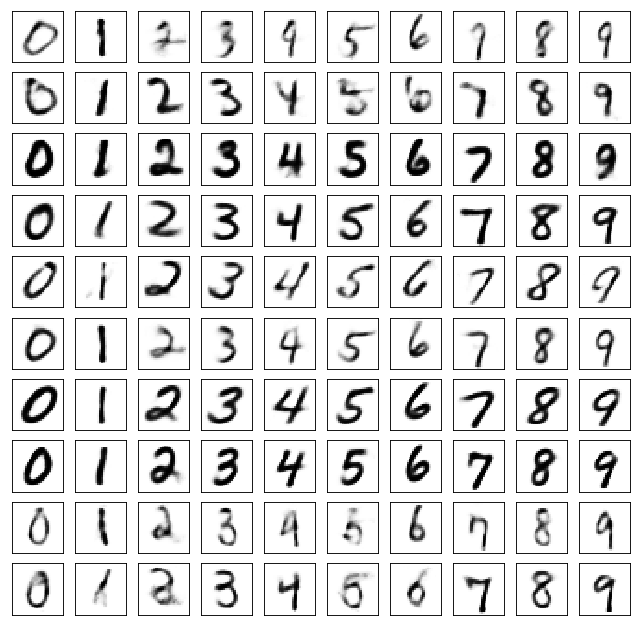

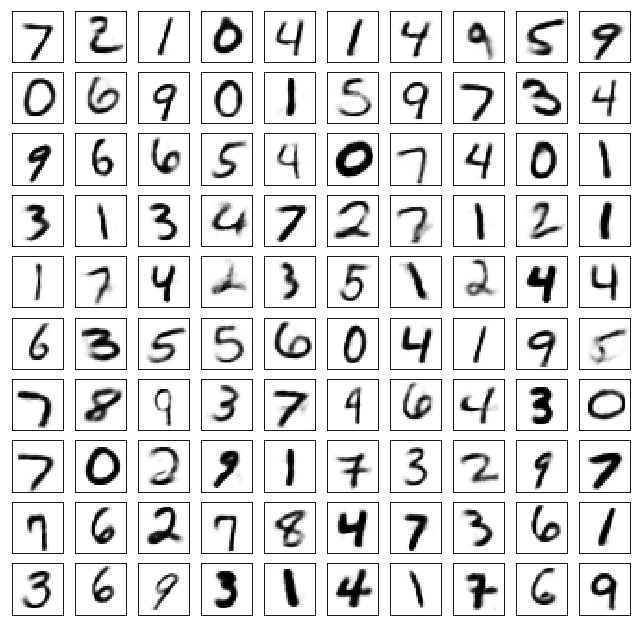

Test losses. E: 0.6922, AE: 0.0533, D: 0.6928
Train Epoch: 138 [0/50000 (0%)]	Losses E: 0.6910, AE: 0.0467, D: 0.6954
Train Epoch: 138 [25000/50000 (50%)]	Losses E: 0.6839, AE: 0.0452, D: 0.6932
Train Epoch: 138 [50000/50000 (100%)]	Losses E: 0.6993, AE: 0.0498, D: 0.6922


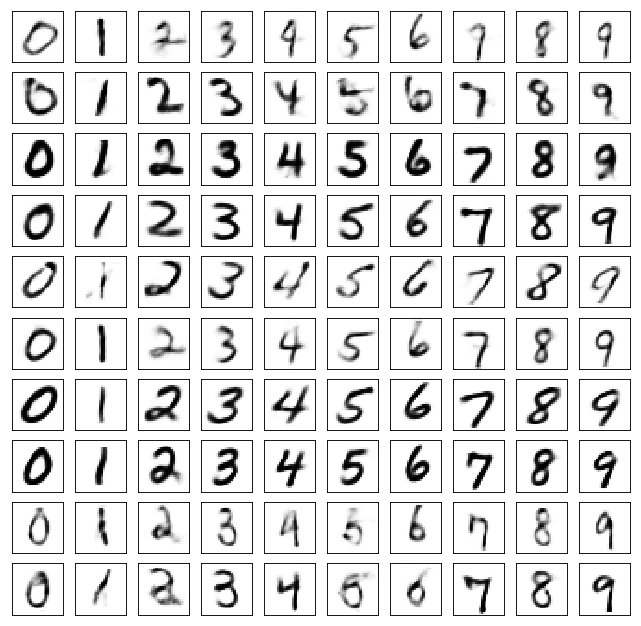

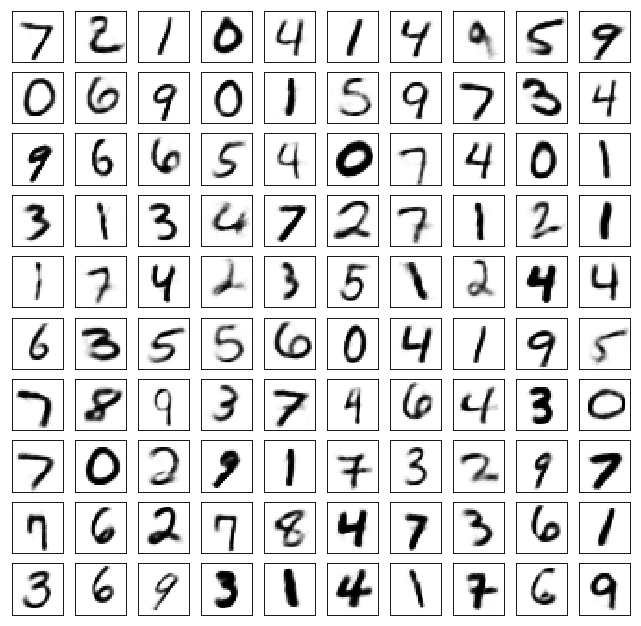

Test losses. E: 0.7001, AE: 0.0539, D: 0.6934
Train Epoch: 139 [0/50000 (0%)]	Losses E: 0.7005, AE: 0.0484, D: 0.6937
Train Epoch: 139 [25000/50000 (50%)]	Losses E: 0.6944, AE: 0.0452, D: 0.6935
Train Epoch: 139 [50000/50000 (100%)]	Losses E: 0.7116, AE: 0.0471, D: 0.6917


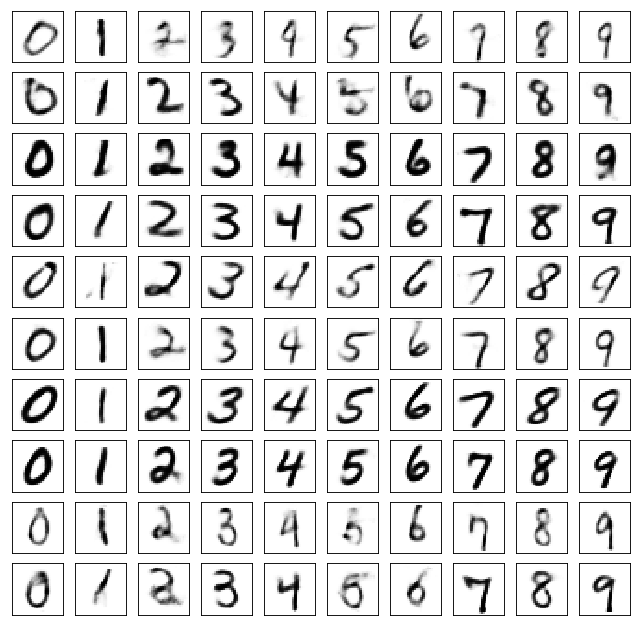

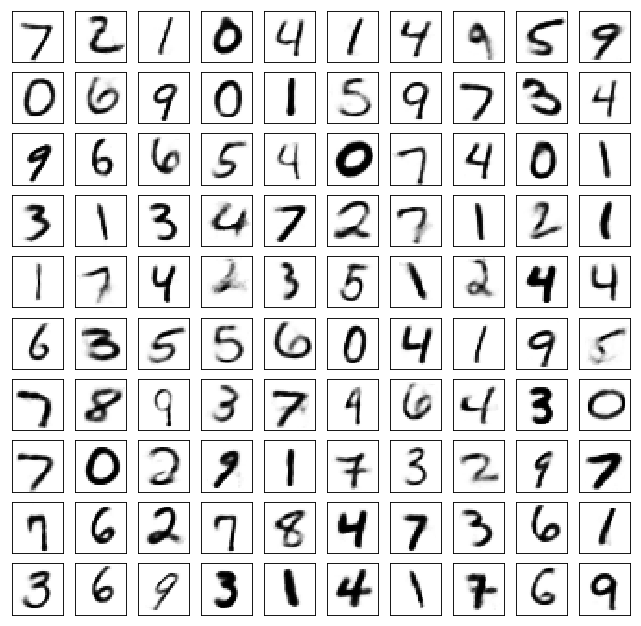

Test losses. E: 0.7091, AE: 0.0549, D: 0.6938
Train Epoch: 140 [0/50000 (0%)]	Losses E: 0.7094, AE: 0.0462, D: 0.6947
Train Epoch: 140 [25000/50000 (50%)]	Losses E: 0.7035, AE: 0.0440, D: 0.6955
Train Epoch: 140 [50000/50000 (100%)]	Losses E: 0.7087, AE: 0.0466, D: 0.6913


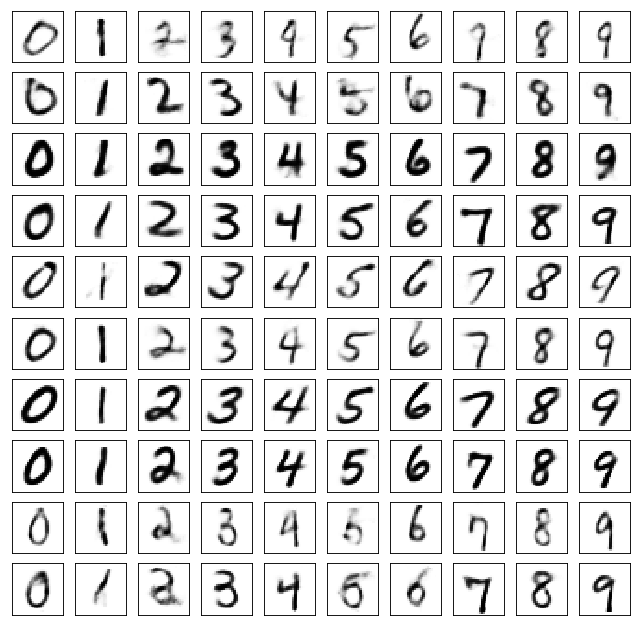

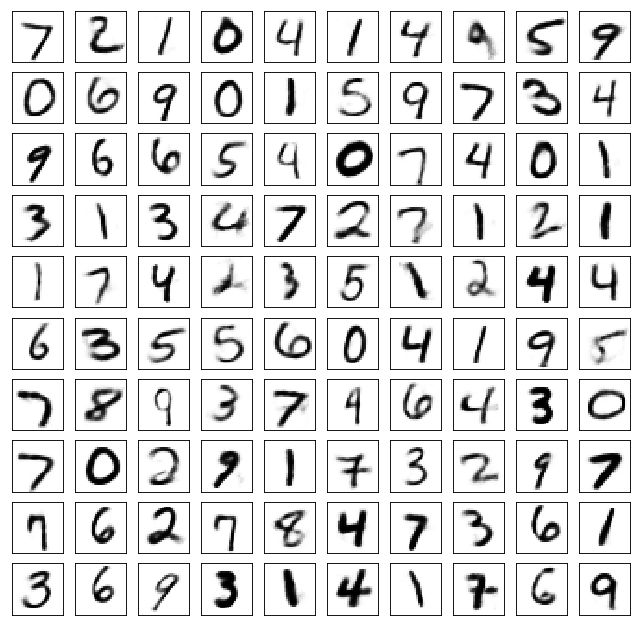

Test losses. E: 0.7059, AE: 0.0538, D: 0.6930
Train Epoch: 141 [0/50000 (0%)]	Losses E: 0.7091, AE: 0.0430, D: 0.6928
Train Epoch: 141 [25000/50000 (50%)]	Losses E: 0.7044, AE: 0.0471, D: 0.6958
Train Epoch: 141 [50000/50000 (100%)]	Losses E: 0.7054, AE: 0.0463, D: 0.6937


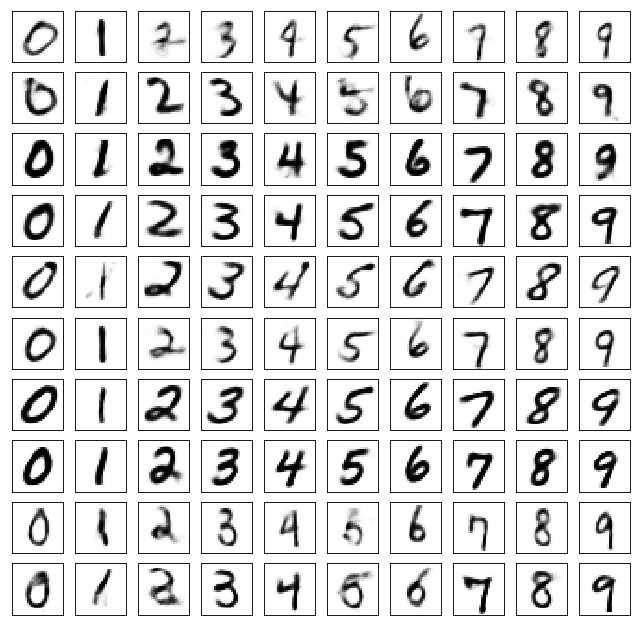

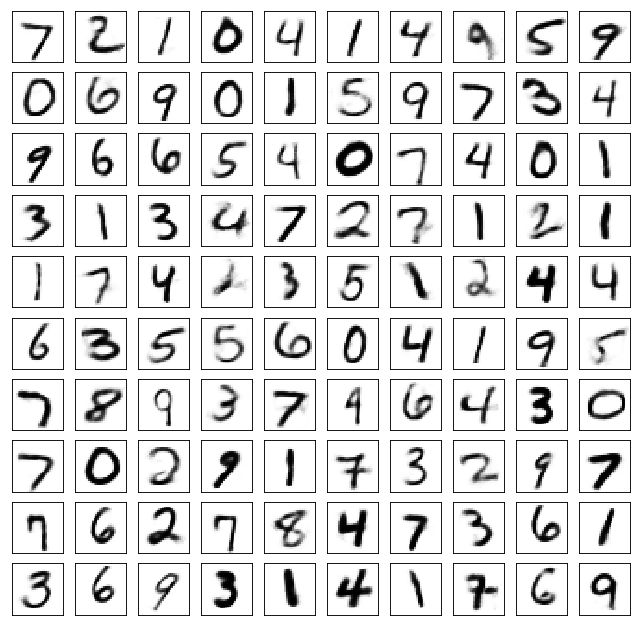

Test losses. E: 0.7038, AE: 0.0536, D: 0.6935
Train Epoch: 142 [0/50000 (0%)]	Losses E: 0.7007, AE: 0.0469, D: 0.6942
Train Epoch: 142 [25000/50000 (50%)]	Losses E: 0.6791, AE: 0.0454, D: 0.6935
Train Epoch: 142 [50000/50000 (100%)]	Losses E: 0.6881, AE: 0.0467, D: 0.6946


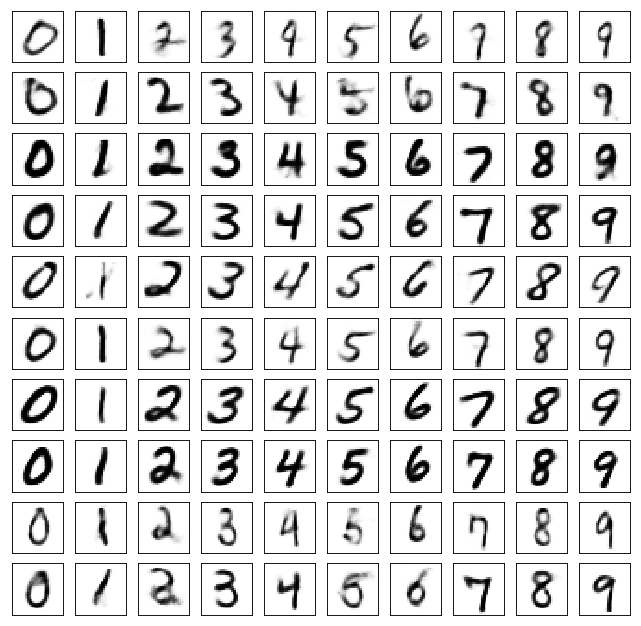

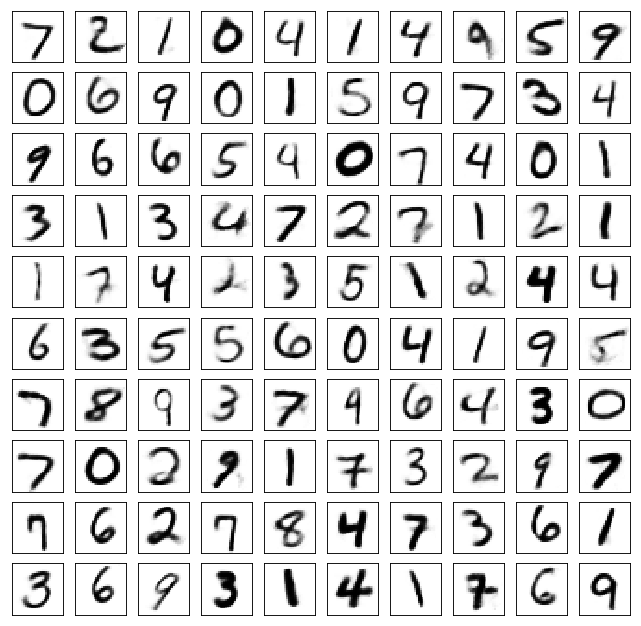

Test losses. E: 0.6889, AE: 0.0535, D: 0.6937
Train Epoch: 143 [0/50000 (0%)]	Losses E: 0.6881, AE: 0.0464, D: 0.6944
Train Epoch: 143 [25000/50000 (50%)]	Losses E: 0.6990, AE: 0.0436, D: 0.6924
Train Epoch: 143 [50000/50000 (100%)]	Losses E: 0.6937, AE: 0.0423, D: 0.6919


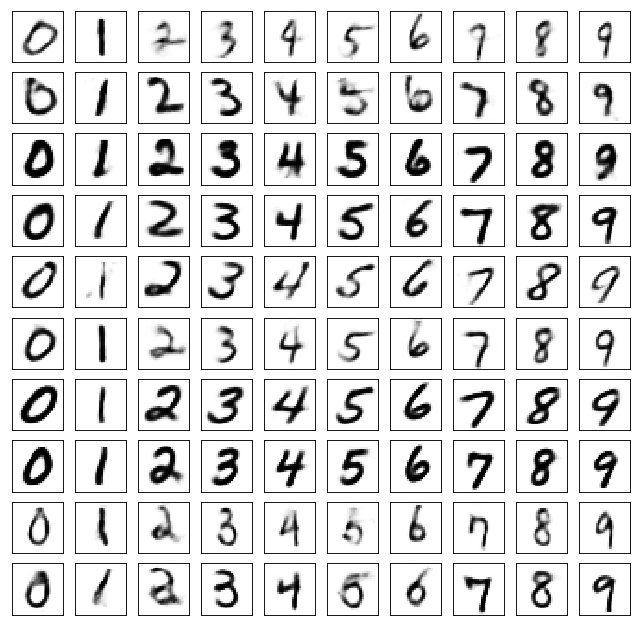

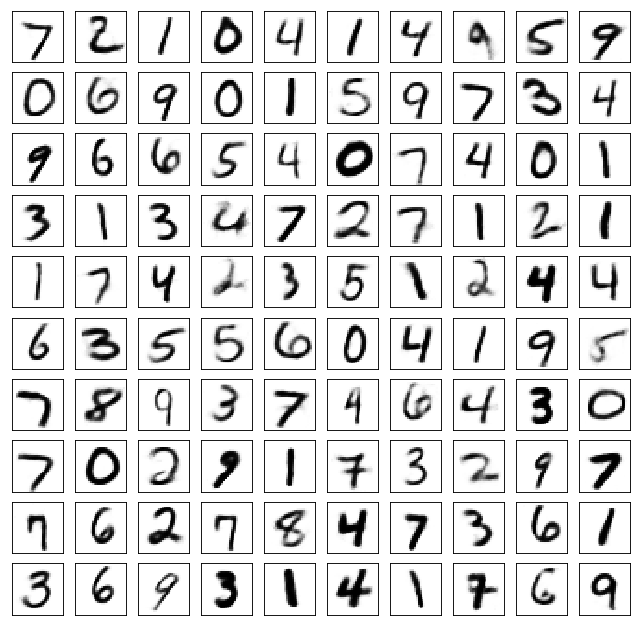

Test losses. E: 0.6934, AE: 0.0536, D: 0.6918
Train Epoch: 144 [0/50000 (0%)]	Losses E: 0.6957, AE: 0.0433, D: 0.6916
Train Epoch: 144 [25000/50000 (50%)]	Losses E: 0.6947, AE: 0.0459, D: 0.6929
Train Epoch: 144 [50000/50000 (100%)]	Losses E: 0.6885, AE: 0.0468, D: 0.6940


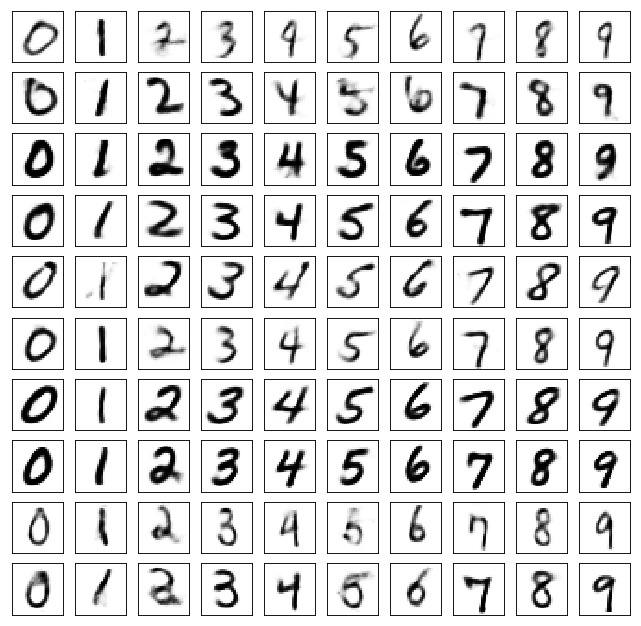

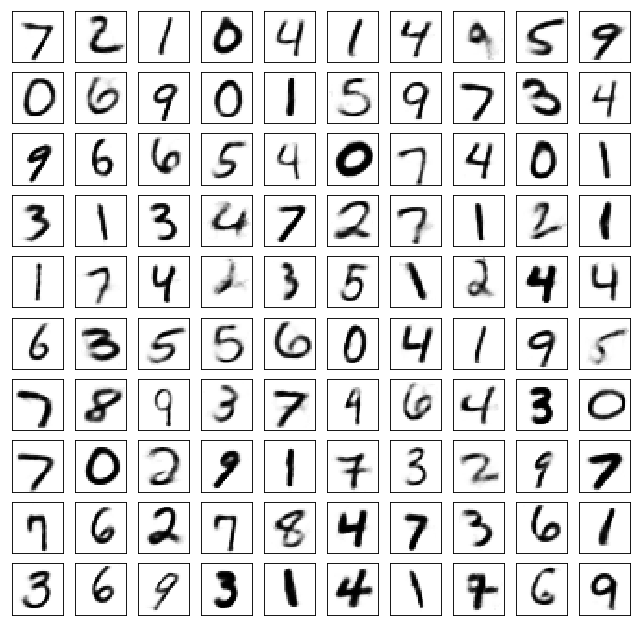

Test losses. E: 0.6905, AE: 0.0532, D: 0.6941
Train Epoch: 145 [0/50000 (0%)]	Losses E: 0.6896, AE: 0.0421, D: 0.6945
Train Epoch: 145 [25000/50000 (50%)]	Losses E: 0.7066, AE: 0.0450, D: 0.6924
Train Epoch: 145 [50000/50000 (100%)]	Losses E: 0.6892, AE: 0.0454, D: 0.6950


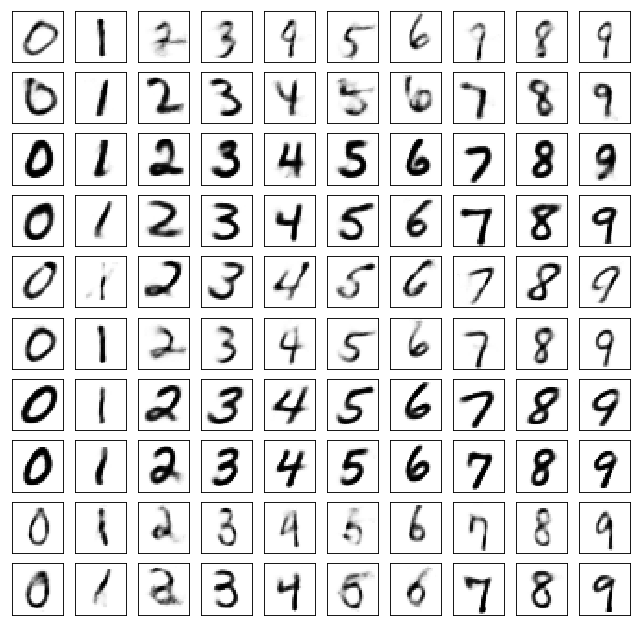

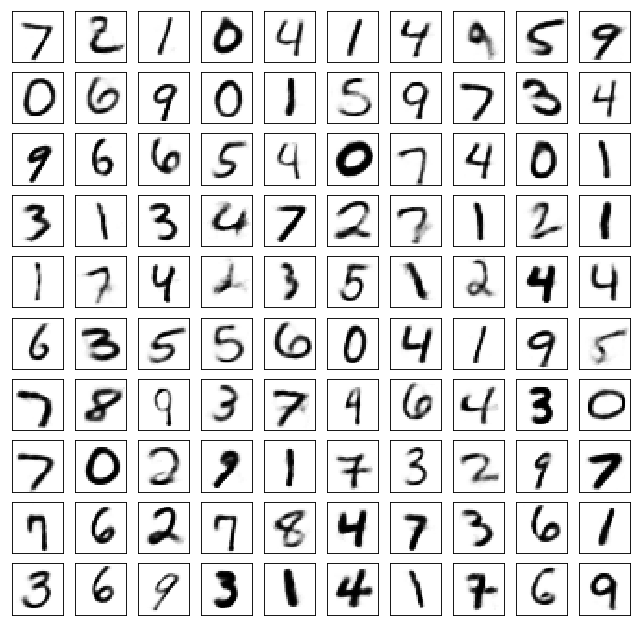

Test losses. E: 0.6883, AE: 0.0526, D: 0.6924
Train Epoch: 146 [0/50000 (0%)]	Losses E: 0.6899, AE: 0.0412, D: 0.6909
Train Epoch: 146 [25000/50000 (50%)]	Losses E: 0.7159, AE: 0.0438, D: 0.6897
Train Epoch: 146 [50000/50000 (100%)]	Losses E: 0.7080, AE: 0.0465, D: 0.6915


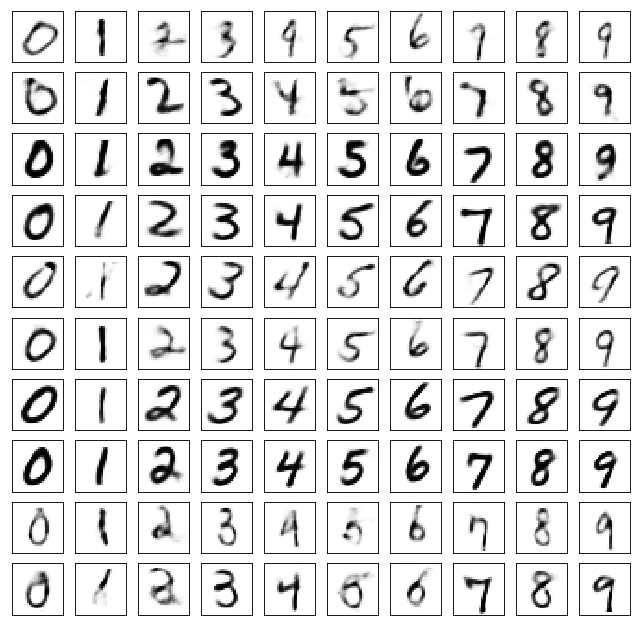

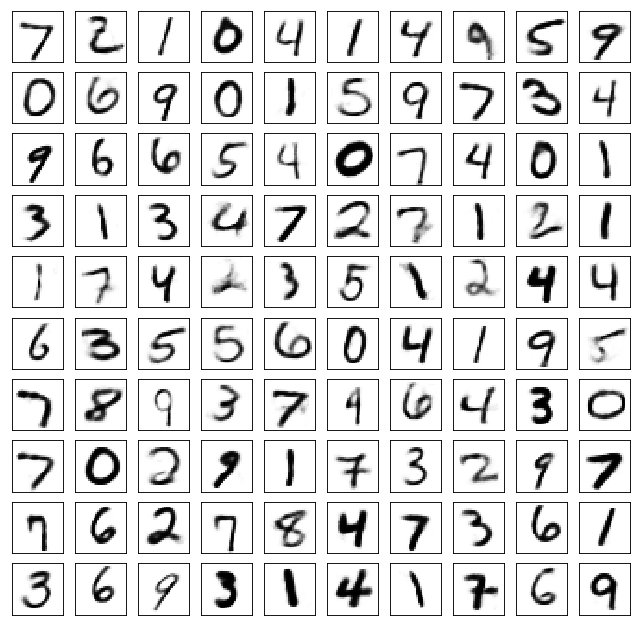

Test losses. E: 0.7101, AE: 0.0547, D: 0.6936
Train Epoch: 147 [0/50000 (0%)]	Losses E: 0.7147, AE: 0.0491, D: 0.6939
Train Epoch: 147 [25000/50000 (50%)]	Losses E: 0.6962, AE: 0.0445, D: 0.6920
Train Epoch: 147 [50000/50000 (100%)]	Losses E: 0.7086, AE: 0.0468, D: 0.6912


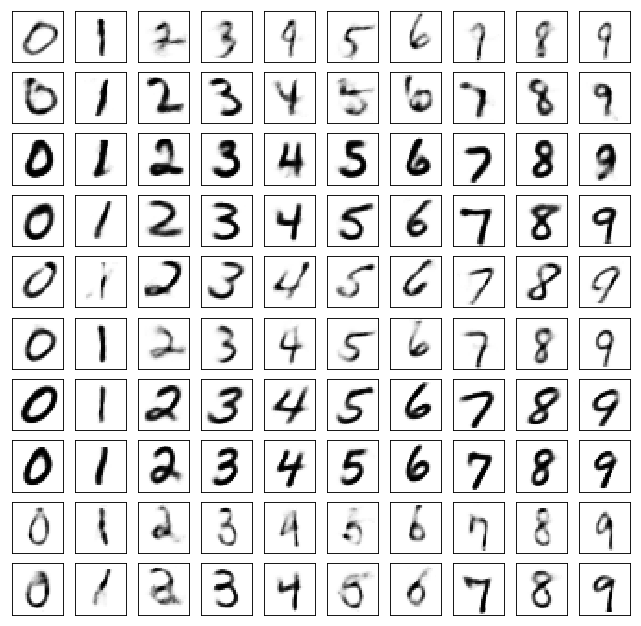

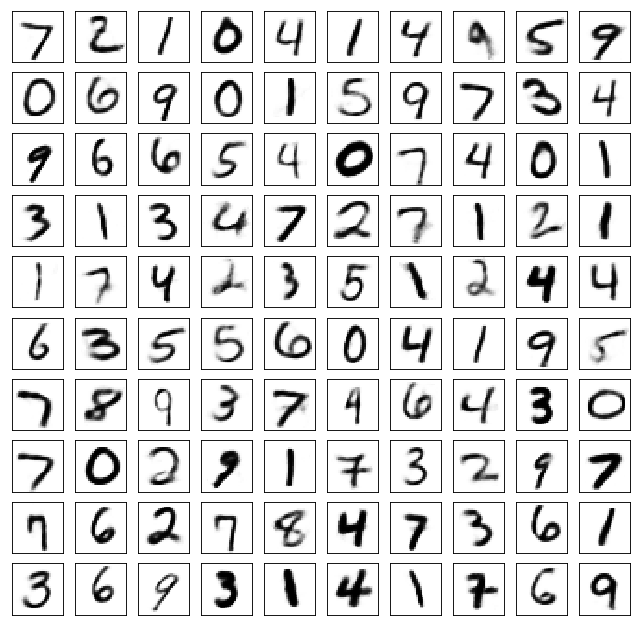

Test losses. E: 0.7094, AE: 0.0527, D: 0.6916
Train Epoch: 148 [0/50000 (0%)]	Losses E: 0.7062, AE: 0.0441, D: 0.6926
Train Epoch: 148 [25000/50000 (50%)]	Losses E: 0.6946, AE: 0.0435, D: 0.6941
Train Epoch: 148 [50000/50000 (100%)]	Losses E: 0.6900, AE: 0.0452, D: 0.6938


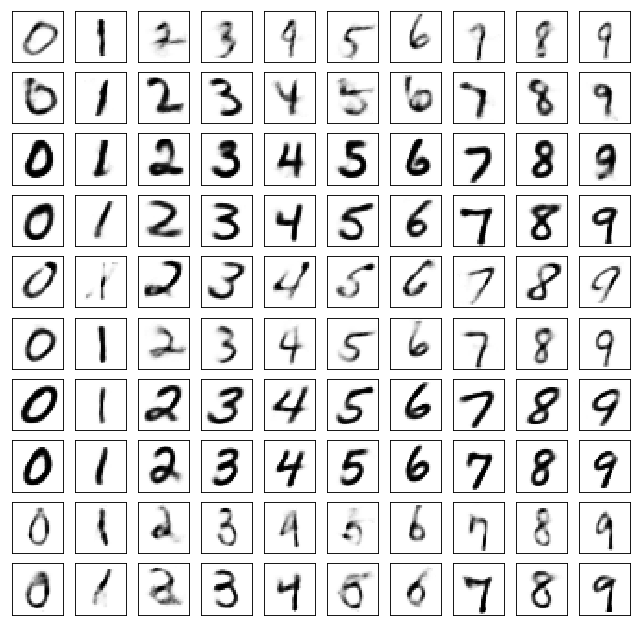

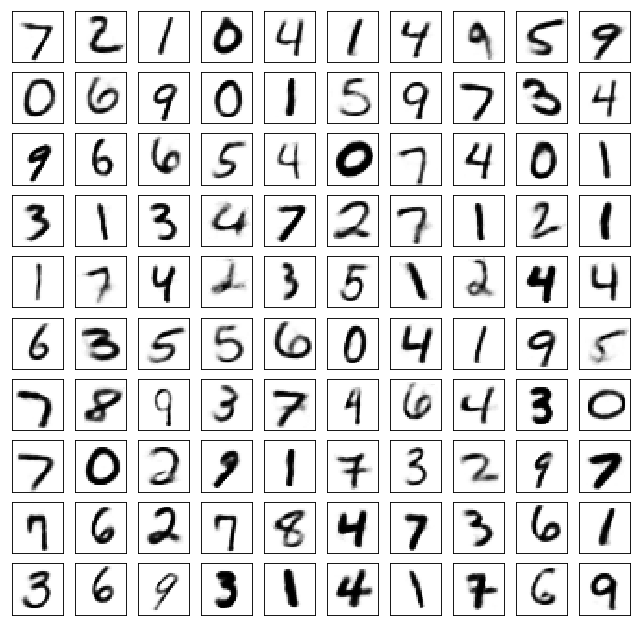

Test losses. E: 0.6899, AE: 0.0531, D: 0.6941
Train Epoch: 149 [0/50000 (0%)]	Losses E: 0.6921, AE: 0.0464, D: 0.6948
Train Epoch: 149 [25000/50000 (50%)]	Losses E: 0.6895, AE: 0.0479, D: 0.6963
Train Epoch: 149 [50000/50000 (100%)]	Losses E: 0.6822, AE: 0.0443, D: 0.6939


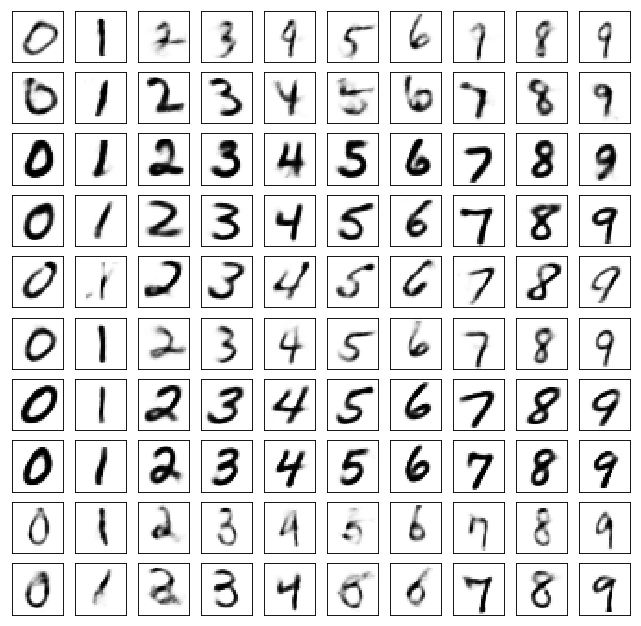

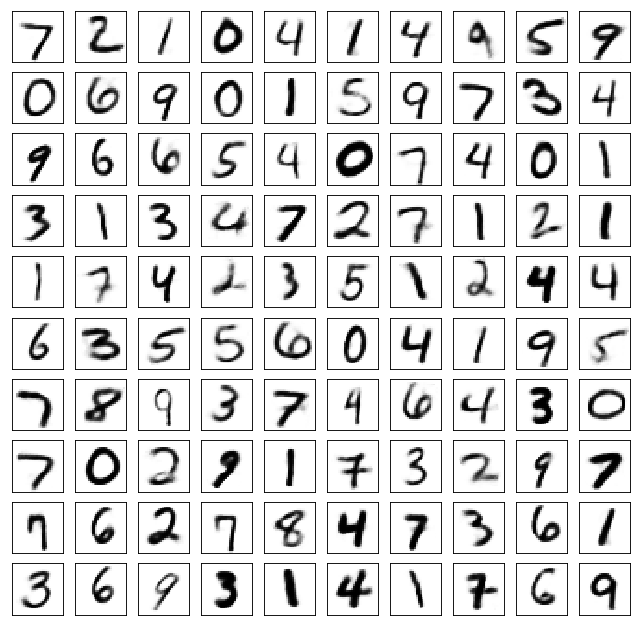

Test losses. E: 0.6828, AE: 0.0538, D: 0.6944
Train Epoch: 150 [0/50000 (0%)]	Losses E: 0.6872, AE: 0.0435, D: 0.6930
Train Epoch: 150 [25000/50000 (50%)]	Losses E: 0.6888, AE: 0.0447, D: 0.6939
Train Epoch: 150 [50000/50000 (100%)]	Losses E: 0.6961, AE: 0.0452, D: 0.6914


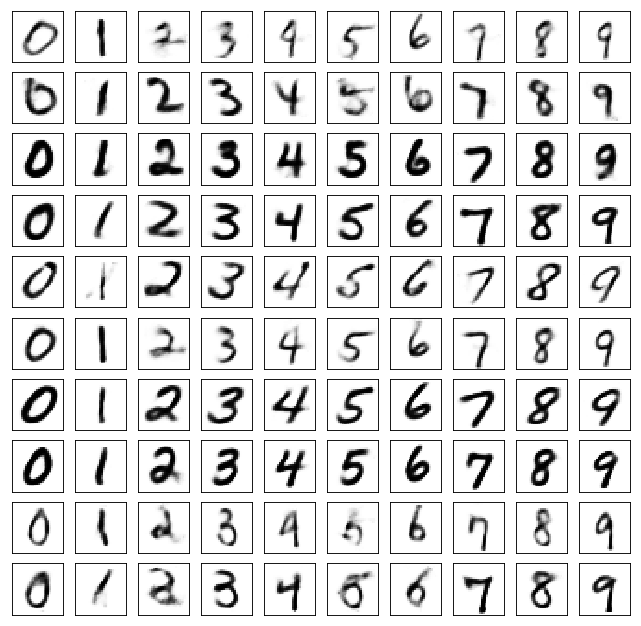

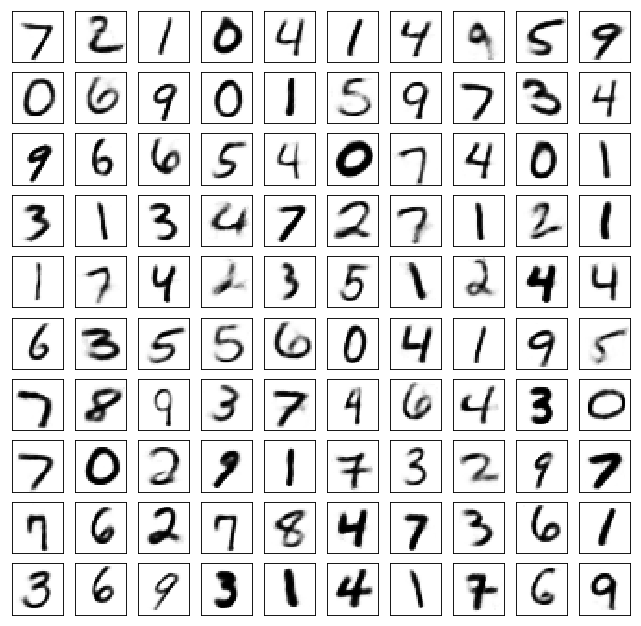

Test losses. E: 0.6954, AE: 0.0522, D: 0.6920
Train Epoch: 151 [0/50000 (0%)]	Losses E: 0.6940, AE: 0.0440, D: 0.6928
Train Epoch: 151 [25000/50000 (50%)]	Losses E: 0.7003, AE: 0.0414, D: 0.6909
Train Epoch: 151 [50000/50000 (100%)]	Losses E: 0.6984, AE: 0.0469, D: 0.6944


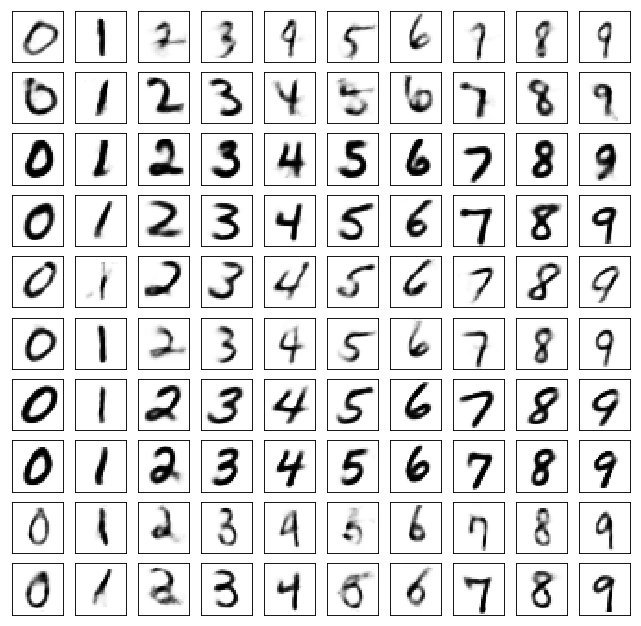

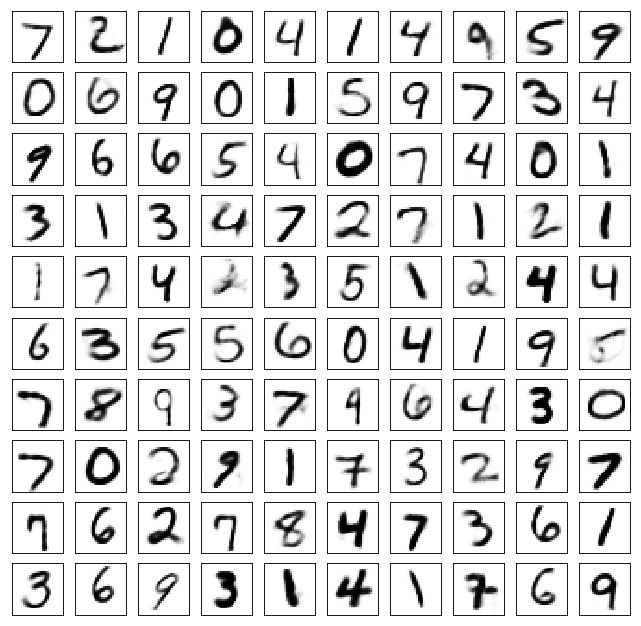

Test losses. E: 0.6947, AE: 0.0533, D: 0.6936
Train Epoch: 152 [0/50000 (0%)]	Losses E: 0.6981, AE: 0.0441, D: 0.6934


KeyboardInterrupt: 

In [13]:
for epoch in range(1, 1001):
    Enc.train()
    Dec.train()
    Disc.train()
    train(epoch, Enc, Dec, Disc, train_log)
    Enc.eval()
    Dec.eval()
    Disc.eval()
    test(Enc, Dec, Disc, valid_loader, epoch, test_log)

In [14]:
Enc.eval()
Dec.eval()
Disc.eval()

FullyConnected(
  (model): Sequential(
    (0): Linear(in_features=20, out_features=1024, bias=True)
    (1): Dropout(p=0.3)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Linear(in_features=1024, out_features=1024, bias=True)
    (4): Dropout(p=0.3)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=1, bias=True)
  )
)

In [15]:
torch.save({
    'Encoder': Enc,
    'Decoder': Dec,
    'Discriminator': Disc
}, 'caae.models')

c:\program files\python36\lib\site-packages\torch\serialization.py:256: UserWarning: Couldn't retrieve source code for container of type FullyConnected. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


### перенос стиля с одной цифры на другие с помощью "честного" CAAE

In [16]:
data, label = next(iter(train_loader))

In [19]:
numbers = torch.empty(10, 1, 28, 28)

for image, target in zip(data, label):
    numbers[target] = image

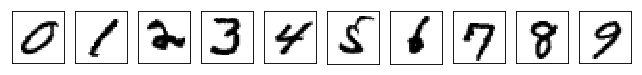

In [20]:
plot_mnist(numbers, (1, 10))

In [33]:
targets = []
for i in range(10):
    targets.extend([i] * 10)
targets = F.one_hot(torch.tensor(targets, dtype=torch.long))

numbers = numbers.to(device)
targets = targets.to(device)

with torch.no_grad():
    latent = Enc(numbers).repeat(10, 1)
    latent_labels = torch.cat([latent, targets.float()], dim=1)
    output = Dec(latent_labels).view(-1, 1, 28, 28)

In [34]:
numbers.shape, output.shape

(torch.Size([10, 1, 28, 28]), torch.Size([100, 1, 28, 28]))

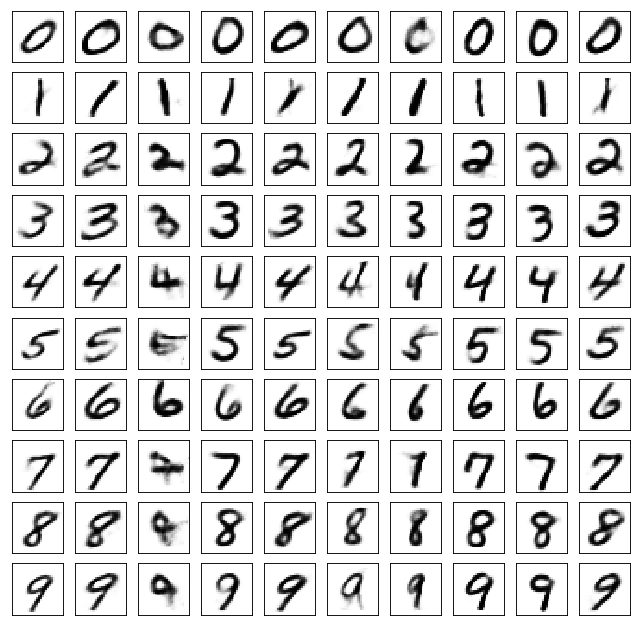

In [36]:
plot_mnist(output.cpu(), (10, 10))